In [525]:
import numpy as np
import copy as cp
import random as rd


In [526]:
global nb_players
global board
global score
global players

nb_players=5
score=[66 for _ in range(nb_players)]

In [527]:
players

[[2, 6, 7, 10, 22, 33, 41, 79, 84],
 [1, 4, 24, 25, 44, 45, 60, 71, 102],
 [3, 13, 23, 43, 55, 74, 82, 95, 97],
 [14, 19, 29, 34, 36, 40, 66, 92, 100],
 [18, 20, 21, 39, 49, 50, 63, 65, 87]]

In [528]:
board

[[28, 37], [42], [48, 51, 53, 67], [88, 91]]

In [529]:
def pick_cards(aplayers):
    
    alimbo=[[0,i] for i in range(nb_players)]
    for i in range(nb_players):
        alimbo[i][0]=aplayers[i].pop(rd.randint(0,len(aplayers[i])-1))  #plays randomly
    
    alimbo.sort()
    print('Played cards',alimbo)
    return alimbo

In [530]:
def score_this(alist):
    pts=0
    for element in alist:
        pts=pts+1
        if element % 5==0:
            pts+=1
        if element % 10==0:
            pts+=1
        if element % 11==0:
            pts+=4
        if element == 55:
            pts+=1
    return pts

In [531]:
def play_turn(alimbo):

    #print(board)
    for _ in range(nb_players):
        distance=1000
        myrow=9
        for i in range(4):
            idistance=alimbo[0][0]-board[i][-1]
            #print(idistance)
            if idistance>0 and idistance<distance:
                distance=idistance
                myrow=i

        #print('dealing with',alimbo[0][0])

        if distance!=1000:
            #print('myrow',myrow+1,'size',len(board[myrow]))
            if len(board[myrow])==5:
                print('Player',alimbo[0][1],'got row',myrow+1, 'and',score_this(board[myrow]),'points')
                score[alimbo[0][1]]-=score_this(board[myrow])
                board[myrow]=[]
                #board[myrow].append(alimbo.pop(0)[0])    

        else:
            #checking for lowest scoring row
            temp_row_score=[score_this(board[i]) for i in range(4)]
            myrow=rd.choice([i for i in range(4) if temp_row_score[i]==min(temp_row_score)]) #picks amongst equal points
            print('Player',alimbo[0][1],'cleaned row',myrow+1, 'and got',min(temp_row_score), 'points')

            #myrow=rd.randint(0,3)   #select row to clean mechanism

            score[alimbo[0][1]]-=min(temp_row_score)  # counting points
            board[myrow]=[]
            #board[myrow].append(alimbo.pop(0)[0])
            
        board[myrow].append(alimbo.pop(0)[0])

    print('Board\n',board[0],'\n',board[1],'\n',board[2],'\n',board[3])

In [532]:
def play_game():
    round_counter=1

    while(min(score)>0 and round_counter<10):

        print('---------------------------------------------------------------')
        print('Round',round_counter)
        print('---------------------------------------------------------------')

        gamestack=[i for i in range(1,105)]
        board=[[[]],[[]],[[]],[[]]]
        players=[[] for _ in range(nb_players)]

        for i in range(4):
            board[i][0]=gamestack.pop(rd.randint(0,len(gamestack)-1))

        for i in range(10):
            for j in range(nb_players):
                players[j].append(gamestack.pop(rd.randint(0,len(gamestack)-1)))

        for i in range(nb_players):
            players[i].sort()    

        print('Board',board)

        for i in range(10):
            print('******************************')
            print('Turn',i+1)
            play_turn(pick_cards(players))
            print('Score',score)

        round_counter+=1

        print('\n')

    wip_score=[[-i,idx] for idx,i in enumerate(score)]
    wip_score.sort()
    rank=[i[1] for i in wip_score]
    print('Final rank',rank)


In [533]:
play_game()

---------------------------------------------------------------
Round 1
---------------------------------------------------------------
Board [[95], [55], [68], [79]]
******************************
Turn 1
Played cards [[2, 3], [34, 2], [42, 1], [52, 4], [65, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [28, 37, 42, 52, 65] 
 [2, 34] 
 [48, 51, 53, 67] 
 [88, 91]
Score [66, 66, 66, 65, 66]
******************************
Turn 2
Played cards [[74, 2], [84, 1], [92, 3], [99, 0], [102, 4]]
Player 1 got row 3 and 5 points
Board
 [28, 37, 42, 52, 65] 
 [2, 34] 
 [84] 
 [88, 91, 92, 99, 102]
Score [66, 61, 66, 65, 66]
******************************
Turn 3
Played cards [[14, 2], [43, 3], [50, 1], [51, 4], [96, 0]]
Player 2 cleaned row 3 and got 1 points
Player 0 got row 1 and 6 points
Board
 [96] 
 [2, 34, 43, 50, 51] 
 [14] 
 [88, 91, 92, 99, 102]
Score [60, 61, 65, 65, 66]
******************************
Turn 4
Played cards [[9, 3], [13, 1], [64, 2], [72, 4], [88, 0]]
Player 3 cleaned ro

In [534]:
rank

[4, 1, 2, 0, 3]

In [609]:
def pick_cards_opt(aplayers,apos):
    
    alimbo=[[0,i] for i in range(nb_players)]
    
    #myself
    alimbo[0][0]=aplayers[0][apos]
    
    #other players
    for i in range(1,nb_players):
        alimbo[i][0]=aplayers[i][rd.randint(0,len(aplayers[i])-1)]  #plays randomly
    
    alimbo.sort()
    print('Played cards',alimbo)
    return alimbo

In [695]:
all_scoreP0=[]

for trials in range(100):

    grouped_score=[]
    gamestack=[i for i in range(1,105)]
    board=[[[]],[[]],[[]],[[]]]
    players=[[] for _ in range(nb_players)]
    scoreP0=[]

    for i in range(4):
        board[i][0]=gamestack.pop(rd.randint(0,len(gamestack)-1))
    
    cst_board=cp.deepcopy(board)

    for i in range(10):
        for j in range(nb_players):
            players[j].append(gamestack.pop(rd.randint(0,len(gamestack)-1)))

    for i in range(nb_players):
        players[i].sort()    

    cst_players=cp.deepcopy(players)    
    
    print('P0',players[0])
    print('Board',board)

    sims=100
    for idx in range(sims):
        scoreP0_temp=[]
        for i in range(10):
            board=cp.deepcopy(cst_board)
            print('bordix',board)
            score=[0 for _ in range(nb_players)]
            play_turn(pick_cards_opt(cst_players,i))
            scoreP0_temp.append(score[0])
            print('------------------------>',scoreP0_temp)
        scoreP0.append(scoreP0_temp)
    
    for pos in range(10):
        mysum=0
        for idx in range(sims):
            mysum+=scoreP0[idx][pos]
        
        grouped_score.append(mysum/sims)
    
    all_scoreP0.append(grouped_score)

P0 [3, 30, 36, 43, 48, 53, 59, 77, 78, 85]
Board [[63], [99], [9], [94]]
bordix [[63], [99], [9], [94]]
Played cards [[1, 3], [3, 0], [22, 1], [80, 4], [82, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [63, 80, 82] 
 [99] 
 [1, 3, 22] 
 [94]
------------------------> [0]
bordix [[63], [99], [9], [94]]
Played cards [[19, 3], [24, 4], [30, 0], [74, 1], [95, 2]]
Board
 [63, 74] 
 [99] 
 [9, 19, 24, 30] 
 [94, 95]
------------------------> [0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[8, 1], [13, 2], [19, 3], [36, 0], [87, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [63, 87] 
 [99] 
 [9, 13, 19, 36] 
 [8]
------------------------> [0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[26, 1], [43, 0], [62, 4], [95, 2], [104, 3]]
Board
 [63] 
 [99, 104] 
 [9, 26, 43, 62] 
 [94, 95]
------------------------> [0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[28, 1], [48, 0], [54, 4], [66, 3], [68, 2]]
Board
 [63, 66, 68] 
 [99] 
 [9, 28, 48, 54] 
 [94]
----------

bordix [[63], [99], [9], [94]]
Played cards [[54, 4], [74, 1], [76, 2], [85, 0], [93, 3]]
Board
 [63, 74, 76, 85, 93] 
 [99] 
 [9, 54] 
 [94]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[3, 0], [22, 1], [45, 2], [87, 4], [104, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [63, 87] 
 [99, 104] 
 [3, 22, 45] 
 [94]
------------------------> [-1]
bordix [[63], [99], [9], [94]]
Played cards [[19, 3], [30, 0], [45, 2], [49, 1], [80, 4]]
Board
 [63, 80] 
 [99] 
 [9, 19, 30, 45, 49] 
 [94]
------------------------> [-1, 0]
bordix [[63], [99], [9], [94]]
Played cards [[6, 2], [28, 1], [36, 0], [58, 3], [65, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [6] 
 [99] 
 [9, 28, 36, 58, 65] 
 [94]
------------------------> [-1, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[19, 3], [43, 0], [62, 4], [76, 2], [86, 1]]
Board
 [63, 76, 86] 
 [99] 
 [9, 19, 43, 62] 
 [94]
------------------------> [-1, 0, 0, 0]
bordix [[63], [99], 

 [99, 104] 
 [9, 41, 47, 92] 
 [94]
------------------------> [-1]
bordix [[63], [99], [9], [94]]
Played cards [[30, 0], [45, 2], [49, 1], [83, 3], [87, 4]]
Board
 [63, 83, 87] 
 [99] 
 [9, 30, 45, 49] 
 [94]
------------------------> [-1, 0]
bordix [[63], [99], [9], [94]]
Played cards [[13, 2], [36, 0], [62, 4], [74, 1], [104, 3]]
Board
 [63, 74] 
 [99, 104] 
 [9, 13, 36, 62] 
 [94]
------------------------> [-1, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[28, 1], [43, 0], [62, 4], [68, 2], [83, 3]]
Board
 [63, 68, 83] 
 [99] 
 [9, 28, 43, 62] 
 [94]
------------------------> [-1, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[26, 1], [45, 2], [48, 0], [52, 4], [83, 3]]
Board
 [63, 83] 
 [99] 
 [9, 26, 45, 48, 52] 
 [94]
------------------------> [-1, 0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[25, 3], [49, 1], [53, 0], [80, 4], [97, 2]]
Board
 [63, 80] 
 [99] 
 [9, 25, 49, 53] 
 [94, 97]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[63], [99], [

Played cards [[13, 2], [15, 1], [78, 0], [87, 4], [98, 3]]
Board
 [63, 78, 87] 
 [99] 
 [9, 13, 15] 
 [94, 98]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[26, 1], [47, 2], [65, 4], [83, 3], [85, 0]]
Board
 [63, 65, 83, 85] 
 [99] 
 [9, 26, 47] 
 [94]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[3, 0], [10, 3], [41, 1], [47, 2], [87, 4]]
Player 0 cleaned row 1 and got 1 points
Board
 [3] 
 [99] 
 [9, 10, 41, 47, 87] 
 [94]
------------------------> [-1]
bordix [[63], [99], [9], [94]]
Played cards [[15, 1], [30, 0], [76, 2], [83, 3], [102, 4]]
Board
 [63, 76, 83] 
 [99, 102] 
 [9, 15, 30] 
 [94]
------------------------> [-1, 0]
bordix [[63], [99], [9], [94]]
Played cards [[25, 3], [36, 0], [65, 4], [72, 2], [74, 1]]
Board
 [63, 65, 72, 74] 
 [99] 
 [9, 25, 36] 
 [94]
------------------------> [-1, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[43, 0], [47, 2], [62, 4]

 [94]
------------------------> [-1, 0, 0, 0, 0, 0, -5, 0]
bordix [[63], [99], [9], [94]]
Played cards [[19, 3], [24, 4], [49, 1], [78, 0], [95, 2]]
Board
 [63, 78] 
 [99] 
 [9, 19, 24, 49] 
 [94, 95]
------------------------> [-1, 0, 0, 0, 0, 0, -5, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[49, 1], [68, 2], [85, 0], [93, 3], [102, 4]]
Board
 [63, 68, 85, 93] 
 [99, 102] 
 [9, 49] 
 [94]
------------------------> [-1, 0, 0, 0, 0, 0, -5, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[3, 0], [25, 3], [28, 1], [47, 2], [54, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [63] 
 [99] 
 [3, 25, 28, 47, 54] 
 [94]
------------------------> [-1]
bordix [[63], [99], [9], [94]]
Played cards [[24, 4], [26, 1], [30, 0], [76, 2], [104, 3]]
Board
 [63, 76] 
 [99, 104] 
 [9, 24, 26, 30] 
 [94]
------------------------> [-1, 0]
bordix [[63], [99], [9], [94]]
Played cards [[6, 2], [10, 3], [36, 0], [74, 1], [102, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [6] 
 [99, 102] 


Player 3 got row 1 and 9 points
Board
 [93] 
 [99] 
 [9] 
 [94]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[6, 2], [58, 3], [78, 0], [86, 1], [92, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [6] 
 [99] 
 [9, 58, 78, 86, 92] 
 [94]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[13, 2], [24, 4], [58, 3], [74, 1], [85, 0]]
Board
 [63, 74, 85] 
 [99] 
 [9, 13, 24, 58] 
 [94]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[3, 0], [8, 1], [25, 3], [71, 4], [82, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [63, 71, 82] 
 [99] 
 [3, 8, 25] 
 [94]
------------------------> [-1]
bordix [[63], [99], [9], [94]]
Played cards [[25, 3], [30, 0], [49, 1], [62, 4], [97, 2]]
Board
 [63] 
 [99] 
 [9, 25, 30, 49, 62] 
 [94, 97]
------------------------> [-1, 0]
bordix [[63], [99], [9], [94]]
Played cards [[1, 3], [36, 0], [47, 2], 

 [99] 
 [9, 19, 24, 41] 
 [94, 97]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[3, 0], [6, 2], [8, 1], [52, 4], [104, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [63] 
 [99, 104] 
 [3, 6, 8, 52] 
 [94]
------------------------> [-1]
bordix [[63], [99], [9], [94]]
Played cards [[26, 1], [30, 0], [58, 3], [72, 2], [102, 4]]
Board
 [63, 72] 
 [99, 102] 
 [9, 26, 30, 58] 
 [94]
------------------------> [-1, 0]
bordix [[63], [99], [9], [94]]
Played cards [[15, 1], [36, 0], [72, 2], [83, 3], [87, 4]]
Board
 [63, 72, 83, 87] 
 [99] 
 [9, 15, 36] 
 [94]
------------------------> [-1, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[25, 3], [43, 0], [75, 1], [92, 4], [97, 2]]
Board
 [63, 75, 92] 
 [99] 
 [9, 25, 43] 
 [94, 97]
------------------------> [-1, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[8, 1], [13, 2], [48, 0], [52, 4], [98, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [63, 98] 
 [99] 
 [9, 13, 

 [94]
------------------------> [-1]
bordix [[63], [99], [9], [94]]
Played cards [[30, 0], [76, 2], [80, 4], [86, 1], [93, 3]]
Board
 [63, 76, 80, 86, 93] 
 [99] 
 [9, 30] 
 [94]
------------------------> [-1, 0]
bordix [[63], [99], [9], [94]]
Played cards [[28, 1], [36, 0], [45, 2], [52, 4], [93, 3]]
Board
 [63, 93] 
 [99] 
 [9, 28, 36, 45, 52] 
 [94]
------------------------> [-1, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[6, 2], [26, 1], [43, 0], [54, 4], [98, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [63] 
 [99] 
 [6, 26, 43, 54] 
 [94, 98]
------------------------> [-1, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[48, 0], [75, 1], [80, 4], [95, 2], [98, 3]]
Board
 [63, 75, 80] 
 [99] 
 [9, 48] 
 [94, 95, 98]
------------------------> [-1, 0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[24, 4], [26, 1], [53, 0], [95, 2], [98, 3]]
Board
 [63] 
 [99] 
 [9, 24, 26, 53] 
 [94, 95, 98]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[63], [99]

------------------------> [-1]
bordix [[63], [99], [9], [94]]
Played cards [[1, 3], [30, 0], [68, 2], [75, 1], [102, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [63, 68, 75] 
 [99, 102] 
 [9, 30] 
 [1]
------------------------> [-1, 0]
bordix [[63], [99], [9], [94]]
Played cards [[1, 3], [15, 1], [36, 0], [72, 2], [92, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [63, 72, 92] 
 [99] 
 [9, 15, 36] 
 [1]
------------------------> [-1, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[10, 3], [41, 1], [43, 0], [82, 2], [102, 4]]
Board
 [63, 82] 
 [99, 102] 
 [9, 10, 41, 43] 
 [94]
------------------------> [-1, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[48, 0], [74, 1], [76, 2], [83, 3], [87, 4]]
Board
 [63, 74, 76, 83, 87] 
 [99] 
 [9, 48] 
 [94]
------------------------> [-1, 0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[1, 3], [6, 2], [49, 1], [53, 0], [92, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [63, 92] 
 [99] 
 [9, 49, 53] 
 [1, 6]
-

------------------------> [-1, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[48, 0], [52, 4], [58, 3], [75, 1], [97, 2]]
Board
 [63, 75] 
 [99] 
 [9, 48, 52, 58] 
 [94, 97]
------------------------> [-1, 0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[53, 0], [62, 4], [86, 1], [93, 3], [95, 2]]
Board
 [63, 86, 93] 
 [99] 
 [9, 53, 62] 
 [94, 95]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[13, 2], [41, 1], [52, 4], [59, 0], [104, 3]]
Board
 [63] 
 [99, 104] 
 [9, 13, 41, 52, 59] 
 [94]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[45, 2], [65, 4], [75, 1], [77, 0], [98, 3]]
Board
 [63, 65, 75, 77] 
 [99] 
 [9, 45] 
 [94, 98]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [99], [9], [94]]
Played cards [[22, 1], [25, 3], [62, 4], [72, 2], [78, 0]]
Board
 [63, 72, 78] 
 [99] 
 [9, 22, 25, 62] 
 [94]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bor

 [8, 26, 40] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[15, 1], [32, 3], [42, 4], [43, 0], [68, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [52, 68] 
 [15] 
 [23, 32, 42, 43] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[11, 4], [48, 0], [54, 3], [69, 2], [99, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [52, 54, 69] 
 [81, 99] 
 [11, 48] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[12, 1], [42, 4], [74, 2], [80, 0], [83, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [12] 
 [81, 83] 
 [23, 42, 74, 80] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[2, 0], [16, 4], [29, 3], [63, 2], [73, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [52, 63, 73] 
 [81] 
 [23, 29] 
 [2, 16]
------------------------> [-1]
b

 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[12, 1], [42, 4], [48, 0], [57, 2], [100, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [52, 57, 100] 
 [12] 
 [23, 42, 48] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[57, 2], [72, 4], [80, 0], [98, 1], [100, 3]]
Board
 [52, 57, 72, 80] 
 [81, 98, 100] 
 [23] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[2, 0], [45, 4], [74, 2], [75, 3], [99, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [52, 74, 75, 99] 
 [2] 
 [23, 45] 
 [101]
------------------------> [-1]
bordix [[52], [81], [23], [101]]
Played cards [[4, 0], [51, 1], [54, 3], [63, 2], [72, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [52, 54, 63, 72] 
 [81] 
 [4, 51] 
 [101]
------------------------> [-1, -1]
bordix [[52], [81], [23], [101]]
Played cards [[6, 0], [13, 3], 

Played cards [[28, 4], [48, 0], [57, 2], [73, 1], [75, 3]]
Board
 [52, 57, 73, 75] 
 [81] 
 [23, 28, 48] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[15, 1], [26, 4], [54, 3], [65, 2], [80, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [52, 54, 65, 80] 
 [15] 
 [23, 26] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[2, 0], [65, 2], [76, 4], [87, 3], [98, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [2] 
 [81, 87, 98] 
 [23, 65, 76] 
 [101]
------------------------> [-1]
bordix [[52], [81], [23], [101]]
Played cards [[4, 0], [69, 2], [73, 1], [76, 4], [83, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [52, 69, 73, 76, 83] 
 [4] 
 [23] 
 [101]
------------------------> [-1, -1]
bordix [[52], [81], [23], [101]]
Played cards [[6, 0], [26, 4], [32, 3], [65, 2], [77, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [52, 65, 77] 
 [81] 
 [2

Player 0 cleaned row 4 and got 1 points
Board
 [52, 69, 76] 
 [81] 
 [23] 
 [6, 14, 15]
------------------------> [-1, -1, -1]
bordix [[52], [81], [23], [101]]
Played cards [[24, 4], [32, 3], [36, 0], [64, 2], [99, 1]]
Board
 [52, 64] 
 [81, 99] 
 [23, 24, 32, 36] 
 [101]
------------------------> [-1, -1, -1, 0]
bordix [[52], [81], [23], [101]]
Played cards [[37, 0], [42, 4], [65, 2], [77, 1], [83, 3]]
Board
 [52, 65, 77] 
 [81, 83] 
 [23, 37, 42] 
 [101]
------------------------> [-1, -1, -1, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[26, 4], [32, 3], [38, 0], [57, 2], [98, 1]]
Board
 [52, 57] 
 [81, 98] 
 [23, 26, 32, 38] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[11, 4], [25, 1], [29, 3], [40, 0], [63, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [52, 63] 
 [81] 
 [23, 25, 29, 40] 
 [11]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[11, 4], [43, 0], [61

 [52, 74] 
 [81, 83, 99] 
 [23, 40, 45] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[15, 1], [43, 0], [57, 2], [75, 3], [76, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [52, 57, 75, 76] 
 [15] 
 [23, 43] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[16, 4], [48, 0], [54, 3], [65, 2], [73, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [52, 54, 65, 73] 
 [81] 
 [16, 48] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[27, 1], [42, 4], [54, 3], [74, 2], [80, 0]]
Board
 [52, 54, 74, 80] 
 [81] 
 [23, 27, 42] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[2, 0], [24, 4], [44, 2], [75, 3], [98, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [52, 75] 
 [81, 98] 
 [23, 24, 44] 
 [2]
------------------------> [-1]
bordix [[5

Played cards [[2, 0], [11, 4], [14, 3], [63, 2], [77, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [52, 63, 77] 
 [81] 
 [23] 
 [2, 11, 14]
------------------------> [-1]
bordix [[52], [81], [23], [101]]
Played cards [[4, 0], [12, 1], [14, 3], [42, 4], [57, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [52, 57] 
 [4, 12, 14] 
 [23, 42] 
 [101]
------------------------> [-1, -1]
bordix [[52], [81], [23], [101]]
Played cards [[6, 0], [12, 1], [54, 3], [64, 2], [97, 4]]
Player 0 cleaned row 1 and got 1 points
Board
 [6, 12] 
 [81, 97] 
 [23, 54, 64] 
 [101]
------------------------> [-1, -1, -1]
bordix [[52], [81], [23], [101]]
Played cards [[28, 4], [36, 0], [44, 2], [54, 3], [99, 1]]
Board
 [52, 54] 
 [81, 99] 
 [23, 28, 36, 44] 
 [101]
------------------------> [-1, -1, -1, 0]
bordix [[52], [81], [23], [101]]
Played cards [[14, 3], [26, 4], [37, 0], [68, 2], [99, 1]]
Player 3 cleaned row 2 and got 1 points
Board
 [52, 68, 99] 
 [14] 
 [23, 26, 37] 
 [101]
-------------------

bordix [[52], [81], [23], [101]]
Played cards [[15, 1], [16, 4], [43, 0], [57, 2], [75, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [15, 16] 
 [81] 
 [23, 43, 57, 75] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[16, 4], [32, 3], [48, 0], [63, 2], [98, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [52, 63, 98] 
 [16] 
 [23, 32, 48] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[25, 1], [41, 2], [75, 3], [76, 4], [80, 0]]
Board
 [52, 75, 76, 80] 
 [81] 
 [23, 25, 41] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[2, 0], [24, 4], [64, 2], [73, 1], [83, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [52, 64, 73] 
 [81, 83] 
 [23, 24] 
 [2]
------------------------> [-1]
bordix [[52], [81], [23], [101]]
Played cards [[4, 0], [16, 4], [61, 3], [63, 2], [77, 1]]
Player 0 cleaned r

Player 4 cleaned row 4 and got 1 points
Board
 [52, 61, 66] 
 [81] 
 [23, 37] 
 [11, 12]
------------------------> [-1, -1, -1, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[16, 4], [38, 0], [41, 2], [75, 3], [99, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [52, 75] 
 [81, 99] 
 [23, 38, 41] 
 [16]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[40, 0], [72, 4], [74, 2], [83, 3], [98, 1]]
Board
 [52, 72, 74] 
 [81, 83, 98] 
 [23, 40] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[8, 1], [24, 4], [43, 0], [63, 2], [83, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [52, 63, 83] 
 [8] 
 [23, 24, 43] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[48, 0], [54, 3], [68, 2], [72, 4], [98, 1]]
Board
 [52, 54, 68, 72] 
 [81, 98] 
 [23, 48] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bor

 [8] 
 [81] 
 [23, 43, 45, 54, 65] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[26, 4], [48, 0], [51, 1], [74, 2], [87, 3]]
Board
 [52, 74] 
 [81, 87] 
 [23, 26, 48, 51] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[15, 1], [26, 4], [29, 3], [44, 2], [80, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [52, 80] 
 [15] 
 [23, 26, 29, 44] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[2, 0], [8, 1], [42, 4], [54, 3], [66, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [52, 54, 66] 
 [81] 
 [23, 42] 
 [2, 8]
------------------------> [-1]
bordix [[52], [81], [23], [101]]
Played cards [[4, 0], [8, 1], [24, 4], [44, 2], [61, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [4, 8] 
 [81] 
 [23, 24, 44, 61] 
 [101]
------------------------> [-1, -1]
bordix [[52], [81], [23], [101]]
Play

 [52, 72, 75] 
 [81] 
 [23, 44, 48] 
 [15]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[29, 3], [42, 4], [51, 1], [63, 2], [80, 0]]
Board
 [52, 63, 80] 
 [81] 
 [23, 29, 42, 51] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[2, 0], [27, 1], [54, 3], [64, 2], [97, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [52, 54, 64, 97] 
 [2] 
 [23, 27] 
 [101]
------------------------> [-1]
bordix [[52], [81], [23], [101]]
Played cards [[4, 0], [15, 1], [26, 4], [61, 3], [66, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [4, 15] 
 [81] 
 [23, 26, 61, 66] 
 [101]
------------------------> [-1, -1]
bordix [[52], [81], [23], [101]]
Played cards [[6, 0], [13, 3], [15, 1], [66, 2], [76, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [52, 66, 76] 
 [6, 13, 15] 
 [23] 
 [101]
------------------------> [-1, -1, -1]
bordix [[52], [81], [23], [101]]
Played cards [[2

------------------------> [-1, -1, -1]
bordix [[52], [81], [23], [101]]
Played cards [[15, 1], [36, 0], [45, 4], [68, 2], [83, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [15] 
 [81, 83] 
 [23, 36, 45, 68] 
 [101]
------------------------> [-1, -1, -1, 0]
bordix [[52], [81], [23], [101]]
Played cards [[26, 4], [37, 0], [54, 3], [74, 2], [77, 1]]
Board
 [52, 54, 74, 77] 
 [81] 
 [23, 26, 37] 
 [101]
------------------------> [-1, -1, -1, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[24, 4], [25, 1], [38, 0], [69, 2], [75, 3]]
Board
 [52, 69, 75] 
 [81] 
 [23, 24, 25, 38] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[25, 1], [28, 4], [29, 3], [40, 0], [66, 2]]
Board
 [52, 66] 
 [81] 
 [23, 25, 28, 29, 40] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[52], [81], [23], [101]]
Played cards [[42, 4], [43, 0], [51, 1], [65, 2], [100, 3]]
Board
 [52, 65] 
 [81, 100] 
 [23, 42, 43, 51] 
 [101]
-------

------------------------> [0]
bordix [[47], [100], [92], [48]]
Played cards [[15, 0], [45, 1], [49, 2], [79, 3], [84, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [47, 49, 79, 84] 
 [100] 
 [92] 
 [15, 45]
------------------------> [0, -1]
bordix [[47], [100], [92], [48]]
Played cards [[29, 0], [49, 2], [61, 4], [79, 3], [80, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [47, 49, 61, 79, 80] 
 [100] 
 [92] 
 [29]
------------------------> [0, -1, -1]
bordix [[47], [100], [92], [48]]
Played cards [[19, 4], [21, 3], [36, 0], [43, 1], [49, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [47, 49] 
 [100] 
 [92] 
 [19, 21, 36, 43]
------------------------> [0, -1, -1, 0]
bordix [[47], [100], [92], [48]]
Played cards [[1, 2], [38, 0], [55, 3], [77, 4], [89, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [47] 
 [100] 
 [1, 38] 
 [48, 55, 77, 89]
------------------------> [0, -1, -1, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[2, 2], [4, 3], [19, 4], [26, 1], [44, 0

Player 0 cleaned row 4 and got 1 points
Board
 [47, 77] 
 [100] 
 [92] 
 [9, 20, 21, 30]
------------------------> [-1]
bordix [[47], [100], [92], [48]]
Played cards [[15, 0], [77, 4], [80, 1], [85, 3], [96, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [15] 
 [100] 
 [92, 96] 
 [48, 77, 80, 85]
------------------------> [-1, -1]
bordix [[47], [100], [92], [48]]
Played cards [[14, 2], [26, 1], [29, 0], [61, 4], [69, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [47] 
 [100] 
 [14, 26, 29] 
 [48, 61, 69]
------------------------> [-1, -1, 0]
bordix [[47], [100], [92], [48]]
Played cards [[36, 0], [45, 1], [49, 2], [69, 3], [91, 4]]
Player 0 cleaned row 1 and got 1 points
Board
 [36, 45] 
 [100] 
 [92] 
 [48, 49, 69, 91]
------------------------> [-1, -1, 0, -1]
bordix [[47], [100], [92], [48]]
Played cards [[1, 2], [21, 3], [38, 0], [58, 1], [91, 4]]
Player 2 cleaned row 3 and got 1 points
Board
 [47] 
 [100] 
 [1, 21, 38] 
 [48, 58, 91]
------------------------> [-1, -1, 0, -

------------------------> [0, -1, -1, -1, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[20, 1], [50, 3], [53, 0], [84, 4], [96, 2]]
Player 1 cleaned row 4 and got 1 points
Board
 [47, 50, 53, 84] 
 [100] 
 [92, 96] 
 [20]
------------------------> [0, -1, -1, -1, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[1, 2], [59, 0], [74, 3], [80, 1], [91, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [1] 
 [100] 
 [92] 
 [48, 59, 74, 80, 91]
------------------------> [0, -1, -1, -1, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[8, 4], [42, 2], [50, 3], [65, 0], [89, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [8, 42] 
 [100] 
 [92] 
 [48, 50, 65, 89]
------------------------> [0, -1, -1, -1, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[60, 4], [70, 1], [73, 2], [87, 3], [93, 0]]
Board
 [47] 
 [100] 
 [92, 93] 
 [48, 60, 70, 73, 87]
------------------------> [0, -1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played ca

 [100] 
 [4, 9, 14] 
 [48, 67, 80]
------------------------> [0]
bordix [[47], [100], [92], [48]]
Played cards [[15, 0], [50, 3], [61, 4], [70, 1], [96, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [47, 50, 61, 70] 
 [100] 
 [92, 96] 
 [15]
------------------------> [0, -1]
bordix [[47], [100], [92], [48]]
Played cards [[4, 3], [29, 0], [84, 4], [89, 1], [96, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [47, 84, 89] 
 [100] 
 [92, 96] 
 [4, 29]
------------------------> [0, -1, 0]
bordix [[47], [100], [92], [48]]
Played cards [[19, 4], [36, 0], [49, 2], [55, 3], [70, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [47] 
 [100] 
 [19, 36] 
 [48, 49, 55, 70]
------------------------> [0, -1, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[38, 0], [50, 3], [60, 4], [96, 2], [101, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [38] 
 [100, 101] 
 [92, 96] 
 [48, 50, 60]
------------------------> [0, -1, 0, 0, -1]
bordix [[47], [100], [92], [48]]
Played cards [[8, 4

Played cards [[4, 3], [36, 0], [58, 1], [77, 4], [96, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [47, 58, 77] 
 [100] 
 [92, 96] 
 [4, 36]
------------------------> [-1, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[25, 3], [38, 0], [49, 2], [70, 1], [77, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [25, 38] 
 [100] 
 [92] 
 [48, 49, 70, 77]
------------------------> [-1, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[25, 3], [42, 2], [44, 0], [56, 4], [80, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [47] 
 [100] 
 [25, 42, 44] 
 [48, 56, 80]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[1, 2], [53, 0], [70, 1], [79, 3], [84, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [47, 53, 70, 79, 84] 
 [100] 
 [92] 
 [1]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[59, 0], [71, 1], [79, 3], [91, 4], [96, 2]]
Board
 [47] 
 [100] 
 [92, 96] 
 [48, 5

Player 2 cleaned row 4 and got 1 points
Board
 [47, 50, 84] 
 [100, 101] 
 [92] 
 [14, 44]
------------------------> [0, -1, -1, 0, -1, 0]
bordix [[47], [100], [92], [48]]
Played cards [[1, 2], [21, 3], [53, 0], [67, 4], [70, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [1, 21] 
 [100] 
 [92] 
 [48, 53, 67, 70]
------------------------> [0, -1, -1, 0, -1, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[1, 2], [4, 3], [19, 4], [59, 0], [101, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [1, 4, 19] 
 [100, 101] 
 [92] 
 [48, 59]
------------------------> [0, -1, -1, 0, -1, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[5, 2], [8, 4], [21, 3], [65, 0], [101, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [47] 
 [100, 101] 
 [5, 8, 21] 
 [48, 65]
------------------------> [0, -1, -1, 0, -1, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[26, 1], [35, 2], [50, 3], [60, 4], [93, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [26, 35] 
 [100] 
 [

------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[50, 3], [58, 1], [59, 0], [61, 4], [73, 2]]
Player 2 got row 4 and 7 points
Board
 [47] 
 [100] 
 [92] 
 [73]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[5, 2], [56, 4], [65, 0], [69, 3], [80, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [47, 56, 65, 69, 80] 
 [100] 
 [92] 
 [5]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[14, 2], [58, 1], [84, 4], [85, 3], [93, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [47, 58, 84, 85] 
 [100] 
 [92, 93] 
 [14]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[9, 0], [42, 2], [45, 1], [50, 3], [67, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [47] 
 [100] 
 [9, 42, 45] 
 [48, 50, 67]
------------------------> [-1]
bordix [[47], [100], [92], [48]]
Played cards [[4, 

------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[8, 4], [30, 2], [74, 3], [80, 1], [93, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [47, 74, 80] 
 [100] 
 [92, 93] 
 [8, 30]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[9, 0], [45, 1], [67, 4], [79, 3], [96, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [9, 45] 
 [100] 
 [92, 96] 
 [48, 67, 79]
------------------------> [-1]
bordix [[47], [100], [92], [48]]
Played cards [[15, 0], [35, 2], [50, 3], [56, 4], [80, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [47] 
 [100] 
 [15, 35] 
 [48, 50, 56, 80]
------------------------> [-1, -1]
bordix [[47], [100], [92], [48]]
Played cards [[29, 0], [69, 3], [70, 1], [73, 2], [91, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [47] 
 [100] 
 [29] 
 [48, 69, 70, 73, 91]
------------------------> [-1, -1, -1]
bordix [[47], [100], [92], [48]]
Played cards [[4, 3], [14, 

------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[1, 2], [8, 4], [25, 3], [53, 0], [71, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [47] 
 [100] 
 [1, 8, 25] 
 [48, 53, 71]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[21, 3], [49, 2], [59, 0], [60, 4], [71, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [47, 49, 59, 60, 71] 
 [100] 
 [92] 
 [21]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[5, 2], [60, 4], [65, 0], [71, 1], [85, 3]]
Player 2 cleaned row 4 and got 1 points
Board
 [47, 60, 65, 71, 85] 
 [100] 
 [92] 
 [5]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[14, 2], [60, 4], [71, 1], [87, 3], [93, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [47, 60, 71, 87] 
 [100] 
 [92, 93] 
 [14]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [100

Played cards [[8, 4], [14, 2], [21, 3], [43, 1], [93, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [47] 
 [100] 
 [8, 14, 21, 43] 
 [48, 93]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[1, 2], [9, 0], [19, 4], [69, 3], [80, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [47, 69, 80] 
 [100] 
 [92] 
 [1, 9, 19]
------------------------> [0]
bordix [[47], [100], [92], [48]]
Played cards [[5, 2], [15, 0], [19, 4], [43, 1], [50, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [5, 15, 19, 43] 
 [100] 
 [92] 
 [48, 50]
------------------------> [0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[7, 4], [29, 0], [49, 2], [50, 3], [58, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [7, 29] 
 [100] 
 [92] 
 [48, 49, 50, 58]
------------------------> [0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[2, 2], [36, 0], [61, 4], [70, 1], [85, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [2, 36] 
 [100] 
 [92

 [48, 56, 85]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[5, 2], [50, 3], [53, 0], [60, 4], [89, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [5] 
 [100] 
 [92] 
 [48, 50, 53, 60, 89]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[26, 1], [30, 2], [59, 0], [60, 4], [85, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [26, 30] 
 [100] 
 [92] 
 [48, 59, 60, 85]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[58, 1], [65, 0], [85, 3], [91, 4], [96, 2]]
Board
 [47] 
 [100] 
 [92, 96] 
 [48, 58, 65, 85, 91]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[20, 1], [35, 2], [61, 4], [79, 3], [93, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [20, 35] 
 [100] 
 [92, 93] 
 [48, 61, 79]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Pla

Player 2 cleaned row 3 and got 1 points
Board
 [47] 
 [100] 
 [5, 20] 
 [48, 60, 65, 85]
------------------------> [0, -1, 0, 0, -1, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[25, 3], [35, 2], [45, 1], [60, 4], [93, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [47, 60] 
 [100] 
 [92, 93] 
 [25, 35, 45]
------------------------> [0, -1, 0, 0, -1, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[1, 2], [9, 0], [26, 1], [56, 4], [85, 3]]
Player 2 cleaned row 4 and got 1 points
Board
 [47, 56, 85] 
 [100] 
 [92] 
 [1, 9, 26]
------------------------> [0]
bordix [[47], [100], [92], [48]]
Played cards [[5, 2], [15, 0], [45, 1], [67, 4], [79, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [5, 15, 45] 
 [100] 
 [92] 
 [48, 67, 79]
------------------------> [0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[2, 2], [26, 1], [29, 0], [74, 3], [91, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [47, 74, 91] 
 [100] 
 [92] 
 [2, 26, 29]
-------------

 [100] 
 [1, 21, 45] 
 [48, 65, 84]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[2, 2], [19, 4], [79, 3], [80, 1], [93, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [47] 
 [100] 
 [2, 19] 
 [48, 79, 80, 93]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[4, 3], [5, 2], [9, 0], [20, 1], [60, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [4, 5, 9, 20] 
 [100] 
 [92] 
 [48, 60]
------------------------> [0]
bordix [[47], [100], [92], [48]]
Played cards [[7, 4], [15, 0], [69, 3], [73, 2], [89, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [47, 69, 73, 89] 
 [100] 
 [92] 
 [7, 15]
------------------------> [0, 0]
bordix [[47], [100], [92], [48]]
Played cards [[21, 3], [29, 0], [49, 2], [58, 1], [60, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [47, 49, 58, 60] 
 [100] 
 [92] 
 [21, 29]
------------------------> [0, 0, 0]
bordix [[47], [100], [92], [48]]

 [73, 87] 
 [19, 48, 51, 65, 72] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[47, 4], [52, 3], [58, 2], [61, 0], [81, 1]]
Board
 [15] 
 [73, 81] 
 [19, 47, 52, 58, 61] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[2, 3], [11, 2], [18, 4], [22, 1], [75, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [15, 18, 22] 
 [73, 75] 
 [2, 11] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[21, 4], [37, 1], [70, 3], [87, 2], [92, 0]]
Board
 [15] 
 [73, 87, 92] 
 [19, 21, 37, 70] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[4, 3], [18, 4], [66, 1], [87, 2], [104, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [15, 18] 
 [73, 87, 104] 
 [19, 66] 
 [4]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[10, 0],

 [19, 21, 72] 
 [11]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[21, 4], [33, 2], [52, 3], [72, 1], [104, 0]]
Board
 [15] 
 [73] 
 [19, 21, 33, 52, 72] 
 [97, 104]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[7, 2], [10, 0], [12, 3], [31, 1], [36, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [15] 
 [73] 
 [19, 31, 36] 
 [7, 10, 12]
------------------------> [0]
bordix [[15], [73], [19], [97]]
Played cards [[23, 0], [45, 4], [52, 3], [71, 2], [81, 1]]
Board
 [15] 
 [73, 81] 
 [19, 23, 45, 52, 71] 
 [97]
------------------------> [0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[24, 0], [36, 4], [70, 3], [71, 2], [72, 1]]
Player 1 got row 3 and 7 points
Board
 [15] 
 [73] 
 [72] 
 [97]
------------------------> [0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[11, 2], [12, 3], [25, 0], [29, 4], [31, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [15, 25

Player 2 cleaned row 3 and got 1 points
Board
 [15, 23, 38, 56] 
 [73] 
 [7, 12] 
 [97]
------------------------> [-1, 0]
bordix [[15], [73], [19], [97]]
Played cards [[24, 0], [38, 4], [52, 3], [53, 2], [55, 1]]
Player 1 got row 3 and 5 points
Board
 [15] 
 [73] 
 [55] 
 [97]
------------------------> [-1, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[2, 3], [18, 4], [25, 0], [33, 2], [81, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [15, 18, 25, 33] 
 [73, 81] 
 [2] 
 [97]
------------------------> [-1, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[4, 3], [41, 0], [53, 2], [59, 4], [77, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [15, 41, 53, 59] 
 [73, 77] 
 [4] 
 [97]
------------------------> [-1, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[21, 4], [26, 3], [48, 0], [56, 1], [95, 2]]
Board
 [15] 
 [73, 95] 
 [19, 21, 26, 48, 56] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[11, 2], [

 [15, 18] 
 [10] 
 [19, 26, 44, 95] 
 [97]
------------------------> [-1]
bordix [[15], [73], [19], [97]]
Played cards [[23, 0], [36, 4], [44, 1], [51, 3], [62, 2]]
Player 2 got row 3 and 9 points
Board
 [15] 
 [73] 
 [62] 
 [97]
------------------------> [-1, 0]
bordix [[15], [73], [19], [97]]
Played cards [[2, 3], [21, 4], [24, 0], [44, 1], [62, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [15] 
 [73] 
 [19, 21, 24, 44, 62] 
 [2]
------------------------> [-1, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[4, 3], [22, 1], [25, 0], [38, 4], [58, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [15] 
 [4] 
 [19, 22, 25, 38, 58] 
 [97]
------------------------> [-1, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[41, 0], [52, 3], [56, 1], [59, 4], [62, 2]]
Player 2 got row 3 and 5 points
Board
 [15] 
 [73] 
 [62] 
 [97]
------------------------> [-1, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[4, 3], [7, 2], [48, 0], [65, 4], [66, 1]]
Player 3 cleane

Player 3 cleaned row 2 and got 1 points
Board
 [15, 18] 
 [12] 
 [19, 53, 81] 
 [97, 104]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[10, 0], [38, 4], [52, 3], [53, 2], [55, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [15] 
 [73] 
 [19, 38, 52, 53, 55] 
 [10]
------------------------> [-1]
bordix [[15], [73], [19], [97]]
Played cards [[2, 3], [18, 4], [23, 0], [44, 1], [53, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [15, 18, 23, 44, 53] 
 [73] 
 [2] 
 [97]
------------------------> [-1, 0]
bordix [[15], [73], [19], [97]]
Played cards [[22, 1], [24, 0], [33, 2], [38, 4], [90, 3]]
Board
 [15] 
 [73, 90] 
 [19, 22, 24, 33, 38] 
 [97]
------------------------> [-1, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[25, 0], [29, 4], [44, 1], [53, 2], [90, 3]]
Board
 [15] 
 [73, 90] 
 [19, 25, 29, 44, 53] 
 [97]
------------------------> [-1, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[37, 1], [41, 0], [

 [15] 
 [73] 
 [19, 23, 47, 60, 72] 
 [4]
------------------------> [0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[24, 0], [31, 1], [60, 2], [65, 4], [90, 3]]
Board
 [15] 
 [73, 90] 
 [19, 24, 31, 60, 65] 
 [97]
------------------------> [0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[4, 3], [7, 2], [25, 0], [31, 1], [36, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [15, 25, 31, 36] 
 [73] 
 [4, 7] 
 [97]
------------------------> [0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[18, 4], [26, 3], [41, 0], [56, 1], [95, 2]]
Board
 [15, 18] 
 [73, 95] 
 [19, 26, 41, 56] 
 [97]
------------------------> [0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[38, 4], [48, 0], [62, 2], [66, 1], [80, 3]]
Board
 [15] 
 [73, 80] 
 [19, 38, 48, 62, 66] 
 [97]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[4, 3], [18, 4], [33, 2], [61, 0], [66, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [15, 18] 
 [73] 
 

------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[2, 3], [11, 2], [37, 1], [65, 4], [104, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [15, 37, 65] 
 [73] 
 [2, 11] 
 [97, 104]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[10, 0], [21, 4], [66, 1], [87, 2], [90, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [15, 21, 66] 
 [73, 87, 90] 
 [10] 
 [97]
------------------------> [-1]
bordix [[15], [73], [19], [97]]
Played cards [[23, 0], [45, 4], [70, 3], [72, 1], [87, 2]]
Board
 [15] 
 [73, 87] 
 [19, 23, 45, 70, 72] 
 [97]
------------------------> [-1, 0]
bordix [[15], [73], [19], [97]]
Played cards [[11, 2], [24, 0], [26, 3], [31, 1], [47, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [15] 
 [73] 
 [19, 24, 26, 31, 47] 
 [11]
------------------------> [-1, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[3, 3], [25, 0], [33, 2], [45, 4], [55, 1]]
Player 3 cl

 [73, 81, 92] 
 [2] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[36, 4], [51, 3], [77, 1], [87, 2], [104, 0]]
Board
 [15] 
 [73, 77, 87] 
 [19, 36, 51] 
 [97, 104]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[10, 0], [29, 4], [51, 3], [53, 2], [56, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [15] 
 [73] 
 [19, 29, 51, 53, 56] 
 [10]
------------------------> [-1]
bordix [[15], [73], [19], [97]]
Played cards [[7, 2], [23, 0], [36, 4], [52, 3], [72, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [15, 23, 36, 52, 72] 
 [73] 
 [7] 
 [97]
------------------------> [-1, 0]
bordix [[15], [73], [19], [97]]
Played cards [[7, 2], [24, 0], [29, 4], [52, 3], [55, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [15] 
 [7] 
 [19, 24, 29, 52, 55] 
 [97]
------------------------> [-1, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[2, 3], [25, 0], [37, 1], [38,

------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[7, 2], [26, 3], [36, 4], [72, 1], [92, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [15, 26, 36, 72] 
 [73, 92] 
 [7] 
 [97]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[26, 3], [65, 4], [77, 1], [87, 2], [104, 0]]
Board
 [15] 
 [73, 77, 87] 
 [19, 26, 65] 
 [97, 104]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[2, 3], [10, 0], [31, 1], [38, 4], [71, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [15, 31, 38, 71] 
 [73] 
 [2, 10] 
 [97]
------------------------> [0]
bordix [[15], [73], [19], [97]]
Played cards [[16, 4], [23, 0], [37, 1], [60, 2], [80, 3]]
Board
 [15, 16] 
 [73, 80] 
 [19, 23, 37, 60] 
 [97]
------------------------> [0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[11, 2], [24, 0], [26, 3], [55, 1], [65, 4]]
Player 2 cleaned row 2 and got 1 point

 [15] 
 [4, 7] 
 [19, 22, 29, 48] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[7, 2], [12, 3], [31, 1], [61, 0], [65, 4]]
Player 2 cleaned row 3 and got 1 points
Board
 [15, 31, 61, 65] 
 [73] 
 [7, 12] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[29, 4], [51, 3], [53, 2], [75, 0], [81, 1]]
Board
 [15] 
 [73, 75, 81] 
 [19, 29, 51, 53] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[16, 4], [37, 1], [87, 2], [90, 3], [92, 0]]
Board
 [15, 16] 
 [73, 87, 90, 92] 
 [19, 37] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[18, 4], [56, 1], [62, 2], [80, 3], [104, 0]]
Board
 [15, 18] 
 [73, 80] 
 [19, 56, 62] 
 [97, 104]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[7, 2], [10, 0], [12, 3], [18, 4], [72, 1

Played cards [[24, 0], [26, 3], [33, 2], [65, 4], [66, 1]]
Player 1 got row 3 and 10 points
Board
 [15] 
 [73] 
 [66] 
 [97]
------------------------> [-1, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[3, 3], [18, 4], [25, 0], [77, 1], [87, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [15, 18, 25] 
 [73, 77, 87] 
 [3] 
 [97]
------------------------> [-1, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[7, 2], [36, 4], [41, 0], [66, 1], [90, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [15, 36, 41, 66] 
 [73, 90] 
 [7] 
 [97]
------------------------> [-1, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[4, 3], [29, 4], [37, 1], [48, 0], [87, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [15] 
 [4] 
 [19, 29, 37, 48, 87] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[15], [73], [19], [97]]
Played cards [[26, 3], [47, 4], [56, 1], [61, 0], [87, 2]]
Board
 [15] 
 [73, 87] 
 [19, 26, 47, 56, 61] 
 [97]
------------------------> [-1, 

 [40] 
 [45, 59]
------------------------> [-1, -1]
bordix [[60], [72], [40], [45]]
Played cards [[6, 4], [17, 0], [47, 2], [89, 1], [98, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 89, 98] 
 [6, 17] 
 [40] 
 [45, 47]
------------------------> [-1, -1, 0]
bordix [[60], [72], [40], [45]]
Played cards [[25, 0], [63, 1], [71, 3], [91, 2], [101, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [60, 63, 71, 91, 101] 
 [25] 
 [40] 
 [45]
------------------------> [-1, -1, 0, -1]
bordix [[60], [72], [40], [45]]
Played cards [[6, 4], [14, 3], [37, 0], [69, 2], [88, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 69, 88] 
 [6, 14, 37] 
 [40] 
 [45]
------------------------> [-1, -1, 0, -1, 0]
bordix [[60], [72], [40], [45]]
Played cards [[7, 1], [33, 3], [47, 2], [54, 0], [59, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [60] 
 [7, 33] 
 [40] 
 [45, 47, 54, 59]
------------------------> [-1, -1, 0, -1, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[1, 4], [7, 1

Player 4 cleaned row 2 and got 1 points
Board
 [60, 68, 85, 88] 
 [8, 17] 
 [40] 
 [45]
------------------------> [-1, -1, 0]
bordix [[60], [72], [40], [45]]
Played cards [[25, 0], [27, 3], [29, 4], [39, 2], [67, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [60, 67] 
 [25, 27, 29, 39] 
 [40] 
 [45]
------------------------> [-1, -1, 0, -1]
bordix [[60], [72], [40], [45]]
Played cards [[27, 3], [29, 4], [37, 0], [58, 2], [67, 1]]
Player 3 cleaned row 2 and got 1 points
Board
 [60, 67] 
 [27, 29, 37] 
 [40] 
 [45, 58]
------------------------> [-1, -1, 0, -1, 0]
bordix [[60], [72], [40], [45]]
Played cards [[9, 2], [14, 3], [15, 1], [31, 4], [54, 0]]
Player 2 cleaned row 2 and got 1 points
Board
 [60] 
 [9, 14, 15, 31] 
 [40] 
 [45, 54]
------------------------> [-1, -1, 0, -1, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[6, 4], [39, 2], [42, 1], [79, 0], [98, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 79, 98] 
 [6, 39] 
 [40, 42] 
 [45]
-----------------------

Board
 [60, 98] 
 [15, 18, 31, 37] 
 [40] 
 [45]
------------------------> [-1, -1, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[31, 4], [35, 2], [54, 0], [97, 1], [98, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 97, 98] 
 [31, 35] 
 [40] 
 [45, 54]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[58, 2], [61, 4], [67, 1], [71, 3], [79, 0]]
Board
 [60, 61, 67, 71] 
 [72, 79] 
 [40] 
 [45, 58]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[22, 3], [42, 1], [69, 2], [82, 0], [100, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [60, 69, 82, 100] 
 [22] 
 [40, 42] 
 [45]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[42, 1], [47, 2], [61, 4], [85, 3], [87, 0]]
Board
 [60, 61] 
 [72, 85, 87] 
 [40, 42] 
 [45, 47]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[36, 

Player 4 cleaned row 2 and got 1 points
Board
 [60, 62, 70, 82, 97] 
 [6] 
 [40] 
 [45]
------------------------> [-1, 0, -1, 0, -1, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[29, 4], [42, 1], [47, 2], [85, 3], [87, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 85, 87] 
 [29] 
 [40, 42] 
 [45, 47]
------------------------> [-1, 0, -1, 0, -1, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[31, 4], [58, 2], [67, 1], [71, 3], [96, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 67, 71, 96] 
 [31] 
 [40] 
 [45, 58]
------------------------> [-1, 0, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[2, 0], [30, 1], [33, 3], [61, 4], [91, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [60, 61, 91] 
 [2, 30, 33] 
 [40] 
 [45]
------------------------> [-1]
bordix [[60], [72], [40], [45]]
Played cards [[4, 0], [22, 3], [31, 4], [67, 1], [68, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [60, 67, 68] 
 [4, 22, 31] 
 [40] 


------------------------> [-1]
bordix [[60], [72], [40], [45]]
Played cards [[4, 0], [22, 3], [61, 4], [91, 2], [97, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [60, 61, 91, 97] 
 [4, 22] 
 [40] 
 [45]
------------------------> [-1, -1]
bordix [[60], [72], [40], [45]]
Played cards [[7, 1], [17, 0], [31, 4], [36, 3], [68, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [60, 68] 
 [7, 17, 31, 36] 
 [40] 
 [45]
------------------------> [-1, -1, 0]
bordix [[60], [72], [40], [45]]
Played cards [[6, 4], [9, 2], [25, 0], [85, 3], [88, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 85, 88] 
 [6, 9, 25] 
 [40] 
 [45]
------------------------> [-1, -1, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[36, 3], [37, 0], [89, 1], [91, 2], [103, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [60, 89, 91, 103] 
 [36, 37] 
 [40] 
 [45]
------------------------> [-1, -1, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[6, 4], [7, 1], [27, 3], [54, 0], [91, 2]]
Player 4

Player 0 cleaned row 2 and got 1 points
Board
 [60] 
 [4, 6, 15, 27] 
 [40] 
 [45, 47]
------------------------> [-1, -1]
bordix [[60], [72], [40], [45]]
Played cards [[17, 0], [33, 3], [59, 4], [62, 2], [89, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [60, 62, 89] 
 [17, 33] 
 [40] 
 [45, 59]
------------------------> [-1, -1, -1]
bordix [[60], [72], [40], [45]]
Played cards [[25, 0], [31, 4], [42, 1], [62, 2], [85, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [60, 62, 85] 
 [25, 31] 
 [40, 42] 
 [45]
------------------------> [-1, -1, -1, -1]
bordix [[60], [72], [40], [45]]
Played cards [[7, 1], [31, 4], [37, 0], [39, 2], [98, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [60, 98] 
 [7, 31, 37, 39] 
 [40] 
 [45]
------------------------> [-1, -1, -1, -1, 0]
bordix [[60], [72], [40], [45]]
Played cards [[9, 2], [54, 0], [89, 1], [98, 3], [103, 4]]
Player 2 cleaned row 2 and got 1 points
Board
 [60, 89, 98, 103] 
 [9] 
 [40] 
 [45, 54]
------------------------> [-1, -

 [40] 
 [45, 47]
------------------------> [-1, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[8, 4], [35, 2], [37, 0], [52, 3], [89, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 89] 
 [8, 35, 37] 
 [40] 
 [45, 52]
------------------------> [-1, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[30, 1], [52, 3], [54, 0], [91, 2], [100, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [60, 91, 100] 
 [30] 
 [40] 
 [45, 52, 54]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[62, 2], [66, 1], [79, 0], [85, 3], [100, 4]]
Board
 [60, 62, 66] 
 [72, 79, 85, 100] 
 [40] 
 [45]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[18, 2], [29, 4], [70, 3], [82, 0], [89, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [60, 70, 82, 89] 
 [18, 29] 
 [40] 
 [45]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[27, 3], [58, 2], [61

Player 3 cleaned row 2 and got 1 points
Board
 [60, 62, 67, 82, 100] 
 [33] 
 [40] 
 [45]
------------------------> [-1, -1, -1, 0, -1, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[1, 4], [15, 1], [35, 2], [85, 3], [87, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 85, 87] 
 [1, 15, 35] 
 [40] 
 [45]
------------------------> [-1, -1, -1, 0, -1, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[27, 3], [58, 2], [59, 4], [88, 1], [96, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [60, 88, 96] 
 [27] 
 [40] 
 [45, 58, 59]
------------------------> [-1, -1, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[2, 0], [6, 4], [15, 1], [71, 3], [91, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [60, 71, 91] 
 [2, 6, 15] 
 [40] 
 [45]
------------------------> [-1]
bordix [[60], [72], [40], [45]]
Played cards [[4, 0], [58, 2], [67, 1], [71, 3], [100, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [60, 67, 71, 100] 
 [4] 
 [40] 
 

bordix [[60], [72], [40], [45]]
Played cards [[29, 4], [30, 1], [54, 0], [58, 2], [71, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 71] 
 [29, 30] 
 [40] 
 [45, 54, 58]
------------------------> [-1, -1, -1, 0, -1, 0]
bordix [[60], [72], [40], [45]]
Played cards [[30, 1], [59, 4], [69, 2], [70, 3], [79, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [60, 69, 70, 79] 
 [30] 
 [40] 
 [45, 59]
------------------------> [-1, -1, -1, 0, -1, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[18, 2], [30, 1], [82, 0], [98, 3], [103, 4]]
Player 2 cleaned row 2 and got 1 points
Board
 [60, 82, 98, 103] 
 [18, 30] 
 [40] 
 [45]
------------------------> [-1, -1, -1, 0, -1, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[8, 4], [14, 3], [47, 2], [66, 1], [87, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 66, 87] 
 [8, 14] 
 [40] 
 [45, 47]
------------------------> [-1, -1, -1, 0, -1, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[1, 4], [18, 2], [30

bordix [[60], [72], [40], [45]]
Played cards [[2, 0], [9, 2], [42, 1], [98, 3], [100, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [60, 98, 100] 
 [2, 9] 
 [40, 42] 
 [45]
------------------------> [-1]
bordix [[60], [72], [40], [45]]
Played cards [[4, 0], [15, 1], [31, 4], [35, 2], [85, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [60, 85] 
 [4, 15, 31, 35] 
 [40] 
 [45]
------------------------> [-1, -1]
bordix [[60], [72], [40], [45]]
Played cards [[17, 0], [35, 2], [85, 3], [88, 1], [103, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [60, 85, 88, 103] 
 [17, 35] 
 [40] 
 [45]
------------------------> [-1, -1, -1]
bordix [[60], [72], [40], [45]]
Played cards [[15, 1], [25, 0], [31, 4], [58, 2], [71, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [60, 71] 
 [15, 25, 31] 
 [40] 
 [45, 58]
------------------------> [-1, -1, -1, 0]
bordix [[60], [72], [40], [45]]
Played cards [[6, 4], [37, 0], [91, 2], [97, 1], [98, 3]]
Player 4 cleaned row 2 and got 1 points
Board

 [45]
------------------------> [-1, -1, -1, 0]
bordix [[60], [72], [40], [45]]
Played cards [[6, 4], [14, 3], [37, 0], [47, 2], [67, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 67] 
 [6, 14, 37] 
 [40] 
 [45, 47]
------------------------> [-1, -1, -1, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[6, 4], [42, 1], [52, 3], [54, 0], [62, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 62] 
 [6] 
 [40, 42] 
 [45, 52, 54]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[1, 4], [7, 1], [9, 2], [22, 3], [79, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 79] 
 [1, 7, 9, 22] 
 [40] 
 [45]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[22, 3], [69, 2], [82, 0], [88, 1], [100, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [60, 69, 82, 88, 100] 
 [22] 
 [40] 
 [45]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played car

Player 0 cleaned row 2 and got 1 points
Board
 [60, 70, 88, 100] 
 [25] 
 [40] 
 [45, 47]
------------------------> [-1, -1, 0, -1]
bordix [[60], [72], [40], [45]]
Played cards [[30, 1], [36, 3], [37, 0], [69, 2], [103, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [60, 69, 103] 
 [30, 36, 37] 
 [40] 
 [45]
------------------------> [-1, -1, 0, -1, 0]
bordix [[60], [72], [40], [45]]
Played cards [[1, 4], [54, 0], [58, 2], [63, 1], [71, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 63, 71] 
 [1] 
 [40] 
 [45, 54, 58]
------------------------> [-1, -1, 0, -1, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[9, 2], [29, 4], [30, 1], [52, 3], [79, 0]]
Player 2 cleaned row 2 and got 1 points
Board
 [60, 79] 
 [9, 29, 30] 
 [40] 
 [45, 52]
------------------------> [-1, -1, 0, -1, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[42, 1], [68, 2], [82, 0], [85, 3], [100, 4]]
Board
 [60, 68] 
 [72, 82, 85, 100] 
 [40, 42] 
 [45]
------------------------> [-1, -1, 0, -1

 [17, 18] 
 [40] 
 [45, 52]
------------------------> [-1, -1, -1]
bordix [[60], [72], [40], [45]]
Played cards [[25, 0], [27, 3], [29, 4], [30, 1], [62, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [60, 62] 
 [25, 27, 29, 30] 
 [40] 
 [45]
------------------------> [-1, -1, -1, -1]
bordix [[60], [72], [40], [45]]
Played cards [[37, 0], [59, 4], [67, 1], [85, 3], [91, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [60, 67, 85, 91] 
 [37] 
 [40] 
 [45, 59]
------------------------> [-1, -1, -1, -1, -1]
bordix [[60], [72], [40], [45]]
Played cards [[9, 2], [29, 4], [54, 0], [66, 1], [98, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [60, 66, 98] 
 [9, 29] 
 [40] 
 [45, 54]
------------------------> [-1, -1, -1, -1, -1, 0]
bordix [[60], [72], [40], [45]]
Played cards [[8, 4], [58, 2], [66, 1], [71, 3], [79, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 66, 71, 79] 
 [8] 
 [40] 
 [45, 58]
------------------------> [-1, -1, -1, -1, -1, 0, 0]
bordix [[60], [72], [40]

 [14] 
 [40] 
 [45, 54]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[31, 4], [33, 3], [39, 2], [79, 0], [89, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 79, 89] 
 [31, 33, 39] 
 [40] 
 [45]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[15, 1], [27, 3], [29, 4], [62, 2], [82, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [60, 62, 82] 
 [15, 27, 29] 
 [40] 
 [45]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[52, 3], [69, 2], [87, 0], [97, 1], [101, 4]]
Board
 [60, 69] 
 [72, 87, 97, 101] 
 [40] 
 [45, 52]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[60], [72], [40], [45]]
Played cards [[1, 4], [42, 1], [68, 2], [71, 3], [96, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 68, 71, 96] 
 [1] 
 [40, 42] 
 [45]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[60], [72], [40], [

 [44, 46, 50, 63] 
 [74]
------------------------> [0, -1, -1, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[2, 1], [59, 4], [70, 0], [78, 2], [104, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [95, 104] 
 [31] 
 [44, 59, 70, 78] 
 [2]
------------------------> [0, -1, -1, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[14, 2], [21, 3], [68, 4], [86, 0], [102, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [95, 102] 
 [14, 21] 
 [44, 68] 
 [74, 86]
------------------------> [0, -1, -1, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[3, 3], [37, 1], [46, 4], [57, 2], [89, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [95] 
 [3, 37] 
 [44, 46, 57] 
 [74, 89]
------------------------> [0, -1, -1, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[24, 1], [48, 3], [60, 4], [78, 2], [90, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [95] 
 [24] 
 [44, 48, 60] 
 [74, 78, 90]
------------------------> [0, -1, -1, 0, 0, 0, 0, 0, 0]
bordi

 [2, 3]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[24, 1], [43, 3], [49, 2], [60, 4], [97, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [95, 97] 
 [24, 43] 
 [44, 49, 60] 
 [74]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[5, 0], [41, 1], [43, 3], [57, 2], [68, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [95] 
 [5, 41, 43] 
 [44, 57, 68] 
 [74]
------------------------> [-1]
bordix [[95], [31], [44], [74]]
Played cards [[8, 0], [48, 3], [57, 2], [59, 4], [103, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [95, 103] 
 [31] 
 [44, 48, 57, 59] 
 [8]
------------------------> [-1, -1]
bordix [[95], [31], [44], [74]]
Played cards [[13, 0], [17, 3], [22, 2], [37, 1], [42, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [95] 
 [31, 37, 42] 
 [44] 
 [13, 17, 22]
------------------------> [-1, -1, -1]
bordix [[95], [31], [44], [74]]
Played cards [[18, 0

Player 1 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 72, 73, 78, 90] 
 [24]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[49, 2], [64, 1], [84, 4], [97, 0], [104, 3]]
Board
 [95, 97, 104] 
 [31] 
 [44, 49, 64] 
 [74, 84]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[5, 0], [12, 1], [48, 3], [52, 2], [61, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [95] 
 [5, 12] 
 [44, 48, 52, 61] 
 [74]
------------------------> [-1]
bordix [[95], [31], [44], [74]]
Played cards [[3, 3], [8, 0], [24, 1], [51, 2], [84, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [95] 
 [3, 8, 24] 
 [44, 51] 
 [74, 84]
------------------------> [-1, 0]
bordix [[95], [31], [44], [74]]
Played cards [[2, 1], [13, 0], [42, 4], [52, 2], [72, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [95] 
 [31, 42] 
 [44, 52, 72] 
 [2, 13]
------------------------> [-1, 0, 0]
bordix [[95], 

------------------------> [-1]
bordix [[95], [31], [44], [74]]
Played cards [[8, 0], [45, 2], [61, 4], [62, 3], [64, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 45, 61, 62, 64] 
 [8]
------------------------> [-1, -1]
bordix [[95], [31], [44], [74]]
Played cards [[13, 0], [17, 3], [22, 2], [73, 4], [102, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [95, 102] 
 [13, 17, 22] 
 [44, 73] 
 [74]
------------------------> [-1, -1, -1]
bordix [[95], [31], [44], [74]]
Played cards [[18, 0], [22, 2], [50, 3], [60, 4], [102, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [95, 102] 
 [31] 
 [44, 50, 60] 
 [18, 22]
------------------------> [-1, -1, -1, -1]
bordix [[95], [31], [44], [74]]
Played cards [[19, 3], [24, 1], [57, 2], [63, 0], [84, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 57, 63, 84] 
 [19, 24]
------------------------> [-1, -1, -1, -1, 0]
bordix [[95], [31], [44], [74]]
Played cards [[33, 2], [60, 4], [70, 0], [72, 3], [8

 [95, 101] 
 [31] 
 [44, 49, 59] 
 [18, 19]
------------------------> [0, -1, 0, -1]
bordix [[95], [31], [44], [74]]
Played cards [[20, 4], [43, 3], [51, 2], [63, 0], [103, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [95, 103] 
 [20, 43] 
 [44, 51, 63] 
 [74]
------------------------> [0, -1, 0, -1, 0]
bordix [[95], [31], [44], [74]]
Played cards [[2, 1], [14, 2], [59, 4], [62, 3], [70, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 59, 62, 70] 
 [2, 14]
------------------------> [0, -1, 0, -1, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[17, 3], [51, 2], [64, 1], [84, 4], [86, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 51, 64, 84, 86] 
 [17]
------------------------> [0, -1, 0, -1, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[12, 1], [33, 2], [43, 3], [46, 4], [89, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [95] 
 [31, 33, 43] 
 [44, 46, 89] 
 [12]
------------------------> [0, -1, 0, -1, 0, 0, 0, 0]
b

 [44, 55, 62] 
 [5]
------------------------> [-1]
bordix [[95], [31], [44], [74]]
Played cards [[8, 0], [17, 3], [42, 4], [51, 2], [103, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [95, 103] 
 [8, 17, 42] 
 [44, 51] 
 [74]
------------------------> [-1, -1]
bordix [[95], [31], [44], [74]]
Played cards [[13, 0], [19, 3], [52, 2], [83, 1], [84, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [95] 
 [13, 19] 
 [44, 52] 
 [74, 83, 84]
------------------------> [-1, -1, -1]
bordix [[95], [31], [44], [74]]
Played cards [[2, 1], [14, 2], [18, 0], [46, 4], [72, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [95] 
 [2, 14, 18] 
 [44, 46, 72] 
 [74]
------------------------> [-1, -1, -1, 0]
bordix [[95], [31], [44], [74]]
Played cards [[20, 4], [24, 1], [50, 3], [52, 2], [63, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 50, 52, 63] 
 [20, 24]
------------------------> [-1, -1, -1, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[41, 1], [42, 4], [57, 2

Player 4 cleaned row 2 and got 1 points
Board
 [95] 
 [20, 24, 33] 
 [44, 48] 
 [74, 89]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[37, 1], [59, 4], [90, 0], [99, 2], [104, 3]]
Board
 [95, 99, 104] 
 [31, 37] 
 [44, 59] 
 [74, 90]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[14, 2], [42, 4], [97, 0], [101, 1], [104, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [95, 97, 101, 104] 
 [14, 42] 
 [44] 
 [74]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[5, 0], [17, 3], [57, 2], [68, 4], [83, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 57, 68, 83] 
 [5, 17]
------------------------> [-1]
bordix [[95], [31], [44], [74]]
Played cards [[8, 0], [19, 3], [49, 2], [55, 4], [83, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 49, 55, 83] 
 [8, 19]
-----------------------

Player 3 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 52, 61] 
 [3, 12, 13]
------------------------> [0, -1, 0]
bordix [[95], [31], [44], [74]]
Played cards [[18, 0], [21, 3], [51, 2], [68, 4], [103, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [95, 103] 
 [31] 
 [44, 51, 68] 
 [18, 21]
------------------------> [0, -1, 0, -1]
bordix [[95], [31], [44], [74]]
Played cards [[3, 3], [22, 2], [42, 4], [63, 0], [103, 1]]
Player 3 cleaned row 2 and got 1 points
Board
 [95, 103] 
 [3, 22, 42] 
 [44, 63] 
 [74]
------------------------> [0, -1, 0, -1, 0]
bordix [[95], [31], [44], [74]]
Played cards [[45, 2], [70, 0], [83, 1], [84, 4], [104, 3]]
Board
 [95, 104] 
 [31] 
 [44, 45, 70] 
 [74, 83, 84]
------------------------> [0, -1, 0, -1, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[12, 1], [45, 2], [62, 3], [73, 4], [86, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 45, 62, 73, 86] 
 [12]
------------------------> [0, -1, 0, -1, 0, 0, 0]
bordi

Player 3 cleaned row 2 and got 1 points
Board
 [95, 97] 
 [17, 24] 
 [44, 59] 
 [74, 78]
------------------------> [-1, -1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[5, 0], [17, 3], [20, 4], [52, 2], [83, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 52, 83] 
 [5, 17, 20]
------------------------> [-1]
bordix [[95], [31], [44], [74]]
Played cards [[8, 0], [12, 1], [49, 2], [60, 4], [62, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [95] 
 [8, 12] 
 [44, 49, 60, 62] 
 [74]
------------------------> [-1, -1]
bordix [[95], [31], [44], [74]]
Played cards [[13, 0], [46, 4], [78, 2], [103, 1], [104, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [95, 103, 104] 
 [13] 
 [44, 46] 
 [74, 78]
------------------------> [-1, -1, -1]
bordix [[95], [31], [44], [74]]
Played cards [[18, 0], [45, 2], [62, 3], [73, 4], [83, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [95] 
 [18] 
 [44, 45, 62, 73] 
 [74, 83]
------------------------>

Played cards [[43, 3], [52, 2], [60, 4], [64, 1], [86, 0]]
Board
 [95] 
 [31, 43] 
 [44, 52, 60, 64] 
 [74, 86]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[12, 1], [42, 4], [45, 2], [72, 3], [89, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [95] 
 [12, 42] 
 [44, 45, 72] 
 [74, 89]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[17, 3], [68, 4], [78, 2], [90, 0], [101, 1]]
Player 3 cleaned row 2 and got 1 points
Board
 [95, 101] 
 [17] 
 [44, 68] 
 [74, 78, 90]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[21, 3], [46, 4], [57, 2], [64, 1], [97, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [95, 97] 
 [31] 
 [44, 46, 57, 64] 
 [21]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[5, 0], [33, 2], [42, 4], [64, 1], [72, 3]]
Player 0 cleaned row 2 and got 1 point

Board
 [95, 102] 
 [31, 33, 43] 
 [44, 60] 
 [8]
------------------------> [-1, -1]
bordix [[95], [31], [44], [74]]
Played cards [[12, 1], [13, 0], [17, 3], [49, 2], [73, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [95] 
 [12, 13, 17] 
 [44, 49, 73] 
 [74]
------------------------> [-1, -1, 0]
bordix [[95], [31], [44], [74]]
Played cards [[18, 0], [22, 2], [46, 4], [48, 3], [101, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [95, 101] 
 [18, 22] 
 [44, 46, 48] 
 [74]
------------------------> [-1, -1, 0, -1]
bordix [[95], [31], [44], [74]]
Played cards [[33, 2], [43, 3], [61, 4], [63, 0], [64, 1]]
Board
 [95] 
 [31, 33, 43] 
 [44, 61, 63, 64] 
 [74]
------------------------> [-1, -1, 0, -1, 0]
bordix [[95], [31], [44], [74]]
Played cards [[21, 3], [22, 2], [70, 0], [73, 4], [83, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 70, 73, 83] 
 [21, 22]
------------------------> [-1, -1, 0, -1, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[2, 1], [17

Player 3 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 49, 68, 83, 90] 
 [21]
------------------------> [0, -1, -1, -1, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[42, 4], [43, 3], [78, 2], [97, 0], [101, 1]]
Board
 [95, 97, 101] 
 [31, 42, 43] 
 [44] 
 [74, 78]
------------------------> [0, -1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[5, 0], [19, 3], [22, 2], [55, 4], [64, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [95] 
 [5, 19, 22] 
 [44, 55, 64] 
 [74]
------------------------> [-1]
bordix [[95], [31], [44], [74]]
Played cards [[8, 0], [22, 2], [24, 1], [61, 4], [72, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 61, 72] 
 [8, 22, 24]
------------------------> [-1, -1]
bordix [[95], [31], [44], [74]]
Played cards [[13, 0], [41, 1], [45, 2], [61, 4], [104, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [95, 104] 
 [13, 41] 
 [44, 45, 61] 
 [74]
------------------------> [-1, -1, -1]
bordi

 [31, 33, 37] 
 [44, 48, 84] 
 [18]
------------------------> [0, 0, 0, -1]
bordix [[95], [31], [44], [74]]
Played cards [[20, 4], [45, 2], [62, 3], [63, 0], [103, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [95, 103] 
 [31] 
 [44, 45, 62, 63] 
 [20]
------------------------> [0, 0, 0, -1, 0]
bordix [[95], [31], [44], [74]]
Played cards [[52, 2], [55, 4], [70, 0], [72, 3], [103, 1]]
Board
 [95, 103] 
 [31] 
 [44, 52, 55, 70, 72] 
 [74]
------------------------> [0, 0, 0, -1, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[17, 3], [24, 1], [45, 2], [84, 4], [86, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [95] 
 [31] 
 [44, 45, 84, 86] 
 [17, 24]
------------------------> [0, 0, 0, -1, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[3, 3], [22, 2], [37, 1], [42, 4], [89, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [95] 
 [31, 37, 42] 
 [44, 89] 
 [3, 22]
------------------------> [0, 0, 0, -1, 0, 0, 0, 0]
bordix [[95], [31], [44], [74]]
Played cards [[2

 [14, 19, 27] 
 [88]
------------------------> [-1]
bordix [[86], [57], [14], [88]]
Played cards [[4, 4], [20, 0], [45, 2], [52, 3], [61, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [4] 
 [57, 61] 
 [14, 20, 45, 52] 
 [88]
------------------------> [-1, 0]
bordix [[86], [57], [14], [88]]
Played cards [[4, 4], [16, 3], [33, 0], [69, 1], [81, 2]]
Player 4 cleaned row 1 and got 1 points
Board
 [4] 
 [57, 69, 81] 
 [14, 16, 33] 
 [88]
------------------------> [-1, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[2, 4], [13, 1], [21, 3], [40, 0], [95, 2]]
Player 4 cleaned row 1 and got 1 points
Board
 [2, 13] 
 [57] 
 [14, 21, 40] 
 [88, 95]
------------------------> [-1, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[24, 1], [42, 3], [55, 0], [81, 2], [103, 4]]
Board
 [86] 
 [57, 81] 
 [14, 24, 42, 55] 
 [88, 103]
------------------------> [-1, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[2, 4], [51, 1], [64, 0], [73, 3], [93, 2]]
Player 4 cleaned row 1 a

bordix [[86], [57], [14], [88]]
Played cards [[7, 4], [10, 1], [22, 3], [46, 2], [55, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [86] 
 [57] 
 [7, 10, 22, 46, 55] 
 [88]
------------------------> [-1, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[12, 1], [29, 2], [52, 3], [59, 4], [64, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [12] 
 [57, 59, 64] 
 [14, 29, 52] 
 [88]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[6, 2], [21, 3], [75, 1], [78, 0], [103, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [6] 
 [57, 75, 78] 
 [14, 21] 
 [88, 103]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[7, 4], [16, 3], [51, 1], [79, 0], [96, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [86] 
 [57, 79] 
 [7, 16, 51] 
 [88, 96]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[2, 4], [38, 1], [81, 2], [83, 0], [99, 3]]
Play

Player 4 cleaned row 1 and got 1 points
Board
 [4] 
 [57] 
 [14, 33, 38, 53] 
 [88, 96]
------------------------> [-1, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[4, 4], [12, 1], [29, 2], [40, 0], [52, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [86] 
 [4, 12] 
 [14, 29, 40, 52] 
 [88]
------------------------> [-1, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[46, 2], [51, 1], [52, 3], [55, 0], [59, 4]]
Board
 [86] 
 [57, 59] 
 [14, 46, 51, 52, 55] 
 [88]
------------------------> [-1, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[58, 3], [61, 1], [62, 4], [64, 0], [81, 2]]
Player 2 got row 2 and 5 points
Board
 [86] 
 [81] 
 [14] 
 [88]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[2, 4], [22, 3], [38, 1], [78, 0], [81, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [86] 
 [2] 
 [14, 22, 38, 78, 81] 
 [88]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played ca

bordix [[86], [57], [14], [88]]
Played cards [[5, 0], [16, 3], [24, 1], [30, 4], [95, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [5] 
 [57] 
 [14, 16, 24, 30] 
 [88, 95]
------------------------> [-1]
bordix [[86], [57], [14], [88]]
Played cards [[20, 0], [42, 3], [45, 2], [59, 4], [75, 1]]
Board
 [86] 
 [57, 59, 75] 
 [14, 20, 42, 45] 
 [88]
------------------------> [-1, 0]
bordix [[86], [57], [14], [88]]
Played cards [[1, 3], [27, 1], [30, 4], [33, 0], [95, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [86] 
 [57] 
 [1, 27, 30, 33] 
 [88, 95]
------------------------> [-1, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[4, 4], [6, 2], [16, 3], [38, 1], [40, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [86] 
 [57] 
 [4, 6, 16, 38, 40] 
 [88]
------------------------> [-1, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[12, 1], [45, 2], [53, 3], [55, 0], [62, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [12] 
 [57, 62] 
 [14, 45, 53, 55] 
 [88]
--

 [57, 58, 69, 76] 
 [14, 55] 
 [88, 93]
------------------------> [-1, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[21, 3], [30, 4], [64, 0], [69, 1], [91, 2]]
Board
 [86] 
 [57, 64, 69] 
 [14, 21, 30] 
 [88, 91]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[2, 4], [12, 1], [78, 0], [81, 2], [99, 3]]
Player 4 cleaned row 1 and got 1 points
Board
 [2, 12] 
 [57, 78, 81] 
 [14] 
 [88, 99]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[46, 2], [53, 3], [69, 1], [79, 0], [87, 4]]
Board
 [86, 87] 
 [57, 69, 79] 
 [14, 46, 53] 
 [88]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[75, 1], [83, 0], [93, 2], [99, 3], [103, 4]]
Board
 [86] 
 [57, 75, 83] 
 [14] 
 [88, 93, 99, 103]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[2, 4], [12, 1], [46, 2], [53, 3], [89, 0]]
Player 4 clea

Player 2 cleaned row 2 and got 1 points
Board
 [86] 
 [6, 7] 
 [14, 51, 64] 
 [88, 99]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[42, 3], [62, 4], [75, 1], [78, 0], [91, 2]]
Board
 [86] 
 [57, 62, 75, 78] 
 [14, 42] 
 [88, 91]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[7, 4], [29, 2], [38, 1], [79, 0], [99, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [86] 
 [7] 
 [14, 29, 38, 79] 
 [88, 99]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[16, 3], [30, 4], [69, 1], [83, 0], [96, 2]]
Board
 [86] 
 [57, 69, 83] 
 [14, 16, 30] 
 [88, 96]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[7, 4], [24, 1], [89, 0], [93, 2], [99, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [86] 
 [7] 
 [14, 24] 
 [88, 89, 93, 99]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[

Played cards [[6, 2], [7, 4], [52, 3], [55, 0], [69, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [86] 
 [57, 69] 
 [6, 7, 52, 55] 
 [88]
------------------------> [-1, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[29, 2], [38, 1], [59, 4], [64, 0], [73, 3]]
Board
 [86] 
 [57, 59, 64, 73] 
 [14, 29, 38] 
 [88]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[1, 3], [38, 1], [78, 0], [96, 2], [103, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [86] 
 [57, 78] 
 [1, 38] 
 [88, 96, 103]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[4, 4], [12, 1], [46, 2], [58, 3], [79, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [4, 12] 
 [57, 58, 79] 
 [14, 46] 
 [88]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[7, 4], [13, 1], [42, 3], [83, 0], [96, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [86] 
 [7, 13] 
 [14, 42, 8

Played cards [[19, 4], [20, 0], [27, 1], [73, 3], [81, 2]]
Board
 [86] 
 [57, 73, 81] 
 [14, 19, 20, 27] 
 [88]
------------------------> [-1, 0]
bordix [[86], [57], [14], [88]]
Played cards [[2, 4], [6, 2], [12, 1], [22, 3], [33, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [86] 
 [57] 
 [2, 6, 12, 22, 33] 
 [88]
------------------------> [-1, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[13, 1], [40, 0], [62, 4], [91, 2], [99, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [86] 
 [13] 
 [14, 40, 62] 
 [88, 91, 99]
------------------------> [-1, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[4, 4], [13, 1], [22, 3], [32, 2], [55, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [4, 13] 
 [57] 
 [14, 22, 32, 55] 
 [88]
------------------------> [-1, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[29, 2], [61, 1], [62, 4], [64, 0], [99, 3]]
Board
 [86] 
 [57, 61, 62, 64] 
 [14, 29] 
 [88, 99]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[8

Played cards [[5, 0], [16, 3], [46, 2], [51, 1], [59, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [86] 
 [57, 59] 
 [5, 16, 46, 51] 
 [88]
------------------------> [-1]
bordix [[86], [57], [14], [88]]
Played cards [[10, 1], [16, 3], [20, 0], [62, 4], [81, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [86] 
 [57, 62, 81] 
 [10, 16, 20] 
 [88]
------------------------> [-1, 0]
bordix [[86], [57], [14], [88]]
Played cards [[33, 0], [46, 2], [51, 1], [52, 3], [62, 4]]
Board
 [86] 
 [57, 62] 
 [14, 33, 46, 51, 52] 
 [88]
------------------------> [-1, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[29, 2], [40, 0], [52, 3], [61, 1], [87, 4]]
Board
 [86, 87] 
 [57, 61] 
 [14, 29, 40, 52] 
 [88]
------------------------> [-1, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[4, 4], [24, 1], [29, 2], [55, 0], [99, 3]]
Player 4 cleaned row 1 and got 1 points
Board
 [4] 
 [57] 
 [14, 24, 29, 55] 
 [88, 99]
------------------------> [-1, 0, 0, 0, 0]
bordix [[86], [57], [14

 [14, 22, 24, 29, 79] 
 [88]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[16, 3], [24, 1], [32, 2], [83, 0], [103, 4]]
Board
 [86] 
 [57, 83] 
 [14, 16, 24, 32] 
 [88, 103]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[6, 2], [19, 4], [61, 1], [73, 3], [89, 0]]
Player 2 cleaned row 2 and got 1 points
Board
 [86] 
 [6] 
 [14, 19, 61, 73] 
 [88, 89]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[5, 0], [7, 4], [13, 1], [21, 3], [32, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [86] 
 [5, 7, 13] 
 [14, 21, 32] 
 [88]
------------------------> [-1]
bordix [[86], [57], [14], [88]]
Played cards [[1, 3], [10, 1], [20, 0], [29, 2], [76, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [1, 10] 
 [57, 76] 
 [14, 20, 29] 
 [88]
------------------------> [-1, 0]
bordix [[86], [57], [14], [88]]
Played cards [[24, 1], [29, 2],

------------------------> [-1, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[10, 1], [16, 3], [32, 2], [40, 0], [62, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [10] 
 [57, 62] 
 [14, 16, 32, 40] 
 [88]
------------------------> [-1, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[6, 2], [10, 1], [19, 4], [55, 0], [58, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [86] 
 [57, 58] 
 [6, 10, 19, 55] 
 [88]
------------------------> [-1, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[12, 1], [46, 2], [58, 3], [64, 0], [76, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [12] 
 [57, 58, 64, 76] 
 [14, 46] 
 [88]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[75, 1], [76, 4], [78, 0], [96, 2], [99, 3]]
Board
 [86] 
 [57, 75, 76, 78] 
 [14] 
 [88, 96, 99]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[86], [57], [14], [88]]
Played cards [[42, 3], [61, 1], [79, 0], [81, 2], [103, 4]]
Board
 [86]

 [3, 10] 
 [16] 
 [19, 38, 67] 
 [79, 104]
------------------------> [0]
bordix [[93], [16], [19], [79]]
Played cards [[12, 0], [15, 4], [65, 2], [78, 3], [86, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [12, 15] 
 [16] 
 [19, 65, 78] 
 [79, 86]
------------------------> [0, -1]
bordix [[93], [16], [19], [79]]
Played cards [[39, 0], [75, 4], [78, 3], [81, 2], [90, 1]]
Board
 [93] 
 [16] 
 [19, 39, 75, 78] 
 [79, 81, 90]
------------------------> [0, -1, 0]
bordix [[93], [16], [19], [79]]
Played cards [[27, 1], [38, 3], [47, 0], [56, 2], [83, 4]]
Board
 [93] 
 [16] 
 [19, 27, 38, 47, 56] 
 [79, 83]
------------------------> [0, -1, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[29, 1], [36, 3], [55, 0], [74, 2], [83, 4]]
Board
 [93] 
 [16] 
 [19, 29, 36, 55, 74] 
 [79, 83]
------------------------> [0, -1, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[23, 2], [50, 3], [59, 0], [83, 4], [90, 1]]
Board
 [93] 
 [16] 
 [19, 23, 50, 59] 
 [79, 83, 90]
-----------------

------------------------> [-1, -1, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[50, 3], [59, 0], [67, 2], [83, 4], [102, 1]]
Board
 [93, 102] 
 [16] 
 [19, 50, 59, 67] 
 [79, 83]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[28, 4], [65, 2], [73, 0], [80, 3], [90, 1]]
Board
 [93] 
 [16] 
 [19, 28, 65, 73] 
 [79, 80, 90]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[6, 3], [35, 2], [40, 4], [51, 1], [88, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [93] 
 [6] 
 [19, 35, 40, 51] 
 [79, 88]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[18, 4], [32, 1], [50, 3], [81, 2], [89, 0]]
Board
 [93] 
 [16, 18] 
 [19, 32, 50] 
 [79, 81, 89]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[7, 4], [27, 1], [56, 2], [68, 3], [96, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [

Player 3 cleaned row 1 and got 1 points
Board
 [2] 
 [16] 
 [19, 29, 40, 67, 73] 
 [79]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[3, 4], [6, 3], [56, 2], [86, 1], [88, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [93] 
 [16] 
 [19, 56, 86, 88] 
 [3, 6]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[17, 4], [36, 3], [74, 2], [89, 0], [102, 1]]
Board
 [93, 102] 
 [16, 17] 
 [19, 36, 74] 
 [79, 89]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[27, 1], [35, 2], [36, 3], [40, 4], [96, 0]]
Board
 [93, 96] 
 [16] 
 [19, 27, 35, 36, 40] 
 [79]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[10, 0], [15, 4], [35, 2], [53, 3], [90, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [93] 
 [10, 15] 
 [19, 35, 53] 
 [79, 90]
------------------------> [-1]
bordix [[93], [16], [19],

Player 0 cleaned row 2 and got 1 points
Board
 [93] 
 [10, 17] 
 [19, 24, 38] 
 [79, 90]
------------------------> [-1]
bordix [[93], [16], [19], [79]]
Played cards [[12, 0], [27, 1], [28, 4], [45, 3], [98, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [93, 98] 
 [16, 27, 28, 45] 
 [12] 
 [79]
------------------------> [-1, -1]
bordix [[93], [16], [19], [79]]
Played cards [[17, 4], [39, 0], [56, 2], [68, 3], [86, 1]]
Board
 [93] 
 [16, 17] 
 [19, 39, 56, 68] 
 [79, 86]
------------------------> [-1, -1, 0]
bordix [[93], [16], [19], [79]]
Played cards [[7, 4], [47, 0], [50, 3], [74, 2], [90, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [93] 
 [16] 
 [19, 47, 50, 74, 90] 
 [7]
------------------------> [-1, -1, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[32, 1], [41, 2], [55, 0], [80, 3], [84, 4]]
Board
 [93] 
 [16] 
 [19, 32, 41, 55] 
 [79, 80, 84]
------------------------> [-1, -1, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[59, 0], [65, 2], [68, 3], [83

 [16, 23, 27, 47, 53] 
 [15] 
 [79]
------------------------> [-1, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[7, 4], [55, 0], [65, 2], [71, 1], [80, 3]]
Player 4 cleaned row 1 and got 1 points
Board
 [7] 
 [16] 
 [19, 55, 65, 71] 
 [79, 80]
------------------------> [-1, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[3, 4], [45, 3], [51, 1], [59, 0], [81, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [93] 
 [16, 45, 51, 59] 
 [3] 
 [79, 81]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[23, 2], [38, 3], [73, 0], [83, 4], [102, 1]]
Board
 [93, 102] 
 [16] 
 [19, 23, 38, 73] 
 [79, 83]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[32, 1], [40, 4], [45, 3], [67, 2], [88, 0]]
Board
 [93] 
 [16] 
 [19, 32, 40, 45, 67] 
 [79, 88]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[17, 4], [23, 2], [26, 1], [68, 3], [89, 0

bordix [[93], [16], [19], [79]]
Played cards [[27, 1], [36, 3], [59, 0], [75, 4], [98, 2]]
Board
 [93, 98] 
 [16] 
 [19, 27, 36, 59, 75] 
 [79]
------------------------> [0, -1, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[23, 2], [40, 4], [68, 3], [73, 0], [90, 1]]
Board
 [93] 
 [16] 
 [19, 23, 40, 68, 73] 
 [79, 90]
------------------------> [0, -1, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[18, 4], [51, 1], [78, 3], [88, 0], [98, 2]]
Board
 [93, 98] 
 [16, 18] 
 [19, 51, 78] 
 [79, 88]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[7, 4], [26, 1], [67, 2], [78, 3], [89, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [7] 
 [16] 
 [19, 26, 67, 78] 
 [79, 89]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[17, 4], [78, 3], [81, 2], [90, 1], [96, 0]]
Board
 [93, 96] 
 [16, 17] 
 [19, 78] 
 [79, 81, 90]
------------------------> [0, -1, 0, 0, 0, 0

------------------------> [0, -1, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[7, 4], [24, 2], [38, 3], [88, 0], [90, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [93] 
 [7] 
 [19, 24, 38] 
 [79, 88, 90]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[18, 4], [23, 2], [27, 1], [45, 3], [89, 0]]
Board
 [93] 
 [16, 18] 
 [19, 23, 27, 45] 
 [79, 89]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[3, 4], [29, 1], [41, 2], [53, 3], [96, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [3] 
 [16] 
 [19, 29, 41, 53] 
 [79, 96]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[10, 0], [15, 4], [50, 3], [51, 1], [74, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [93] 
 [16] 
 [19, 50, 51, 74] 
 [10, 15]
------------------------> [-1]
bordix [[93], [16], [19], [79]]
Played cards [[12, 0], [18, 4], [26, 1], [4

Player 0 cleaned row 4 and got 1 points
Board
 [93] 
 [16] 
 [19, 28, 65, 80, 90] 
 [12]
------------------------> [-1, -1]
bordix [[93], [16], [19], [79]]
Played cards [[39, 0], [56, 2], [68, 3], [83, 4], [86, 1]]
Board
 [93] 
 [16] 
 [19, 39, 56, 68] 
 [79, 83, 86]
------------------------> [-1, -1, 0]
bordix [[93], [16], [19], [79]]
Played cards [[28, 4], [47, 0], [56, 2], [80, 3], [90, 1]]
Board
 [93] 
 [16] 
 [19, 28, 47, 56] 
 [79, 80, 90]
------------------------> [-1, -1, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[6, 3], [7, 4], [23, 2], [51, 1], [55, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [93] 
 [16] 
 [19, 23, 51, 55] 
 [6, 7]
------------------------> [-1, -1, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[3, 4], [59, 0], [65, 2], [68, 3], [90, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [93] 
 [16, 59, 65, 68] 
 [3] 
 [79, 90]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[15, 4], [67, 2], 

Played cards [[24, 2], [32, 1], [47, 0], [53, 3], [75, 4]]
Player 4 got row 3 and 5 points
Board
 [93] 
 [16] 
 [75] 
 [79]
------------------------> [-1, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[26, 1], [40, 4], [50, 3], [55, 0], [56, 2]]
Player 2 got row 3 and 15 points
Board
 [93] 
 [16] 
 [56] 
 [79]
------------------------> [-1, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[24, 2], [27, 1], [40, 4], [59, 0], [68, 3]]
Player 3 got row 3 and 7 points
Board
 [93] 
 [16] 
 [68] 
 [79]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[3, 4], [26, 1], [38, 3], [67, 2], [73, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [93] 
 [3] 
 [19, 26, 38, 67, 73] 
 [79]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[28, 4], [51, 1], [67, 2], [78, 3], [88, 0]]
Board
 [93] 
 [16] 
 [19, 28, 51, 67, 78] 
 [79, 88]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[93

Played cards [[24, 2], [50, 3], [59, 0], [71, 1], [75, 4]]
Player 4 got row 3 and 7 points
Board
 [93] 
 [16] 
 [75] 
 [79]
------------------------> [0, -1, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[17, 4], [36, 3], [41, 2], [71, 1], [73, 0]]
Board
 [93] 
 [16, 17] 
 [19, 36, 41, 71, 73] 
 [79]
------------------------> [0, -1, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[45, 3], [56, 2], [71, 1], [83, 4], [88, 0]]
Board
 [93] 
 [16] 
 [19, 45, 56, 71] 
 [79, 83, 88]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[2, 3], [26, 1], [28, 4], [35, 2], [89, 0]]
Player 3 cleaned row 1 and got 1 points
Board
 [2] 
 [16] 
 [19, 26, 28, 35] 
 [79, 89]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[17, 4], [53, 3], [81, 2], [96, 0], [104, 1]]
Board
 [93, 96, 104] 
 [16, 17] 
 [19, 53] 
 [79, 81]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bord

 [93] 
 [16] 
 [19, 23, 55, 71, 78] 
 [3]
------------------------> [-1, -1, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[7, 4], [24, 2], [36, 3], [59, 0], [104, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [7] 
 [16] 
 [19, 24, 36, 59] 
 [79, 104]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[24, 2], [29, 1], [40, 4], [68, 3], [73, 0]]
Player 0 got row 3 and 7 points
Board
 [93] 
 [16] 
 [73] 
 [79]
------------------------> [-1, -1, 0, 0, 0, 0, -7]
bordix [[93], [16], [19], [79]]
Played cards [[6, 3], [24, 2], [28, 4], [71, 1], [88, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [93] 
 [6] 
 [19, 24, 28, 71] 
 [79, 88]
------------------------> [-1, -1, 0, 0, 0, 0, -7, 0]
bordix [[93], [16], [19], [79]]
Played cards [[2, 3], [7, 4], [23, 2], [26, 1], [89, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [93] 
 [2, 7] 
 [19, 23, 26] 
 [79, 89]
------------------------> [-1, -1, 0, 0, 0, 0, -7, 0, 0]
bordix [[93], [

 [16] 
 [19, 39, 51, 67, 78] 
 [79]
------------------------> [-1, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[18, 4], [32, 1], [47, 0], [68, 3], [81, 2]]
Board
 [93] 
 [16, 18] 
 [19, 32, 47, 68] 
 [79, 81]
------------------------> [-1, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[2, 3], [15, 4], [26, 1], [55, 0], [56, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [93] 
 [16] 
 [19, 26, 55, 56] 
 [2, 15]
------------------------> [-1, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[28, 4], [53, 3], [59, 0], [74, 2], [86, 1]]
Board
 [93] 
 [16] 
 [19, 28, 53, 59, 74] 
 [79, 86]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[41, 2], [50, 3], [73, 0], [83, 4], [86, 1]]
Board
 [93] 
 [16] 
 [19, 41, 50, 73] 
 [79, 83, 86]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[93], [16], [19], [79]]
Played cards [[26, 1], [41, 2], [53, 3], [84, 4], [88, 0]]
Board
 [93] 
 [16] 
 [19, 26, 41, 53] 
 [79, 84,

Board
 [63, 91, 92] 
 [4] 
 [13] 
 [29, 39, 43, 49]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[1, 0], [9, 4], [34, 3], [55, 2], [58, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [1] 
 [4, 9] 
 [13] 
 [29, 34, 55, 58]
------------------------> [-1]
bordix [[63], [4], [13], [29]]
Played cards [[17, 0], [37, 2], [52, 3], [72, 4], [76, 1]]
Board
 [63, 72, 76] 
 [4] 
 [13, 17] 
 [29, 37, 52]
------------------------> [-1, 0]
bordix [[63], [4], [13], [29]]
Played cards [[2, 1], [8, 2], [18, 0], [48, 3], [90, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [63, 90] 
 [2, 8] 
 [13, 18] 
 [29, 48]
------------------------> [-1, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[8, 2], [41, 0], [79, 1], [89, 4], [99, 3]]
Board
 [63, 79, 89, 99] 
 [4, 8] 
 [13] 
 [29, 41]
------------------------> [-1, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[22, 2], [35, 4], [51, 3], [58, 1], [60, 0]]
Board
 [63] 
 [4] 
 [13, 22

 [63, 71, 77, 84] 
 [4, 9] 
 [13] 
 [29, 39]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[26, 1], [46, 2], [80, 0], [90, 4], [99, 3]]
Board
 [63, 80, 90, 99] 
 [4] 
 [13, 26] 
 [29, 46]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[22, 2], [34, 3], [39, 1], [72, 4], [88, 0]]
Board
 [63, 72, 88] 
 [4] 
 [13, 22] 
 [29, 34, 39]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[9, 4], [54, 2], [58, 1], [91, 0], [99, 3]]
Board
 [63, 91, 99] 
 [4, 9] 
 [13] 
 [29, 54, 58]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[1, 0], [10, 4], [16, 1], [46, 2], [48, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [1] 
 [4, 10] 
 [13, 16] 
 [29, 46, 48]
------------------------> [-1]
bordix [[63], [4], [13], [29]]
Played cards [[16, 1], [17, 0], [45, 4], [52, 3], [55, 2]]
Board
 [63] 
 [4] 
 

 [4] 
 [13, 26] 
 [29, 41, 45, 49, 59]
------------------------> [-1, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[9, 4], [25, 1], [51, 3], [57, 2], [60, 0]]
Board
 [63] 
 [4, 9] 
 [13, 25] 
 [29, 51, 57, 60]
------------------------> [-1, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[2, 1], [43, 4], [49, 2], [67, 0], [99, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [63, 67, 99] 
 [2] 
 [13] 
 [29, 43, 49]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[9, 4], [38, 1], [48, 3], [49, 2], [77, 0]]
Board
 [63, 77] 
 [4, 9] 
 [13] 
 [29, 38, 48, 49]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[8, 2], [45, 4], [79, 1], [80, 0], [99, 3]]
Board
 [63, 79, 80, 99] 
 [4, 8] 
 [13] 
 [29, 45]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[25, 1], [54, 2], [70, 3], [88, 0], [89, 4]]
Board
 [63, 70, 88, 89] 
 [4] 
 [13, 25] 
 [

 [13, 17] 
 [29, 39, 52, 55]
------------------------> [-1, 0]
bordix [[63], [4], [13], [29]]
Played cards [[10, 4], [18, 0], [39, 1], [57, 2], [92, 3]]
Board
 [63, 92] 
 [4, 10] 
 [13, 18] 
 [29, 39, 57]
------------------------> [-1, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[2, 1], [22, 2], [34, 3], [41, 0], [72, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [63, 72] 
 [4, 22] 
 [2] 
 [29, 34, 41]
------------------------> [-1, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[21, 2], [39, 1], [52, 3], [60, 0], [90, 4]]
Board
 [63, 90] 
 [4] 
 [13, 21] 
 [29, 39, 52, 60]
------------------------> [-1, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[10, 4], [39, 1], [52, 3], [67, 0], [71, 2]]
Board
 [63, 67, 71] 
 [4, 10] 
 [13] 
 [29, 39, 52]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[37, 2], [38, 1], [70, 3], [77, 0], [95, 4]]
Board
 [63, 70, 77, 95] 
 [4] 
 [13] 
 [29, 37, 38]
------------------------> [

bordix [[63], [4], [13], [29]]
Played cards [[35, 4], [48, 3], [57, 2], [79, 1], [88, 0]]
Board
 [63, 79, 88] 
 [4] 
 [13] 
 [29, 35, 48, 57]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[26, 1], [37, 2], [44, 4], [59, 3], [91, 0]]
Board
 [63, 91] 
 [4] 
 [13, 26] 
 [29, 37, 44, 59]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[1, 0], [10, 4], [38, 1], [49, 2], [99, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [1] 
 [4, 10] 
 [13] 
 [29, 38, 49, 99]
------------------------> [-1]
bordix [[63], [4], [13], [29]]
Played cards [[17, 0], [22, 2], [30, 3], [39, 1], [43, 4]]
Board
 [63] 
 [4] 
 [13, 17, 22] 
 [29, 30, 39, 43]
------------------------> [-1, 0]
bordix [[63], [4], [13], [29]]
Played cards [[2, 1], [18, 0], [30, 3], [37, 2], [90, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [63, 90] 
 [4] 
 [13, 18, 30, 37] 
 [2]
------------------------> [-1, 0, 0]
bordix 

------------------------> [-1, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[37, 2], [43, 4], [48, 3], [60, 0], [76, 1]]
Board
 [63, 76] 
 [4] 
 [13] 
 [29, 37, 43, 48, 60]
------------------------> [-1, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[35, 4], [48, 3], [49, 2], [50, 1], [67, 0]]
Board
 [63, 67] 
 [4] 
 [13] 
 [29, 35, 48, 49, 50]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[16, 1], [54, 2], [59, 3], [77, 0], [90, 4]]
Board
 [63, 77, 90] 
 [4] 
 [13, 16] 
 [29, 54, 59]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[49, 2], [51, 3], [76, 1], [80, 0], [89, 4]]
Board
 [63, 76, 80, 89] 
 [4] 
 [13] 
 [29, 49, 51]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[26, 1], [44, 4], [54, 2], [70, 3], [88, 0]]
Board
 [63, 70, 88] 
 [4] 
 [13, 26] 
 [29, 44, 54]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordi

------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[30, 3], [37, 2], [38, 1], [88, 0], [89, 4]]
Board
 [63, 88, 89] 
 [4] 
 [13] 
 [29, 30, 37, 38]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[30, 3], [54, 2], [76, 1], [90, 4], [91, 0]]
Board
 [63, 76, 90, 91] 
 [4] 
 [13] 
 [29, 30, 54]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[1, 0], [49, 2], [76, 1], [90, 4], [92, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [1] 
 [4] 
 [13] 
 [29, 49, 76, 90, 92]
------------------------> [-1]
bordix [[63], [4], [13], [29]]
Played cards [[16, 1], [17, 0], [43, 4], [49, 2], [84, 3]]
Board
 [63, 84] 
 [4] 
 [13, 16, 17] 
 [29, 43, 49]
------------------------> [-1, 0]
bordix [[63], [4], [13], [29]]
Played cards [[10, 4], [18, 0], [30, 3], [49, 2], [58, 1]]
Board
 [63] 
 [4, 10] 
 [13, 18] 
 [29, 30, 49, 58]
------------------------> 

 [4] 
 [13, 21] 
 [29, 45]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[38, 1], [44, 4], [70, 3], [71, 2], [77, 0]]
Board
 [63, 70, 71, 77] 
 [4] 
 [13] 
 [29, 38, 44]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[10, 4], [25, 1], [34, 3], [71, 2], [80, 0]]
Board
 [63, 71, 80] 
 [4, 10] 
 [13, 25] 
 [29, 34]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[21, 2], [48, 3], [50, 1], [88, 0], [95, 4]]
Board
 [63, 88, 95] 
 [4] 
 [13, 21] 
 [29, 48, 50]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[2, 1], [52, 3], [57, 2], [90, 4], [91, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [2] 
 [4] 
 [13] 
 [29, 52, 57, 90, 91]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[1, 0], [21, 2], [50, 1], [59, 3], [95, 4]]
Player 0 cleaned row 2

bordix [[63], [4], [13], [29]]
Played cards [[16, 1], [45, 4], [71, 2], [88, 0], [99, 3]]
Board
 [63, 71, 88, 99] 
 [4] 
 [13, 16] 
 [29, 45]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[30, 3], [46, 2], [76, 1], [91, 0], [95, 4]]
Board
 [63, 76, 91, 95] 
 [4] 
 [13] 
 [29, 30, 46]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[63], [4], [13], [29]]
Played cards [[1, 0], [8, 2], [50, 1], [51, 3], [90, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [63, 90] 
 [1, 8] 
 [13] 
 [29, 50, 51]
------------------------> [-1]
bordix [[63], [4], [13], [29]]
Played cards [[10, 4], [17, 0], [37, 2], [39, 1], [52, 3]]
Board
 [63] 
 [4, 10] 
 [13, 17] 
 [29, 37, 39, 52]
------------------------> [-1, 0]
bordix [[63], [4], [13], [29]]
Played cards [[18, 0], [39, 1], [45, 4], [59, 3], [71, 2]]
Board
 [63, 71] 
 [4] 
 [13, 18] 
 [29, 39, 45, 59]
------------------------> [-1, 0, 0]
bordix [[63], [4], [13], [29]]
Played card

 [2, 5, 7] 
 [42, 43]
------------------------> [0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[1, 1], [11, 4], [38, 0], [47, 3], [78, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [58] 
 [61, 78] 
 [1, 11, 38] 
 [42, 47]
------------------------> [0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[28, 2], [49, 3], [71, 4], [77, 0], [101, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [58, 71, 77, 101] 
 [28] 
 [37] 
 [42, 49]
------------------------> [0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[11, 4], [21, 3], [43, 2], [65, 1], [84, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [58, 65, 84] 
 [11, 21] 
 [37] 
 [42, 43]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[32, 2], [54, 3], [85, 0], [87, 4], [101, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [58] 
 [61, 85, 87, 101] 
 [32] 
 [42, 54]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [

 [61, 78, 84, 97] 
 [37] 
 [42, 59]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[23, 2], [63, 1], [79, 3], [83, 4], [85, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [23] 
 [61, 63, 79, 83, 85] 
 [37] 
 [42]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[6, 3], [35, 2], [59, 1], [87, 4], [99, 0]]
Player 3 cleaned row 1 and got 1 points
Board
 [6, 35] 
 [61, 87, 99] 
 [37] 
 [42, 59]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[1, 1], [2, 3], [52, 4], [78, 2], [100, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [58] 
 [61, 78, 100] 
 [37, 52] 
 [1, 2]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[32, 2], [41, 1], [49, 3], [87, 4], [102, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [58] 
 [61, 87, 102] 
 [32, 41] 
 [42, 49]
------------------------> [-1, -1, -

 [42]
------------------------> [0, -1, -1]
bordix [[58], [61], [37], [42]]
Played cards [[26, 2], [38, 0], [52, 4], [81, 1], [97, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [26] 
 [61, 81, 97] 
 [37, 38] 
 [42, 52]
------------------------> [0, -1, -1, 0]
bordix [[58], [61], [37], [42]]
Played cards [[26, 2], [49, 3], [63, 1], [71, 4], [77, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [58] 
 [61, 63, 71, 77] 
 [26] 
 [42, 49]
------------------------> [0, -1, -1, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[21, 3], [26, 2], [65, 1], [83, 4], [84, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [58] 
 [61, 65, 83, 84] 
 [37] 
 [21, 26]
------------------------> [0, -1, -1, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[21, 3], [28, 2], [71, 4], [73, 1], [85, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [58] 
 [61, 71, 73, 85] 
 [21, 28] 
 [42]
------------------------> [0, -1, -1, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[11, 4],

Player 1 cleaned row 4 and got 1 points
Board
 [58] 
 [61, 77, 79] 
 [37] 
 [1, 14, 24]
------------------------> [-1, -1, -1, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[5, 4], [6, 3], [60, 2], [73, 1], [84, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [58, 60] 
 [61, 73, 84] 
 [37] 
 [5, 6]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[28, 2], [65, 1], [71, 4], [79, 3], [85, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [58] 
 [61, 65, 71, 79, 85] 
 [28] 
 [42]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[9, 2], [25, 1], [83, 4], [97, 3], [99, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [58] 
 [61, 83, 97, 99] 
 [37] 
 [9, 25]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[28, 2], [83, 4], [93, 3], [100, 0], [101, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [28] 
 [61, 83, 93, 100, 101] 
 [37] 
 [

 [4, 21, 23] 
 [42, 46]
------------------------> [-1, -1]
bordix [[58], [61], [37], [42]]
Played cards [[5, 4], [7, 0], [28, 2], [80, 1], [93, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [58] 
 [61, 80, 93] 
 [37] 
 [5, 7, 28]
------------------------> [-1, -1, 0]
bordix [[58], [61], [37], [42]]
Played cards [[35, 2], [38, 0], [46, 4], [47, 3], [65, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [58] 
 [61, 65] 
 [35, 38] 
 [42, 46, 47]
------------------------> [-1, -1, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[21, 3], [63, 1], [77, 0], [78, 2], [83, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [58] 
 [61, 63, 77, 78, 83] 
 [37] 
 [21]
------------------------> [-1, -1, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[65, 1], [78, 2], [83, 4], [84, 0], [103, 3]]
Player 3 got row 2 and 6 points
Board
 [58] 
 [103] 
 [37] 
 [42]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[14, 4], [21, 3], [23, 2], [85,

Player 3 cleaned row 2 and got 1 points
Board
 [58, 71, 78, 85] 
 [21] 
 [37, 41] 
 [42]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[9, 2], [14, 4], [80, 1], [99, 0], [103, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [9, 14] 
 [61, 80, 99, 103] 
 [37] 
 [42]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[9, 2], [46, 4], [54, 3], [63, 1], [100, 0]]
Player 2 cleaned row 2 and got 1 points
Board
 [58, 63, 100] 
 [9] 
 [37] 
 [42, 46, 54]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[46, 4], [65, 1], [78, 2], [102, 0], [103, 3]]
Board
 [58] 
 [61, 65, 78, 102, 103] 
 [37] 
 [42, 46]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[2, 3], [3, 0], [11, 4], [28, 2], [63, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [58] 
 [61, 63] 
 [37] 
 [2, 3, 11, 28]
-----

 [58] 
 [61, 99, 101, 103] 
 [37] 
 [11, 35]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[9, 2], [21, 3], [71, 4], [80, 1], [100, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [58] 
 [61, 71, 80, 100] 
 [37] 
 [9, 21]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[2, 3], [14, 4], [23, 2], [41, 1], [102, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [58, 102] 
 [2, 14, 23] 
 [37, 41] 
 [42]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[1, 1], [2, 3], [3, 0], [5, 4], [26, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [58] 
 [1, 2, 3, 5, 26] 
 [37] 
 [42]
------------------------> [0]
bordix [[58], [61], [37], [42]]
Played cards [[4, 0], [32, 2], [49, 3], [81, 1], [87, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [58, 81, 87] 
 [4, 32] 
 [37] 
 [42, 49]
------------------------> [0, -1]
bordix [[5

Played cards [[5, 4], [26, 2], [49, 3], [65, 1], [84, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [5, 26] 
 [61, 65, 84] 
 [37] 
 [42, 49]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[15, 4], [21, 3], [24, 2], [73, 1], [85, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [15, 21, 24] 
 [61, 73, 85] 
 [37] 
 [42]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[32, 2], [63, 1], [83, 4], [97, 3], [99, 0]]
Player 2 cleaned row 2 and got 1 points
Board
 [58, 63, 83, 97, 99] 
 [32] 
 [37] 
 [42]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[24, 2], [25, 1], [47, 3], [71, 4], [100, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [24, 25] 
 [61, 71, 100] 
 [37] 
 [42, 47]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[28, 2], [47, 3], [55, 4], [73, 1], [102, 0]]
Player 2 c

bordix [[58], [61], [37], [42]]
Played cards [[54, 3], [60, 2], [63, 1], [87, 4], [102, 0]]
Board
 [58, 60] 
 [61, 63, 87, 102] 
 [37] 
 [42, 54]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[3, 0], [60, 2], [65, 1], [83, 4], [93, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [58, 60] 
 [61, 65, 83, 93] 
 [3] 
 [42]
------------------------> [-1]
bordix [[58], [61], [37], [42]]
Played cards [[4, 0], [23, 2], [63, 1], [83, 4], [93, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [58, 63, 83, 93] 
 [4, 23] 
 [37] 
 [42]
------------------------> [-1, -1]
bordix [[58], [61], [37], [42]]
Played cards [[7, 0], [15, 4], [43, 2], [63, 1], [97, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [58] 
 [61, 63, 97] 
 [37, 43] 
 [7, 15]
------------------------> [-1, -1, -1]
bordix [[58], [61], [37], [42]]
Played cards [[5, 4], [28, 2], [38, 0], [49, 3], [73, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [58, 73] 
 [5, 28]

Player 1 cleaned row 1 and got 1 points
Board
 [1, 3, 35] 
 [61] 
 [37] 
 [42, 52, 54]
------------------------> [0]
bordix [[58], [61], [37], [42]]
Played cards [[4, 0], [43, 2], [52, 4], [65, 1], [103, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [58] 
 [61, 65, 103] 
 [37, 43, 52] 
 [4]
------------------------> [0, -1]
bordix [[58], [61], [37], [42]]
Played cards [[7, 0], [15, 4], [24, 2], [59, 1], [103, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [58, 59, 103] 
 [7, 15, 24] 
 [37] 
 [42]
------------------------> [0, -1, -1]
bordix [[58], [61], [37], [42]]
Played cards [[5, 4], [38, 0], [43, 2], [79, 3], [80, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [58] 
 [61, 79, 80] 
 [37, 38, 43] 
 [5]
------------------------> [0, -1, -1, 0]
bordix [[58], [61], [37], [42]]
Played cards [[21, 3], [41, 1], [55, 4], [77, 0], [78, 2]]
Player 3 cleaned row 1 and got 1 points
Board
 [21] 
 [61, 77, 78] 
 [37, 41] 
 [42, 55]
------------------------> [0, -1, -1, 0, 0]
bordix [

 [58, 63, 93] 
 [7, 35] 
 [37] 
 [42, 52]
------------------------> [-1, -1, -1]
bordix [[58], [61], [37], [42]]
Played cards [[38, 0], [46, 4], [78, 2], [79, 3], [80, 1]]
Board
 [58] 
 [61, 78, 79, 80] 
 [37, 38] 
 [42, 46]
------------------------> [-1, -1, -1, 0]
bordix [[58], [61], [37], [42]]
Played cards [[9, 2], [77, 0], [81, 1], [83, 4], [103, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [58] 
 [61, 77, 81, 83, 103] 
 [9] 
 [42]
------------------------> [-1, -1, -1, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[6, 3], [11, 4], [28, 2], [80, 1], [84, 0]]
Player 3 cleaned row 1 and got 1 points
Board
 [6, 11, 28] 
 [61, 80, 84] 
 [37] 
 [42]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[9, 2], [11, 4], [73, 1], [85, 0], [97, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [58, 73, 85, 97] 
 [9, 11] 
 [37] 
 [42]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[11, 4]

Player 4 cleaned row 4 and got 1 points
Board
 [58] 
 [61, 65, 78, 79, 84] 
 [37] 
 [14]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[14, 4], [41, 1], [54, 3], [60, 2], [85, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [58, 60, 85] 
 [14] 
 [37, 41] 
 [42, 54]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[26, 2], [49, 3], [65, 1], [71, 4], [99, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [58] 
 [61, 65, 71, 99] 
 [26] 
 [42, 49]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[43, 2], [65, 1], [79, 3], [83, 4], [100, 0]]
Board
 [58] 
 [61, 65, 79, 83, 100] 
 [37] 
 [42, 43]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[2, 3], [32, 2], [52, 4], [59, 1], [102, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [58, 59] 
 [61, 102] 
 [2, 32] 
 [42, 52]
-------------------

Player 3 cleaned row 3 and got 1 points
Board
 [58] 
 [61, 100] 
 [21, 35, 41] 
 [42, 46]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[1, 1], [54, 3], [55, 4], [78, 2], [102, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [1] 
 [61, 78, 102] 
 [37] 
 [42, 54, 55]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[58], [61], [37], [42]]
Played cards [[3, 0], [11, 4], [21, 3], [35, 2], [80, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [58] 
 [61, 80] 
 [37] 
 [3, 11, 21, 35]
------------------------> [-1]
bordix [[58], [61], [37], [42]]
Played cards [[4, 0], [25, 1], [52, 4], [78, 2], [97, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [4, 25] 
 [61, 78, 97] 
 [37] 
 [42, 52]
------------------------> [-1, -1]
bordix [[58], [61], [37], [42]]
Played cards [[2, 3], [7, 0], [24, 2], [80, 1], [87, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [58] 
 [61, 80, 87] 
 [37] 
 [2, 7, 24]
-------------------

Player 2 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 100] 
 [20, 29] 
 [33, 36, 57]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[1, 0], [47, 4], [49, 3], [61, 2], [84, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 61, 84] 
 [1] 
 [33, 47, 49]
------------------------> [-1]
bordix [[31], [59], [69], [33]]
Played cards [[10, 0], [14, 3], [39, 1], [47, 4], [61, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 61] 
 [10, 14] 
 [33, 39, 47]
------------------------> [-1, -1]
bordix [[31], [59], [69], [33]]
Played cards [[14, 3], [16, 2], [17, 0], [21, 4], [101, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 101] 
 [14, 16, 17, 21] 
 [33]
------------------------> [-1, -1, 0]
bordix [[31], [59], [69], [33]]
Played cards [[26, 0], [34, 4], [57, 1], [68, 2], [73, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 68, 73] 
 [26] 
 [33, 34, 57]
------------------------> [

Player 0 cleaned row 1 and got 1 points
Board
 [17] 
 [59, 61, 66] 
 [69, 101] 
 [33, 49]
------------------------> [-1, -1, -1]
bordix [[31], [59], [69], [33]]
Played cards [[20, 2], [26, 0], [57, 1], [60, 3], [66, 4]]
Player 2 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 60, 66] 
 [20, 26] 
 [33, 57]
------------------------> [-1, -1, -1, 0]
bordix [[31], [59], [69], [33]]
Played cards [[15, 4], [42, 0], [57, 1], [61, 2], [93, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [31] 
 [15] 
 [69, 93] 
 [33, 42, 57, 61]
------------------------> [-1, -1, -1, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[45, 0], [46, 3], [54, 4], [90, 2], [101, 1]]
Board
 [31] 
 [59] 
 [69, 90, 101] 
 [33, 45, 46, 54]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[15, 4], [57, 1], [60, 3], [68, 2], [85, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 60, 68, 85] 
 [15] 
 [33, 57]
------------------------> [-1, -1, -1, 0, 0, 0, 0]

Player 2 cleaned row 1 and got 1 points
Board
 [20] 
 [59] 
 [69] 
 [33, 45, 46, 54, 57]
------------------------> [-1, -1, -1, -1, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[8, 3], [15, 4], [20, 2], [57, 1], [85, 0]]
Player 3 cleaned row 1 and got 1 points
Board
 [8, 15, 20] 
 [59] 
 [69, 85] 
 [33, 57]
------------------------> [-1, -1, -1, -1, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[61, 2], [67, 4], [88, 0], [93, 3], [101, 1]]
Board
 [31] 
 [59, 61, 67] 
 [69, 88, 93, 101] 
 [33]
------------------------> [-1, -1, -1, -1, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[4, 2], [62, 1], [73, 3], [86, 4], [99, 0]]
Player 2 cleaned row 2 and got 1 points
Board
 [31] 
 [4] 
 [69, 73, 86, 99] 
 [33, 62]
------------------------> [-1, -1, -1, -1, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[57, 1], [61, 2], [80, 3], [86, 4], [100, 0]]
Board
 [31] 
 [59, 61] 
 [69, 80, 86, 100] 
 [33, 57]
------------------------> [-1, -1, -1, -1, 0, 0, 

------------------------> [-1, 0]
bordix [[31], [59], [69], [33]]
Played cards [[17, 0], [67, 4], [84, 1], [95, 3], [103, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [31] 
 [17] 
 [69, 84, 95, 103] 
 [33, 67]
------------------------> [-1, 0, -1]
bordix [[31], [59], [69], [33]]
Played cards [[26, 0], [50, 2], [62, 1], [67, 4], [80, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [26] 
 [59, 62, 67] 
 [69, 80] 
 [33, 50]
------------------------> [-1, 0, -1, -1]
bordix [[31], [59], [69], [33]]
Played cards [[20, 2], [29, 3], [42, 0], [57, 1], [86, 4]]
Player 2 cleaned row 2 and got 1 points
Board
 [31] 
 [20, 29] 
 [69, 86] 
 [33, 42, 57]
------------------------> [-1, 0, -1, -1, 0]
bordix [[31], [59], [69], [33]]
Played cards [[7, 1], [45, 0], [66, 4], [73, 3], [90, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [7] 
 [59, 66] 
 [69, 73, 90] 
 [33, 45]
------------------------> [-1, 0, -1, -1, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[21, 4], [50, 2], [80, 3], 

 [20] 
 [69, 73, 85, 96] 
 [33, 47]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[39, 1], [46, 3], [50, 2], [86, 4], [88, 0]]
Board
 [31] 
 [59] 
 [69, 86, 88] 
 [33, 39, 46, 50]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[21, 4], [92, 1], [95, 3], [98, 2], [99, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 92, 95, 98, 99] 
 [21] 
 [33]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[8, 3], [21, 4], [96, 1], [98, 2], [100, 0]]
Player 3 cleaned row 1 and got 1 points
Board
 [8, 21] 
 [59] 
 [69, 96, 98, 100] 
 [33]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[1, 0], [14, 3], [16, 2], [54, 4], [101, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [31] 
 [1, 14, 16] 
 [69, 101] 
 [33, 54]
------------------------> [-1]
bordix [[31], [59], [69], [33]]

Player 2 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 60, 88, 101] 
 [16] 
 [33, 47]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[20, 2], [49, 3], [66, 4], [84, 1], [99, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 66, 84, 99] 
 [20] 
 [33, 49]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[34, 4], [60, 3], [92, 1], [98, 2], [100, 0]]
Board
 [31] 
 [59, 60] 
 [69, 92, 98, 100] 
 [33, 34]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[1, 0], [4, 2], [30, 1], [49, 3], [67, 4]]
Player 0 cleaned row 1 and got 1 points
Board
 [1, 4, 30] 
 [59, 67] 
 [69] 
 [33, 49]
------------------------> [-1]
bordix [[31], [59], [69], [33]]
Played cards [[10, 0], [16, 2], [34, 4], [80, 3], [84, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [10, 16] 
 [59] 
 [69, 80, 84] 
 [33, 34]
------------------------> 

Played cards [[1, 0], [34, 4], [46, 3], [84, 1], [98, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 84, 98] 
 [1] 
 [33, 34, 46]
------------------------> [-1]
bordix [[31], [59], [69], [33]]
Played cards [[10, 0], [14, 3], [47, 4], [87, 1], [103, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 87, 103] 
 [10, 14] 
 [33, 47]
------------------------> [-1, -1]
bordix [[31], [59], [69], [33]]
Played cards [[14, 3], [15, 4], [17, 0], [50, 2], [101, 1]]
Player 3 cleaned row 1 and got 1 points
Board
 [14, 15, 17] 
 [59] 
 [69, 101] 
 [33, 50]
------------------------> [-1, -1, 0]
bordix [[31], [59], [69], [33]]
Played cards [[19, 2], [26, 0], [47, 4], [80, 3], [92, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 80, 92] 
 [19, 26] 
 [33, 47]
------------------------> [-1, -1, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[42, 0], [46, 3], [47, 4], [50, 2], [62, 1]]
Board
 [31] 
 [59, 62] 
 [69] 
 [33, 42, 46, 47, 50]
---------------------

 [31] 
 [7, 26, 29] 
 [69] 
 [33, 61, 66]
------------------------> [-1, -1, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[42, 0], [50, 2], [67, 4], [84, 1], [95, 3]]
Board
 [31] 
 [59, 67] 
 [69, 84, 95] 
 [33, 42, 50]
------------------------> [-1, -1, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[4, 2], [7, 1], [45, 0], [66, 4], [93, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 66, 93] 
 [4, 7] 
 [33, 45]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[4, 2], [15, 4], [29, 3], [57, 1], [85, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [4, 15, 29] 
 [59] 
 [69, 85] 
 [33, 57]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[20, 2], [36, 4], [87, 1], [88, 0], [93, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [31] 
 [20] 
 [69, 87, 88, 93] 
 [33, 36]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards 

 [31] 
 [15] 
 [69, 84, 90, 100] 
 [33, 46]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[1, 0], [4, 2], [34, 4], [60, 3], [62, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 60, 62] 
 [1, 4] 
 [33, 34]
------------------------> [-1]
bordix [[31], [59], [69], [33]]
Played cards [[10, 0], [14, 3], [57, 1], [66, 4], [103, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [10, 14] 
 [59, 66] 
 [69, 103] 
 [33, 57]
------------------------> [-1, -1]
bordix [[31], [59], [69], [33]]
Played cards [[17, 0], [20, 2], [49, 3], [94, 4], [101, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 94, 101] 
 [17, 20] 
 [33, 49]
------------------------> [-1, -1, -1]
bordix [[31], [59], [69], [33]]
Played cards [[26, 0], [34, 4], [60, 3], [87, 1], [103, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [31] 
 [26] 
 [69, 87, 103] 
 [33, 34, 60]
------------------------> [-1, -1, -1, -1]
bordix [[31], [59], [69], [3

------------------------> [-1, 0, -1, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[21, 4], [30, 1], [46, 3], [50, 2], [88, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [31] 
 [21, 30] 
 [69, 88] 
 [33, 46, 50]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[14, 3], [67, 4], [87, 1], [99, 0], [103, 2]]
Player 3 cleaned row 1 and got 1 points
Board
 [14] 
 [59, 67] 
 [69, 87, 99, 103] 
 [33]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[20, 2], [39, 1], [54, 4], [93, 3], [100, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [20] 
 [59] 
 [69, 93, 100] 
 [33, 39, 54]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[1, 0], [67, 4], [87, 1], [90, 2], [95, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 67, 87, 90, 95] 
 [1] 
 [33]
------------------------> [-1]
bordix [[31], [59], [69], [33

Board
 [26] 
 [59, 62] 
 [69, 94, 95] 
 [33, 50]
------------------------> [-1, -1, -1, -1]
bordix [[31], [59], [69], [33]]
Played cards [[34, 4], [42, 0], [50, 2], [62, 1], [93, 3]]
Board
 [31] 
 [59, 62] 
 [69, 93] 
 [33, 34, 42, 50]
------------------------> [-1, -1, -1, -1, 0]
bordix [[31], [59], [69], [33]]
Played cards [[21, 4], [45, 0], [61, 2], [93, 3], [96, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [31] 
 [59, 61, 93, 96] 
 [21] 
 [33, 45]
------------------------> [-1, -1, -1, -1, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[20, 2], [47, 4], [49, 3], [57, 1], [85, 0]]
Player 2 cleaned row 2 and got 1 points
Board
 [31] 
 [20] 
 [69, 85] 
 [33, 47, 49, 57]
------------------------> [-1, -1, -1, -1, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[34, 4], [46, 3], [88, 0], [90, 2], [96, 1]]
Board
 [31] 
 [59] 
 [69, 88, 90, 96] 
 [33, 34, 46]
------------------------> [-1, -1, -1, -1, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[15, 4], [60

------------------------> [-1, -1, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[19, 2], [45, 0], [54, 4], [84, 1], [93, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [19] 
 [59] 
 [69, 84, 93] 
 [33, 45, 54]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[8, 3], [50, 2], [66, 4], [84, 1], [85, 0]]
Player 3 cleaned row 1 and got 1 points
Board
 [8] 
 [59, 66] 
 [69, 84, 85] 
 [33, 50]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[15, 4], [50, 2], [60, 3], [62, 1], [88, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [15] 
 [59, 60, 62] 
 [69, 88] 
 [33, 50]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[36, 4], [90, 2], [92, 1], [93, 3], [99, 0]]
Board
 [31] 
 [59] 
 [69, 90, 92, 93, 99] 
 [33, 36]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[31], [59], [69], [33]]
Played cards [[8, 3], [86, 4], [87, 

Player 1 cleaned row 1 and got 1 points
Board
 [20, 35] 
 [42, 49, 62] 
 [84] 
 [85, 86]
------------------------> [-1, -1, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[1, 1], [6, 3], [27, 4], [53, 0], [58, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [36, 53, 58] 
 [1, 6, 27] 
 [84] 
 [85]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[10, 2], [16, 4], [66, 0], [69, 3], [81, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [10, 16] 
 [42, 66, 69, 81] 
 [84] 
 [85]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[28, 4], [35, 3], [72, 2], [73, 0], [75, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [28, 35] 
 [42, 72, 73, 75] 
 [84] 
 [85]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[10, 2], [17, 4], [29, 3], [32, 1], [80, 0]]
Player 2 cleaned row 2 and got 1 points
Board
 [36, 80] 
 [10, 17, 29, 32] 
 [84] 
 [85]
-

------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[32, 1], [38, 2], [66, 0], [69, 3], [86, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [36, 38] 
 [42, 66, 69] 
 [32] 
 [85, 86]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[14, 3], [28, 4], [58, 2], [73, 0], [87, 1]]
Player 3 cleaned row 1 and got 1 points
Board
 [14, 28] 
 [42, 58, 73] 
 [84] 
 [85, 87]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[10, 2], [17, 4], [26, 3], [57, 1], [80, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [10, 17, 26] 
 [42, 57, 80] 
 [84] 
 [85]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[35, 3], [61, 4], [75, 1], [89, 0], [92, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [36] 
 [42, 61, 75] 
 [35] 
 [85, 89, 92]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[36], [

Player 1 cleaned row 1 and got 1 points
Board
 [4, 14, 23] 
 [42, 43, 80] 
 [84] 
 [85]
------------------------> [0, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[62, 2], [81, 1], [86, 4], [89, 0], [102, 3]]
Board
 [36] 
 [42, 62, 81] 
 [84] 
 [85, 86, 89, 102]
------------------------> [0, -1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[9, 0], [10, 2], [11, 4], [32, 1], [88, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [9, 10, 11, 32] 
 [42] 
 [84] 
 [85, 88]
------------------------> [-1]
bordix [[36], [42], [84], [85]]
Played cards [[11, 4], [15, 0], [43, 2], [75, 1], [88, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [36] 
 [42, 43, 75] 
 [11, 15] 
 [85, 88]
------------------------> [-1, 0]
bordix [[36], [42], [84], [85]]
Played cards [[21, 0], [43, 2], [61, 4], [81, 1], [88, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [36, 43, 61, 81] 
 [21] 
 [84] 
 [85, 88]
------------------------> [-1, 0, -1]
bordix [[3

 [84] 
 [85, 92, 102]
------------------------> [-1]
bordix [[36], [42], [84], [85]]
Played cards [[15, 0], [17, 4], [40, 1], [62, 2], [102, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [36, 40, 62] 
 [15, 17] 
 [84] 
 [85, 102]
------------------------> [-1, -1]
bordix [[36], [42], [84], [85]]
Played cards [[21, 0], [48, 4], [75, 1], [98, 2], [102, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [36] 
 [42, 48, 75] 
 [21] 
 [85, 98, 102]
------------------------> [-1, -1, -1]
bordix [[36], [42], [84], [85]]
Played cards [[10, 2], [17, 4], [22, 0], [57, 1], [71, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [10, 17, 22] 
 [42, 57, 71] 
 [84] 
 [85]
------------------------> [-1, -1, -1, 0]
bordix [[36], [42], [84], [85]]
Played cards [[49, 0], [57, 1], [61, 4], [88, 3], [95, 2]]
Board
 [36] 
 [42, 49, 57, 61] 
 [84] 
 [85, 88, 95]
------------------------> [-1, -1, -1, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[17, 4], [20, 1], [35, 3], [53, 0], [72, 2]]
Player 

Player 1 cleaned row 2 and got 1 points
Board
 [36] 
 [5, 6, 22, 27] 
 [84] 
 [85, 92]
------------------------> [-1, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[4, 1], [29, 3], [49, 0], [52, 4], [95, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [4, 29] 
 [42, 49, 52] 
 [84] 
 [85, 95]
------------------------> [-1, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[5, 1], [28, 4], [35, 3], [53, 0], [98, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [36] 
 [42, 53] 
 [5, 28, 35] 
 [85, 98]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[48, 4], [66, 0], [71, 3], [81, 1], [98, 2]]
Board
 [36] 
 [42, 48, 66, 71, 81] 
 [84] 
 [85, 98]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[10, 2], [11, 4], [29, 3], [32, 1], [73, 0]]
Player 2 cleaned row 2 and got 1 points
Board
 [36, 73] 
 [10, 11, 29, 32] 
 [84] 
 [85]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bor

 [85]
------------------------> [0]
bordix [[36], [42], [84], [85]]
Played cards [[6, 3], [15, 0], [38, 2], [81, 1], [86, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [6, 15, 38] 
 [42, 81] 
 [84] 
 [85, 86]
------------------------> [0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[10, 2], [21, 0], [52, 4], [56, 3], [75, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [10, 21] 
 [42, 52, 56, 75] 
 [84] 
 [85]
------------------------> [0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[1, 1], [17, 4], [22, 0], [71, 3], [92, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [36, 71] 
 [1, 17, 22] 
 [84] 
 [85, 92]
------------------------> [0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[26, 3], [28, 4], [43, 2], [49, 0], [87, 1]]
Player 3 cleaned row 2 and got 1 points
Board
 [36, 43, 49] 
 [26, 28] 
 [84] 
 [85, 87]
------------------------> [0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[14, 3], [53, 0], [57, 1], [86, 4], [95, 2]]
Player 

------------------------> [-1, -1, 0]
bordix [[36], [42], [84], [85]]
Played cards [[22, 0], [35, 3], [81, 1], [86, 4], [92, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [36, 81] 
 [22, 35] 
 [84] 
 [85, 86, 92]
------------------------> [-1, -1, 0, -1]
bordix [[36], [42], [84], [85]]
Played cards [[1, 1], [29, 3], [44, 2], [49, 0], [52, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [36, 44, 49, 52] 
 [1, 29] 
 [84] 
 [85]
------------------------> [-1, -1, 0, -1, 0]
bordix [[36], [42], [84], [85]]
Played cards [[6, 3], [32, 1], [43, 2], [53, 0], [61, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [6, 32] 
 [42, 43, 53, 61] 
 [84] 
 [85]
------------------------> [-1, -1, 0, -1, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[61, 4], [66, 0], [81, 1], [98, 2], [102, 3]]
Board
 [36] 
 [42, 61, 66, 81] 
 [84] 
 [85, 98, 102]
------------------------> [-1, -1, 0, -1, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[57, 1], [61, 4], [71, 3], [72, 2], [73, 0]]
Pla

Player 4 cleaned row 2 and got 1 points
Board
 [36, 75] 
 [16, 21] 
 [84] 
 [85, 92, 102]
------------------------> [-1, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[6, 3], [22, 0], [40, 1], [58, 2], [61, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [6, 22, 40] 
 [42, 58, 61] 
 [84] 
 [85]
------------------------> [-1, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[4, 1], [16, 4], [49, 0], [69, 3], [92, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [4, 16] 
 [42, 49, 69] 
 [84] 
 [85, 92]
------------------------> [-1, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[16, 4], [32, 1], [43, 2], [53, 0], [88, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [36, 43, 53] 
 [16, 32] 
 [84] 
 [85, 88]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[17, 4], [35, 3], [40, 1], [66, 0], [92, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [36, 40] 
 [42, 66] 
 [17, 35] 
 [85, 92]
------------------------> [-

------------------------> [0, 0, 0, -1, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[11, 4], [26, 3], [40, 1], [43, 2], [80, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [36, 40] 
 [42, 43, 80] 
 [11, 26] 
 [85]
------------------------> [0, 0, 0, -1, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[1, 1], [6, 3], [11, 4], [89, 0], [98, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [1, 6, 11] 
 [42] 
 [84] 
 [85, 89, 98]
------------------------> [0, 0, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[9, 0], [11, 4], [35, 3], [38, 2], [75, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [36, 38, 75] 
 [9, 11, 35] 
 [84] 
 [85]
------------------------> [-1]
bordix [[36], [42], [84], [85]]
Played cards [[15, 0], [40, 1], [56, 3], [61, 4], [62, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [36, 40, 56, 61, 62] 
 [15] 
 [84] 
 [85]
------------------------> [-1, -1]
bordix [[36], [42], [84], [85]]
Played cards [[16, 4], 

 [36, 53, 72] 
 [16, 20, 35] 
 [84] 
 [85]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[1, 1], [6, 3], [27, 4], [38, 2], [66, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [36, 38, 66] 
 [1, 6, 27] 
 [84] 
 [85]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[14, 3], [16, 4], [73, 0], [87, 1], [95, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [36, 73] 
 [14, 16] 
 [84] 
 [85, 87, 95]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[1, 1], [17, 4], [35, 3], [80, 0], [98, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [36, 80] 
 [1, 17, 35] 
 [84] 
 [85, 98]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[10, 2], [56, 3], [57, 1], [61, 4], [89, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [36] 
 [42, 56, 57, 61] 
 [10] 
 [85, 89]
------------------------> [-1, 0, 0, 0, 0

Player 2 cleaned row 3 and got 1 points
Board
 [36] 
 [42, 71, 80] 
 [10] 
 [85, 86, 87]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[20, 1], [35, 3], [48, 4], [62, 2], [89, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [36] 
 [42, 48, 62] 
 [20, 35] 
 [85, 89]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[9, 0], [23, 4], [26, 3], [87, 1], [98, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [36] 
 [42] 
 [9, 23, 26] 
 [85, 87, 98]
------------------------> [-1]
bordix [[36], [42], [84], [85]]
Played cards [[15, 0], [29, 3], [32, 1], [61, 4], [92, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [15, 29, 32] 
 [42, 61] 
 [84] 
 [85, 92]
------------------------> [-1, -1]
bordix [[36], [42], [84], [85]]
Played cards [[21, 0], [27, 4], [29, 3], [40, 1], [44, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [36, 40] 
 [42, 44] 
 [21, 27, 29] 
 [85]
--------------

bordix [[36], [42], [84], [85]]
Played cards [[29, 3], [32, 1], [44, 2], [48, 4], [53, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [36] 
 [42, 44, 48, 53] 
 [29, 32] 
 [85]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[32, 1], [43, 2], [61, 4], [66, 0], [102, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [32] 
 [42, 43, 61, 66] 
 [84] 
 [85, 102]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[4, 1], [17, 4], [69, 3], [72, 2], [73, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [4, 17] 
 [42, 69, 72, 73] 
 [84] 
 [85]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[11, 4], [29, 3], [43, 2], [80, 0], [87, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [11, 29] 
 [42, 43, 80] 
 [84] 
 [85, 87]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[10, 2], [57, 1], [61, 4], [71, 3], 

Player 1 cleaned row 2 and got 1 points
Board
 [36, 49] 
 [5, 14, 23] 
 [84] 
 [85, 95]
------------------------> [-1, 0, -1, -1, 0]
bordix [[36], [42], [84], [85]]
Played cards [[43, 2], [53, 0], [75, 1], [86, 4], [102, 3]]
Board
 [36] 
 [42, 43, 53, 75] 
 [84] 
 [85, 86, 102]
------------------------> [-1, 0, -1, -1, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[1, 1], [28, 4], [56, 3], [66, 0], [95, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [36] 
 [42, 56, 66] 
 [1, 28] 
 [85, 95]
------------------------> [-1, 0, -1, -1, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[1, 1], [6, 3], [58, 2], [73, 0], [86, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [1, 6] 
 [42, 58, 73] 
 [84] 
 [85, 86]
------------------------> [-1, 0, -1, -1, 0, 0, 0, 0]
bordix [[36], [42], [84], [85]]
Played cards [[14, 3], [61, 4], [80, 0], [87, 1], [98, 2]]
Player 3 cleaned row 1 and got 1 points
Board
 [14] 
 [42, 61, 80] 
 [84] 
 [85, 87, 98]
------------------------> [-1, 0, 

 [70, 87]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[2, 0], [8, 3], [12, 4], [23, 1], [83, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [100] 
 [2, 8, 12, 23] 
 [90] 
 [70, 83]
------------------------> [-1]
bordix [[100], [14], [90], [70]]
Played cards [[12, 4], [20, 0], [27, 3], [29, 2], [38, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [100] 
 [12, 20, 27, 29, 38] 
 [90] 
 [70]
------------------------> [-1, 0]
bordix [[100], [14], [90], [70]]
Played cards [[13, 2], [36, 0], [63, 1], [65, 4], [97, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [100] 
 [13, 36, 63, 65] 
 [90, 97] 
 [70]
------------------------> [-1, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[8, 3], [19, 4], [29, 2], [45, 0], [85, 1]]
Player 3 cleaned row 2 and got 1 points
Board
 [100] 
 [8, 19, 29, 45] 
 [90] 
 [70, 85]
------------------------> [-1, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[3, 2], [38, 1], [48,

 [70, 87]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[2, 0], [53, 2], [76, 3], [80, 4], [93, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [100] 
 [2, 53] 
 [90, 93] 
 [70, 76, 80]
------------------------> [-1]
bordix [[100], [14], [90], [70]]
Played cards [[12, 4], [20, 0], [27, 3], [59, 1], [78, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [100] 
 [12, 20, 27, 59] 
 [90] 
 [70, 78]
------------------------> [-1, 0]
bordix [[100], [14], [90], [70]]
Played cards [[16, 2], [36, 0], [61, 4], [67, 3], [103, 1]]
Board
 [100, 103] 
 [14, 16, 36, 61, 67] 
 [90] 
 [70]
------------------------> [-1, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[11, 1], [19, 4], [45, 0], [53, 2], [67, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [100] 
 [11, 19, 45, 53, 67] 
 [90] 
 [70]
------------------------> [-1, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[3, 2], [21, 4], [23, 1], [27, 3], [48, 0]]
Player 

 [2, 3, 23, 43] 
 [90] 
 [70, 74]
------------------------> [-1]
bordix [[100], [14], [90], [70]]
Played cards [[20, 0], [21, 4], [31, 1], [52, 2], [76, 3]]
Board
 [100] 
 [14, 20, 21, 31, 52] 
 [90] 
 [70, 76]
------------------------> [-1, 0]
bordix [[100], [14], [90], [70]]
Played cards [[12, 4], [27, 3], [35, 2], [36, 0], [38, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [100] 
 [12, 27, 35, 36, 38] 
 [90] 
 [70]
------------------------> [-1, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[8, 3], [19, 4], [38, 1], [45, 0], [83, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [100] 
 [8, 19, 38, 45] 
 [90] 
 [70, 83]
------------------------> [-1, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[29, 2], [48, 0], [67, 3], [68, 4], [85, 1]]
Board
 [100] 
 [14, 29, 48, 67, 68] 
 [90] 
 [70, 85]
------------------------> [-1, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[5, 2], [43, 3], [50, 0], [68, 4], [93, 1]]
Player 2 cleaned row 2 and got 1 poi

 [90, 98] 
 [70, 74, 83]
------------------------> [-1, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[3, 2], [12, 4], [45, 0], [93, 1], [98, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [100] 
 [3, 12, 45] 
 [90, 93, 98] 
 [70]
------------------------> [-1, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[5, 2], [38, 1], [43, 3], [48, 0], [74, 4]]
Player 2 cleaned row 2 and got 1 points
Board
 [100] 
 [5, 38, 43, 48] 
 [90] 
 [70, 74]
------------------------> [-1, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[3, 2], [27, 3], [50, 0], [51, 1], [65, 4]]
Player 2 cleaned row 2 and got 1 points
Board
 [100] 
 [3, 27, 50, 51, 65] 
 [90] 
 [70]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[8, 3], [19, 4], [23, 1], [55, 0], [83, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [100] 
 [8, 19, 23, 55] 
 [90] 
 [70, 83]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played 

Player 3 cleaned row 2 and got 1 points
Board
 [100] 
 [6, 21, 50, 51] 
 [90] 
 [70, 78]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[19, 4], [29, 2], [55, 0], [85, 1], [98, 3]]
Board
 [100] 
 [14, 19, 29, 55] 
 [90, 98] 
 [70, 85]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[17, 4], [23, 1], [43, 3], [64, 0], [83, 2]]
Board
 [100] 
 [14, 17, 23, 43, 64] 
 [90] 
 [70, 83]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[51, 1], [53, 2], [61, 4], [72, 0], [88, 3]]
Board
 [100] 
 [14, 51, 53, 61] 
 [90] 
 [70, 72, 88]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[35, 2], [68, 4], [87, 0], [93, 1], [98, 3]]
Board
 [100] 
 [14, 35, 68] 
 [90, 93, 98] 
 [70, 87]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[2, 0], [5, 2], [17,

Played cards [[8, 3], [21, 4], [36, 0], [63, 1], [78, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [100] 
 [8, 21, 36, 63] 
 [90] 
 [70, 78]
------------------------> [-1, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[11, 1], [16, 2], [19, 4], [45, 0], [67, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [100] 
 [11, 16, 19, 45, 67] 
 [90] 
 [70]
------------------------> [-1, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[12, 4], [43, 3], [48, 0], [53, 2], [59, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [100] 
 [12, 43, 48, 53, 59] 
 [90] 
 [70]
------------------------> [-1, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[3, 2], [6, 3], [12, 4], [50, 0], [51, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [100] 
 [3, 6, 12, 50, 51] 
 [90] 
 [70]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[13, 2], [19, 4], [55, 0], [63, 1], [88, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [100] 

Player 0 cleaned row 2 and got 1 points
Board
 [100] 
 [2, 5, 19, 38, 67] 
 [90] 
 [70]
------------------------> [-1]
bordix [[100], [14], [90], [70]]
Played cards [[5, 2], [20, 0], [56, 4], [97, 3], [103, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [100, 103] 
 [5, 20, 56] 
 [90, 97] 
 [70]
------------------------> [-1, 0]
bordix [[100], [14], [90], [70]]
Played cards [[6, 3], [16, 2], [36, 0], [59, 1], [65, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [100] 
 [6, 16, 36, 59, 65] 
 [90] 
 [70]
------------------------> [-1, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[23, 1], [25, 3], [29, 2], [45, 0], [80, 4]]
Board
 [100] 
 [14, 23, 25, 29, 45] 
 [90] 
 [70, 80]
------------------------> [-1, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[29, 2], [48, 0], [63, 1], [65, 4], [67, 3]]
Player 3 got row 2 and 6 points
Board
 [100] 
 [67] 
 [90] 
 [70]
------------------------> [-1, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[6, 3], [16, 2

 [70, 72, 83]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[21, 4], [53, 2], [63, 1], [76, 3], [87, 0]]
Board
 [100] 
 [14, 21, 53, 63] 
 [90] 
 [70, 76, 87]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[2, 0], [5, 2], [11, 1], [65, 4], [98, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [100] 
 [2, 5, 11, 65] 
 [90, 98] 
 [70]
------------------------> [-1]
bordix [[100], [14], [90], [70]]
Played cards [[5, 2], [6, 3], [20, 0], [21, 4], [59, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [100] 
 [5, 6, 20, 21, 59] 
 [90] 
 [70]
------------------------> [-1, 0]
bordix [[100], [14], [90], [70]]
Played cards [[3, 2], [21, 4], [36, 0], [59, 1], [98, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [100] 
 [3, 21, 36, 59] 
 [90, 98] 
 [70]
------------------------> [-1, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[5, 2], [19, 4], [23, 1], [45, 0], [67, 3]

bordix [[100], [14], [90], [70]]
Played cards [[16, 2], [17, 4], [25, 3], [38, 1], [48, 0]]
Player 0 got row 2 and 6 points
Board
 [100] 
 [48] 
 [90] 
 [70]
------------------------> [-1, 0, 0, 0, -6]
bordix [[100], [14], [90], [70]]
Played cards [[13, 2], [21, 4], [27, 3], [50, 0], [59, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [100] 
 [13, 21, 27, 50, 59] 
 [90] 
 [70]
------------------------> [-1, 0, 0, 0, -6, 0]
bordix [[100], [14], [90], [70]]
Played cards [[12, 4], [51, 1], [52, 2], [55, 0], [98, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [100] 
 [12, 51, 52, 55] 
 [90, 98] 
 [70]
------------------------> [-1, 0, 0, 0, -6, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[29, 2], [31, 1], [64, 0], [74, 4], [97, 3]]
Board
 [100] 
 [14, 29, 31, 64] 
 [90, 97] 
 [70, 74]
------------------------> [-1, 0, 0, 0, -6, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[21, 4], [52, 2], [72, 0], [85, 1], [97, 3]]
Board
 [100] 
 [14, 21, 52] 
 [90, 97] 
 [70, 

Player 1 cleaned row 2 and got 1 points
Board
 [100] 
 [11, 29, 50, 61, 67] 
 [90] 
 [70]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[8, 3], [52, 2], [55, 0], [63, 1], [74, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [100] 
 [8, 52, 55, 63] 
 [90] 
 [70, 74]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[11, 1], [12, 4], [35, 2], [64, 0], [97, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [100] 
 [11, 12, 35, 64] 
 [90, 97] 
 [70]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[43, 3], [65, 4], [72, 0], [78, 2], [103, 1]]
Board
 [100, 103] 
 [14, 43, 65] 
 [90] 
 [70, 72, 78]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[17, 4], [35, 2], [38, 1], [87, 0], [97, 3]]
Board
 [100] 
 [14, 17, 35, 38] 
 [90, 97] 
 [70, 87]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 

Played cards [[31, 1], [53, 2], [61, 4], [64, 0], [88, 3]]
Board
 [100] 
 [14, 31, 53, 61, 64] 
 [90] 
 [70, 88]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[16, 2], [17, 4], [59, 1], [72, 0], [88, 3]]
Board
 [100] 
 [14, 16, 17, 59] 
 [90] 
 [70, 72, 88]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[6, 3], [19, 4], [53, 2], [87, 0], [93, 1]]
Player 3 cleaned row 2 and got 1 points
Board
 [100] 
 [6, 19, 53] 
 [90, 93] 
 [70, 87]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[100], [14], [90], [70]]
Played cards [[2, 0], [21, 4], [31, 1], [83, 2], [88, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [100] 
 [2, 21, 31] 
 [90] 
 [70, 83, 88]
------------------------> [-1]
bordix [[100], [14], [90], [70]]
Played cards [[20, 0], [23, 1], [43, 3], [53, 2], [80, 4]]
Board
 [100] 
 [14, 20, 23, 43, 53] 
 [90] 
 [70, 80]
------------------------> [-1, 0]
bordi

Player 0 cleaned row 3 and got 1 points
Board
 [80] 
 [90] 
 [8, 16, 22, 37, 73] 
 [74]
------------------------> [-1, -1]
bordix [[80], [90], [18], [74]]
Played cards [[12, 0], [19, 4], [28, 2], [46, 1], [47, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [80] 
 [90] 
 [12, 19, 28, 46, 47] 
 [74]
------------------------> [-1, -1, -1]
bordix [[80], [90], [18], [74]]
Played cards [[5, 2], [20, 0], [47, 3], [51, 4], [96, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [80] 
 [90, 96] 
 [5, 20, 47, 51] 
 [74]
------------------------> [-1, -1, -1, 0]
bordix [[80], [90], [18], [74]]
Played cards [[2, 1], [10, 3], [23, 0], [51, 4], [70, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [80] 
 [90] 
 [2, 10, 23, 51, 70] 
 [74]
------------------------> [-1, -1, -1, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[29, 4], [32, 2], [41, 0], [47, 3], [77, 1]]
Board
 [80] 
 [90] 
 [18, 29, 32, 41, 47] 
 [74, 77]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[80], [90], [18

Player 0 cleaned row 4 and got 1 points
Board
 [80] 
 [90, 100] 
 [18, 19, 24] 
 [3, 16]
------------------------> [-1]
bordix [[80], [90], [18], [74]]
Played cards [[8, 0], [10, 3], [11, 2], [29, 4], [97, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [80] 
 [90, 97] 
 [8, 10, 11, 29] 
 [74]
------------------------> [-1, -1]
bordix [[80], [90], [18], [74]]
Played cards [[12, 0], [47, 3], [51, 4], [70, 2], [96, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [80] 
 [90, 96] 
 [18, 47, 51, 70] 
 [12]
------------------------> [-1, -1, -1]
bordix [[80], [90], [18], [74]]
Played cards [[20, 0], [24, 3], [48, 4], [68, 2], [96, 1]]
Board
 [80] 
 [90, 96] 
 [18, 20, 24, 48, 68] 
 [74]
------------------------> [-1, -1, -1, 0]
bordix [[80], [90], [18], [74]]
Played cards [[23, 0], [34, 3], [48, 4], [70, 2], [96, 1]]
Board
 [80] 
 [90, 96] 
 [18, 23, 34, 48, 70] 
 [74]
------------------------> [-1, -1, -1, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[7, 2], [24, 3], [41, 0], [

------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[15, 4], [16, 2], [50, 0], [75, 3], [97, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [80] 
 [90, 97] 
 [18, 50, 75] 
 [15, 16]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[10, 3], [11, 2], [53, 0], [56, 4], [101, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [80] 
 [90, 101] 
 [18, 53, 56] 
 [10, 11]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[48, 4], [54, 3], [57, 0], [68, 2], [97, 1]]
Board
 [80] 
 [90, 97] 
 [18, 48, 54, 57, 68] 
 [74]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[24, 3], [28, 2], [43, 4], [61, 0], [100, 1]]
Board
 [80] 
 [90, 100] 
 [18, 24, 28, 43, 61] 
 [74]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[3, 0], [15, 4], [47, 3], [68, 2

Player 2 cleaned row 3 and got 1 points
Board
 [80] 
 [90] 
 [11, 20, 22, 29, 34] 
 [74]
------------------------> [-1, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[10, 3], [19, 4], [23, 0], [28, 2], [98, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [80] 
 [90, 98] 
 [10, 19, 23, 28] 
 [74]
------------------------> [-1, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[5, 2], [6, 4], [41, 0], [47, 3], [98, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [80] 
 [90, 98] 
 [18, 41, 47] 
 [5, 6]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[43, 4], [50, 0], [54, 3], [68, 2], [97, 1]]
Board
 [80] 
 [90, 97] 
 [18, 43, 50, 54, 68] 
 [74]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[32, 2], [53, 0], [54, 3], [73, 4], [97, 1]]
Board
 [80] 
 [90, 97] 
 [18, 32, 53, 54, 73] 
 [74]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Playe

 [3, 22, 43, 47] 
 [74]
------------------------> [-1]
bordix [[80], [90], [18], [74]]
Played cards [[8, 0], [22, 1], [28, 2], [34, 3], [76, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [80] 
 [90] 
 [8, 22, 28, 34] 
 [74, 76]
------------------------> [-1, -1]
bordix [[80], [90], [18], [74]]
Played cards [[6, 4], [11, 2], [12, 0], [75, 3], [101, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [80] 
 [90, 101] 
 [18, 75] 
 [6, 11, 12]
------------------------> [-1, -1, 0]
bordix [[80], [90], [18], [74]]
Played cards [[11, 2], [19, 4], [20, 0], [69, 3], [96, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [80] 
 [90, 96] 
 [18, 19, 20, 69] 
 [11]
------------------------> [-1, -1, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[23, 0], [28, 2], [47, 3], [48, 4], [101, 1]]
Board
 [80] 
 [90, 101] 
 [18, 23, 28, 47, 48] 
 [74]
------------------------> [-1, -1, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[7, 2], [19, 4], [41, 0], [46, 1], [69, 3]]
Player 2 clea

Played cards [[5, 2], [19, 4], [50, 0], [87, 3], [101, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [80, 87] 
 [90, 101] 
 [5, 19, 50] 
 [74]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[2, 1], [52, 2], [53, 0], [75, 3], [76, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [80] 
 [90] 
 [2, 52, 53] 
 [74, 75, 76]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[15, 4], [57, 0], [82, 2], [87, 3], [98, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [80, 82, 87] 
 [90, 98] 
 [15, 57] 
 [74]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[37, 3], [52, 2], [61, 0], [73, 4], [96, 1]]
Board
 [80] 
 [90, 96] 
 [18, 37, 52, 61, 73] 
 [74]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[3, 0], [51, 4], [54, 3], [70, 2], [77, 1]]
Player 0 cleaned row 3 and got 1 points
Board


 [80] 
 [90, 100] 
 [7, 10, 23, 48] 
 [74]
------------------------> [-1, 0, -1, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[1, 3], [28, 2], [41, 0], [51, 4], [96, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [80] 
 [90, 96] 
 [1, 28, 41, 51] 
 [74]
------------------------> [-1, 0, -1, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[22, 1], [47, 3], [50, 0], [51, 4], [82, 2]]
Board
 [80, 82] 
 [90] 
 [18, 22, 47, 50, 51] 
 [74]
------------------------> [-1, 0, -1, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[16, 2], [24, 3], [46, 1], [53, 0], [76, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [80] 
 [90] 
 [18, 24, 46, 53, 76] 
 [16]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[11, 2], [47, 3], [51, 4], [57, 0], [77, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [80] 
 [90] 
 [11, 47, 51, 57] 
 [74, 77]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18],

Player 3 cleaned row 4 and got 1 points
Board
 [80, 82] 
 [90] 
 [18, 22, 50] 
 [1, 6]
------------------------> [0, -1, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[7, 2], [43, 4], [53, 0], [87, 3], [97, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [80, 87] 
 [90, 97] 
 [7, 43, 53] 
 [74]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[48, 4], [54, 3], [57, 0], [70, 2], [101, 1]]
Board
 [80] 
 [90, 101] 
 [18, 48, 54, 57, 70] 
 [74]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[1, 3], [16, 2], [29, 4], [61, 0], [77, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [80] 
 [90] 
 [1, 16, 29, 61] 
 [74, 77]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[3, 0], [28, 2], [54, 3], [73, 4], [101, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [80] 
 [90, 101] 
 [18, 28, 54, 73] 
 [3]
-----------------

Player 1 cleaned row 3 and got 1 points
Board
 [80] 
 [90] 
 [2, 8, 15, 28, 34] 
 [74]
------------------------> [-1, 0]
bordix [[80], [90], [18], [74]]
Played cards [[12, 0], [16, 2], [69, 3], [76, 4], [101, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [80] 
 [90, 101] 
 [18, 69, 76] 
 [12, 16]
------------------------> [-1, 0, -1]
bordix [[80], [90], [18], [74]]
Played cards [[7, 2], [20, 0], [54, 3], [56, 4], [100, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [80] 
 [90, 100] 
 [18, 20, 54, 56] 
 [7]
------------------------> [-1, 0, -1, 0]
bordix [[80], [90], [18], [74]]
Played cards [[1, 3], [16, 2], [19, 4], [22, 1], [23, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [80] 
 [90] 
 [18, 19, 22, 23] 
 [1, 16]
------------------------> [-1, 0, -1, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[1, 3], [6, 4], [22, 1], [41, 0], [82, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [80, 82] 
 [90] 
 [18, 22, 41] 
 [1, 6]
------------------------> [-1, 0, -1, 0,

------------------------> [0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[12, 0], [48, 4], [82, 2], [87, 3], [97, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [80, 82, 87] 
 [90, 97] 
 [12, 48] 
 [74]
------------------------> [0, 0, -1]
bordix [[80], [90], [18], [74]]
Played cards [[5, 2], [20, 0], [29, 4], [46, 1], [87, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [80, 87] 
 [90] 
 [5, 20, 29, 46] 
 [74]
------------------------> [0, 0, -1, 0]
bordix [[80], [90], [18], [74]]
Played cards [[2, 1], [10, 3], [19, 4], [23, 0], [52, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [80] 
 [90] 
 [2, 10, 19, 23, 52] 
 [74]
------------------------> [0, 0, -1, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[7, 2], [10, 3], [29, 4], [41, 0], [96, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [80] 
 [90, 96] 
 [7, 10, 29, 41] 
 [74]
------------------------> [0, 0, -1, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[2, 1], [6, 4], [37, 3], [50, 0], [68, 2]

 [90] 
 [18, 22, 34, 57] 
 [15, 16]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[7, 2], [48, 4], [61, 0], [69, 3], [77, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [80] 
 [90] 
 [7, 48, 61, 69] 
 [74, 77]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[3, 0], [16, 2], [24, 3], [76, 4], [98, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [80] 
 [90, 98] 
 [3, 16, 24] 
 [74, 76]
------------------------> [-1]
bordix [[80], [90], [18], [74]]
Played cards [[6, 4], [8, 0], [32, 2], [87, 3], [101, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [80, 87] 
 [90, 101] 
 [6, 8, 32] 
 [74]
------------------------> [-1, 0]
bordix [[80], [90], [18], [74]]
Played cards [[12, 0], [24, 3], [29, 4], [70, 2], [101, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [80] 
 [90, 101] 
 [12, 24, 29, 70] 
 [74]
------------------------> [-1, 0, -1]
bordix [[80], [90], [18], [74]]


bordix [[80], [90], [18], [74]]
Played cards [[7, 2], [41, 0], [47, 3], [56, 4], [97, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [80] 
 [90, 97] 
 [7, 41, 47, 56] 
 [74]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[47, 3], [50, 0], [56, 4], [70, 2], [77, 1]]
Board
 [80] 
 [90] 
 [18, 47, 50, 56, 70] 
 [74, 77]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[7, 2], [10, 3], [22, 1], [43, 4], [53, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [80] 
 [90] 
 [7, 10, 22, 43, 53] 
 [74]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[22, 1], [57, 0], [70, 2], [76, 4], [87, 3]]
Board
 [80, 87] 
 [90] 
 [18, 22, 57, 70] 
 [74, 76]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [90], [18], [74]]
Played cards [[7, 2], [47, 3], [61, 0], [73, 4], [101, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [80] 
 [90, 

------------------------> [-1, 0, -1, 0, -1, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[10, 1], [13, 3], [44, 2], [83, 0], [97, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [47] 
 [64, 83, 97] 
 [51] 
 [10, 13, 44]
------------------------> [-1, 0, -1, 0, -1, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[58, 4], [78, 2], [86, 1], [88, 0], [103, 3]]
Board
 [47] 
 [64, 78, 86, 88, 103] 
 [51] 
 [53, 58]
------------------------> [-1, 0, -1, 0, -1, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[4, 2], [40, 3], [57, 1], [73, 4], [94, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [47] 
 [64, 73, 94] 
 [51, 57] 
 [4, 40]
------------------------> [-1, 0, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[1, 0], [19, 1], [23, 2], [58, 4], [103, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [47] 
 [64, 103] 
 [1, 19, 23] 
 [53, 58]
------------------------> [-1]
bordix [[47], [64], [51], [53]]
Played cards [[15, 0], [31, 1],

Player 1 cleaned row 2 and got 1 points
Board
 [47] 
 [19, 40, 44] 
 [51] 
 [53, 83, 84]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[18, 1], [27, 3], [33, 2], [84, 4], [88, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [47] 
 [18, 27, 33] 
 [51] 
 [53, 84, 88]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[28, 3], [44, 2], [57, 1], [58, 4], [94, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [47] 
 [28, 44] 
 [51] 
 [53, 57, 58, 94]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[1, 0], [23, 2], [28, 3], [89, 4], [93, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [47] 
 [1, 23, 28] 
 [51] 
 [53, 89, 93]
------------------------> [-1]
bordix [[47], [64], [51], [53]]
Played cards [[10, 1], [15, 0], [24, 4], [44, 2], [54, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [47] 
 [64] 
 [10, 15, 24, 44] 
 [53

 [64, 74] 
 [51] 
 [8, 18, 27, 32]
------------------------> [-1, -1, -1, 0]
bordix [[47], [64], [51], [53]]
Played cards [[19, 1], [41, 0], [59, 4], [62, 3], [78, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [19, 41] 
 [64, 78] 
 [51] 
 [53, 59, 62]
------------------------> [-1, -1, -1, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[16, 2], [28, 3], [48, 1], [63, 0], [67, 4]]
Player 2 cleaned row 2 and got 1 points
Board
 [47, 48] 
 [16, 28] 
 [51] 
 [53, 63, 67]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[13, 3], [71, 1], [73, 4], [75, 0], [78, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [47] 
 [13] 
 [51] 
 [53, 71, 73, 75, 78]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[35, 3], [57, 1], [58, 4], [83, 0], [99, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [47] 
 [64, 83, 99] 
 [51, 57, 58] 
 [35]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordi

------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[1, 0], [4, 2], [8, 4], [71, 1], [98, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [47] 
 [64, 71, 98] 
 [1, 4, 8] 
 [53]
------------------------> [-1]
bordix [[47], [64], [51], [53]]
Played cards [[15, 0], [35, 3], [44, 2], [84, 4], [93, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [47] 
 [64, 84, 93] 
 [51] 
 [15, 35, 44]
------------------------> [-1, -1]
bordix [[47], [64], [51], [53]]
Played cards [[19, 1], [25, 0], [33, 2], [35, 3], [59, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [47] 
 [64] 
 [19, 25, 33, 35] 
 [53, 59]
------------------------> [-1, -1, 0]
bordix [[47], [64], [51], [53]]
Played cards [[10, 1], [24, 4], [32, 0], [40, 3], [104, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [10, 24, 32, 40] 
 [64, 104] 
 [51] 
 [53]
------------------------> [-1, -1, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[33, 2], [41, 0], [62, 3], [67, 4],

Player 4 cleaned row 4 and got 1 points
Board
 [47] 
 [64, 72, 86, 88, 98] 
 [51] 
 [8]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[8, 4], [19, 1], [28, 3], [78, 2], [94, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [47] 
 [64, 78, 94] 
 [51] 
 [8, 19, 28]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[1, 0], [57, 1], [58, 4], [72, 2], [98, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [47] 
 [64, 72, 98] 
 [1] 
 [53, 57, 58]
------------------------> [-1]
bordix [[47], [64], [51], [53]]
Played cards [[15, 0], [33, 2], [55, 3], [57, 1], [58, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [47] 
 [64] 
 [15, 33] 
 [53, 55, 57, 58]
------------------------> [-1, -1]
bordix [[47], [64], [51], [53]]
Played cards [[25, 0], [48, 1], [54, 3], [67, 4], [72, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [25, 48] 
 [64, 67, 72] 
 [51] 
 [53, 54]
---------------

------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[1, 0], [19, 1], [40, 3], [44, 2], [89, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [47] 
 [64, 89] 
 [1, 19, 40, 44] 
 [53]
------------------------> [-1]
bordix [[47], [64], [51], [53]]
Played cards [[15, 0], [27, 3], [31, 1], [74, 2], [97, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [47] 
 [15, 27, 31] 
 [51] 
 [53, 74, 97]
------------------------> [-1, -1]
bordix [[47], [64], [51], [53]]
Played cards [[18, 1], [25, 0], [40, 3], [44, 2], [59, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [18, 25, 40, 44] 
 [64] 
 [51] 
 [53, 59]
------------------------> [-1, -1, 0]
bordix [[47], [64], [51], [53]]
Played cards [[8, 4], [23, 2], [28, 3], [32, 0], [85, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [8, 23, 28, 32] 
 [64, 85] 
 [51] 
 [53]
------------------------> [-1, -1, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[23, 2], [40, 3], [41, 0], [59, 4

------------------------> [-1, -1, -1]
bordix [[47], [64], [51], [53]]
Played cards [[32, 0], [58, 4], [85, 1], [98, 3], [104, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [47] 
 [64, 85, 98, 104] 
 [51, 58] 
 [32]
------------------------> [-1, -1, -1, -1]
bordix [[47], [64], [51], [53]]
Played cards [[18, 1], [27, 3], [41, 0], [74, 2], [84, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [47] 
 [64, 74, 84] 
 [18, 27, 41] 
 [53]
------------------------> [-1, -1, -1, -1, 0]
bordix [[47], [64], [51], [53]]
Played cards [[23, 2], [48, 1], [63, 0], [67, 4], [103, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [47, 48] 
 [23] 
 [51] 
 [53, 63, 67, 103]
------------------------> [-1, -1, -1, -1, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[40, 3], [58, 4], [72, 2], [75, 0], [93, 1]]
Player 3 cleaned row 1 and got 1 points
Board
 [40] 
 [64, 72, 75, 93] 
 [51] 
 [53, 58]
------------------------> [-1, -1, -1, -1, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[

 [47, 48] 
 [64, 72, 73] 
 [51] 
 [53, 62, 63]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[27, 3], [57, 1], [75, 0], [78, 2], [92, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [27] 
 [64, 75, 78, 92] 
 [51] 
 [53, 57]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[23, 2], [24, 4], [35, 3], [57, 1], [83, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [47] 
 [64, 83] 
 [23, 24, 35] 
 [53, 57]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[19, 1], [28, 3], [73, 4], [88, 0], [99, 2]]
Player 1 cleaned row 4 and got 1 points
Board
 [47] 
 [64, 73, 88, 99] 
 [51] 
 [19, 28]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[27, 3], [44, 2], [48, 1], [94, 0], [97, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [47, 48] 
 [27, 44] 
 [51] 
 [53, 94, 97]
------------------------> [

bordix [[47], [64], [51], [53]]
Played cards [[24, 4], [55, 3], [85, 1], [88, 0], [104, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [47] 
 [64, 85, 88, 104] 
 [24] 
 [53, 55]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[19, 1], [72, 2], [73, 4], [94, 0], [98, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [19] 
 [64, 72, 73, 94, 98] 
 [51] 
 [53]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[1, 0], [24, 4], [62, 3], [71, 1], [78, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [1, 24] 
 [64, 71, 78] 
 [51] 
 [53, 62]
------------------------> [-1]
bordix [[47], [64], [51], [53]]
Played cards [[15, 0], [24, 4], [31, 1], [62, 3], [78, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [15, 24, 31] 
 [64, 78] 
 [51] 
 [53, 62]
------------------------> [-1, -1]
bordix [[47], [64], [51], [53]]
Played cards [[13, 3], [18, 1], [25, 0], [33, 2], [89, 4]]
Player

Board
 [47] 
 [64, 74, 86] 
 [51] 
 [53, 54, 59, 63]
------------------------> [-1, 0, -1, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[8, 4], [35, 3], [44, 2], [71, 1], [75, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [47] 
 [64, 71, 75] 
 [8, 35, 44] 
 [53]
------------------------> [-1, 0, -1, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[24, 4], [40, 3], [71, 1], [74, 2], [83, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [47] 
 [24, 40] 
 [51] 
 [53, 71, 74, 83]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[10, 1], [13, 3], [72, 2], [88, 0], [97, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [47] 
 [10, 13] 
 [51] 
 [53, 72, 88, 97]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[33, 2], [54, 3], [71, 1], [92, 4], [94, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [47] 
 [64, 71, 92, 94] 
 [33] 
 [53, 54]
-----------------------

 [47] 
 [64, 103] 
 [51, 59] 
 [10, 16, 32]
------------------------> [-1, -1, -1, 0]
bordix [[47], [64], [51], [53]]
Played cards [[41, 0], [59, 4], [78, 2], [86, 1], [103, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [47] 
 [64, 78, 86, 103] 
 [51, 59] 
 [41]
------------------------> [-1, -1, -1, 0, -1]
bordix [[47], [64], [51], [53]]
Played cards [[18, 1], [27, 3], [44, 2], [63, 0], [89, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [47] 
 [64, 89] 
 [18, 27, 44] 
 [53, 63]
------------------------> [-1, -1, -1, 0, -1, 0]
bordix [[47], [64], [51], [53]]
Played cards [[18, 1], [55, 3], [72, 2], [75, 0], [92, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [47] 
 [64, 72, 75, 92] 
 [18] 
 [53, 55]
------------------------> [-1, -1, -1, 0, -1, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[40, 3], [57, 1], [78, 2], [83, 0], [89, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [40] 
 [64, 78, 83, 89] 
 [51] 
 [53, 57]
------------------------> [-1, -1, -1, 0, -1,

 [64, 73] 
 [51, 57, 63] 
 [13, 44]
------------------------> [-1, -1, 0, -1, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[13, 3], [24, 4], [57, 1], [72, 2], [75, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [47] 
 [64, 72, 75] 
 [13, 24] 
 [53, 57]
------------------------> [-1, -1, 0, -1, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[16, 2], [28, 3], [58, 4], [83, 0], [93, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [16, 28] 
 [64, 83, 93] 
 [51] 
 [53, 58]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[78, 2], [85, 1], [88, 0], [89, 4], [103, 3]]
Player 3 got row 2 and 10 points
Board
 [47] 
 [103] 
 [51] 
 [53]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[16, 2], [24, 4], [31, 1], [62, 3], [94, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [16, 24, 31] 
 [64, 94] 
 [51] 
 [53, 62]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0

bordix [[47], [64], [51], [53]]
Played cards [[23, 2], [24, 4], [31, 1], [55, 3], [88, 0]]
Player 2 cleaned row 2 and got 1 points
Board
 [47] 
 [23, 24, 31] 
 [51] 
 [53, 55, 88]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[23, 2], [57, 1], [89, 4], [94, 0], [98, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [47] 
 [23] 
 [51] 
 [53, 57, 89, 94, 98]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [64], [51], [53]]
Played cards [[1, 0], [16, 2], [24, 4], [71, 1], [103, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [1, 16, 24] 
 [64, 71, 103] 
 [51] 
 [53]
------------------------> [-1]
bordix [[47], [64], [51], [53]]
Played cards [[15, 0], [16, 2], [40, 3], [57, 1], [89, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [47] 
 [15, 16, 40] 
 [51] 
 [53, 57, 89]
------------------------> [-1, -1]
bordix [[47], [64], [51], [53]]
Played cards [[18, 1], [25, 0], [33, 2], [73, 4], [98, 3]]
Player

 [8] 
 [95, 98]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[2, 0], [5, 4], [13, 2], [35, 1], [80, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [2, 5, 13] 
 [33, 35, 80] 
 [24] 
 [95]
------------------------> [-1]
bordix [[53], [33], [24], [95]]
Played cards [[7, 0], [39, 1], [79, 4], [91, 3], [92, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [7] 
 [33, 39, 79, 91, 92] 
 [24] 
 [95]
------------------------> [-1, -1]
bordix [[53], [33], [24], [95]]
Played cards [[12, 0], [39, 1], [67, 4], [81, 2], [100, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [53, 67, 81] 
 [33, 39] 
 [12] 
 [95, 100]
------------------------> [-1, -1, -1]
bordix [[53], [33], [24], [95]]
Played cards [[3, 4], [4, 1], [13, 2], [20, 0], [41, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [53] 
 [33, 41] 
 [3, 4, 13, 20] 
 [95]
------------------------> [-1, -1, -1, 0]
bordix [[53], [33], [24], [95]]
Played cards [[22, 2], [28, 0], [

Player 1 cleaned row 1 and got 1 points
Board
 [8, 20] 
 [33, 81] 
 [24] 
 [95, 100, 101]
------------------------> [-1, -1, -1, 0]
bordix [[53], [33], [24], [95]]
Played cards [[4, 1], [28, 0], [49, 4], [80, 3], [97, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [4] 
 [33, 49, 80] 
 [24, 28] 
 [95, 97]
------------------------> [-1, -1, -1, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[34, 0], [42, 4], [51, 3], [59, 1], [78, 2]]
Board
 [53, 59, 78] 
 [33, 34, 42, 51] 
 [24] 
 [95]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[35, 1], [58, 0], [71, 4], [91, 3], [97, 2]]
Board
 [53, 58, 71, 91] 
 [33, 35] 
 [24] 
 [95, 97]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[64, 3], [71, 4], [74, 0], [77, 1], [97, 2]]
Board
 [53, 64, 71, 74, 77] 
 [33] 
 [24] 
 [95, 97]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[37, 4], [41, 

Player 1 cleaned row 3 and got 1 points
Board
 [53, 64] 
 [33, 42, 50] 
 [4] 
 [95, 98]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[2, 0], [4, 1], [26, 4], [88, 3], [92, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [53, 88, 92] 
 [33] 
 [2, 4, 26] 
 [95]
------------------------> [-1]
bordix [[53], [33], [24], [95]]
Played cards [[7, 0], [49, 4], [50, 2], [59, 1], [91, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [7] 
 [33, 49, 50, 59, 91] 
 [24] 
 [95]
------------------------> [-1, -1]
bordix [[53], [33], [24], [95]]
Played cards [[12, 0], [26, 4], [35, 1], [80, 3], [92, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [53, 80, 92] 
 [33, 35] 
 [12, 26] 
 [95]
------------------------> [-1, -1, -1]
bordix [[53], [33], [24], [95]]
Played cards [[20, 0], [49, 4], [63, 2], [77, 1], [88, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [20] 
 [33, 49, 63, 77, 88] 
 [24] 
 [95]
------------------------> [-1, -1

bordix [[53], [33], [24], [95]]
Played cards [[2, 0], [49, 4], [87, 1], [92, 2], [96, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [53, 87, 92] 
 [33, 49] 
 [2] 
 [95, 96]
------------------------> [-1]
bordix [[53], [33], [24], [95]]
Played cards [[1, 1], [7, 0], [23, 2], [26, 4], [100, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [53] 
 [33] 
 [1, 7, 23, 26] 
 [95, 100]
------------------------> [-1, 0]
bordix [[53], [33], [24], [95]]
Played cards [[5, 4], [6, 1], [12, 0], [38, 2], [80, 3]]
Player 4 cleaned row 1 and got 1 points
Board
 [5, 6, 12] 
 [33, 38, 80] 
 [24] 
 [95]
------------------------> [-1, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[20, 0], [71, 4], [77, 1], [85, 3], [97, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [20] 
 [33, 71, 77, 85] 
 [24] 
 [95, 97]
------------------------> [-1, 0, 0, -1]
bordix [[53], [33], [24], [95]]
Played cards [[1, 1], [3, 4], [22, 2], [28, 0], [100, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [1, 3, 2

Played cards [[1, 1], [7, 0], [42, 4], [78, 2], [88, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [1, 7] 
 [33, 42, 78, 88] 
 [24] 
 [95]
------------------------> [-1, 0]
bordix [[53], [33], [24], [95]]
Played cards [[8, 1], [12, 0], [37, 4], [81, 2], [96, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [53, 81] 
 [33, 37] 
 [8, 12] 
 [95, 96]
------------------------> [-1, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[1, 1], [20, 0], [38, 2], [49, 4], [51, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [53] 
 [33, 38, 49, 51] 
 [1, 20] 
 [95]
------------------------> [-1, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[26, 4], [28, 0], [38, 2], [59, 1], [100, 3]]
Board
 [53, 59] 
 [33, 38] 
 [24, 26, 28] 
 [95, 100]
------------------------> [-1, 0, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[13, 2], [14, 1], [34, 0], [64, 3], [71, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [13, 14] 
 [33, 34, 64, 71] 
 [24] 
 [95]
--------------------

Played cards [[12, 0], [14, 1], [64, 3], [79, 4], [97, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [53, 64, 79] 
 [33] 
 [12, 14] 
 [95, 97]
------------------------> [-1, 0, -1]
bordix [[53], [33], [24], [95]]
Played cards [[8, 1], [20, 0], [71, 4], [91, 3], [92, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [53, 71, 91, 92] 
 [33] 
 [8, 20] 
 [95]
------------------------> [-1, 0, -1, 0]
bordix [[53], [33], [24], [95]]
Played cards [[28, 0], [38, 2], [71, 4], [80, 3], [87, 1]]
Board
 [53, 71, 80, 87] 
 [33, 38] 
 [24, 28] 
 [95]
------------------------> [-1, 0, -1, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[13, 2], [34, 0], [64, 3], [71, 4], [77, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [53, 64, 71, 77] 
 [33, 34] 
 [13] 
 [95]
------------------------> [-1, 0, -1, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[4, 1], [23, 2], [49, 4], [58, 0], [85, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [53, 58, 85] 
 [33, 49] 
 [4, 23] 
 [95]
--

------------------------> [0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[12, 0], [63, 2], [77, 1], [91, 3], [101, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [53, 63, 77, 91] 
 [33] 
 [12] 
 [95, 101]
------------------------> [0, 0, -1]
bordix [[53], [33], [24], [95]]
Played cards [[20, 0], [22, 2], [64, 3], [79, 4], [87, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [53, 64, 79, 87] 
 [33] 
 [20, 22] 
 [95]
------------------------> [0, 0, -1, -1]
bordix [[53], [33], [24], [95]]
Played cards [[4, 1], [28, 0], [63, 2], [88, 3], [101, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [53, 63, 88] 
 [33] 
 [4, 28] 
 [95, 101]
------------------------> [0, 0, -1, -1, 0]
bordix [[53], [33], [24], [95]]
Played cards [[34, 0], [37, 4], [59, 1], [81, 2], [85, 3]]
Board
 [53, 59, 81, 85] 
 [33, 34, 37] 
 [24] 
 [95]
------------------------> [0, 0, -1, -1, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[23, 2], [35, 1], [37, 4], [41, 3], [58, 0]]
Player 2 cleaned row 

bordix [[53], [33], [24], [95]]
Played cards [[5, 4], [38, 2], [59, 1], [82, 0], [91, 3]]
Player 4 cleaned row 1 and got 1 points
Board
 [5] 
 [33, 38, 59, 82, 91] 
 [24] 
 [95]
------------------------> [0, -1, -1, -1, 0, 0, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[6, 1], [37, 4], [50, 2], [51, 3], [98, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [53] 
 [33, 37, 50, 51] 
 [6] 
 [95, 98]
------------------------> [0, -1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[1, 1], [2, 0], [23, 2], [79, 4], [80, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [53, 79, 80] 
 [33] 
 [1, 2, 23] 
 [95]
------------------------> [0]
bordix [[53], [33], [24], [95]]
Played cards [[1, 1], [7, 0], [38, 2], [51, 3], [79, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [53, 79] 
 [33, 38, 51] 
 [1, 7] 
 [95]
------------------------> [0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[12, 0], [87, 1], [91, 3], [97, 2], [101, 4]]
Player 0 cleaned row

 [23] 
 [33, 35, 64, 82] 
 [24, 26] 
 [95]
------------------------> [-1, 0, 0, -1, 0, 0, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[13, 2], [35, 1], [79, 4], [96, 3], [98, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [13] 
 [33, 35, 79] 
 [24] 
 [95, 96, 98]
------------------------> [-1, 0, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[2, 0], [3, 4], [23, 2], [87, 1], [91, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [2, 3, 23] 
 [33, 87, 91] 
 [24] 
 [95]
------------------------> [-1]
bordix [[53], [33], [24], [95]]
Played cards [[4, 1], [7, 0], [49, 4], [91, 3], [97, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [53, 91] 
 [33, 49] 
 [4, 7] 
 [95, 97]
------------------------> [-1, 0]
bordix [[53], [33], [24], [95]]
Played cards [[12, 0], [38, 2], [42, 4], [87, 1], [96, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [12] 
 [33, 38, 42, 87] 
 [24] 
 [95, 96]
------------------------> [-1, 0, -1]
bordix [[53], [33], [24], [

bordix [[53], [33], [24], [95]]
Played cards [[34, 0], [35, 1], [51, 3], [71, 4], [81, 2]]
Board
 [53, 71, 81] 
 [33, 34, 35, 51] 
 [24] 
 [95]
------------------------> [-1, -1, -1, -1, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[35, 1], [37, 4], [58, 0], [63, 2], [64, 3]]
Board
 [53, 58, 63, 64] 
 [33, 35, 37] 
 [24] 
 [95]
------------------------> [-1, -1, -1, -1, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[6, 1], [22, 2], [41, 3], [67, 4], [74, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [53, 67, 74] 
 [33, 41] 
 [6, 22] 
 [95]
------------------------> [-1, -1, -1, -1, 0, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[8, 1], [22, 2], [67, 4], [80, 3], [82, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [8, 22] 
 [33, 67, 80, 82] 
 [24] 
 [95]
------------------------> [-1, -1, -1, -1, 0, 0, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[23, 2], [37, 4], [41, 3], [87, 1], [98, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [23]

Played cards [[13, 2], [20, 0], [65, 3], [87, 1], [101, 4]]
Player 2 cleaned row 3 and got 1 points
Board
 [53, 65, 87] 
 [33] 
 [13, 20] 
 [95, 101]
------------------------> [-1, -1, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[13, 2], [14, 1], [26, 4], [28, 0], [64, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [13, 14] 
 [33, 64] 
 [24, 26, 28] 
 [95]
------------------------> [-1, -1, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[1, 1], [5, 4], [34, 0], [63, 2], [64, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [1, 5] 
 [33, 34, 63, 64] 
 [24] 
 [95]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[58, 0], [59, 1], [63, 2], [79, 4], [100, 3]]
Board
 [53, 58, 59, 63, 79] 
 [33] 
 [24] 
 [95, 100]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[23, 2], [42, 4], [74, 0], [87, 1], [91, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [23] 
 [33, 42, 74, 87, 91] 

------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[53], [33], [24], [95]]
Played cards [[1, 1], [2, 0], [37, 4], [38, 2], [88, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [53, 88] 
 [33, 37, 38] 
 [1, 2] 
 [95]
------------------------> [0]
bordix [[53], [33], [24], [95]]
Played cards [[7, 0], [22, 2], [39, 1], [49, 4], [80, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [7, 22] 
 [33, 39, 49, 80] 
 [24] 
 [95]
------------------------> [0, -1]
bordix [[53], [33], [24], [95]]
Played cards [[12, 0], [14, 1], [67, 4], [88, 3], [97, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [53, 67, 88] 
 [33] 
 [12, 14] 
 [95, 97]
------------------------> [0, -1, -1]
bordix [[53], [33], [24], [95]]
Played cards [[20, 0], [39, 1], [63, 2], [64, 3], [67, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [53, 63, 64, 67] 
 [33, 39] 
 [20] 
 [95]
------------------------> [0, -1, -1, -1]
bordix [[53], [33], [24], [95]]
Played cards [[6, 1], [28, 0], [63, 2], [64, 3], [6

Board
 [16, 50] 
 [62, 63, 82, 90] 
 [95] 
 [56]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[16, 1], [41, 2], [74, 3], [91, 0], [101, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [17, 41] 
 [16] 
 [95, 101] 
 [56, 74, 91]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[11, 0], [35, 1], [42, 4], [43, 3], [44, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [11, 35, 42, 43, 44] 
 [62] 
 [95] 
 [56]
------------------------> [-1]
bordix [[17], [62], [95], [56]]
Played cards [[4, 2], [5, 4], [15, 1], [23, 0], [80, 3]]
Player 2 cleaned row 4 and got 1 points
Board
 [17, 23] 
 [62, 80] 
 [95] 
 [4, 5, 15]
------------------------> [-1, 0]
bordix [[17], [62], [95], [56]]
Played cards [[15, 1], [29, 0], [40, 3], [63, 4], [72, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [15, 29, 40] 
 [62, 63, 72] 
 [95] 
 [56]
------------------------> [-1, 0, 0]
bordix [[17], [62], 

 [95] 
 [56, 57]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[72, 2], [82, 3], [84, 1], [91, 0], [101, 4]]
Board
 [17] 
 [62, 72, 82, 84, 91] 
 [95, 101] 
 [56]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[11, 0], [33, 4], [40, 3], [59, 1], [87, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [11, 33, 40] 
 [62, 87] 
 [95] 
 [56, 59]
------------------------> [-1]
bordix [[17], [62], [95], [56]]
Played cards [[2, 3], [23, 0], [41, 2], [45, 1], [46, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [17, 23, 41, 45, 46] 
 [62] 
 [95] 
 [2]
------------------------> [-1, 0]
bordix [[17], [62], [95], [56]]
Played cards [[15, 1], [29, 0], [31, 3], [33, 4], [41, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [17, 29, 31, 33, 41] 
 [15] 
 [95] 
 [56]
------------------------> [-1, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[2, 3], [7, 4], [15, 1], [19, 2], [49, 0

------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[3, 1], [4, 2], [5, 4], [82, 3], [90, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [17] 
 [3, 4, 5] 
 [95] 
 [56, 82, 90]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[37, 3], [41, 2], [45, 1], [57, 4], [91, 0]]
Board
 [17, 37, 41, 45] 
 [62, 91] 
 [95] 
 [56, 57]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[11, 0], [43, 3], [67, 2], [83, 1], [101, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [17, 43] 
 [62, 67, 83] 
 [95, 101] 
 [11]
------------------------> [-1]
bordix [[17], [62], [95], [56]]
Played cards [[2, 3], [3, 1], [23, 0], [64, 4], [79, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [17, 23] 
 [62, 64, 79] 
 [95] 
 [2, 3]
------------------------> [-1, 0]
bordix [[17], [62], [95], [56]]
Played cards [[29, 0], [40, 3], [41, 2], [64, 4], [83, 1]]
Board


 [95] 
 [56]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[3, 1], [31, 3], [42, 4], [87, 2], [90, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [3, 31, 42] 
 [62, 87, 90] 
 [95] 
 [56]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[16, 1], [24, 2], [30, 4], [40, 3], [91, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [16, 24, 30, 40] 
 [62, 91] 
 [95] 
 [56]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[7, 4], [11, 0], [80, 3], [83, 1], [87, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [17] 
 [62, 80, 83, 87] 
 [95] 
 [7, 11]
------------------------> [0]
bordix [[17], [62], [95], [56]]
Played cards [[16, 1], [23, 0], [57, 4], [72, 2], [75, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [17, 23] 
 [16] 
 [95] 
 [56, 57, 72, 75]
------------------------> [0, 0]
bordix [[17], [62], [95], [56]]
Played card

Player 4 cleaned row 4 and got 1 points
Board
 [17, 23, 41, 43] 
 [62, 84] 
 [95] 
 [5]
------------------------> [-1, 0]
bordix [[17], [62], [95], [56]]
Played cards [[3, 1], [29, 0], [33, 4], [79, 2], [82, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [3, 29, 33] 
 [62, 79, 82] 
 [95] 
 [56]
------------------------> [-1, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[24, 2], [30, 4], [49, 0], [74, 3], [104, 1]]
Board
 [17, 24, 30, 49] 
 [62, 74] 
 [95, 104] 
 [56]
------------------------> [-1, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[3, 1], [5, 4], [41, 2], [51, 0], [80, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [17, 41, 51] 
 [62, 80] 
 [95] 
 [3, 5]
------------------------> [-1, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[35, 1], [44, 2], [60, 0], [64, 4], [80, 3]]
Board
 [17, 35, 44] 
 [62, 64, 80] 
 [95] 
 [56, 60]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[16, 1], [33, 4], [67,

Player 4 cleaned row 2 and got 1 points
Board
 [17] 
 [7, 15] 
 [95] 
 [56, 70, 74, 87]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[3, 1], [42, 4], [72, 2], [74, 3], [88, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [17, 42] 
 [62, 72, 74, 88] 
 [95] 
 [3]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[64, 4], [67, 2], [82, 3], [84, 1], [90, 0]]
Player 0 got row 2 and 5 points
Board
 [17] 
 [90] 
 [95] 
 [56]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, -5]
bordix [[17], [62], [95], [56]]
Played cards [[3, 1], [19, 2], [31, 3], [33, 4], [91, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [17, 19, 31, 33] 
 [62, 91] 
 [95] 
 [3]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, -5, 0]
bordix [[17], [62], [95], [56]]
Played cards [[5, 4], [11, 0], [43, 3], [44, 2], [104, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [5, 11, 43, 44] 
 [62] 
 [95, 104] 
 [56]
----

 [17, 31] 
 [62, 63, 72, 83, 88] 
 [95] 
 [56]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[2, 3], [30, 4], [50, 2], [59, 1], [90, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [17, 30, 50, 59] 
 [62, 90] 
 [95] 
 [2]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[42, 4], [44, 2], [82, 3], [84, 1], [91, 0]]
Board
 [17, 42, 44] 
 [62, 82, 84, 91] 
 [95] 
 [56]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[7, 4], [11, 0], [15, 1], [75, 3], [87, 2]]
Player 4 cleaned row 1 and got 1 points
Board
 [7, 11, 15] 
 [62, 75, 87] 
 [95] 
 [56]
------------------------> [0]
bordix [[17], [62], [95], [56]]
Played cards [[3, 1], [4, 2], [23, 0], [37, 3], [101, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [3, 4, 23, 37] 
 [62] 
 [95, 101] 
 [56]
------------------------> [0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[

Player 2 cleaned row 2 and got 1 points
Board
 [17, 23, 33, 45] 
 [4] 
 [95] 
 [56, 74]
------------------------> [-1, 0]
bordix [[17], [62], [95], [56]]
Played cards [[29, 0], [43, 3], [45, 1], [57, 4], [79, 2]]
Board
 [17, 29, 43, 45] 
 [62, 79] 
 [95] 
 [56, 57]
------------------------> [-1, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[31, 3], [49, 0], [53, 1], [64, 4], [87, 2]]
Board
 [17, 31, 49, 53] 
 [62, 64, 87] 
 [95] 
 [56]
------------------------> [-1, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[42, 4], [51, 0], [72, 2], [82, 3], [104, 1]]
Board
 [17, 42, 51] 
 [62, 72, 82] 
 [95, 104] 
 [56]
------------------------> [-1, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[33, 4], [43, 3], [60, 0], [79, 2], [84, 1]]
Board
 [17, 33, 43] 
 [62, 79, 84] 
 [95] 
 [56, 60]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[47, 3], [63, 4], [67, 2], [70, 0], [104, 1]]
Board
 [17, 47] 
 [62, 63, 67, 70] 
 [95, 

------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[24, 2], [43, 3], [57, 4], [90, 0], [104, 1]]
Board
 [17, 24, 43] 
 [62, 90] 
 [95, 104] 
 [56, 57]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[2, 3], [7, 4], [24, 2], [35, 1], [91, 0]]
Player 3 cleaned row 1 and got 1 points
Board
 [2, 7, 24, 35] 
 [62, 91] 
 [95] 
 [56]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[3, 1], [4, 2], [11, 0], [47, 3], [64, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [17, 47] 
 [3, 4, 11] 
 [95] 
 [56, 64]
------------------------> [0]
bordix [[17], [62], [95], [56]]
Played cards [[3, 1], [23, 0], [24, 2], [31, 3], [63, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [17, 23, 24, 31] 
 [3] 
 [95] 
 [56, 63]
------------------------> [0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[24, 2], [29, 0], [47, 3], [57, 4], [59, 1]]
Board

 [95] 
 [56]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[64, 4], [72, 2], [74, 3], [84, 1], [90, 0]]
Player 0 got row 2 and 5 points
Board
 [17] 
 [90] 
 [95] 
 [56]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, -5]
bordix [[17], [62], [95], [56]]
Played cards [[3, 1], [31, 3], [50, 2], [57, 4], [91, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [17, 31, 50, 57] 
 [62, 91] 
 [95] 
 [3]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, -5, 0]
bordix [[17], [62], [95], [56]]
Played cards [[4, 2], [11, 0], [33, 4], [47, 3], [53, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [4, 11, 33, 47, 53] 
 [62] 
 [95] 
 [56]
------------------------> [0]
bordix [[17], [62], [95], [56]]
Played cards [[19, 2], [23, 0], [30, 4], [74, 3], [104, 1]]
Board
 [17, 19, 23, 30] 
 [62, 74] 
 [95, 104] 
 [56]
------------------------> [0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[29, 0], [30, 4], [50, 2], [80, 3], [83, 1]]
Board
 [

Player 1 cleaned row 2 and got 1 points
Board
 [17, 24, 47] 
 [3] 
 [95] 
 [56, 57, 60]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[59, 1], [70, 0], [80, 3], [87, 2], [101, 4]]
Board
 [17] 
 [62, 70, 80, 87] 
 [95, 101] 
 [56, 59]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[4, 2], [42, 4], [53, 1], [74, 3], [88, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [17, 42, 53] 
 [62, 74, 88] 
 [95] 
 [4]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[7, 4], [45, 1], [79, 2], [82, 3], [90, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [17, 45] 
 [62, 79, 82, 90] 
 [95] 
 [7]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[2, 3], [5, 4], [24, 2], [53, 1], [91, 0]]
Player 3 cleaned row 1 and got 1 points
Board
 [2, 5, 24, 53] 
 [62, 91] 
 [95] 
 [56]
------------------------> [-1, 0

Player 1 cleaned row 2 and got 1 points
Board
 [17, 47] 
 [3, 11] 
 [95] 
 [56, 64, 67]
------------------------> [0]
bordix [[17], [62], [95], [56]]
Played cards [[2, 3], [4, 2], [5, 4], [15, 1], [23, 0]]
Player 3 cleaned row 1 and got 1 points
Board
 [2, 4, 5, 15, 23] 
 [62] 
 [95] 
 [56]
------------------------> [0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[4, 2], [16, 1], [29, 0], [30, 4], [31, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [17, 29, 30, 31] 
 [4, 16] 
 [95] 
 [56]
------------------------> [0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[35, 1], [37, 3], [49, 0], [50, 2], [101, 4]]
Board
 [17, 35, 37, 49, 50] 
 [62] 
 [95, 101] 
 [56]
------------------------> [0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[5, 4], [51, 0], [59, 1], [74, 3], [87, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [17, 51] 
 [5] 
 [95] 
 [56, 59, 74, 87]
------------------------> [0, 0, 0, 0, 0]
bordix [[17], [62], [95], [56]]
Played cards [[31, 3], [

------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[57, 1], [59, 2], [64, 0], [68, 3], [95, 4]]
Board
 [101] 
 [6] 
 [90, 95] 
 [25, 57, 59, 64, 68]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[3, 1], [31, 4], [50, 2], [65, 0], [98, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [3] 
 [6] 
 [90, 98] 
 [25, 31, 50, 65]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[48, 1], [50, 2], [54, 4], [55, 3], [80, 0]]
Player 0 got row 4 and 14 points
Board
 [101] 
 [6] 
 [90] 
 [80]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, -14]
bordix [[101], [6], [90], [25]]
Played cards [[1, 0], [7, 2], [8, 3], [24, 1], [51, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [101] 
 [1, 7, 8, 24] 
 [90] 
 [25, 51]
------------------------> [-1]
bordix [[101], [6], [90], [25]]
Played cards [[2, 2], [9, 0], [51, 4], [88, 3], [92, 1]]
Player 2 cl

Player 3 got row 4 and 6 points
Board
 [101] 
 [6] 
 [90] 
 [88]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[28, 2], [31, 4], [32, 3], [57, 1], [65, 0]]
Player 0 got row 4 and 6 points
Board
 [101] 
 [6] 
 [90] 
 [65]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, -6]
bordix [[101], [6], [90], [25]]
Played cards [[2, 2], [3, 1], [34, 4], [80, 0], [98, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [2, 3] 
 [6] 
 [90, 98] 
 [25, 34, 80]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, -6, 0]
bordix [[101], [6], [90], [25]]
Played cards [[1, 0], [32, 3], [34, 4], [36, 2], [78, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [101] 
 [1] 
 [90] 
 [25, 32, 34, 36, 78]
------------------------> [-1]
bordix [[101], [6], [90], [25]]
Played cards [[2, 2], [9, 0], [45, 4], [88, 3], [103, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [101, 103] 
 [2, 9] 
 [90] 
 [25, 45, 88]
------------------------> [-1, 0]
bordix [[101],

 [6, 8, 9, 21] 
 [90, 95] 
 [25]
------------------------> [-1, 0]
bordix [[101], [6], [90], [25]]
Played cards [[14, 0], [28, 2], [54, 4], [87, 3], [104, 1]]
Board
 [101, 104] 
 [6, 14] 
 [90] 
 [25, 28, 54, 87]
------------------------> [-1, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[3, 1], [29, 0], [34, 4], [39, 2], [98, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [101] 
 [3] 
 [90, 98] 
 [25, 29, 34, 39]
------------------------> [-1, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[30, 0], [31, 4], [48, 1], [66, 3], [86, 2]]
Player 2 got row 4 and 12 points
Board
 [101] 
 [6] 
 [90] 
 [86]
------------------------> [-1, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[7, 2], [18, 4], [42, 0], [48, 1], [87, 3]]
Board
 [101] 
 [6, 7, 18] 
 [90] 
 [25, 42, 48, 87]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[32, 3], [50, 2], [52, 0], [81, 4], [104, 1]]
Board
 [101, 104] 
 [6] 
 [90] 
 [25, 32, 50, 52, 8

 [6] 
 [90] 
 [68]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[12, 4], [28, 2], [52, 0], [56, 1], [66, 3]]
Board
 [101] 
 [6, 12] 
 [90] 
 [25, 28, 52, 56, 66]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[11, 1], [18, 4], [32, 3], [39, 2], [64, 0]]
Board
 [101] 
 [6, 11, 18] 
 [90] 
 [25, 32, 39, 64]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[7, 2], [24, 1], [31, 4], [65, 0], [98, 3]]
Board
 [101] 
 [6, 7, 24] 
 [90, 98] 
 [25, 31, 65]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[36, 2], [57, 1], [70, 3], [80, 0], [81, 4]]
Player 4 got row 4 and 10 points
Board
 [101] 
 [6] 
 [90] 
 [81]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[1, 0], [39, 2], [48, 1], [88, 3], [95, 4]]
Player 0 cleaned row 1 and got 1 points
Boar

 [3] 
 [6] 
 [90] 
 [25, 51, 64, 68, 86]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[12, 4], [50, 2], [65, 0], [68, 3], [92, 1]]
Board
 [101] 
 [6, 12] 
 [90, 92] 
 [25, 50, 65, 68]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[12, 4], [32, 3], [36, 2], [56, 1], [80, 0]]
Board
 [101] 
 [6, 12] 
 [90] 
 [25, 32, 36, 56, 80]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[1, 0], [11, 1], [18, 4], [21, 2], [70, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [1] 
 [6, 11, 18, 21] 
 [90] 
 [25, 70]
------------------------> [-1]
bordix [[101], [6], [90], [25]]
Played cards [[9, 0], [12, 4], [59, 2], [85, 3], [103, 1]]
Board
 [101, 103] 
 [6, 9, 12] 
 [90] 
 [25, 59, 85]
------------------------> [-1, 0]
bordix [[101], [6], [90], [25]]
Played cards [[8, 3], [14, 0], [50, 2], [95, 4], [103, 1]]
Board
 [101, 103] 
 [6, 8, 14

 [101] 
 [6, 11] 
 [90] 
 [25, 31, 65, 70, 86]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[36, 2], [54, 4], [66, 3], [80, 0], [103, 1]]
Board
 [101, 103] 
 [6] 
 [90] 
 [25, 36, 54, 66, 80]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[1, 0], [50, 2], [51, 4], [66, 3], [92, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [101] 
 [1] 
 [90, 92] 
 [25, 50, 51, 66]
------------------------> [-1]
bordix [[101], [6], [90], [25]]
Played cards [[9, 0], [41, 2], [45, 4], [85, 3], [103, 1]]
Board
 [101, 103] 
 [6, 9] 
 [90] 
 [25, 41, 45, 85]
------------------------> [-1, 0]
bordix [[101], [6], [90], [25]]
Played cards [[14, 0], [45, 4], [50, 2], [56, 1], [87, 3]]
Board
 [101] 
 [6, 14] 
 [90] 
 [25, 45, 50, 56, 87]
------------------------> [-1, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[12, 4], [24, 1], [29, 0], [50, 2], [85, 3]]
Board
 [101] 
 [6, 12, 24] 
 [90] 

Played cards [[39, 2], [52, 0], [81, 4], [85, 3], [103, 1]]
Board
 [101, 103] 
 [6] 
 [90] 
 [25, 39, 52, 81, 85]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[31, 4], [32, 3], [41, 2], [64, 0], [103, 1]]
Board
 [101, 103] 
 [6] 
 [90] 
 [25, 31, 32, 41, 64]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[2, 2], [3, 1], [55, 3], [62, 4], [65, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [2, 3] 
 [6] 
 [90] 
 [25, 55, 62, 65]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[31, 4], [36, 2], [80, 0], [98, 3], [103, 1]]
Board
 [101, 103] 
 [6] 
 [90, 98] 
 [25, 31, 36, 80]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[1, 0], [18, 4], [28, 2], [32, 3], [92, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [1] 
 [6, 18] 
 [90, 92] 
 [25, 28, 32]
------------------------> [-

 [90] 
 [25, 52, 57, 81, 88]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[45, 4], [59, 2], [64, 0], [88, 3], [92, 1]]
Board
 [101] 
 [6] 
 [90, 92] 
 [25, 45, 59, 64, 88]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[8, 3], [41, 2], [65, 0], [81, 4], [92, 1]]
Board
 [101] 
 [6, 8] 
 [90, 92] 
 [25, 41, 65, 81]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[7, 2], [8, 3], [45, 4], [56, 1], [80, 0]]
Board
 [101] 
 [6, 7, 8] 
 [90] 
 [25, 45, 56, 80]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[1, 0], [11, 1], [62, 4], [85, 3], [86, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [1] 
 [6, 11] 
 [90] 
 [25, 62, 85, 86]
------------------------> [-1]
bordix [[101], [6], [90], [25]]
Played cards [[9, 0], [21, 2], [62, 4], [68, 3], [104, 1]]
Board
 [101, 104] 
 [6, 9, 21] 


Played cards [[2, 2], [29, 0], [68, 3], [81, 4], [103, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [2] 
 [6] 
 [90, 103] 
 [25, 29, 68, 81]
------------------------> [-1, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[30, 0], [34, 4], [39, 2], [70, 3], [104, 1]]
Board
 [101, 104] 
 [6] 
 [90] 
 [25, 30, 34, 39, 70]
------------------------> [-1, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[11, 1], [42, 0], [59, 2], [66, 3], [81, 4]]
Board
 [101] 
 [6, 11] 
 [90] 
 [25, 42, 59, 66, 81]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[2, 2], [8, 3], [24, 1], [52, 0], [95, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [2] 
 [6, 8, 24] 
 [90, 95] 
 [25, 52]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[3, 1], [8, 3], [34, 4], [41, 2], [64, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [3] 
 [6, 8] 
 [90] 
 [25, 34, 41, 64]
------------------------> [-1, 0, 0

 [25, 28, 65, 66, 81]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[11, 1], [21, 2], [54, 4], [66, 3], [80, 0]]
Board
 [101] 
 [6, 11, 21] 
 [90] 
 [25, 54, 66, 80]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[1, 0], [18, 4], [24, 1], [36, 2], [85, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [1] 
 [6, 18, 24] 
 [90] 
 [25, 36, 85]
------------------------> [-1]
bordix [[101], [6], [90], [25]]
Played cards [[9, 0], [21, 2], [81, 4], [87, 3], [92, 1]]
Board
 [101] 
 [6, 9, 21] 
 [90, 92] 
 [25, 81, 87]
------------------------> [-1, 0]
bordix [[101], [6], [90], [25]]
Played cards [[7, 2], [14, 0], [45, 4], [55, 3], [78, 1]]
Board
 [101] 
 [6, 7, 14] 
 [90] 
 [25, 45, 55, 78]
------------------------> [-1, 0, 0]
bordix [[101], [6], [90], [25]]
Played cards [[28, 2], [29, 0], [55, 3], [95, 4], [104, 1]]
Board
 [101, 104] 
 [6] 
 [90, 95] 
 [25, 28, 29, 55]
------------

Played cards [[13, 3], [35, 4], [72, 2], [90, 1], [96, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [30, 35] 
 [17] 
 [13] 
 [45, 72, 90, 96]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[4, 4], [9, 0], [37, 2], [75, 3], [79, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [30, 37] 
 [4, 9] 
 [74, 75, 79] 
 [45]
------------------------> [0]
bordix [[30], [17], [74], [45]]
Played cards [[11, 0], [22, 2], [44, 1], [62, 4], [86, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [30, 44] 
 [17, 22] 
 [11] 
 [45, 62, 86]
------------------------> [0, -1]
bordix [[30], [17], [74], [45]]
Played cards [[21, 3], [22, 2], [27, 0], [60, 4], [79, 1]]
Board
 [30] 
 [17, 21, 22, 27] 
 [74, 79] 
 [45, 60]
------------------------> [0, -1, 0]
bordix [[30], [17], [74], [45]]
Played cards [[4, 4], [51, 2], [55, 0], [68, 3], [90, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [30] 
 [17] 
 [4] 
 [45, 51, 55, 68, 90]
--------------

 [17, 21] 
 [74, 82, 96] 
 [45, 53]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[9, 0], [21, 3], [34, 1], [35, 4], [51, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [30, 34, 35] 
 [9, 21] 
 [74] 
 [45, 51]
------------------------> [-1]
bordix [[30], [17], [74], [45]]
Played cards [[11, 0], [12, 2], [46, 3], [58, 4], [92, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [30] 
 [17] 
 [11, 12] 
 [45, 46, 58, 92]
------------------------> [-1, -1]
bordix [[30], [17], [74], [45]]
Played cards [[12, 2], [27, 0], [80, 4], [86, 3], [90, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [30] 
 [17, 27] 
 [12] 
 [45, 80, 86, 90]
------------------------> [-1, -1, 0]
bordix [[30], [17], [74], [45]]
Played cards [[35, 4], [43, 1], [55, 0], [75, 3], [104, 2]]
Board
 [30, 35, 43] 
 [17] 
 [74, 75, 104] 
 [45, 55]
------------------------> [-1, -1, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[34, 1], [51, 2], [56, 0], [59

 [17] 
 [74] 
 [73]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[12, 2], [31, 3], [34, 1], [78, 0], [80, 4]]
Player 2 cleaned row 3 and got 1 points
Board
 [30, 31, 34] 
 [17] 
 [12] 
 [45, 78, 80]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[5, 1], [58, 4], [59, 3], [72, 2], [81, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [30] 
 [5] 
 [74, 81] 
 [45, 58, 59, 72]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[10, 4], [32, 2], [44, 1], [59, 3], [85, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [30, 32, 44] 
 [10] 
 [74, 85] 
 [45, 59]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[40, 1], [53, 2], [58, 4], [71, 3], [96, 0]]
Board
 [30, 40] 
 [17] 
 [74, 96] 
 [45, 53, 58, 71]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played

 [30, 34] 
 [17] 
 [12] 
 [45, 68, 85, 98]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[35, 4], [51, 2], [70, 3], [92, 1], [96, 0]]
Board
 [30, 35] 
 [17] 
 [74, 92, 96] 
 [45, 51, 70]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[9, 0], [32, 2], [60, 4], [70, 3], [73, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [30, 32] 
 [17] 
 [9] 
 [45, 60, 70, 73]
------------------------> [-1]
bordix [[30], [17], [74], [45]]
Played cards [[11, 0], [51, 2], [62, 4], [68, 3], [79, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [30] 
 [17] 
 [11] 
 [45, 51, 62, 68, 79]
------------------------> [-1, -1]
bordix [[30], [17], [74], [45]]
Played cards [[27, 0], [31, 3], [38, 1], [62, 4], [104, 2]]
Board
 [30, 31, 38] 
 [17, 27] 
 [74, 104] 
 [45, 62]
------------------------> [-1, -1, 0]
bordix [[30], [17], [74], [45]]
Played cards [[13, 3], [35, 4], [44, 1], [55, 0], [94, 2]]

Player 2 cleaned row 2 and got 1 points
Board
 [30, 40] 
 [12] 
 [74, 75] 
 [45, 56, 58]
------------------------> [-1, -1, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[13, 3], [32, 2], [57, 0], [90, 1], [98, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [30, 32] 
 [13] 
 [74, 90, 98] 
 [45, 57]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[22, 2], [46, 3], [78, 0], [79, 1], [82, 4]]
Board
 [30] 
 [17, 22] 
 [74, 78, 79, 82] 
 [45, 46]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[4, 4], [13, 3], [51, 2], [79, 1], [81, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [30] 
 [17] 
 [4, 13] 
 [45, 51, 79, 81]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[10, 4], [44, 1], [51, 2], [68, 3], [85, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [30, 44] 
 [17] 
 [10] 
 [45, 51, 68, 85]
------------------------> [-1, -1, 

 [30, 38] 
 [17] 
 [74, 75, 85, 93] 
 [45, 62]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[21, 3], [37, 2], [58, 4], [73, 1], [96, 0]]
Board
 [30, 37] 
 [17, 21] 
 [74, 96] 
 [45, 58, 73]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[9, 0], [10, 4], [44, 1], [59, 3], [94, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [30, 44] 
 [17] 
 [9, 10] 
 [45, 59, 94]
------------------------> [-1]
bordix [[30], [17], [74], [45]]
Played cards [[11, 0], [12, 2], [34, 1], [46, 3], [82, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [30, 34] 
 [11, 12] 
 [74, 82] 
 [45, 46]
------------------------> [-1, -1]
bordix [[30], [17], [74], [45]]
Played cards [[5, 1], [27, 0], [31, 3], [51, 2], [98, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [30, 31] 
 [17, 27] 
 [5] 
 [45, 51, 98]
------------------------> [-1, -1, 0]
bordix [[30], [17], [74], [45]]
Played cards [[5, 1], 

Player 0 cleaned row 2 and got 1 points
Board
 [30] 
 [9] 
 [74, 80, 94] 
 [45, 71, 73]
------------------------> [-1]
bordix [[30], [17], [74], [45]]
Played cards [[5, 1], [11, 0], [60, 4], [86, 3], [104, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [30] 
 [5, 11] 
 [74, 86, 104] 
 [45, 60]
------------------------> [-1, 0]
bordix [[30], [17], [74], [45]]
Played cards [[21, 3], [27, 0], [44, 1], [62, 4], [93, 2]]
Board
 [30, 44] 
 [17, 21, 27] 
 [74, 93] 
 [45, 62]
------------------------> [-1, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[12, 2], [34, 1], [55, 0], [58, 4], [59, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [30, 34] 
 [17] 
 [12] 
 [45, 55, 58, 59]
------------------------> [-1, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[35, 4], [56, 0], [68, 3], [92, 1], [104, 2]]
Board
 [30, 35] 
 [17] 
 [74, 92, 104] 
 [45, 56, 68]
------------------------> [-1, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[21, 3], [53, 2], [57, 0], [73,

 [74, 78, 79, 104] 
 [45, 59]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[10, 4], [43, 1], [46, 3], [81, 0], [94, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [30, 43] 
 [17] 
 [10] 
 [45, 46, 81, 94]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[32, 2], [44, 1], [70, 3], [85, 0], [98, 4]]
Board
 [30, 32, 44] 
 [17] 
 [74, 85, 98] 
 [45, 70]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[22, 2], [34, 1], [68, 3], [83, 4], [96, 0]]
Board
 [30, 34] 
 [17, 22] 
 [74, 83, 96] 
 [45, 68]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[9, 0], [44, 1], [53, 2], [59, 3], [60, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [30, 44] 
 [9] 
 [74] 
 [45, 53, 59, 60]
------------------------> [-1]
bordix [[30], [17], [74], [45]]
Played cards [[11, 0], [31, 3], [79, 1], [83, 4

 [10, 13] 
 [45, 51, 96]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[9, 0], [10, 4], [34, 1], [51, 2], [75, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [30, 34] 
 [9, 10] 
 [74, 75] 
 [45, 51]
------------------------> [-1]
bordix [[30], [17], [74], [45]]
Played cards [[11, 0], [13, 3], [60, 4], [72, 2], [90, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [30] 
 [11, 13] 
 [74, 90] 
 [45, 60, 72]
------------------------> [-1, -1]
bordix [[30], [17], [74], [45]]
Played cards [[27, 0], [82, 4], [86, 3], [90, 1], [104, 2]]
Board
 [30] 
 [17, 27] 
 [74, 82, 86, 90, 104] 
 [45]
------------------------> [-1, -1, 0]
bordix [[30], [17], [74], [45]]
Played cards [[40, 1], [46, 3], [51, 2], [55, 0], [82, 4]]
Board
 [30, 40] 
 [17] 
 [74, 82] 
 [45, 46, 51, 55]
------------------------> [-1, -1, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[5, 1], [21, 3], [56, 0], [72, 2], [80, 4]]
Player 1 cleaned row 2 and got 1 p

------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[4, 4], [12, 2], [59, 3], [78, 0], [90, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [30] 
 [17] 
 [4, 12] 
 [45, 59, 78, 90]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[35, 4], [70, 3], [81, 0], [92, 1], [104, 2]]
Board
 [30, 35] 
 [17] 
 [74, 81, 92, 104] 
 [45, 70]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[10, 4], [43, 1], [46, 3], [85, 0], [93, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [30, 43] 
 [17] 
 [10] 
 [45, 46, 85, 93]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[10, 4], [53, 2], [59, 3], [79, 1], [96, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [30] 
 [10] 
 [74, 79, 96] 
 [45, 53, 59]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[9, 0

 [74, 82, 96, 104] 
 [45, 46, 73]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[4, 4], [9, 0], [44, 1], [51, 2], [71, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [30, 44] 
 [17] 
 [4, 9] 
 [45, 51, 71]
------------------------> [0]
bordix [[30], [17], [74], [45]]
Played cards [[4, 4], [5, 1], [11, 0], [22, 2], [31, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [30, 31] 
 [17, 22] 
 [4, 5, 11] 
 [45]
------------------------> [0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[27, 0], [40, 1], [75, 3], [80, 4], [93, 2]]
Board
 [30, 40] 
 [17, 27] 
 [74, 75, 80, 93] 
 [45]
------------------------> [0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[38, 1], [51, 2], [55, 0], [75, 3], [83, 4]]
Board
 [30, 38] 
 [17] 
 [74, 75, 83] 
 [45, 51, 55]
------------------------> [0, 0, 0, 0]
bordix [[30], [17], [74], [45]]
Played cards [[22, 2], [56, 0], [59, 3], [62, 4], [92, 1]]
Board
 [30] 
 [17, 22] 
 [74, 92] 
 [45

 [11, 25] 
 [82, 95] 
 [29, 55, 62]
------------------------> [-1, 0, -1]
bordix [[79], [13], [82], [29]]
Played cards [[17, 0], [19, 2], [32, 3], [34, 4], [103, 1]]
Board
 [79] 
 [13, 17, 19] 
 [82, 103] 
 [29, 32, 34]
------------------------> [-1, 0, -1, 0]
bordix [[79], [13], [82], [29]]
Played cards [[27, 0], [35, 4], [62, 2], [65, 1], [102, 3]]
Board
 [79] 
 [13, 27] 
 [82, 102] 
 [29, 35, 62, 65]
------------------------> [-1, 0, -1, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[22, 1], [49, 0], [72, 4], [78, 2], [87, 3]]
Board
 [79] 
 [13, 22] 
 [82, 87] 
 [29, 49, 72, 78]
------------------------> [-1, 0, -1, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[38, 4], [61, 0], [78, 2], [95, 3], [103, 1]]
Board
 [79] 
 [13] 
 [82, 95, 103] 
 [29, 38, 61, 78]
------------------------> [-1, 0, -1, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[6, 2], [71, 1], [74, 0], [100, 4], [102, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [79, 100, 102] 
 [13] 


 [29, 38, 49]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[21, 4], [61, 0], [86, 2], [91, 3], [93, 1]]
Board
 [79] 
 [13, 21] 
 [82, 86, 91, 93] 
 [29, 61]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[6, 2], [9, 3], [39, 1], [74, 0], [100, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [79] 
 [13, 39, 74] 
 [82, 100] 
 [6, 9]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[22, 1], [34, 4], [84, 2], [85, 0], [91, 3]]
Board
 [79] 
 [13, 22] 
 [82, 84, 85, 91] 
 [29, 34]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[25, 1], [28, 3], [38, 4], [64, 2], [92, 0]]
Board
 [79] 
 [13, 25, 28] 
 [82, 92] 
 [29, 38, 64]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[7, 0], [19, 2], [31, 1], [35, 4], [50, 3]]
Player 0 cleaned

 [13] 
 [82, 85] 
 [29, 38, 65, 68, 78]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[9, 3], [81, 4], [86, 2], [92, 0], [93, 1]]
Player 3 cleaned row 1 and got 1 points
Board
 [9] 
 [13] 
 [82, 86, 92, 93] 
 [29, 81]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[7, 0], [31, 1], [34, 4], [84, 2], [87, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [7] 
 [13] 
 [82, 84, 87] 
 [29, 31, 34]
------------------------> [-1]
bordix [[79], [13], [82], [29]]
Played cards [[8, 0], [10, 1], [64, 2], [100, 4], [102, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [79, 100, 102] 
 [13] 
 [8, 10] 
 [29, 64]
------------------------> [-1, -1]
bordix [[79], [13], [82], [29]]
Played cards [[10, 1], [11, 0], [35, 4], [84, 2], [95, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [79, 84, 95] 
 [13] 
 [10, 11] 
 [29, 35]
------------------------> [-1, -1, 0]
bordix [[79], [13], [

 [13, 17] 
 [10] 
 [29]
------------------------> [-1, -1, -1, 0]
bordix [[79], [13], [82], [29]]
Played cards [[10, 1], [19, 2], [27, 0], [35, 4], [102, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [10] 
 [13, 19, 27] 
 [82, 102] 
 [29, 35]
------------------------> [-1, -1, -1, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[9, 3], [31, 1], [49, 0], [78, 2], [81, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [79, 81] 
 [9] 
 [82] 
 [29, 31, 49, 78]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[35, 4], [36, 2], [61, 0], [65, 1], [95, 3]]
Board
 [79] 
 [13] 
 [82, 95] 
 [29, 35, 36, 61, 65]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[22, 1], [34, 4], [74, 0], [86, 2], [91, 3]]
Board
 [79] 
 [13, 22] 
 [82, 86, 91] 
 [29, 34, 74]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[22, 1], [28, 3], [30, 4], [64, 2], [85, 0

Player 0 cleaned row 3 and got 1 points
Board
 [79] 
 [13] 
 [8, 9] 
 [29, 38, 64, 65]
------------------------> [-1, -1]
bordix [[79], [13], [82], [29]]
Played cards [[11, 0], [55, 4], [67, 1], [78, 2], [87, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [79, 87] 
 [13] 
 [11] 
 [29, 55, 67, 78]
------------------------> [-1, -1, -1]
bordix [[79], [13], [82], [29]]
Played cards [[17, 0], [21, 4], [36, 2], [68, 3], [71, 1]]
Board
 [79] 
 [13, 17, 21] 
 [82] 
 [29, 36, 68, 71]
------------------------> [-1, -1, -1, 0]
bordix [[79], [13], [82], [29]]
Played cards [[27, 0], [31, 1], [32, 3], [55, 4], [86, 2]]
Board
 [79] 
 [13, 27] 
 [82, 86] 
 [29, 31, 32, 55]
------------------------> [-1, -1, -1, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[35, 4], [49, 0], [50, 3], [65, 1], [94, 2]]
Board
 [79] 
 [13] 
 [82, 94] 
 [29, 35, 49, 50, 65]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[61, 0], [62, 2], [93, 1], [100, 4], [102, 3]]

------------------------> [0, -1, -1, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[50, 3], [55, 4], [65, 1], [78, 2], [85, 0]]
Board
 [79] 
 [13] 
 [82, 85] 
 [29, 50, 55, 65, 78]
------------------------> [0, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[21, 4], [22, 1], [92, 0], [94, 2], [95, 3]]
Board
 [79] 
 [13, 21, 22] 
 [82, 92, 94, 95] 
 [29]
------------------------> [0, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[7, 0], [19, 2], [68, 3], [100, 4], [103, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [7] 
 [13, 19] 
 [82, 100, 103] 
 [29, 68]
------------------------> [-1]
bordix [[79], [13], [82], [29]]
Played cards [[8, 0], [34, 4], [64, 2], [71, 1], [91, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [79, 91] 
 [13] 
 [8] 
 [29, 34, 64, 71]
------------------------> [-1, -1]
bordix [[79], [13], [82], [29]]
Played cards [[11, 0], [19, 2], [25, 1], [55, 4], [87, 3]]
Player 0 cleaned row 3 and 

Player 0 cleaned row 4 and got 1 points
Board
 [79] 
 [13, 30, 31, 78] 
 [82, 95] 
 [8]
------------------------> [0, -1]
bordix [[79], [13], [82], [29]]
Played cards [[11, 0], [21, 4], [31, 1], [78, 2], [102, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [79] 
 [11, 21] 
 [82, 102] 
 [29, 31, 78]
------------------------> [0, -1, -1]
bordix [[79], [13], [82], [29]]
Played cards [[17, 0], [21, 4], [68, 3], [88, 2], [103, 1]]
Board
 [79] 
 [13, 17, 21] 
 [82, 88, 103] 
 [29, 68]
------------------------> [0, -1, -1, 0]
bordix [[79], [13], [82], [29]]
Played cards [[27, 0], [39, 1], [54, 4], [91, 3], [94, 2]]
Board
 [79] 
 [13, 27] 
 [82, 91, 94] 
 [29, 39, 54]
------------------------> [0, -1, -1, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[6, 2], [10, 1], [49, 0], [50, 3], [55, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [6, 10] 
 [13] 
 [82] 
 [29, 49, 50, 55]
------------------------> [0, -1, -1, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[32, 3], [35

 [13] 
 [10] 
 [29, 38, 74]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[31, 1], [36, 2], [85, 0], [100, 4], [102, 3]]
Board
 [79] 
 [13] 
 [82, 85, 100, 102] 
 [29, 31, 36]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[36, 2], [54, 4], [71, 1], [91, 3], [92, 0]]
Board
 [79] 
 [13] 
 [82, 91, 92] 
 [29, 36, 54, 71]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[7, 0], [25, 1], [34, 4], [78, 2], [95, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [79] 
 [7, 25] 
 [82, 95] 
 [29, 34, 78]
------------------------> [-1]
bordix [[79], [13], [82], [29]]
Played cards [[8, 0], [22, 1], [34, 4], [50, 3], [94, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [79] 
 [8, 22] 
 [82, 94] 
 [29, 34, 50]
------------------------> [-1, -1]
bordix [[79], [13], [82], [29]]
Played cards [[11, 0], [28, 3], [81, 4], [86, 2], [103,

bordix [[79], [13], [82], [29]]
Played cards [[27, 0], [50, 3], [64, 2], [72, 4], [93, 1]]
Board
 [79] 
 [13, 27] 
 [82, 93] 
 [29, 50, 64, 72]
------------------------> [-1, -1, -1, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[30, 4], [49, 0], [71, 1], [78, 2], [95, 3]]
Board
 [79] 
 [13] 
 [82, 95] 
 [29, 30, 49, 71, 78]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[6, 2], [30, 4], [61, 0], [71, 1], [91, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [79, 91] 
 [13] 
 [6] 
 [29, 30, 61, 71]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[19, 2], [74, 0], [81, 4], [91, 3], [103, 1]]
Board
 [79, 81] 
 [13, 19] 
 [82, 91, 103] 
 [29, 74]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[9, 3], [19, 2], [21, 4], [71, 1], [85, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [79] 
 [9, 19, 21] 
 [82, 85] 
 [29, 71]
------------

bordix [[79], [13], [82], [29]]
Played cards [[25, 1], [34, 4], [62, 2], [74, 0], [91, 3]]
Board
 [79] 
 [13, 25] 
 [82, 91] 
 [29, 34, 62, 74]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[32, 3], [39, 1], [81, 4], [84, 2], [85, 0]]
Board
 [79, 81] 
 [13] 
 [82, 84, 85] 
 [29, 32, 39]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[36, 2], [54, 4], [92, 0], [93, 1], [95, 3]]
Board
 [79] 
 [13] 
 [82, 92, 93, 95] 
 [29, 36, 54]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[7, 0], [68, 3], [88, 2], [93, 1], [100, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [79, 88, 93, 100] 
 [13] 
 [7] 
 [29, 68]
------------------------> [-1]
bordix [[79], [13], [82], [29]]
Played cards [[8, 0], [64, 2], [71, 1], [72, 4], [87, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [79] 
 [13, 64, 71, 72] 
 [82, 87] 
 [8]
-----------

Player 1 cleaned row 3 and got 1 points
Board
 [79, 81, 85, 86] 
 [13, 28] 
 [10] 
 [29]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[50, 3], [72, 4], [84, 2], [92, 0], [93, 1]]
Board
 [79] 
 [13] 
 [82, 84, 92, 93] 
 [29, 50, 72]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[79], [13], [82], [29]]
Played cards [[6, 2], [7, 0], [25, 1], [81, 4], [102, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [6, 7] 
 [13, 25] 
 [82, 102] 
 [29, 81]
------------------------> [0]
bordix [[79], [13], [82], [29]]
Played cards [[8, 0], [32, 3], [38, 4], [62, 2], [67, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [79] 
 [13] 
 [8] 
 [29, 32, 38, 62, 67]
------------------------> [0, -1]
bordix [[79], [13], [82], [29]]
Played cards [[11, 0], [28, 3], [38, 4], [71, 1], [88, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [79, 88] 
 [13, 28] 
 [11] 
 [29, 38, 71]
------------------------> [0, -1, -1]
bordix [[79]

 [1, 3, 43, 49, 63] 
 [76]
------------------------> [0]
bordix [[85], [65], [1], [76]]
Played cards [[11, 0], [20, 3], [63, 4], [95, 2], [104, 1]]
Board
 [85, 95, 104] 
 [65] 
 [1, 11, 20, 63] 
 [76]
------------------------> [0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[15, 4], [20, 3], [25, 0], [79, 1], [102, 2]]
Board
 [85, 102] 
 [65] 
 [1, 15, 20, 25] 
 [76, 79]
------------------------> [0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[2, 3], [43, 1], [45, 0], [69, 2], [73, 4]]
Board
 [85] 
 [65, 69, 73] 
 [1, 2, 43, 45] 
 [76]
------------------------> [0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[7, 3], [21, 1], [53, 0], [87, 4], [102, 2]]
Board
 [85, 87, 102] 
 [65] 
 [1, 7, 21, 53] 
 [76]
------------------------> [0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[12, 4], [18, 1], [49, 3], [61, 0], [95, 2]]
Board
 [85, 95] 
 [65] 
 [1, 12, 18, 49, 61] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Playe

 [76]
------------------------> [0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[36, 4], [42, 1], [47, 2], [53, 0], [59, 3]]
Player 3 got row 3 and 5 points
Board
 [85] 
 [65] 
 [59] 
 [76]
------------------------> [0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[15, 4], [22, 1], [47, 2], [61, 0], [71, 3]]
Board
 [85] 
 [65, 71] 
 [1, 15, 22, 47, 61] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[2, 3], [18, 1], [66, 4], [68, 0], [102, 2]]
Board
 [85, 102] 
 [65, 66, 68] 
 [1, 2, 18] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[9, 3], [21, 1], [36, 4], [77, 0], [95, 2]]
Board
 [85, 95] 
 [65] 
 [1, 9, 21, 36] 
 [76, 77]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[8, 1], [9, 3], [73, 4], [99, 0], [102, 2]]
Board
 [85, 99, 102] 
 [65, 73] 
 [1, 8, 9] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0,

Board
 [85, 99] 
 [65] 
 [1, 15, 19, 22, 50] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[2, 3], [12, 4], [23, 2], [43, 1], [100, 0]]
Board
 [85, 100] 
 [65] 
 [1, 2, 12, 23, 43] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[2, 3], [3, 0], [22, 1], [47, 2], [57, 4]]
Player 4 got row 3 and 9 points
Board
 [85] 
 [65] 
 [57] 
 [76]
------------------------> [0]
bordix [[85], [65], [1], [76]]
Played cards [[11, 0], [17, 3], [57, 4], [69, 2], [79, 1]]
Board
 [85] 
 [65, 69] 
 [1, 11, 17, 57] 
 [76, 79]
------------------------> [0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[15, 4], [24, 1], [25, 0], [48, 2], [72, 3]]
Board
 [85] 
 [65, 72] 
 [1, 15, 24, 25, 48] 
 [76]
------------------------> [0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[7, 3], [13, 2], [22, 1], [45, 0], [46, 4]]
Player 4 got row 3 and 10 points
Board
 [85] 
 [65] 
 [46] 
 [76]
----

 [85] 
 [65] 
 [1, 49, 50, 57] 
 [76, 77, 79]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[8, 1], [15, 4], [71, 3], [90, 2], [99, 0]]
Board
 [85, 90, 99] 
 [65, 71] 
 [1, 8, 15] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[2, 3], [8, 1], [63, 4], [90, 2], [100, 0]]
Board
 [85, 90, 100] 
 [65] 
 [1, 2, 8, 63] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[3, 0], [8, 1], [59, 3], [66, 4], [97, 2]]
Board
 [85, 97] 
 [65, 66] 
 [1, 3, 8, 59] 
 [76]
------------------------> [0]
bordix [[85], [65], [1], [76]]
Played cards [[8, 1], [11, 0], [47, 2], [49, 3], [103, 4]]
Board
 [85, 103] 
 [65] 
 [1, 8, 11, 47, 49] 
 [76]
------------------------> [0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[15, 4], [21, 1], [25, 0], [50, 2], [71, 3]]
Board
 [85] 
 [65, 71] 
 [1, 15, 21, 25, 50] 
 [76]
------------------------> [

bordix [[85], [65], [1], [76]]
Played cards [[22, 1], [25, 0], [46, 4], [47, 2], [71, 3]]
Board
 [85] 
 [65, 71] 
 [1, 22, 25, 46, 47] 
 [76]
------------------------> [0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[17, 3], [45, 0], [46, 4], [97, 2], [104, 1]]
Board
 [85, 97, 104] 
 [65] 
 [1, 17, 45, 46] 
 [76]
------------------------> [0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[2, 3], [22, 1], [36, 4], [53, 0], [90, 2]]
Board
 [85, 90] 
 [65] 
 [1, 2, 22, 36, 53] 
 [76]
------------------------> [0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[13, 2], [20, 3], [43, 1], [61, 0], [66, 4]]
Board
 [85] 
 [65, 66] 
 [1, 13, 20, 43, 61] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[9, 3], [68, 0], [79, 1], [90, 2], [103, 4]]
Board
 [85, 90, 103] 
 [65, 68] 
 [1, 9] 
 [76, 79]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[41, 1], [47, 2], [49, 3], [77, 0],

------------------------> [0]
bordix [[85], [65], [1], [76]]
Played cards [[11, 0], [13, 2], [19, 3], [73, 4], [79, 1]]
Board
 [85] 
 [65, 73] 
 [1, 11, 13, 19] 
 [76, 79]
------------------------> [0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[25, 0], [42, 1], [49, 3], [57, 4], [90, 2]]
Board
 [85, 90] 
 [65] 
 [1, 25, 42, 49, 57] 
 [76]
------------------------> [0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[45, 0], [57, 4], [69, 2], [71, 3], [79, 1]]
Board
 [85] 
 [65, 69, 71] 
 [1, 45, 57] 
 [76, 79]
------------------------> [0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[15, 4], [20, 3], [48, 2], [53, 0], [104, 1]]
Board
 [85, 104] 
 [65] 
 [1, 15, 20, 48, 53] 
 [76]
------------------------> [0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[22, 1], [61, 0], [72, 3], [87, 4], [102, 2]]
Board
 [85, 87, 102] 
 [65, 72] 
 [1, 22, 61] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[24, 1], [36, 4]

Played cards [[8, 1], [13, 2], [25, 0], [49, 3], [63, 4]]
Player 4 got row 3 and 6 points
Board
 [85] 
 [65] 
 [63] 
 [76]
------------------------> [0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[17, 3], [41, 1], [45, 0], [47, 2], [57, 4]]
Player 4 got row 3 and 6 points
Board
 [85] 
 [65] 
 [57] 
 [76]
------------------------> [0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[22, 1], [47, 2], [53, 0], [59, 3], [87, 4]]
Board
 [85, 87] 
 [65] 
 [1, 22, 47, 53, 59] 
 [76]
------------------------> [0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[9, 3], [36, 4], [43, 1], [61, 0], [90, 2]]
Board
 [85, 90] 
 [65] 
 [1, 9, 36, 43, 61] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[9, 3], [36, 4], [42, 1], [48, 2], [68, 0]]
Board
 [85] 
 [65, 68] 
 [1, 9, 36, 42, 48] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[17, 3], [18, 1], [63, 4], [77, 0], [97, 2]]


 [76]
------------------------> [0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[19, 3], [41, 1], [45, 0], [46, 4], [95, 2]]
Board
 [85, 95] 
 [65] 
 [1, 19, 41, 45, 46] 
 [76]
------------------------> [0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[18, 1], [53, 0], [71, 3], [73, 4], [97, 2]]
Board
 [85, 97] 
 [65, 71, 73] 
 [1, 18, 53] 
 [76]
------------------------> [0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[41, 1], [46, 4], [49, 3], [61, 0], [97, 2]]
Board
 [85, 97] 
 [65] 
 [1, 41, 46, 49, 61] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[46, 4], [47, 2], [59, 3], [68, 0], [104, 1]]
Board
 [85, 104] 
 [65, 68] 
 [1, 46, 47, 59] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[9, 3], [22, 1], [23, 2], [36, 4], [77, 0]]
Board
 [85] 
 [65] 
 [1, 9, 22, 23, 36] 
 [76, 77]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1]

 [85] 
 [65] 
 [53] 
 [76]
------------------------> [0, 0, 0, 0, -6]
bordix [[85], [65], [1], [76]]
Played cards [[13, 2], [19, 3], [42, 1], [61, 0], [103, 4]]
Board
 [85, 103] 
 [65] 
 [1, 13, 19, 42, 61] 
 [76]
------------------------> [0, 0, 0, 0, -6, 0]
bordix [[85], [65], [1], [76]]
Played cards [[12, 4], [59, 3], [68, 0], [79, 1], [102, 2]]
Board
 [85, 102] 
 [65, 68] 
 [1, 12, 59] 
 [76, 79]
------------------------> [0, 0, 0, 0, -6, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[19, 3], [50, 2], [66, 4], [77, 0], [104, 1]]
Board
 [85, 104] 
 [65, 66] 
 [1, 19, 50] 
 [76, 77]
------------------------> [0, 0, 0, 0, -6, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[23, 2], [36, 4], [71, 3], [99, 0], [104, 1]]
Board
 [85, 99, 104] 
 [65, 71] 
 [1, 23, 36] 
 [76]
------------------------> [0, 0, 0, 0, -6, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[15, 4], [24, 1], [50, 2], [72, 3], [100, 0]]
Board
 [85, 100] 
 [65, 72] 
 [1, 15, 24, 50] 
 [76]
--------

bordix [[85], [65], [1], [76]]
Played cards [[11, 0], [46, 4], [48, 2], [71, 3], [79, 1]]
Board
 [85] 
 [65, 71] 
 [1, 11, 46, 48] 
 [76, 79]
------------------------> [0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[2, 3], [8, 1], [25, 0], [87, 4], [90, 2]]
Board
 [85, 87, 90] 
 [65] 
 [1, 2, 8, 25] 
 [76]
------------------------> [0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[17, 3], [21, 1], [45, 0], [50, 2], [73, 4]]
Board
 [85] 
 [65, 73] 
 [1, 17, 21, 45, 50] 
 [76]
------------------------> [0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[9, 3], [18, 1], [23, 2], [53, 0], [63, 4]]
Player 4 got row 3 and 5 points
Board
 [85] 
 [65] 
 [63] 
 [76]
------------------------> [0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[18, 1], [61, 0], [71, 3], [87, 4], [95, 2]]
Board
 [85, 87, 95] 
 [65, 71] 
 [1, 18, 61] 
 [76]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[85], [65], [1], [76]]
Played cards [[21, 1], [47, 2], [57, 4], [68, 0], [71, 3

Player 1 cleaned row 2 and got 1 points
Board
 [76] 
 [16] 
 [17] 
 [44, 51, 59, 71, 72]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[52, 3], [63, 4], [73, 0], [77, 1], [94, 2]]
Board
 [76, 77, 94] 
 [58, 63, 73] 
 [17] 
 [44, 52]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[6, 2], [21, 1], [67, 4], [74, 0], [93, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [6] 
 [58, 67, 74, 93] 
 [17, 21] 
 [44]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[21, 1], [64, 3], [85, 0], [88, 2], [98, 4]]
Board
 [76, 85, 88, 98] 
 [58, 64] 
 [17, 21] 
 [44]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[10, 3], [69, 1], [83, 4], [91, 2], [97, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [76, 83, 91, 97] 
 [10] 
 [17] 
 [44, 69]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]


bordix [[76], [58], [17], [44]]
Played cards [[47, 3], [56, 2], [77, 1], [85, 0], [89, 4]]
Board
 [76, 77, 85, 89] 
 [58] 
 [17] 
 [44, 47, 56]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[16, 1], [64, 3], [67, 4], [91, 2], [97, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [16] 
 [58, 64, 67, 91, 97] 
 [17] 
 [44]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[8, 0], [21, 1], [22, 4], [47, 3], [56, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [8] 
 [58] 
 [17, 21, 22] 
 [44, 47, 56]
------------------------> [-1]
bordix [[76], [58], [17], [44]]
Played cards [[15, 0], [21, 1], [26, 3], [82, 2], [83, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [76, 82, 83] 
 [15] 
 [17, 21, 26] 
 [44]
------------------------> [-1, -1]
bordix [[76], [58], [17], [44]]
Played cards [[21, 1], [23, 4], [30, 0], [52, 3], [82, 2]]
Board
 [76, 82] 
 [58] 
 [17, 21, 23, 30] 
 [44,

Player 3 cleaned row 2 and got 1 points
Board
 [76] 
 [2, 8] 
 [17, 20] 
 [44, 48, 69]
------------------------> [0]
bordix [[76], [58], [17], [44]]
Played cards [[15, 0], [63, 4], [77, 1], [91, 2], [96, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [76, 77, 91, 96] 
 [58, 63] 
 [15] 
 [44]
------------------------> [0, -1]
bordix [[76], [58], [17], [44]]
Played cards [[11, 1], [13, 3], [30, 0], [56, 2], [67, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [76] 
 [11, 13] 
 [17, 30] 
 [44, 56, 67]
------------------------> [0, -1, 0]
bordix [[76], [58], [17], [44]]
Played cards [[10, 3], [21, 1], [38, 0], [63, 4], [91, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [76, 91] 
 [10] 
 [17, 21, 38] 
 [44, 63]
------------------------> [0, -1, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[51, 3], [59, 2], [70, 0], [72, 4], [102, 1]]
Board
 [76, 102] 
 [58, 59, 70, 72] 
 [17] 
 [44, 51]
------------------------> [0, -1, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played card

------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[26, 3], [56, 2], [63, 4], [97, 0], [102, 1]]
Board
 [76, 97, 102] 
 [58, 63] 
 [17, 26] 
 [44, 56]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[8, 0], [26, 3], [82, 2], [89, 4], [102, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [76, 82, 89, 102] 
 [58] 
 [8, 26] 
 [44]
------------------------> [-1]
bordix [[76], [58], [17], [44]]
Played cards [[11, 1], [14, 4], [15, 0], [56, 2], [93, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [76, 93] 
 [11, 14, 15] 
 [17] 
 [44, 56]
------------------------> [-1, 0]
bordix [[76], [58], [17], [44]]
Played cards [[6, 2], [16, 1], [23, 4], [30, 0], [96, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [76, 96] 
 [6, 16] 
 [17, 23, 30] 
 [44]
------------------------> [-1, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[22, 4], [38, 0], [52, 3], [80, 1], [88, 2]]
Board
 [76

 [17, 30, 32] 
 [44]
------------------------> [-1, -1, 0]
bordix [[76], [58], [17], [44]]
Played cards [[22, 4], [32, 1], [38, 0], [93, 3], [94, 2]]
Board
 [76, 93, 94] 
 [58] 
 [17, 22, 32, 38] 
 [44]
------------------------> [-1, -1, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[6, 2], [48, 4], [64, 3], [70, 0], [80, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [76, 80] 
 [58, 64, 70] 
 [6] 
 [44, 48]
------------------------> [-1, -1, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[6, 2], [52, 3], [63, 4], [71, 0], [80, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [76, 80] 
 [6] 
 [17] 
 [44, 52, 63, 71]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[22, 4], [32, 1], [52, 3], [59, 2], [73, 0]]
Board
 [76] 
 [58, 59, 73] 
 [17, 22, 32] 
 [44, 52]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[11, 1], [13, 3], [74, 0], [82, 2], [98, 4]]
Player 1 cleaned row 2 a

Played cards [[2, 3], [21, 1], [23, 4], [85, 0], [88, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [76, 85, 88] 
 [2] 
 [17, 21, 23] 
 [44]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[47, 3], [59, 2], [77, 1], [83, 4], [97, 0]]
Board
 [76, 77, 83, 97] 
 [58, 59] 
 [17] 
 [44, 47]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[8, 0], [11, 1], [47, 3], [98, 4], [101, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [76, 98, 101] 
 [8, 11] 
 [17] 
 [44, 47]
------------------------> [-1]
bordix [[76], [58], [17], [44]]
Played cards [[15, 0], [23, 4], [80, 1], [96, 3], [101, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [76, 80, 96, 101] 
 [15] 
 [17, 23] 
 [44]
------------------------> [-1, -1]
bordix [[76], [58], [17], [44]]
Played cards [[2, 3], [21, 1], [30, 0], [63, 4], [88, 2]]
Player 3 cleaned row 1 and got 1 points
Board
 [2] 
 [58, 63, 88] 
 [17, 21, 30

------------------------> [-1, -1, 0]
bordix [[76], [58], [17], [44]]
Played cards [[6, 2], [10, 3], [23, 4], [38, 0], [77, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [76, 77] 
 [58] 
 [6, 10, 23, 38] 
 [44]
------------------------> [-1, -1, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[2, 3], [32, 1], [45, 2], [63, 4], [70, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [76] 
 [2] 
 [17, 32] 
 [44, 45, 63, 70]
------------------------> [-1, -1, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[64, 3], [71, 0], [77, 1], [83, 4], [94, 2]]
Board
 [76, 77, 83, 94] 
 [58, 64, 71] 
 [17] 
 [44]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[10, 3], [16, 1], [59, 2], [72, 4], [73, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [76] 
 [10, 16] 
 [17] 
 [44, 59, 72, 73]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[11, 1], [22, 4], [45, 2], [52, 3], [74, 0]]
Player 1 

------------------------> [-1, -1, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[16, 1], [52, 3], [67, 4], [71, 0], [101, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [76, 101] 
 [58, 67, 71] 
 [16] 
 [44, 52]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[14, 4], [47, 3], [73, 0], [82, 2], [102, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [14] 
 [58, 73, 82, 102] 
 [17] 
 [44, 47]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[36, 1], [52, 3], [56, 2], [74, 0], [98, 4]]
Board
 [76, 98] 
 [58, 74] 
 [17, 36] 
 [44, 52, 56]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[47, 3], [69, 1], [72, 4], [85, 0], [101, 2]]
Board
 [76, 85, 101] 
 [58, 69, 72] 
 [17] 
 [44, 47]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[36, 1], [45, 2], [47, 3], [89, 4], [97, 0]]
Board

bordix [[76], [58], [17], [44]]
Played cards [[15, 0], [21, 1], [67, 4], [93, 3], [101, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [76, 93, 101] 
 [15] 
 [17, 21] 
 [44, 67]
------------------------> [-1, -1]
bordix [[76], [58], [17], [44]]
Played cards [[30, 0], [63, 4], [64, 3], [77, 1], [94, 2]]
Board
 [76, 77, 94] 
 [58, 63, 64] 
 [17, 30] 
 [44]
------------------------> [-1, -1, 0]
bordix [[76], [58], [17], [44]]
Played cards [[21, 1], [38, 0], [52, 3], [59, 2], [72, 4]]
Board
 [76] 
 [58, 59, 72] 
 [17, 21, 38] 
 [44, 52]
------------------------> [-1, -1, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[64, 3], [70, 0], [78, 1], [89, 4], [101, 2]]
Board
 [76, 78, 89, 101] 
 [58, 64, 70] 
 [17] 
 [44]
------------------------> [-1, -1, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[13, 3], [22, 4], [32, 1], [59, 2], [71, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [76] 
 [13] 
 [17, 22, 32] 
 [44, 59, 71]
------------------------> [-1, -1, 0, 0, 0, 0]

------------------------> [-1, 0]
bordix [[76], [58], [17], [44]]
Played cards [[11, 1], [13, 3], [30, 0], [48, 4], [101, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [76, 101] 
 [58] 
 [11, 13, 30] 
 [44, 48]
------------------------> [-1, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[10, 3], [36, 1], [38, 0], [72, 4], [88, 2]]
Player 3 cleaned row 1 and got 1 points
Board
 [10] 
 [58, 72, 88] 
 [17, 36, 38] 
 [44]
------------------------> [-1, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[22, 4], [26, 3], [56, 2], [70, 0], [80, 1]]
Board
 [76, 80] 
 [58, 70] 
 [17, 22, 26] 
 [44, 56]
------------------------> [-1, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[21, 1], [71, 0], [82, 2], [89, 4], [96, 3]]
Board
 [76, 82, 89, 96] 
 [58, 71] 
 [17, 21] 
 [44]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[6, 2], [11, 1], [14, 4], [51, 3], [73, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [6, 11, 14] 


Player 1 cleaned row 2 and got 1 points
Board
 [76, 85] 
 [11] 
 [17, 26] 
 [44, 45, 72]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[20, 2], [22, 4], [69, 1], [93, 3], [97, 0]]
Board
 [76, 93, 97] 
 [58, 69] 
 [17, 20, 22] 
 [44]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[8, 0], [23, 4], [51, 3], [59, 2], [69, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [76] 
 [8] 
 [17, 23] 
 [44, 51, 59, 69]
------------------------> [-1]
bordix [[76], [58], [17], [44]]
Played cards [[15, 0], [32, 1], [51, 3], [89, 4], [101, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [76, 89, 101] 
 [15] 
 [17, 32] 
 [44, 51]
------------------------> [-1, -1]
bordix [[76], [58], [17], [44]]
Played cards [[21, 1], [22, 4], [30, 0], [45, 2], [52, 3]]
Board
 [76] 
 [58] 
 [17, 21, 22, 30] 
 [44, 45, 52]
------------------------> [-1, -1, 0]
bordix [[76], [58], [17], [44]]
Played cards

 [58, 98] 
 [17] 
 [44]
------------------------> [0]
bordix [[76], [58], [17], [44]]
Played cards [[15, 0], [26, 3], [63, 4], [101, 2], [102, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [76, 101, 102] 
 [58, 63] 
 [15, 26] 
 [44]
------------------------> [0, -1]
bordix [[76], [58], [17], [44]]
Played cards [[30, 0], [48, 4], [51, 3], [69, 1], [91, 2]]
Board
 [76, 91] 
 [58, 69] 
 [17, 30] 
 [44, 48, 51]
------------------------> [0, -1, 0]
bordix [[76], [58], [17], [44]]
Played cards [[10, 3], [14, 4], [38, 0], [77, 1], [94, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [76, 77, 94] 
 [10, 14] 
 [17, 38] 
 [44]
------------------------> [0, -1, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[11, 1], [67, 4], [70, 0], [88, 2], [93, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [76, 88, 93] 
 [11] 
 [17] 
 [44, 67, 70]
------------------------> [0, -1, 0, 0, 0]
bordix [[76], [58], [17], [44]]
Played cards [[20, 2], [67, 4], [71, 0], [77, 1], [96, 3]]
Board
 [76, 7

Player 3 cleaned row 4 and got 1 points
Board
 [93] 
 [19, 21] 
 [32, 51, 90] 
 [8, 15]
------------------------> [-1, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[9, 3], [10, 4], [60, 0], [63, 1], [99, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [93, 99] 
 [9, 10] 
 [32, 60, 63] 
 [79]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[50, 4], [53, 3], [58, 2], [63, 1], [69, 0]]
Player 0 got row 3 and 7 points
Board
 [93] 
 [19] 
 [69] 
 [79]
------------------------> [-1, 0, 0, 0, 0, 0, -7]
bordix [[93], [19], [32], [79]]
Played cards [[13, 2], [16, 3], [29, 1], [72, 0], [95, 4]]
Player 2 cleaned row 2 and got 1 points
Board
 [93, 95] 
 [13, 16, 29] 
 [32, 72] 
 [79]
------------------------> [-1, 0, 0, 0, 0, 0, -7, 0]
bordix [[93], [19], [32], [79]]
Played cards [[21, 4], [23, 2], [35, 3], [63, 1], [74, 0]]
Board
 [93] 
 [19, 21, 23] 
 [32, 35, 63, 74] 
 [79]
------------------------> [-1, 0, 0, 0, 0, 0, -7, 0, 0]
bordix

Player 4 cleaned row 1 and got 1 points
Board
 [10] 
 [19] 
 [32, 55, 64, 74] 
 [79, 86]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[43, 3], [46, 4], [63, 1], [89, 0], [90, 2]]
Board
 [93] 
 [19] 
 [32, 43, 46, 63] 
 [79, 89, 90]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[5, 0], [10, 4], [35, 3], [73, 1], [76, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [93] 
 [5, 10] 
 [32, 35, 73, 76] 
 [79]
------------------------> [-1]
bordix [[93], [19], [32], [79]]
Played cards [[22, 0], [30, 1], [42, 2], [71, 3], [84, 4]]
Board
 [93] 
 [19, 22, 30] 
 [32, 42, 71] 
 [79, 84]
------------------------> [-1, 0]
bordix [[93], [19], [32], [79]]
Played cards [[25, 0], [29, 1], [53, 3], [86, 2], [95, 4]]
Board
 [93, 95] 
 [19, 25, 29] 
 [32, 53] 
 [79, 86]
------------------------> [-1, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[15, 1], [21, 4], [35, 3], [36, 0], [90,

Played cards [[8, 3], [13, 2], [50, 4], [62, 1], [72, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [93] 
 [19] 
 [32, 50, 62, 72] 
 [8, 13]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[35, 3], [50, 4], [64, 1], [74, 0], [101, 2]]
Board
 [93, 101] 
 [19] 
 [32, 35, 50, 64, 74] 
 [79]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[23, 2], [40, 1], [54, 4], [55, 3], [89, 0]]
Board
 [93] 
 [19, 23] 
 [32, 40, 54, 55] 
 [79, 89]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[5, 0], [8, 3], [13, 2], [50, 4], [63, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [93] 
 [19] 
 [32, 50, 63] 
 [5, 8, 13]
------------------------> [-1]
bordix [[93], [19], [32], [79]]
Played cards [[22, 0], [40, 1], [68, 4], [86, 2], [104, 3]]
Board
 [93, 104] 
 [19, 22] 
 [32, 40, 68] 
 [79, 86]
------------------------> [-1, 0]
bordix [[93]

 [19, 27, 36, 68] 
 [8] 
 [79]
------------------------> [-1, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[43, 3], [51, 0], [73, 1], [84, 4], [90, 2]]
Board
 [93] 
 [19] 
 [32, 43, 51, 73] 
 [79, 84, 90]
------------------------> [-1, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[11, 1], [21, 4], [24, 3], [60, 0], [101, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [93, 101] 
 [11, 21, 24] 
 [32, 60] 
 [79]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[8, 3], [64, 1], [69, 0], [86, 2], [95, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [93, 95] 
 [19] 
 [32, 64, 69, 86] 
 [8]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[35, 3], [46, 4], [64, 1], [72, 0], [86, 2]]
Board
 [93] 
 [19] 
 [32, 35, 46, 64, 72] 
 [79, 86]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[23, 2], [46, 4], [63, 1], [71, 3], [74, 0]]


bordix [[93], [19], [32], [79]]
Played cards [[15, 1], [55, 3], [60, 0], [68, 4], [90, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [15] 
 [19] 
 [32, 55, 60, 68] 
 [79, 90]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[16, 3], [29, 1], [69, 0], [99, 2], [102, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [93, 99, 102] 
 [19, 29, 69] 
 [16] 
 [79]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[8, 3], [54, 4], [64, 1], [72, 0], [87, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [93] 
 [19, 54, 64, 72] 
 [8] 
 [79, 87]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[8, 3], [63, 1], [74, 0], [84, 4], [101, 2]]
Player 3 cleaned row 1 and got 1 points
Board
 [8] 
 [19] 
 [32, 63, 74] 
 [79, 84, 101]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[10, 4], [24, 3], [29, 1], [76, 

 [19] 
 [32, 50, 72, 76] 
 [79]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[30, 1], [42, 2], [56, 4], [74, 0], [104, 3]]
Board
 [93, 104] 
 [19, 30] 
 [32, 42, 56, 74] 
 [79]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[11, 1], [55, 3], [58, 2], [89, 0], [95, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [93, 95] 
 [19, 55, 58] 
 [11] 
 [79, 89]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[5, 0], [11, 1], [54, 4], [71, 3], [101, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [93, 101] 
 [5, 11] 
 [32, 54, 71] 
 [79]
------------------------> [-1]
bordix [[93], [19], [32], [79]]
Played cards [[8, 3], [10, 4], [22, 0], [63, 1], [99, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [93, 99] 
 [19, 22, 63] 
 [8, 10] 
 [79]
------------------------> [-1, 0]
bordix [[93], [19], [32], [79]]
Played cards [[15, 1],

Player 3 cleaned row 3 and got 1 points
Board
 [93, 95] 
 [19, 27, 42] 
 [16] 
 [79, 89]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[5, 0], [40, 1], [46, 4], [86, 2], [104, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [93, 104] 
 [19] 
 [32, 40, 46, 86] 
 [5]
------------------------> [-1]
bordix [[93], [19], [32], [79]]
Played cards [[22, 0], [46, 4], [73, 1], [76, 2], [104, 3]]
Board
 [93, 104] 
 [19, 22] 
 [32, 46, 73, 76] 
 [79]
------------------------> [-1, 0]
bordix [[93], [19], [32], [79]]
Played cards [[13, 2], [24, 3], [25, 0], [56, 4], [73, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [93] 
 [19, 24, 25] 
 [32, 56, 73] 
 [13]
------------------------> [-1, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[21, 4], [35, 3], [36, 0], [62, 1], [76, 2]]
Board
 [93] 
 [19, 21] 
 [32, 35, 36, 62, 76] 
 [79]
------------------------> [-1, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[24, 3], [50, 4

------------------------> [-1, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[10, 4], [16, 3], [36, 0], [63, 1], [76, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [93] 
 [19] 
 [32, 36, 63, 76] 
 [10, 16]
------------------------> [-1, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[30, 1], [35, 3], [51, 0], [87, 2], [95, 4]]
Board
 [93, 95] 
 [19, 30] 
 [32, 35, 51] 
 [79, 87]
------------------------> [-1, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[8, 3], [11, 1], [46, 4], [58, 2], [60, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [93] 
 [19] 
 [32, 46, 58, 60] 
 [8, 11]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[11, 1], [43, 3], [69, 0], [101, 2], [102, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [93, 101, 102] 
 [11] 
 [32, 43, 69] 
 [79]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[24, 3], [56, 4], [63, 1], [72, 0], [86, 2]]
Board
 [

 [32, 55, 56, 62, 74] 
 [79]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[11, 1], [55, 3], [89, 0], [99, 2], [102, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [93, 99, 102] 
 [19] 
 [32, 55, 89] 
 [11]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[5, 0], [40, 1], [50, 4], [53, 3], [76, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [5] 
 [19] 
 [32, 40, 50, 53, 76] 
 [79]
------------------------> [-1]
bordix [[93], [19], [32], [79]]
Played cards [[22, 0], [40, 1], [43, 3], [76, 2], [95, 4]]
Board
 [93, 95] 
 [19, 22] 
 [32, 40, 43, 76] 
 [79]
------------------------> [-1, 0]
bordix [[93], [19], [32], [79]]
Played cards [[8, 3], [11, 1], [21, 4], [25, 0], [58, 2]]
Player 3 cleaned row 1 and got 1 points
Board
 [8, 11] 
 [19, 21, 25] 
 [32, 58] 
 [79]
------------------------> [-1, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[23, 2], [36, 0], [46, 4], [

bordix [[93], [19], [32], [79]]
Played cards [[40, 1], [42, 2], [51, 0], [53, 3], [54, 4]]
Player 4 got row 3 and 7 points
Board
 [93] 
 [19] 
 [54] 
 [79]
------------------------> [-1, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[29, 1], [43, 3], [50, 4], [60, 0], [90, 2]]
Board
 [93] 
 [19, 29] 
 [32, 43, 50, 60] 
 [79, 90]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[69, 0], [73, 1], [101, 2], [102, 4], [104, 3]]
Board
 [93, 101, 102, 104] 
 [19] 
 [32, 69, 73] 
 [79]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[11, 1], [53, 3], [54, 4], [72, 0], [90, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [93] 
 [11] 
 [32, 53, 54, 72] 
 [79, 90]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[10, 4], [55, 3], [63, 1], [74, 0], [90, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [93] 
 [19] 
 [32, 55, 63, 74, 90] 
 [10]


------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[29, 1], [46, 4], [71, 3], [89, 0], [99, 2]]
Board
 [93, 99] 
 [19, 29] 
 [32, 46, 71] 
 [79, 89]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[5, 0], [46, 4], [58, 2], [62, 1], [104, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [93, 104] 
 [19] 
 [32, 46, 58, 62] 
 [5]
------------------------> [-1]
bordix [[93], [19], [32], [79]]
Played cards [[9, 3], [22, 0], [42, 2], [46, 4], [62, 1]]
Player 3 cleaned row 1 and got 1 points
Board
 [9] 
 [19, 22] 
 [32, 42, 46, 62] 
 [79]
------------------------> [-1, 0]
bordix [[93], [19], [32], [79]]
Played cards [[15, 1], [23, 2], [25, 0], [46, 4], [53, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [15] 
 [19, 23, 25] 
 [32, 46, 53] 
 [79]
------------------------> [-1, 0, 0]
bordix [[93], [19], [32], [79]]
Played cards [[9, 3], [29, 1], [36, 0], [46, 4], [86, 2]]
Player 3 clea

 [1, 2]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[9, 0], [13, 4], [32, 3], [76, 1], [81, 2]]
Board
 [44, 76] 
 [80, 81] 
 [4, 9, 13, 32] 
 [87]
------------------------> [0]
bordix [[44], [80], [4], [87]]
Played cards [[2, 1], [5, 4], [6, 3], [34, 0], [75, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [44, 75] 
 [80] 
 [2, 5, 6, 34] 
 [87]
------------------------> [0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[7, 1], [43, 0], [58, 4], [62, 3], [81, 2]]
Board
 [44, 58, 62] 
 [80, 81] 
 [4, 7, 43] 
 [87]
------------------------> [0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[6, 3], [22, 2], [38, 4], [52, 0], [67, 1]]
Board
 [44, 52, 67] 
 [80] 
 [4, 6, 22, 38] 
 [87]
------------------------> [0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[1, 3], [36, 4], [41, 1], [54, 0], [61, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [44, 54, 61] 
 [80] 
 [4, 36, 41] 
 [1]
------------------------> [0

 [87]
------------------------> [0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[32, 3], [41, 1], [43, 0], [58, 4], [100, 2]]
Board
 [44, 58] 
 [80] 
 [4, 32, 41, 43] 
 [87, 100]
------------------------> [0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[13, 4], [41, 1], [47, 3], [52, 0], [61, 2]]
Board
 [44, 47, 52, 61] 
 [80] 
 [4, 13, 41] 
 [87]
------------------------> [0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[11, 3], [28, 4], [41, 1], [54, 0], [75, 2]]
Board
 [44, 54, 75] 
 [80] 
 [4, 11, 28, 41] 
 [87]
------------------------> [0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[5, 4], [14, 2], [16, 3], [41, 1], [60, 0]]
Board
 [44, 60] 
 [80] 
 [4, 5, 14, 16, 41] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[14, 2], [16, 3], [28, 4], [41, 1], [72, 0]]
Board
 [44, 72] 
 [80] 
 [4, 14, 16, 28, 41] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played car

 [44, 58, 72, 75, 76] 
 [80] 
 [4] 
 [87, 94]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[35, 4], [47, 3], [71, 1], [89, 0], [103, 2]]
Board
 [44, 47, 71] 
 [80] 
 [4, 35] 
 [87, 89, 103]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[2, 1], [14, 2], [26, 3], [38, 4], [95, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [44] 
 [80, 95] 
 [4, 14, 26, 38] 
 [2]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[6, 3], [58, 4], [61, 2], [76, 1], [99, 0]]
Board
 [44, 58, 61, 76] 
 [80] 
 [4, 6] 
 [87, 99]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[9, 0], [13, 4], [31, 2], [65, 1], [94, 3]]
Board
 [44, 65] 
 [80] 
 [4, 9, 13, 31] 
 [87, 94]
------------------------> [0]
bordix [[44], [80], [4], [87]]
Played cards [[26, 3], [28, 4], [34, 0], [61, 2], [63, 1]]
Board
 [44, 61, 63] 
 [8

bordix [[44], [80], [4], [87]]
Played cards [[47, 3], [58, 4], [60, 0], [83, 1], [103, 2]]
Board
 [44, 47, 58, 60] 
 [80, 83] 
 [4] 
 [87, 103]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[11, 3], [58, 4], [69, 2], [72, 0], [83, 1]]
Board
 [44, 58, 69, 72] 
 [80, 83] 
 [4, 11] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[13, 4], [62, 3], [82, 1], [89, 0], [102, 2]]
Board
 [44, 62] 
 [80, 82] 
 [4, 13] 
 [87, 89, 102]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[1, 3], [22, 2], [38, 4], [41, 1], [95, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [44] 
 [80, 95] 
 [4, 22, 38, 41] 
 [1]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[7, 1], [11, 3], [13, 4], [14, 2], [99, 0]]
Board
 [44] 
 [80] 
 [4, 7, 11, 13, 14] 
 [87, 99]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

bordix [[44], [80], [4], [87]]
Played cards [[1, 3], [29, 4], [41, 1], [72, 0], [102, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [44, 72] 
 [80, 102] 
 [4, 29, 41] 
 [1]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[11, 3], [14, 2], [49, 4], [83, 1], [89, 0]]
Board
 [44, 49] 
 [80, 83] 
 [4, 11, 14] 
 [87, 89]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[47, 3], [49, 4], [61, 2], [67, 1], [95, 0]]
Board
 [44, 47, 49, 61, 67] 
 [80] 
 [4] 
 [87, 95]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[1, 3], [31, 2], [36, 4], [82, 1], [99, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [44] 
 [80, 82] 
 [1, 31, 36] 
 [87, 99]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[2, 1], [9, 0], [13, 4], [61, 2], [94, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [44, 61] 
 [80] 

------------------------> [0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[32, 3], [35, 4], [54, 0], [61, 2], [71, 1]]
Board
 [44, 54, 61, 71] 
 [80] 
 [4, 32, 35] 
 [87]
------------------------> [0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[11, 3], [14, 2], [35, 4], [60, 0], [82, 1]]
Board
 [44, 60] 
 [80, 82] 
 [4, 11, 14, 35] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[36, 4], [62, 3], [72, 0], [76, 1], [103, 2]]
Board
 [44, 62, 72, 76] 
 [80] 
 [4, 36] 
 [87, 103]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[11, 3], [13, 4], [71, 1], [89, 0], [103, 2]]
Board
 [44, 71] 
 [80] 
 [4, 11, 13] 
 [87, 89, 103]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[35, 4], [62, 3], [82, 1], [95, 0], [100, 2]]
Board
 [44, 62] 
 [80, 82] 
 [4, 35] 
 [87, 95, 100]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordi

------------------------> [0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[31, 2], [35, 4], [41, 1], [54, 0], [94, 3]]
Board
 [44, 54] 
 [80] 
 [4, 31, 35, 41] 
 [87, 94]
------------------------> [0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[11, 3], [22, 2], [35, 4], [60, 0], [82, 1]]
Board
 [44, 60] 
 [80, 82] 
 [4, 11, 22, 35] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[6, 3], [28, 4], [41, 1], [72, 0], [81, 2]]
Board
 [44, 72] 
 [80, 81] 
 [4, 6, 28, 41] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[1, 3], [49, 4], [63, 1], [89, 0], [103, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [44, 49, 63] 
 [80] 
 [1] 
 [87, 89, 103]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[16, 3], [31, 2], [35, 4], [63, 1], [95, 0]]
Board
 [44, 63] 
 [80] 
 [4, 16, 31, 35] 
 [87, 95]
------------------------> [0, 

 [80] 
 [2, 16, 29] 
 [87, 89, 100]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[13, 4], [47, 3], [71, 1], [95, 0], [102, 2]]
Board
 [44, 47, 71] 
 [80] 
 [4, 13] 
 [87, 95, 102]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[11, 3], [13, 4], [31, 2], [82, 1], [99, 0]]
Board
 [44] 
 [80, 82] 
 [4, 11, 13, 31] 
 [87, 99]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[9, 0], [29, 4], [59, 3], [71, 1], [75, 2]]
Board
 [44, 59, 71, 75] 
 [80] 
 [4, 9, 29] 
 [87]
------------------------> [0]
bordix [[44], [80], [4], [87]]
Played cards [[34, 0], [36, 4], [59, 3], [81, 2], [82, 1]]
Board
 [44, 59] 
 [80, 81, 82] 
 [4, 34, 36] 
 [87]
------------------------> [0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[5, 4], [26, 3], [43, 0], [71, 1], [100, 2]]
Board
 [44, 71] 
 [80] 
 [4, 5, 26, 43] 
 [87, 100]
------------------------> [0,

Played cards [[7, 1], [26, 3], [35, 4], [89, 0], [102, 2]]
Board
 [44] 
 [80] 
 [4, 7, 26, 35] 
 [87, 89, 102]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[2, 1], [15, 4], [31, 2], [62, 3], [95, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [44, 62] 
 [80, 95] 
 [4, 15, 31] 
 [2]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[6, 3], [7, 1], [28, 4], [61, 2], [99, 0]]
Board
 [44, 61] 
 [80] 
 [4, 6, 7, 28] 
 [87, 99]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[9, 0], [29, 4], [31, 2], [32, 3], [76, 1]]
Board
 [44, 76] 
 [80] 
 [4, 9, 29, 31, 32] 
 [87]
------------------------> [0]
bordix [[44], [80], [4], [87]]
Played cards [[14, 2], [34, 0], [38, 4], [47, 3], [67, 1]]
Board
 [44, 47, 67] 
 [80] 
 [4, 14, 34, 38] 
 [87]
------------------------> [0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[28, 4], [43, 0], [62, 

Board
 [44, 62] 
 [80] 
 [2, 36, 43] 
 [87, 103]
------------------------> [0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[6, 3], [14, 2], [35, 4], [52, 0], [63, 1]]
Board
 [44, 52, 63] 
 [80] 
 [4, 6, 14, 35] 
 [87]
------------------------> [0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[7, 1], [47, 3], [54, 0], [58, 4], [75, 2]]
Board
 [44, 47, 54, 58, 75] 
 [80] 
 [4, 7] 
 [87]
------------------------> [0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[11, 3], [14, 2], [29, 4], [41, 1], [60, 0]]
Board
 [44, 60] 
 [80] 
 [4, 11, 14, 29, 41] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[32, 3], [36, 4], [72, 0], [76, 1], [81, 2]]
Board
 [44, 72, 76] 
 [80, 81] 
 [4, 32, 36] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[13, 4], [82, 1], [89, 0], [94, 3], [102, 2]]
Board
 [44] 
 [80, 82] 
 [4, 13] 
 [87, 89, 94, 102]
------------------------> [0, 0, 

 [44, 65] 
 [80] 
 [4, 5, 11, 14] 
 [87, 89]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[6, 3], [35, 4], [75, 2], [76, 1], [95, 0]]
Board
 [44, 75, 76] 
 [80] 
 [4, 6, 35] 
 [87, 95]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[44], [80], [4], [87]]
Played cards [[15, 4], [59, 3], [83, 1], [99, 0], [100, 2]]
Board
 [44, 59] 
 [80, 83] 
 [4, 15] 
 [87, 99, 100]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
P0 [6, 8, 12, 19, 28, 32, 44, 48, 52, 97]
Board [[53], [36], [84], [87]]
bordix [[53], [36], [84], [87]]
Played cards [[6, 0], [62, 2], [65, 1], [88, 3], [94, 4]]
Player 0 cleaned row 1 and got 1 points
Board
 [6] 
 [36, 62, 65] 
 [84] 
 [87, 88, 94]
------------------------> [-1]
bordix [[53], [36], [84], [87]]
Played cards [[3, 3], [8, 0], [66, 1], [90, 2], [92, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [53, 66] 
 [3, 8] 
 [84] 
 [87, 90, 92]
------------------------> [-1, 0]
bordix [[53], [36

 [84] 
 [87, 88]
------------------------> [-1, -1, -1]
bordix [[53], [36], [84], [87]]
Played cards [[2, 3], [19, 0], [21, 2], [42, 4], [43, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [53] 
 [36, 42, 43] 
 [2, 19, 21] 
 [87]
------------------------> [-1, -1, -1, 0]
bordix [[53], [36], [84], [87]]
Played cards [[17, 3], [20, 1], [28, 0], [46, 2], [103, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [53] 
 [36, 46] 
 [84, 103] 
 [17, 20, 28]
------------------------> [-1, -1, -1, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[1, 1], [3, 3], [32, 0], [40, 2], [49, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [53] 
 [36, 40, 49] 
 [84] 
 [1, 3, 32]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[1, 1], [44, 0], [57, 3], [58, 2], [68, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [53, 57, 58, 68] 
 [36, 44] 
 [84] 
 [1]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards

 [6, 26] 
 [84] 
 [87, 95, 104]
------------------------> [-1]
bordix [[53], [36], [84], [87]]
Played cards [[8, 0], [35, 3], [55, 2], [73, 1], [92, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [53, 55, 73] 
 [36] 
 [84, 92] 
 [8, 35]
------------------------> [-1, -1]
bordix [[53], [36], [84], [87]]
Played cards [[12, 0], [20, 1], [58, 2], [98, 3], [103, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [53, 58] 
 [36] 
 [12, 20] 
 [87, 98, 103]
------------------------> [-1, -1, -1]
bordix [[53], [36], [84], [87]]
Played cards [[16, 1], [17, 3], [19, 0], [68, 4], [90, 2]]
Player 1 cleaned row 4 and got 1 points
Board
 [53, 68] 
 [36] 
 [84, 90] 
 [16, 17, 19]
------------------------> [-1, -1, -1, 0]
bordix [[53], [36], [84], [87]]
Played cards [[16, 1], [28, 0], [34, 4], [57, 3], [60, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [16, 28, 34] 
 [36, 57, 60] 
 [84] 
 [87]
------------------------> [-1, -1, -1, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[21, 2], [

Player 0 cleaned row 4 and got 1 points
Board
 [53, 62, 65] 
 [36] 
 [84, 103, 104] 
 [19]
------------------------> [-1, -1, 0, -1]
bordix [[53], [36], [84], [87]]
Played cards [[28, 0], [42, 4], [46, 2], [77, 1], [98, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [53, 77] 
 [28, 42, 46] 
 [84] 
 [87, 98]
------------------------> [-1, -1, 0, -1, -1]
bordix [[53], [36], [84], [87]]
Played cards [[1, 1], [32, 0], [46, 2], [59, 4], [82, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [1, 32] 
 [36, 46, 59, 82] 
 [84] 
 [87]
------------------------> [-1, -1, 0, -1, -1, 0]
bordix [[53], [36], [84], [87]]
Played cards [[44, 0], [62, 2], [77, 1], [82, 3], [103, 4]]
Board
 [53, 62, 77, 82] 
 [36, 44] 
 [84] 
 [87, 103]
------------------------> [-1, -1, 0, -1, -1, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[1, 1], [48, 0], [58, 2], [98, 3], [103, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [53, 58] 
 [1, 48] 
 [84] 
 [87, 98, 103]
------------------------> [-1, -1, 0

Player 1 cleaned row 4 and got 1 points
Board
 [53] 
 [36, 40, 48] 
 [84, 98, 103] 
 [16]
------------------------> [0, 0, -1, -1, 0, -1, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[26, 1], [40, 2], [52, 0], [103, 4], [104, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [26] 
 [36, 40, 52] 
 [84] 
 [87, 103, 104]
------------------------> [0, 0, -1, -1, 0, -1, 0, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[35, 3], [65, 1], [80, 2], [92, 4], [97, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [53, 65, 80] 
 [35] 
 [84] 
 [87, 92, 97]
------------------------> [0, 0, -1, -1, 0, -1, 0, 0, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[3, 3], [6, 0], [60, 2], [68, 4], [77, 1]]
Player 3 cleaned row 1 and got 1 points
Board
 [3, 6] 
 [36, 60, 68, 77] 
 [84] 
 [87]
------------------------> [0]
bordix [[53], [36], [84], [87]]
Played cards [[1, 1], [8, 0], [49, 4], [57, 3], [60, 2]]
Player 1 cleaned row 4 and got 1 points
Board
 [53, 57, 60] 
 [36, 49] 
 [84] 
 

Player 1 cleaned row 4 and got 1 points
Board
 [53, 55] 
 [36, 49] 
 [84, 104] 
 [1, 19]
------------------------> [-1, -1, -1, 0]
bordix [[53], [36], [84], [87]]
Played cards [[28, 0], [34, 4], [60, 2], [73, 1], [82, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [53, 60, 73, 82] 
 [36] 
 [28, 34] 
 [87]
------------------------> [-1, -1, -1, 0, -1]
bordix [[53], [36], [84], [87]]
Played cards [[2, 3], [16, 1], [22, 2], [32, 0], [34, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [53] 
 [2, 16, 22, 32, 34] 
 [84] 
 [87]
------------------------> [-1, -1, -1, 0, -1, 0]
bordix [[53], [36], [84], [87]]
Played cards [[44, 0], [54, 4], [57, 3], [69, 1], [90, 2]]
Board
 [53, 54, 57, 69] 
 [36, 44] 
 [84] 
 [87, 90]
------------------------> [-1, -1, -1, 0, -1, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[2, 3], [42, 4], [48, 0], [62, 2], [73, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [53, 62, 73] 
 [36, 42, 48] 
 [84] 
 [2]
------------------------> [-1, -1, -1, 0, 

 [36] 
 [20, 35] 
 [87, 97]
------------------------> [-1, -1, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[3, 3], [6, 0], [60, 2], [69, 1], [92, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [53, 60, 69] 
 [36] 
 [84, 92] 
 [3, 6]
------------------------> [0]
bordix [[53], [36], [84], [87]]
Played cards [[2, 3], [8, 0], [46, 2], [73, 1], [94, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [53, 73] 
 [2, 8, 46] 
 [84] 
 [87, 94]
------------------------> [0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[1, 1], [12, 0], [55, 2], [94, 4], [98, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [53, 55] 
 [36] 
 [1, 12] 
 [87, 94, 98]
------------------------> [0, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[19, 0], [21, 2], [34, 4], [65, 1], [104, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [19, 21, 34] 
 [36, 65] 
 [84] 
 [87, 104]
------------------------> [0, 0, 0, -1]
bordix [[53], [36], [84], [87]]
Played cards [[26, 1], [28, 

Player 1 cleaned row 1 and got 1 points
Board
 [1, 22] 
 [36, 42, 52] 
 [84] 
 [87, 98]
------------------------> [0, 0, -1, 0, -1, -1, 0, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[20, 1], [54, 4], [55, 2], [97, 0], [104, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [53, 54, 55] 
 [36] 
 [84, 97, 104] 
 [20]
------------------------> [0, 0, -1, 0, -1, -1, 0, 0, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[6, 0], [16, 1], [17, 3], [55, 2], [59, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [53, 55, 59] 
 [36] 
 [84] 
 [6, 16, 17]
------------------------> [-1]
bordix [[53], [36], [84], [87]]
Played cards [[1, 1], [3, 3], [8, 0], [49, 4], [58, 2]]
Player 1 cleaned row 4 and got 1 points
Board
 [53, 58] 
 [36, 49] 
 [84] 
 [1, 3, 8]
------------------------> [-1, 0]
bordix [[53], [36], [84], [87]]
Played cards [[12, 0], [17, 3], [20, 1], [34, 4], [80, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [53, 80] 
 [12, 17, 20, 34] 
 [84] 
 [87]
----------------

Board
 [53, 68] 
 [36, 48] 
 [21, 26, 35] 
 [87]
------------------------> [-1, -1, 0, 0, 0, -1, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[3, 3], [52, 0], [60, 2], [65, 1], [94, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [53, 60, 65] 
 [36, 52] 
 [3] 
 [87, 94]
------------------------> [-1, -1, 0, 0, 0, -1, 0, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[1, 1], [35, 3], [54, 4], [60, 2], [97, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [53, 54, 60] 
 [1, 35] 
 [84] 
 [87, 97]
------------------------> [-1, -1, 0, 0, 0, -1, 0, 0, 0, 0]
bordix [[53], [36], [84], [87]]
Played cards [[2, 3], [6, 0], [42, 4], [43, 1], [62, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [53, 62] 
 [36, 42, 43] 
 [84] 
 [2, 6]
------------------------> [0]
bordix [[53], [36], [84], [87]]
Played cards [[8, 0], [40, 2], [42, 4], [66, 1], [72, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [53, 66, 72] 
 [36, 40, 42] 
 [84] 
 [8]
------------------------> [0, -1]
bordix

------------------------> [0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[15, 2], [44, 0], [45, 3], [48, 1], [49, 4]]
Player 4 got row 1 and 11 points
Board
 [49] 
 [57] 
 [74] 
 [96]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[9, 3], [13, 2], [35, 1], [51, 0], [83, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [12, 13, 35, 51] 
 [57] 
 [74, 83] 
 [9]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[29, 4], [52, 0], [58, 1], [72, 2], [95, 3]]
Board
 [12, 29, 52] 
 [57, 58, 72] 
 [74, 95] 
 [96]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[40, 1], [49, 4], [55, 0], [61, 3], [89, 2]]
Board
 [12, 40, 49, 55] 
 [57, 61] 
 [74, 89] 
 [96]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[6, 0], [7, 3], [13, 2], [83, 4], [86, 1]]
Player 0 cleaned row 2 and got 1 

 [74] 
 [96, 101]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[7, 3], [23, 2], [44, 0], [58, 1], [68, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [12, 23, 44] 
 [57, 58, 68] 
 [7] 
 [96]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[23, 2], [36, 4], [40, 1], [51, 0], [53, 3]]
Player 3 got row 1 and 7 points
Board
 [53] 
 [57] 
 [74] 
 [96]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[39, 2], [52, 0], [82, 1], [83, 4], [101, 3]]
Board
 [12, 39, 52] 
 [57] 
 [74, 82, 83] 
 [96, 101]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[18, 2], [29, 4], [55, 0], [86, 1], [102, 3]]
Board
 [12, 18, 29, 55] 
 [57] 
 [74, 86] 
 [96, 102]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[6, 0], [36, 4], [64, 1], [89, 2], [101, 3]]
Playe

 [96]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[43, 2], [48, 1], [49, 4], [51, 0], [85, 3]]
Board
 [12, 43, 48, 49, 51] 
 [57] 
 [74, 85] 
 [96]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[9, 3], [29, 4], [39, 2], [52, 0], [59, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [12, 29, 39, 52] 
 [57, 59] 
 [9] 
 [96]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[15, 2], [36, 4], [40, 1], [55, 0], [73, 3]]
Board
 [12, 15, 36, 40, 55] 
 [57, 73] 
 [74] 
 [96]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[6, 0], [9, 3], [21, 1], [23, 2], [83, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [12, 21, 23] 
 [6, 9] 
 [74, 83] 
 [96]
------------------------> [-1]
bordix [[12], [57], [74], [96]]
Played cards [[14, 0], [18, 2], [33, 4], [45, 3], [86, 1]]
Board
 [12, 14, 

 [96]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[13, 2], [40, 1], [51, 0], [88, 4], [102, 3]]
Board
 [12, 13, 40, 51] 
 [57] 
 [74, 88] 
 [96, 102]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[7, 3], [35, 1], [52, 0], [60, 2], [88, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [12, 35, 52, 60] 
 [7] 
 [74, 88] 
 [96]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[55, 0], [58, 1], [68, 4], [72, 2], [95, 3]]
Board
 [12, 55] 
 [57, 58, 68, 72] 
 [74, 95] 
 [96]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[6, 0], [60, 2], [83, 4], [90, 1], [101, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [6] 
 [57, 60] 
 [74, 83, 90] 
 [96, 101]
------------------------> [-1]
bordix [[12], [57], [74], [96]]
Played cards [[7, 3], [14, 0], [35, 1], [43, 2], [49, 4]]
Player 3 cl

Played cards [[18, 2], [36, 4], [40, 1], [55, 0], [61, 3]]
Board
 [12, 18, 36, 40, 55] 
 [57, 61] 
 [74] 
 [96]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[6, 0], [72, 2], [73, 3], [86, 1], [88, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [12] 
 [57, 72, 73, 86, 88] 
 [6] 
 [96]
------------------------> [-1]
bordix [[12], [57], [74], [96]]
Played cards [[7, 3], [13, 2], [14, 0], [33, 4], [64, 1]]
Player 3 cleaned row 2 and got 1 points
Board
 [12, 13, 14, 33, 64] 
 [7] 
 [74] 
 [96]
------------------------> [-1, 0]
bordix [[12], [57], [74], [96]]
Played cards [[2, 4], [27, 0], [39, 2], [58, 1], [95, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [12, 27, 39] 
 [57, 58, 95] 
 [2] 
 [96]
------------------------> [-1, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[30, 2], [33, 4], [35, 1], [37, 0], [53, 3]]
Player 3 got row 1 and 12 points
Board
 [53] 
 [57] 
 [74] 
 [96]
------------------------> [-1, 0, 0, 

 [57, 60, 73] 
 [74] 
 [96]
------------------------> [0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[30, 2], [33, 4], [37, 0], [58, 1], [61, 3]]
Board
 [12, 30, 33, 37] 
 [57, 58, 61] 
 [74] 
 [96]
------------------------> [0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[8, 4], [35, 1], [41, 0], [73, 3], [89, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [12, 35, 41] 
 [57, 73] 
 [74, 89] 
 [8]
------------------------> [0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[7, 3], [39, 2], [42, 0], [48, 1], [88, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [12, 39, 42, 48] 
 [57] 
 [74, 88] 
 [7]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[44, 0], [45, 3], [49, 4], [86, 1], [89, 2]]
Board
 [12, 44, 45, 49] 
 [57] 
 [74, 86, 89] 
 [96]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[12], [57], [74], [96]]
Played cards [[17, 4], [30, 2], [51, 0], [61, 3], [90, 1]]
Board
 [12, 17, 30, 51] 
 [

 [32, 34] 
 [7]
------------------------> [0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[5, 2], [42, 0], [48, 4], [82, 3], [104, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [40, 42, 48, 82, 104] 
 [11] 
 [32] 
 [5]
------------------------> [0, 0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[38, 4], [61, 2], [63, 0], [69, 3], [75, 1]]
Board
 [40, 61, 63, 69, 75] 
 [11] 
 [32, 38] 
 [102]
------------------------> [0, 0, 0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[14, 4], [23, 3], [34, 1], [61, 2], [78, 0]]
Board
 [40, 61, 78] 
 [11, 14, 23] 
 [32, 34] 
 [102]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[14, 4], [70, 3], [75, 1], [81, 0], [95, 2]]
Board
 [40, 70, 75, 81, 95] 
 [11, 14] 
 [32] 
 [102]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[12, 4], [54, 1], [61, 2], [69, 3], [89, 0]]
Board
 [40, 54, 61, 69, 89] 
 [11, 12] 
 [32] 
 [102]
---------

Played cards [[45, 2], [53, 1], [70, 3], [74, 4], [94, 0]]
Player 0 got row 1 and 10 points
Board
 [94] 
 [11] 
 [32] 
 [102]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, -10]
bordix [[40], [11], [32], [102]]
Played cards [[7, 4], [23, 3], [25, 2], [75, 1], [96, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [40, 75, 96] 
 [11, 23, 25] 
 [7] 
 [102]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, -10, 0]
bordix [[40], [11], [32], [102]]
Played cards [[7, 4], [16, 0], [53, 1], [61, 2], [76, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [40, 53, 61, 76] 
 [11, 16] 
 [7] 
 [102]
------------------------> [0]
bordix [[40], [11], [32], [102]]
Played cards [[22, 0], [23, 3], [24, 1], [38, 4], [98, 2]]
Board
 [40, 98] 
 [11, 22, 23, 24] 
 [32, 38] 
 [102]
------------------------> [0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[28, 0], [36, 4], [54, 1], [61, 2], [68, 3]]
Board
 [40, 54, 61, 68] 
 [11, 28] 
 [32, 36] 
 [102]
------------------------> [0, 0, 0]
bordix [

------------------------> [0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[28, 0], [34, 1], [38, 4], [92, 3], [95, 2]]
Board
 [40, 92, 95] 
 [11, 28] 
 [32, 34, 38] 
 [102]
------------------------> [0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[14, 4], [42, 0], [68, 3], [75, 1], [98, 2]]
Board
 [40, 42, 68, 75, 98] 
 [11, 14] 
 [32] 
 [102]
------------------------> [0, 0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[21, 2], [51, 4], [54, 1], [63, 0], [76, 3]]
Board
 [40, 51, 54, 63, 76] 
 [11, 21] 
 [32] 
 [102]
------------------------> [0, 0, 0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[19, 1], [36, 4], [70, 3], [78, 0], [95, 2]]
Board
 [40, 70, 78, 95] 
 [11, 19] 
 [32, 36] 
 [102]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[38, 4], [45, 2], [53, 1], [81, 0], [87, 3]]
Board
 [40, 45, 53, 81, 87] 
 [11] 
 [32, 38] 
 [102]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[40], [11], [32], [

bordix [[40], [11], [32], [102]]
Played cards [[21, 2], [22, 0], [23, 3], [36, 4], [104, 1]]
Board
 [40] 
 [11, 21, 22, 23] 
 [32, 36] 
 [102, 104]
------------------------> [0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[5, 2], [9, 3], [28, 0], [34, 1], [74, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [40, 74] 
 [11, 28] 
 [32, 34] 
 [5, 9]
------------------------> [0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[7, 4], [26, 1], [42, 0], [61, 2], [68, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [40, 42, 61, 68] 
 [11, 26] 
 [7] 
 [102]
------------------------> [0, 0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[7, 4], [21, 2], [52, 1], [63, 0], [68, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [40, 52, 63, 68] 
 [11, 21] 
 [32] 
 [7]
------------------------> [0, 0, 0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[48, 4], [76, 3], [78, 0], [95, 2], [104, 1]]
Board
 [40, 48, 76, 78, 95] 
 [11] 
 [32] 
 [102, 104]
------------------

Played cards [[26, 1], [74, 4], [81, 0], [92, 3], [98, 2]]
Board
 [40, 74, 81, 92, 98] 
 [11, 26] 
 [32] 
 [102]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[12, 4], [25, 2], [54, 1], [89, 0], [92, 3]]
Board
 [40, 54, 89, 92] 
 [11, 12, 25] 
 [32] 
 [102]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[14, 4], [53, 1], [58, 2], [69, 3], [94, 0]]
Board
 [40, 53, 58, 69, 94] 
 [11, 14] 
 [32] 
 [102]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[9, 3], [39, 2], [46, 4], [54, 1], [96, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [40, 46, 54, 96] 
 [11] 
 [32, 39] 
 [9]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[40], [11], [32], [102]]
Played cards [[5, 2], [16, 0], [38, 4], [70, 3], [104, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [40, 70] 
 [11, 16, 38] 
 [5] 
 [102, 104]
------------------------

 [4, 13] 
 [27, 49, 54, 80]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[21, 4], [22, 3], [55, 1], [56, 0], [100, 2]]
Board
 [18, 21, 22] 
 [88, 100] 
 [4] 
 [27, 55, 56]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[46, 3], [55, 1], [80, 4], [87, 0], [92, 2]]
Board
 [18] 
 [88, 92] 
 [4] 
 [27, 46, 55, 80, 87]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[3, 2], [17, 4], [53, 3], [55, 1], [94, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [3] 
 [88, 94] 
 [4, 17] 
 [27, 53, 55]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[6, 4], [8, 1], [10, 0], [15, 2], [46, 3]]
Board
 [18] 
 [88] 
 [4, 6, 8, 10, 15] 
 [27, 46]
------------------------> [0]
bordix [[18], [88], [4], [27]]
Played cards [[12, 0], [17, 4], [40, 3], [79, 1], [92, 2]]
Board
 [18] 
 [88, 92] 
 [4, 12, 17] 
 [27

Player 0 got row 4 and 5 points
Board
 [18] 
 [88] 
 [4] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, -5]
bordix [[18], [88], [4], [27]]
Played cards [[6, 4], [22, 3], [48, 2], [91, 1], [94, 0]]
Board
 [18, 22] 
 [88, 91, 94] 
 [4, 6] 
 [27, 48]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, -5, 0]
bordix [[18], [88], [4], [27]]
Played cards [[8, 1], [10, 0], [24, 2], [30, 3], [39, 4]]
Board
 [18, 24] 
 [88] 
 [4, 8, 10] 
 [27, 30, 39]
------------------------> [0]
bordix [[18], [88], [4], [27]]
Played cards [[12, 0], [39, 4], [61, 1], [90, 3], [100, 2]]
Board
 [18] 
 [88, 90, 100] 
 [4, 12] 
 [27, 39, 61]
------------------------> [0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[5, 3], [23, 0], [43, 4], [79, 1], [92, 2]]
Board
 [18, 23] 
 [88, 92] 
 [4, 5] 
 [27, 43, 79]
------------------------> [0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[29, 0], [46, 3], [47, 2], [49, 1], [50, 4]]
Player 4 got row 4 and 5 points
Board
 [18] 
 [88] 
 [4] 
 [50]
------

 [88] 
 [4, 6, 8, 14] 
 [27, 37]
------------------------> [0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[6, 4], [29, 0], [40, 3], [61, 1], [92, 2]]
Board
 [18] 
 [88, 92] 
 [4, 6] 
 [27, 29, 40, 61]
------------------------> [0, 0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[24, 2], [39, 4], [45, 0], [46, 3], [61, 1]]
Board
 [18, 24] 
 [88] 
 [4] 
 [27, 39, 45, 46, 61]
------------------------> [0, 0, 0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[15, 2], [28, 4], [52, 0], [53, 3], [71, 1]]
Board
 [18] 
 [88] 
 [4, 15] 
 [27, 28, 52, 53, 71]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[34, 4], [40, 3], [54, 0], [91, 1], [100, 2]]
Board
 [18] 
 [88, 91, 100] 
 [4] 
 [27, 34, 40, 54]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[3, 2], [30, 3], [56, 0], [83, 4], [91, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [18] 
 [88, 91] 
 [3] 
 [27, 30, 56, 83]
------------

 [4] 
 [27, 37, 43, 46]
------------------------> [0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[29, 0], [40, 3], [61, 1], [83, 4], [92, 2]]
Board
 [18] 
 [88, 92] 
 [4] 
 [27, 29, 40, 61, 83]
------------------------> [0, 0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[37, 2], [43, 4], [45, 0], [71, 1], [90, 3]]
Board
 [18] 
 [88, 90] 
 [4] 
 [27, 37, 43, 45, 71]
------------------------> [0, 0, 0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[37, 2], [40, 3], [52, 0], [79, 1], [83, 4]]
Player 4 got row 4 and 7 points
Board
 [18] 
 [88] 
 [4] 
 [83]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[22, 3], [54, 0], [60, 2], [61, 1], [80, 4]]
Board
 [18, 22] 
 [88] 
 [4] 
 [27, 54, 60, 61, 80]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[18], [88], [4], [27]]
Played cards [[43, 4], [56, 0], [60, 2], [79, 1], [90, 3]]
Board
 [18] 
 [88, 90] 
 [4] 
 [27, 43, 56, 60, 79]
------------------------> [0, 0, 0, 0, 0, 0,

 [12, 40, 42, 48] 
 [81] 
 [56]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[73], [89], [81], [56]]
Played cards [[21, 2], [44, 4], [51, 0], [67, 3], [77, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [73, 77] 
 [89] 
 [81] 
 [21, 44, 51, 67]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[73], [89], [81], [56]]
Played cards [[22, 4], [30, 3], [62, 0], [74, 2], [99, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [73, 74] 
 [89, 99] 
 [22, 30] 
 [56, 62]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[73], [89], [81], [56]]
Played cards [[14, 3], [22, 4], [68, 0], [79, 2], [93, 1]]
Player 3 cleaned row 2 and got 1 points
Board
 [73, 79] 
 [14, 22] 
 [81, 93] 
 [56, 68]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[73], [89], [81], [56]]
Played cards [[5, 0], [22, 4], [57, 1], [72, 2], [80, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [73, 80] 
 [5, 22] 
 [81] 
 [56, 57, 72]
------------------------> [-

Player 3 cleaned row 3 and got 1 points
Board
 [73, 74, 77] 
 [89] 
 [1, 51] 
 [56, 58]
------------------------> [-1, 0, -1, -1, -1, -1, -1, 0]
bordix [[73], [89], [81], [56]]
Played cards [[40, 4], [62, 0], [77, 1], [82, 2], [101, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [73, 77, 82] 
 [89, 101] 
 [40] 
 [56, 62]
------------------------> [-1, 0, -1, -1, -1, -1, -1, 0, 0]
bordix [[73], [89], [81], [56]]
Played cards [[8, 1], [14, 3], [21, 2], [44, 4], [68, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [73] 
 [89] 
 [8, 14, 21, 44] 
 [56, 68]
------------------------> [-1, 0, -1, -1, -1, -1, -1, 0, 0, 0]
bordix [[73], [89], [81], [56]]
Played cards [[5, 0], [12, 3], [24, 2], [77, 1], [90, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [73, 77] 
 [5, 12, 24] 
 [81, 90] 
 [56]
------------------------> [-1]
bordix [[73], [89], [81], [56]]
Played cards [[6, 0], [21, 2], [31, 3], [58, 4], [77, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [73, 77] 
 [89] 
 [6, 21, 

Player 3 cleaned row 2 and got 1 points
Board
 [73] 
 [1, 5, 9] 
 [81] 
 [56, 57, 63]
------------------------> [0]
bordix [[73], [89], [81], [56]]
Played cards [[6, 0], [14, 3], [22, 4], [64, 2], [69, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [6, 14, 22] 
 [89] 
 [81] 
 [56, 64, 69]
------------------------> [0, -1]
bordix [[73], [89], [81], [56]]
Played cards [[7, 0], [14, 3], [57, 1], [59, 2], [63, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [73] 
 [7, 14] 
 [81] 
 [56, 57, 59, 63]
------------------------> [0, -1, -1]
bordix [[73], [89], [81], [56]]
Played cards [[16, 0], [44, 4], [64, 2], [67, 3], [77, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [73, 77] 
 [89] 
 [81] 
 [16, 44, 64, 67]
------------------------> [0, -1, -1, -1]
bordix [[73], [89], [81], [56]]
Played cards [[21, 2], [26, 0], [40, 4], [42, 1], [86, 3]]
Player 2 cleaned row 4 and got 1 points
Board
 [73] 
 [89] 
 [81, 86] 
 [21, 26, 40, 42]
------------------------> [0, -1, -1, -1, 0]
bordix [[

------------------------> [0, -1, -1, 0, -1, 0, 0]
bordix [[73], [89], [81], [56]]
Played cards [[23, 1], [30, 3], [51, 0], [82, 2], [88, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [23, 30, 51] 
 [89] 
 [81, 82, 88] 
 [56]
------------------------> [0, -1, -1, 0, -1, 0, 0, 0]
bordix [[73], [89], [81], [56]]
Played cards [[36, 2], [42, 1], [44, 4], [62, 0], [67, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [73] 
 [89] 
 [36, 42, 44] 
 [56, 62, 67]
------------------------> [0, -1, -1, 0, -1, 0, 0, 0, 0]
bordix [[73], [89], [81], [56]]
Played cards [[23, 1], [58, 4], [59, 2], [67, 3], [68, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [73] 
 [89] 
 [81] 
 [23, 58, 59, 67, 68]
------------------------> [0, -1, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[73], [89], [81], [56]]
Played cards [[5, 0], [8, 1], [9, 2], [31, 3], [90, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [73] 
 [89, 90] 
 [5, 8, 9, 31] 
 [56]
------------------------> [-1]
bordix [[73], [89], [81], [56]]
P

Player 2 cleaned row 1 and got 1 points
Board
 [21, 22, 26, 31] 
 [89, 99] 
 [81] 
 [56]
------------------------> [0, -1, 0, -1, 0]
bordix [[73], [89], [81], [56]]
Played cards [[23, 1], [27, 0], [30, 3], [72, 2], [85, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [73, 85] 
 [89] 
 [23, 27, 30] 
 [56, 72]
------------------------> [0, -1, 0, -1, 0, 0]
bordix [[73], [89], [81], [56]]
Played cards [[2, 4], [8, 1], [21, 2], [48, 0], [70, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [73] 
 [89] 
 [81] 
 [2, 8, 21, 48, 70]
------------------------> [0, -1, 0, -1, 0, 0, 0]
bordix [[73], [89], [81], [56]]
Played cards [[24, 2], [28, 4], [51, 0], [54, 1], [80, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [73, 80] 
 [89] 
 [24, 28, 51, 54] 
 [56]
------------------------> [0, -1, 0, -1, 0, 0, 0, 0]
bordix [[73], [89], [81], [56]]
Played cards [[21, 2], [28, 4], [62, 0], [77, 1], [86, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [73, 77] 
 [21, 28] 
 [81, 86] 
 [56, 62]
-

Played cards [[35, 4], [37, 2], [77, 3], [86, 1], [104, 0]]
Board
 [10] 
 [64, 77] 
 [11, 35, 37] 
 [78, 86, 104]
------------------------> [-1, 0, 0, -14, 0, 0, 0, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[5, 4], [9, 0], [68, 2], [75, 3], [97, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [10] 
 [5, 9] 
 [11, 68, 75] 
 [78, 97]
------------------------> [0]
bordix [[10], [64], [11], [78]]
Played cards [[15, 0], [24, 1], [30, 4], [49, 2], [85, 3]]
Board
 [10] 
 [64] 
 [11, 15, 24, 30, 49] 
 [78, 85]
------------------------> [0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[5, 4], [19, 2], [24, 1], [28, 0], [62, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [10] 
 [64] 
 [11, 19, 24, 28, 62] 
 [5]
------------------------> [0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[42, 0], [53, 3], [65, 4], [66, 1], [76, 2]]
Board
 [10] 
 [64, 65, 66, 76] 
 [11, 42, 53] 
 [78]
------------------------> [0, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [

 [10] 
 [64] 
 [11, 37, 42, 58, 60] 
 [78, 87]
------------------------> [-1, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[38, 2], [43, 0], [65, 4], [87, 3], [97, 1]]
Board
 [10] 
 [64, 65] 
 [11, 38, 43] 
 [78, 87, 97]
------------------------> [-1, 0, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[48, 0], [49, 2], [50, 4], [59, 3], [60, 1]]
Player 1 got row 3 and 11 points
Board
 [10] 
 [64] 
 [60] 
 [78]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[37, 2], [47, 4], [56, 0], [60, 1], [77, 3]]
Board
 [10] 
 [64, 77] 
 [11, 37, 47, 56, 60] 
 [78]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[27, 1], [29, 2], [30, 4], [36, 3], [88, 0]]
Board
 [10] 
 [64] 
 [11, 27, 29, 30, 36] 
 [78, 88]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[5, 4], [29, 2], [87, 3], [94, 1], [101, 0]]
Player 4 cleaned row 2 and got 1 points
Boa

Player 4 cleaned row 4 and got 1 points
Board
 [10] 
 [64, 76] 
 [11, 16, 33, 56] 
 [8]
------------------------> [-1, 0, 0, 0, 0, -9, 0]
bordix [[10], [64], [11], [78]]
Played cards [[36, 3], [37, 2], [82, 4], [86, 1], [88, 0]]
Board
 [10] 
 [64] 
 [11, 36, 37] 
 [78, 82, 86, 88]
------------------------> [-1, 0, 0, 0, 0, -9, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[58, 4], [59, 3], [60, 1], [76, 2], [101, 0]]
Board
 [10] 
 [64, 76] 
 [11, 58, 59, 60] 
 [78, 101]
------------------------> [-1, 0, 0, 0, 0, -9, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[59, 3], [60, 1], [76, 2], [83, 4], [104, 0]]
Board
 [10] 
 [64, 76] 
 [11, 59, 60] 
 [78, 83, 104]
------------------------> [-1, 0, 0, 0, 0, -9, 0, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[9, 0], [35, 4], [37, 2], [51, 1], [77, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [10] 
 [64, 77] 
 [11, 35, 37, 51] 
 [9]
------------------------> [-1]
bordix [[10], [64], [11], [78]]
Played cards [[15

bordix [[10], [64], [11], [78]]
Played cards [[28, 0], [30, 4], [63, 2], [86, 1], [87, 3]]
Board
 [10] 
 [64] 
 [11, 28, 30, 63] 
 [78, 86, 87]
------------------------> [-1, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[19, 2], [42, 0], [47, 4], [87, 3], [97, 1]]
Board
 [10] 
 [64] 
 [11, 19, 42, 47] 
 [78, 87, 97]
------------------------> [-1, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[43, 0], [50, 4], [55, 1], [62, 3], [68, 2]]
Board
 [10] 
 [64, 68] 
 [11, 43, 50, 55, 62] 
 [78]
------------------------> [-1, 0, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[19, 2], [27, 1], [48, 0], [62, 3], [83, 4]]
Board
 [10] 
 [64] 
 [11, 19, 27, 48, 62] 
 [78, 83]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[19, 2], [24, 1], [30, 4], [56, 0], [75, 3]]
Board
 [10] 
 [64, 75] 
 [11, 19, 24, 30, 56] 
 [78]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[59, 3], [60, 1], [

 [64] 
 [11, 28, 49, 55, 59] 
 [8]
------------------------> [0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[38, 2], [42, 0], [53, 3], [58, 4], [66, 1]]
Board
 [10] 
 [64, 66] 
 [11, 38, 42, 53, 58] 
 [78]
------------------------> [0, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[43, 0], [49, 2], [51, 1], [58, 4], [59, 3]]
Player 3 got row 3 and 9 points
Board
 [10] 
 [64] 
 [59] 
 [78]
------------------------> [0, 0, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[35, 4], [36, 3], [48, 0], [55, 1], [76, 2]]
Board
 [10] 
 [64, 76] 
 [11, 35, 36, 48, 55] 
 [78]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[24, 1], [56, 0], [63, 2], [83, 4], [85, 3]]
Board
 [10] 
 [64] 
 [11, 24, 56, 63] 
 [78, 83, 85]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[10], [64], [11], [78]]
Played cards [[24, 1], [53, 3], [65, 4], [76, 2], [88, 0]]
Board
 [10] 
 [64, 65, 76] 
 [11, 24, 53] 
 [78, 88]
-----------------------

 [50, 56, 65]
------------------------> [-1, 0, -1, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[26, 4], [30, 2], [53, 1], [59, 0], [66, 3]]
Player 4 cleaned row 1 and got 1 points
Board
 [26, 30] 
 [81] 
 [78] 
 [50, 53, 59, 66]
------------------------> [-1, 0, -1, 0, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[12, 1], [43, 2], [45, 3], [67, 4], [68, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [42, 43, 45] 
 [81] 
 [12] 
 [50, 67, 68]
------------------------> [-1, 0, -1, 0, 0, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[27, 1], [29, 3], [43, 2], [70, 4], [72, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [27, 29, 43] 
 [81] 
 [78] 
 [50, 70, 72]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[22, 4], [66, 3], [87, 0], [88, 1], [96, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [42] 
 [81, 87, 88, 96] 
 [22] 
 [50, 66]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[42], [8

 [78] 
 [50, 58]
------------------------> [-1, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[12, 1], [41, 0], [57, 3], [67, 4], [98, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [12, 41] 
 [81, 98] 
 [78] 
 [50, 57, 67]
------------------------> [-1, 0, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[53, 1], [54, 2], [56, 0], [57, 3], [82, 4]]
Board
 [42] 
 [81, 82] 
 [78] 
 [50, 53, 54, 56, 57]
------------------------> [-1, 0, 0, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[5, 4], [27, 1], [59, 0], [62, 3], [98, 2]]
Player 4 cleaned row 1 and got 1 points
Board
 [5, 27] 
 [81, 98] 
 [78] 
 [50, 59, 62]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[10, 3], [18, 4], [53, 1], [68, 0], [95, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [42] 
 [10, 18] 
 [78, 95] 
 [50, 53, 68]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[26, 4], [39, 3], [72, 0], [88, 1], [95,

Player 3 cleaned row 2 and got 1 points
Board
 [42] 
 [1, 5, 6] 
 [78] 
 [50, 51, 76]
------------------------> [0]
bordix [[42], [81], [78], [50]]
Played cards [[14, 0], [51, 1], [66, 3], [67, 4], [96, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [42] 
 [14] 
 [78, 96] 
 [50, 51, 66, 67]
------------------------> [0, -1]
bordix [[42], [81], [78], [50]]
Played cards [[28, 0], [49, 1], [57, 3], [86, 4], [96, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [28, 49] 
 [81, 86, 96] 
 [78] 
 [50, 57]
------------------------> [0, -1, -1]
bordix [[42], [81], [78], [50]]
Played cards [[18, 4], [27, 1], [41, 0], [45, 3], [65, 2]]
Player 4 cleaned row 1 and got 1 points
Board
 [18, 27, 41, 45] 
 [81] 
 [78] 
 [50, 65]
------------------------> [0, -1, -1, 0]
bordix [[42], [81], [78], [50]]
Played cards [[3, 1], [26, 4], [38, 3], [56, 0], [77, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [42] 
 [81] 
 [3, 26, 38] 
 [50, 56, 77]
------------------------> [0, -1, -1, 0, 0]
bordix [[

Played cards [[10, 3], [18, 4], [41, 0], [58, 1], [98, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [42] 
 [10, 18, 41] 
 [78, 98] 
 [50, 58]
------------------------> [-1, 0, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[27, 1], [43, 2], [55, 3], [56, 0], [67, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [42, 43] 
 [81] 
 [27] 
 [50, 55, 56, 67]
------------------------> [-1, 0, 0, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[27, 1], [59, 0], [62, 3], [65, 2], [67, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [42] 
 [81] 
 [27] 
 [50, 59, 62, 65, 67]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[29, 3], [49, 1], [68, 0], [82, 4], [95, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [42, 49] 
 [81, 82, 95] 
 [29] 
 [50, 68]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[12, 1], [29, 3], [72, 0], [76, 2], [80, 4]]
Player 1 cleaned row 1 and got 1 points
Boa

bordix [[42], [81], [78], [50]]
Played cards [[1, 3], [12, 1], [26, 4], [87, 0], [98, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [42] 
 [81, 87, 98] 
 [1, 12, 26] 
 [50]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[3, 1], [43, 2], [57, 3], [67, 4], [93, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [42, 43] 
 [3] 
 [78, 93] 
 [50, 57, 67]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[5, 4], [6, 0], [49, 1], [66, 3], [95, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [42, 49] 
 [5, 6] 
 [78, 95] 
 [50, 66]
------------------------> [0]
bordix [[42], [81], [78], [50]]
Played cards [[10, 3], [14, 0], [54, 2], [86, 4], [99, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [42] 
 [81, 86, 99] 
 [10, 14] 
 [50, 54]
------------------------> [0, 0]
bordix [[42], [81], [78], [50]]
Played cards [[18, 4], [28, 0], [53, 1], [62, 3], [95, 2]]
Player 4 cleaned 

Player 4 cleaned row 2 and got 1 points
Board
 [16, 22, 39] 
 [1] 
 [2] 
 [93, 94, 99]
------------------------> [0, 0, 0, 0, 0, 0, -8, 0, 0, 0]
bordix [[16], [34], [2], [93]]
Played cards [[7, 0], [22, 3], [67, 2], [83, 4], [100, 1]]
Board
 [16, 22] 
 [34, 67, 83] 
 [2, 7] 
 [93, 100]
------------------------> [0]
bordix [[16], [34], [2], [93]]
Played cards [[42, 0], [46, 3], [67, 2], [80, 4], [96, 1]]
Board
 [16] 
 [34, 42, 46, 67, 80] 
 [2] 
 [93, 96]
------------------------> [0, 0]
bordix [[16], [34], [2], [93]]
Played cards [[8, 3], [44, 0], [45, 1], [76, 4], [79, 2]]
Board
 [16] 
 [34, 44, 45, 76, 79] 
 [2, 8] 
 [93]
------------------------> [0, 0, 0]
bordix [[16], [34], [2], [93]]
Played cards [[17, 3], [49, 2], [54, 4], [66, 0], [96, 1]]
Board
 [16, 17] 
 [34, 49, 54, 66] 
 [2] 
 [93, 96]
------------------------> [0, 0, 0, 0]
bordix [[16], [34], [2], [93]]
Played cards [[17, 3], [30, 1], [39, 2], [75, 0], [83, 4]]
Board
 [16, 17, 30] 
 [34, 39, 75, 83] 
 [2] 
 [93]
---------

Played cards [[51, 3], [62, 1], [83, 4], [85, 2], [90, 0]]
Player 0 got row 2 and 6 points
Board
 [16] 
 [90] 
 [2] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, -6]
bordix [[16], [34], [2], [93]]
Played cards [[45, 1], [49, 2], [57, 3], [87, 4], [94, 0]]
Board
 [16] 
 [34, 45, 49, 57, 87] 
 [2] 
 [93, 94]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, -6, 0]
bordix [[16], [34], [2], [93]]
Played cards [[4, 3], [7, 0], [54, 4], [56, 2], [70, 1]]
Board
 [16] 
 [34, 54, 56, 70] 
 [2, 4, 7] 
 [93]
------------------------> [0]
bordix [[16], [34], [2], [93]]
Played cards [[42, 0], [46, 3], [54, 4], [62, 1], [64, 2]]
Player 2 got row 2 and 5 points
Board
 [16] 
 [64] 
 [2] 
 [93]
------------------------> [0, 0]
bordix [[16], [34], [2], [93]]
Played cards [[14, 4], [44, 0], [45, 1], [51, 3], [79, 2]]
Board
 [16] 
 [34, 44, 45, 51, 79] 
 [2, 14] 
 [93]
------------------------> [0, 0, 0]
bordix [[16], [34], [2], [93]]
Played cards [[1, 4], [8, 3], [35, 2], [66, 0], [70, 1]]
P

 [16] 
 [76] 
 [2] 
 [93]
------------------------> [0, 0, 0]
bordix [[16], [34], [2], [93]]
Played cards [[25, 2], [46, 3], [66, 0], [83, 4], [99, 1]]
Board
 [16, 25] 
 [34, 46, 66, 83] 
 [2] 
 [93, 99]
------------------------> [0, 0, 0, 0]
bordix [[16], [34], [2], [93]]
Played cards [[57, 3], [62, 1], [64, 2], [75, 0], [80, 4]]
Player 4 got row 2 and 6 points
Board
 [16] 
 [80] 
 [2] 
 [93]
------------------------> [0, 0, 0, 0, 0]
bordix [[16], [34], [2], [93]]
Played cards [[30, 1], [54, 4], [77, 0], [79, 2], [92, 3]]
Board
 [16, 30] 
 [34, 54, 77, 79, 92] 
 [2] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[16], [34], [2], [93]]
Played cards [[4, 3], [35, 2], [45, 1], [84, 0], [95, 4]]
Board
 [16] 
 [34, 35, 45, 84] 
 [2, 4] 
 [93, 95]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[16], [34], [2], [93]]
Played cards [[10, 2], [61, 3], [86, 1], [87, 4], [88, 0]]
Board
 [16] 
 [34, 61, 86, 87, 88] 
 [2, 10] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0,

 [93, 97]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[16], [34], [2], [93]]
Played cards [[46, 3], [56, 2], [62, 1], [83, 4], [84, 0]]
Player 0 got row 2 and 5 points
Board
 [16] 
 [84] 
 [2] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0, -5]
bordix [[16], [34], [2], [93]]
Played cards [[1, 4], [17, 3], [35, 2], [86, 1], [88, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [16, 17] 
 [34, 35, 86, 88] 
 [2] 
 [1]
------------------------> [0, 0, 0, 0, 0, 0, -5, 0]
bordix [[16], [34], [2], [93]]
Played cards [[25, 2], [87, 4], [90, 0], [92, 3], [99, 1]]
Board
 [16, 25] 
 [34, 87, 90, 92] 
 [2] 
 [93, 99]
------------------------> [0, 0, 0, 0, 0, 0, -5, 0, 0]
bordix [[16], [34], [2], [93]]
Played cards [[4, 3], [24, 4], [49, 2], [94, 0], [100, 1]]
Board
 [16, 24] 
 [34, 49] 
 [2, 4] 
 [93, 94, 100]
------------------------> [0, 0, 0, 0, 0, 0, -5, 0, 0, 0]
bordix [[16], [34], [2], [93]]
Played cards [[4, 3], [7, 0], [35, 2], [83, 4], [100, 1]]
Board
 [16] 
 [34, 35, 83] 


------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[3, 3], [36, 2], [81, 1], [84, 0], [102, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [21, 36] 
 [60, 81, 84, 102] 
 [49] 
 [3]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[9, 4], [14, 2], [59, 3], [85, 1], [90, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [21, 59] 
 [60] 
 [9, 14] 
 [73, 85, 90]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[31, 4], [47, 2], [59, 3], [66, 1], [104, 0]]
Board
 [21, 31, 47] 
 [60, 66] 
 [49, 59] 
 [73, 104]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[14, 2], [19, 3], [29, 0], [78, 4], [85, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [21, 29] 
 [60, 78, 85] 
 [49] 
 [14, 19]
------------------------> [0]
bordix [[21], [60], [49], [73]]
Played cards [[27, 1], [36, 2], [37, 0], [77

bordix [[21], [60], [49], [73]]
Played cards [[19, 3], [30, 1], [52, 2], [56, 4], [104, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [21, 30, 52, 56] 
 [60] 
 [19] 
 [73, 104]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[14, 2], [27, 1], [29, 0], [77, 3], [78, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [14, 27, 29] 
 [60] 
 [49] 
 [73, 77, 78]
------------------------> [0]
bordix [[21], [60], [49], [73]]
Played cards [[14, 2], [37, 0], [43, 4], [59, 3], [95, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [21, 37, 43] 
 [60, 95] 
 [49, 59] 
 [14]
------------------------> [0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[39, 0], [47, 2], [55, 1], [56, 4], [72, 3]]
Board
 [21, 39, 47] 
 [60, 72] 
 [49, 55, 56] 
 [73]
------------------------> [0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[34, 4], [40, 0], [65, 2], [96, 3], [101, 1]]
Board
 [21, 34, 40] 
 [60, 65] 
 [49] 
 [73, 96, 101]
------------

 [60, 65] 
 [16] 
 [73, 102]
------------------------> [0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[45, 0], [56, 4], [59, 3], [95, 1], [98, 2]]
Board
 [21, 45] 
 [60] 
 [49, 56, 59] 
 [73, 95, 98]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[2, 3], [12, 2], [68, 0], [85, 1], [92, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [21] 
 [60, 68, 85, 92] 
 [49] 
 [2, 12]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[2, 3], [17, 1], [47, 2], [84, 0], [92, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [21, 47] 
 [60, 84, 92] 
 [49] 
 [2, 17]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[30, 1], [34, 4], [46, 2], [72, 3], [90, 0]]
Board
 [21, 30, 34, 46] 
 [60, 72] 
 [49] 
 [73, 90]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[9, 4], [66, 1], [96, 3], [100, 2], [104,

Player 2 cleaned row 3 and got 1 points
Board
 [21] 
 [60, 72] 
 [14, 17] 
 [73, 78, 84]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[19, 3], [43, 4], [52, 2], [90, 0], [95, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [21, 43, 52] 
 [60] 
 [19] 
 [73, 90, 95]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[3, 3], [14, 2], [81, 1], [88, 4], [104, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [21] 
 [60, 81, 88, 104] 
 [49] 
 [3, 14]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[19, 3], [29, 0], [30, 1], [34, 4], [98, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [21, 29, 30, 34] 
 [60, 98] 
 [49] 
 [19]
------------------------> [0]
bordix [[21], [60], [49], [73]]
Played cards [[2, 3], [37, 0], [82, 2], [85, 1], [92, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [21, 37] 
 [60, 82, 85, 92] 
 [49] 
 [2]
-

Player 3 cleaned row 1 and got 1 points
Board
 [3, 9, 17, 40] 
 [60] 
 [49] 
 [73, 98]
------------------------> [0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[3, 3], [12, 2], [42, 0], [95, 1], [102, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [21, 42] 
 [60] 
 [3, 12] 
 [73, 95, 102]
------------------------> [0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[12, 2], [30, 1], [45, 0], [77, 3], [102, 4]]
Player 2 cleaned row 3 and got 1 points
Board
 [21, 30, 45] 
 [60] 
 [12] 
 [73, 77, 102]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[9, 4], [27, 1], [68, 0], [80, 3], [82, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [21, 27] 
 [60, 68, 80, 82] 
 [49] 
 [9]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[21], [60], [49], [73]]
Played cards [[6, 3], [31, 4], [46, 2], [84, 0], [85, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [21, 31, 46] 
 [60] 
 [6] 
 [73, 84, 85]
---------------------

Player 0 cleaned row 3 and got 1 points
Board
 [29] 
 [72, 85, 95, 98] 
 [5, 22] 
 [43]
------------------------> [-1, -1]
bordix [[29], [72], [82], [43]]
Played cards [[9, 0], [21, 3], [22, 1], [46, 2], [60, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [29] 
 [72] 
 [9, 21, 22] 
 [43, 46, 60]
------------------------> [-1, -1, -1]
bordix [[29], [72], [82], [43]]
Played cards [[31, 0], [52, 1], [60, 4], [87, 3], [98, 2]]
Board
 [29, 31] 
 [72] 
 [82, 87, 98] 
 [43, 52, 60]
------------------------> [-1, -1, -1, 0]
bordix [[29], [72], [82], [43]]
Played cards [[35, 2], [38, 0], [60, 4], [87, 3], [100, 1]]
Board
 [29, 35, 38] 
 [72] 
 [82, 87, 100] 
 [43, 60]
------------------------> [-1, -1, -1, 0, 0]
bordix [[29], [72], [82], [43]]
Played cards [[18, 1], [41, 0], [44, 4], [57, 3], [98, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [18, 41] 
 [72] 
 [82, 98] 
 [43, 44, 57]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[29], [72], [82], [43]]
Played cards [[27, 2], 

Player 0 cleaned row 4 and got 1 points
Board
 [29, 35, 69] 
 [72] 
 [82, 83, 97] 
 [5]
------------------------> [-1, -1]
bordix [[29], [72], [82], [43]]
Played cards [[9, 0], [32, 2], [40, 1], [99, 3], [103, 4]]
Player 0 cleaned row 1 and got 1 points
Board
 [9, 32, 40] 
 [72] 
 [82, 99, 103] 
 [43]
------------------------> [-1, -1, -1]
bordix [[29], [72], [82], [43]]
Played cards [[7, 1], [21, 3], [31, 0], [32, 2], [65, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [29, 31, 32] 
 [72] 
 [7, 21] 
 [43, 65]
------------------------> [-1, -1, -1, 0]
bordix [[29], [72], [82], [43]]
Played cards [[38, 0], [52, 1], [57, 3], [89, 2], [90, 4]]
Board
 [29, 38] 
 [72] 
 [82, 89, 90] 
 [43, 52, 57]
------------------------> [-1, -1, -1, 0, 0]
bordix [[29], [72], [82], [43]]
Played cards [[36, 2], [41, 0], [76, 1], [95, 4], [99, 3]]
Board
 [29, 36, 41] 
 [72, 76] 
 [82, 95, 99] 
 [43]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[29], [72], [82], [43]]
Played cards [[32, 2], [5

 [72, 95] 
 [21, 27] 
 [43]
------------------------> [-1, -1, -1, 0]
bordix [[29], [72], [82], [43]]
Played cards [[34, 2], [38, 0], [52, 1], [90, 4], [99, 3]]
Board
 [29, 34, 38] 
 [72] 
 [82, 90, 99] 
 [43, 52]
------------------------> [-1, -1, -1, 0, 0]
bordix [[29], [72], [82], [43]]
Played cards [[36, 2], [40, 1], [41, 0], [57, 3], [74, 4]]
Board
 [29, 36, 40, 41] 
 [72, 74] 
 [82] 
 [43, 57]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[29], [72], [82], [43]]
Played cards [[20, 4], [40, 1], [56, 0], [86, 3], [98, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [29, 40, 56] 
 [72] 
 [82, 86, 98] 
 [20]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[29], [72], [82], [43]]
Played cards [[40, 1], [53, 2], [65, 4], [73, 0], [87, 3]]
Board
 [29, 40] 
 [72, 73] 
 [82, 87] 
 [43, 53, 65]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[29], [72], [82], [43]]
Played cards [[7, 1], [37, 4], [75, 0], [85, 3], [98, 2]]
Player 1 cleaned row 2 and got

------------------------> [-1, -1, -1, 0, 0]
bordix [[29], [72], [82], [43]]
Played cards [[41, 0], [57, 3], [66, 1], [71, 2], [83, 4]]
Board
 [29, 41] 
 [72] 
 [82, 83] 
 [43, 57, 66, 71]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[29], [72], [82], [43]]
Played cards [[20, 4], [27, 2], [40, 1], [56, 0], [64, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [29, 40] 
 [72] 
 [20, 27] 
 [43, 56, 64]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[29], [72], [82], [43]]
Played cards [[37, 4], [46, 2], [64, 3], [73, 0], [104, 1]]
Board
 [29, 37] 
 [72, 73] 
 [82, 104] 
 [43, 46, 64]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[29], [72], [82], [43]]
Played cards [[75, 0], [83, 4], [89, 2], [99, 3], [100, 1]]
Board
 [29] 
 [72, 75] 
 [82, 83, 89, 99, 100] 
 [43]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[29], [72], [82], [43]]
Played cards [[20, 4], [57, 3], [89, 2], [96, 0], [100, 1]]
Player 4 cleaned row 2 and got 1 poin

Player 3 cleaned row 3 and got 1 points
Board
 [102] 
 [15, 36] 
 [6] 
 [65, 76, 87, 93]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[6, 3], [20, 0], [61, 2], [76, 1], [77, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [102] 
 [15, 20, 61] 
 [6] 
 [65, 76, 77]
------------------------> [0]
bordix [[102], [15], [49], [65]]
Played cards [[25, 0], [37, 3], [90, 4], [96, 1], [104, 2]]
Board
 [102, 104] 
 [15, 25, 37] 
 [49] 
 [65, 90, 96]
------------------------> [0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[9, 3], [31, 0], [46, 1], [68, 2], [84, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [102] 
 [15, 31, 46] 
 [9] 
 [65, 68, 84]
------------------------> [0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[12, 4], [29, 1], [43, 0], [94, 3], [95, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [102] 
 [15, 29, 43] 
 [12] 
 [65, 94, 95]
------------------------> [0, 0, 0, 0]
bordix [[102], [15], [49],

 [15, 25, 39, 44] 
 [49] 
 [65, 77, 95]
------------------------> [0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[31, 0], [45, 3], [58, 1], [87, 4], [100, 2]]
Board
 [102] 
 [15, 31, 45] 
 [49, 58] 
 [65, 87, 100]
------------------------> [0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[6, 3], [12, 4], [36, 2], [43, 0], [58, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [102] 
 [15, 36, 43, 58] 
 [6, 12] 
 [65]
------------------------> [0, 0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[36, 2], [39, 3], [46, 1], [51, 0], [87, 4]]
Board
 [102] 
 [15, 36, 39, 46] 
 [49, 51] 
 [65, 87]
------------------------> [0, 0, 0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[9, 3], [21, 4], [59, 0], [96, 1], [100, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [102] 
 [15, 21, 59] 
 [9] 
 [65, 96, 100]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[23, 2], [39, 3], [42, 1], [64, 4], [69, 0]]
Board
 [102] 
 [1

 [49] 
 [65, 96, 100]
------------------------> [0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[18, 1], [43, 0], [45, 3], [61, 2], [90, 4]]
Board
 [102] 
 [15, 18, 43, 45] 
 [49, 61] 
 [65, 90]
------------------------> [0, 0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[40, 3], [46, 1], [51, 0], [61, 2], [77, 4]]
Board
 [102] 
 [15, 40, 46] 
 [49, 51, 61] 
 [65, 77]
------------------------> [0, 0, 0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[21, 4], [23, 2], [42, 1], [45, 3], [59, 0]]
Board
 [102] 
 [15, 21, 23, 42, 45] 
 [49, 59] 
 [65]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[6, 3], [69, 0], [76, 1], [77, 4], [100, 2]]
Player 3 cleaned row 1 and got 1 points
Board
 [6] 
 [15] 
 [49] 
 [65, 69, 76, 77, 100]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[22, 1], [30, 3], [80, 0], [90, 4], [100, 2]]
Board
 [102] 
 [15, 22, 30] 
 [49] 
 [65, 80, 90, 100]
-

------------------------> [0, 0, 0, 0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[6, 3], [12, 4], [42, 1], [69, 0], [100, 2]]
Player 3 cleaned row 1 and got 1 points
Board
 [6, 12] 
 [15, 42] 
 [49] 
 [65, 69, 100]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[23, 2], [40, 3], [42, 1], [70, 4], [80, 0]]
Board
 [102] 
 [15, 23, 40, 42] 
 [49] 
 [65, 70, 80]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[6, 3], [58, 1], [77, 4], [88, 0], [100, 2]]
Player 3 cleaned row 1 and got 1 points
Board
 [6] 
 [15] 
 [49, 58] 
 [65, 77, 88, 100]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[16, 2], [29, 1], [30, 3], [87, 4], [93, 0]]
Board
 [102] 
 [15, 16, 29, 30] 
 [49] 
 [65, 87, 93]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [15], [49], [65]]
Played cards [[20, 0], [39, 3], [42, 1], [68, 2], [73, 4]]

 [81, 93] 
 [55, 57, 65] 
 [10, 13, 43] 
 [98]
------------------------> [-1, 0]
bordix [[81], [55], [10], [98]]
Played cards [[15, 0], [24, 2], [28, 4], [34, 1], [46, 3]]
Player 3 got row 3 and 8 points
Board
 [81] 
 [55] 
 [46] 
 [98]
------------------------> [-1, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[17, 0], [24, 2], [58, 4], [74, 3], [82, 1]]
Board
 [81, 82] 
 [55, 58, 74] 
 [10, 17, 24] 
 [98]
------------------------> [-1, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[24, 2], [37, 0], [52, 3], [53, 4], [90, 1]]
Board
 [81, 90] 
 [55] 
 [10, 24, 37, 52, 53] 
 [98]
------------------------> [-1, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[19, 3], [42, 0], [45, 4], [56, 2], [57, 1]]
Board
 [81] 
 [55, 56, 57] 
 [10, 19, 42, 45] 
 [98]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[19, 3], [20, 2], [48, 0], [71, 1], [101, 4]]
Board
 [81] 
 [55, 71] 
 [10, 19, 20, 48] 
 [98, 101]
-------------------

------------------------> [-1, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[16, 4], [37, 0], [76, 2], [77, 3], [89, 1]]
Board
 [81, 89] 
 [55, 76, 77] 
 [10, 16, 37] 
 [98]
------------------------> [-1, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[19, 3], [34, 1], [42, 0], [93, 2], [101, 4]]
Board
 [81, 93] 
 [55] 
 [10, 19, 34, 42] 
 [98, 101]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[27, 2], [48, 0], [58, 4], [65, 3], [89, 1]]
Board
 [81, 89] 
 [55, 58, 65] 
 [10, 27, 48] 
 [98]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[45, 4], [57, 1], [72, 0], [85, 3], [91, 2]]
Board
 [81, 85, 91] 
 [55, 57, 72] 
 [10, 45] 
 [98]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[20, 2], [26, 1], [43, 4], [46, 3], [80, 0]]
Board
 [81] 
 [55, 80] 
 [10, 20, 26, 43, 46] 
 [98]
------------------------> [-1, 0, 0, 0, 0, 0, 0,

bordix [[81], [55], [10], [98]]
Played cards [[12, 2], [82, 1], [85, 3], [88, 0], [95, 4]]
Board
 [81, 82, 85, 88, 95] 
 [55] 
 [10, 12] 
 [98]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[9, 0], [12, 2], [66, 3], [70, 4], [90, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [81, 90] 
 [55, 66, 70] 
 [10, 12] 
 [9]
------------------------> [-1]
bordix [[81], [55], [10], [98]]
Played cards [[12, 2], [13, 0], [28, 4], [34, 1], [40, 3]]
Player 3 got row 3 and 7 points
Board
 [81] 
 [55] 
 [40] 
 [98]
------------------------> [-1, 0]
bordix [[81], [55], [10], [98]]
Played cards [[15, 0], [19, 3], [26, 1], [41, 2], [44, 4]]
Player 4 got row 3 and 8 points
Board
 [81] 
 [55] 
 [44] 
 [98]
------------------------> [-1, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[17, 0], [34, 1], [52, 3], [53, 4], [91, 2]]
Board
 [81, 91] 
 [55] 
 [10, 17, 34, 52, 53] 
 [98]
------------------------> [-1, 0, 0, 0]
bordix [[81], [55], [1

------------------------> [-1, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[12, 2], [37, 0], [65, 3], [71, 1], [95, 4]]
Board
 [81, 95] 
 [55, 65, 71] 
 [10, 12, 37] 
 [98]
------------------------> [-1, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[27, 2], [42, 0], [77, 3], [95, 4], [96, 1]]
Board
 [81, 95, 96] 
 [55, 77] 
 [10, 27, 42] 
 [98]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[6, 3], [14, 1], [41, 2], [48, 0], [101, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [81, 101] 
 [55] 
 [10, 14, 41, 48] 
 [6]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[6, 3], [36, 2], [45, 4], [72, 0], [90, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [81, 90] 
 [55, 72] 
 [10, 36, 45] 
 [6]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[14, 1], [28, 4], [65, 3], [76, 2], [80, 0]]
Board
 [81] 
 [55, 65, 76, 80] 
 

 [98]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[6, 3], [12, 2], [48, 0], [70, 4], [71, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [81] 
 [55, 70, 71] 
 [10, 12, 48] 
 [6]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[34, 1], [36, 2], [66, 3], [70, 4], [72, 0]]
Board
 [81] 
 [55, 66, 70, 72] 
 [10, 34, 36] 
 [98]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[14, 1], [66, 3], [70, 4], [80, 0], [91, 2]]
Board
 [81, 91] 
 [55, 66, 70, 80] 
 [10, 14] 
 [98]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[85, 3], [88, 0], [90, 1], [91, 2], [101, 4]]
Board
 [81, 85, 88, 90, 91] 
 [55] 
 [10] 
 [98, 101]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [10], [98]]
Played cards [[9, 0], [14, 1], [27, 2], [44, 4], [66, 3]]
Player 0 cleaned row 1 and got 1

------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[1, 3], [12, 2], [20, 1], [64, 4], [101, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [80] 
 [51, 64] 
 [1, 12, 20] 
 [93, 101]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[1, 3], [21, 0], [29, 4], [81, 1], [94, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [80, 81] 
 [51] 
 [92, 94] 
 [1, 21, 29]
------------------------> [0]
bordix [[80], [51], [92], [93]]
Played cards [[15, 4], [24, 0], [68, 3], [82, 1], [94, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [80, 82] 
 [51, 68] 
 [15, 24] 
 [93, 94]
------------------------> [0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[36, 0], [49, 3], [81, 1], [86, 4], [94, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [80, 81, 86] 
 [51] 
 [92, 94] 
 [36, 49]
------------------------> [0, 0, -1]
bordix [[80], [51], [92], [93]]
Played cards [[6, 1], [16, 2], [38, 0

 [33] 
 [93, 95, 101]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[20, 1], [21, 0], [22, 3], [85, 2], [98, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [80, 85] 
 [51] 
 [92, 98] 
 [20, 21, 22]
------------------------> [0]
bordix [[80], [51], [92], [93]]
Played cards [[4, 4], [24, 0], [49, 3], [79, 2], [81, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [80, 81] 
 [51, 79] 
 [92] 
 [4, 24, 49]
------------------------> [0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[15, 4], [36, 0], [49, 3], [78, 1], [79, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [80] 
 [51, 78, 79] 
 [92] 
 [15, 36, 49]
------------------------> [0, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[1, 3], [38, 0], [81, 1], [84, 4], [85, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [80, 81, 84, 85] 
 [51] 
 [92] 
 [1, 38]
------------------------> [0, 0, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[39, 0], [68, 3], [7

Board
 [80, 81, 85] 
 [21, 25, 29] 
 [92] 
 [93]
------------------------> [-1]
bordix [[80], [51], [92], [93]]
Played cards [[1, 3], [24, 0], [60, 4], [76, 1], [85, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [80, 85] 
 [51, 60, 76] 
 [1, 24] 
 [93]
------------------------> [-1, 0]
bordix [[80], [51], [92], [93]]
Played cards [[17, 4], [36, 0], [49, 3], [67, 2], [81, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [80, 81] 
 [51, 67] 
 [17, 36, 49] 
 [93]
------------------------> [-1, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[4, 4], [33, 3], [38, 0], [76, 1], [85, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [80, 85] 
 [4, 33, 38, 76] 
 [92] 
 [93]
------------------------> [-1, 0, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[1, 3], [23, 2], [39, 0], [82, 1], [84, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [80, 82, 84] 
 [51] 
 [1, 23, 39] 
 [93]
------------------------> [-1, 0, 0, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[11, 1

Player 1 cleaned row 4 and got 1 points
Board
 [80] 
 [51, 58] 
 [92] 
 [11, 15, 33, 36]
------------------------> [0, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[18, 3], [29, 4], [30, 2], [38, 0], [82, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [80, 82] 
 [51] 
 [92] 
 [18, 29, 30, 38]
------------------------> [0, 0, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[11, 1], [22, 3], [39, 0], [84, 4], [94, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [80, 84] 
 [11, 22, 39] 
 [92] 
 [93, 94]
------------------------> [0, 0, 0, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[15, 4], [45, 3], [46, 0], [53, 1], [85, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [80, 85] 
 [15, 45, 46, 53] 
 [92] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[12, 2], [28, 3], [52, 0], [82, 1], [98, 4]]
Player 2 cleaned row 2 and got 1 points
Board
 [80, 82] 
 [12, 28, 52] 
 [92] 
 [93, 98]
------------------------> [0,

 [51] 
 [1, 4, 16, 21] 
 [93]
------------------------> [0]
bordix [[80], [51], [92], [93]]
Played cards [[6, 1], [12, 2], [24, 0], [49, 3], [98, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [80] 
 [6, 12, 24, 49] 
 [92] 
 [93, 98]
------------------------> [0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[28, 3], [30, 2], [36, 0], [78, 1], [86, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [80, 86] 
 [28, 30, 36, 78] 
 [92] 
 [93]
------------------------> [0, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[12, 2], [15, 4], [31, 3], [38, 0], [78, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [80] 
 [51, 78] 
 [12, 15, 31, 38] 
 [93]
------------------------> [0, 0, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[9, 4], [39, 0], [68, 3], [78, 1], [94, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [80] 
 [51, 68, 78] 
 [9, 39] 
 [93, 94]
------------------------> [0, 0, 0, 0, 0]
bordix [[80], [51], [92], [93]]
Played cards [[30, 2], [33, 3], [46, 0], [

Player 0 cleaned row 3 and got 1 points
Board
 [6, 8] 
 [47, 77, 80, 83] 
 [1] 
 [11]
------------------------> [-1]
bordix [[6], [47], [57], [11]]
Played cards [[9, 4], [13, 0], [17, 3], [70, 2], [81, 1]]
Board
 [6, 9] 
 [47] 
 [57, 70, 81] 
 [11, 13, 17]
------------------------> [-1, 0]
bordix [[6], [47], [57], [11]]
Played cards [[15, 0], [39, 4], [55, 1], [70, 2], [79, 3]]
Board
 [6] 
 [47, 55] 
 [57, 70, 79] 
 [11, 15, 39]
------------------------> [-1, 0, 0]
bordix [[6], [47], [57], [11]]
Played cards [[28, 0], [55, 1], [56, 4], [75, 3], [100, 2]]
Board
 [6] 
 [47, 55, 56] 
 [57, 75, 100] 
 [11, 28]
------------------------> [-1, 0, 0, 0]
bordix [[6], [47], [57], [11]]
Played cards [[8, 1], [32, 0], [60, 3], [87, 2], [94, 4]]
Board
 [6, 8] 
 [47] 
 [57, 60, 87, 94] 
 [11, 32]
------------------------> [-1, 0, 0, 0, 0]
bordix [[6], [47], [57], [11]]
Played cards [[34, 1], [54, 0], [60, 3], [94, 4], [99, 2]]
Board
 [6] 
 [47, 54] 
 [57, 60, 94, 99] 
 [11, 34]
---------------------

bordix [[6], [47], [57], [11]]
Played cards [[15, 0], [39, 4], [45, 3], [58, 1], [101, 2]]
Board
 [6] 
 [47] 
 [57, 58, 101] 
 [11, 15, 39, 45]
------------------------> [-1, 0, 0]
bordix [[6], [47], [57], [11]]
Played cards [[17, 3], [25, 1], [28, 0], [53, 4], [100, 2]]
Board
 [6] 
 [47, 53] 
 [57, 100] 
 [11, 17, 25, 28]
------------------------> [-1, 0, 0, 0]
bordix [[6], [47], [57], [11]]
Played cards [[32, 0], [55, 1], [73, 4], [75, 3], [100, 2]]
Board
 [6] 
 [47, 55] 
 [57, 73, 75, 100] 
 [11, 32]
------------------------> [-1, 0, 0, 0, 0]
bordix [[6], [47], [57], [11]]
Played cards [[39, 4], [54, 0], [59, 1], [60, 3], [72, 2]]
Board
 [6] 
 [47, 54] 
 [57, 59, 60, 72] 
 [11, 39]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[6], [47], [57], [11]]
Played cards [[2, 1], [3, 2], [75, 3], [77, 4], [82, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [2, 3] 
 [47] 
 [57, 75, 77, 82] 
 [11]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[6], [47], [57], [11]]
Playe

Player 0 cleaned row 3 and got 1 points
Board
 [6] 
 [47, 59, 60, 94] 
 [1] 
 [11, 20]
------------------------> [-1]
bordix [[6], [47], [57], [11]]
Played cards [[13, 0], [34, 1], [69, 3], [87, 2], [94, 4]]
Board
 [6] 
 [47] 
 [57, 69, 87, 94] 
 [11, 13, 34]
------------------------> [-1, 0]
bordix [[6], [47], [57], [11]]
Played cards [[3, 2], [15, 0], [35, 1], [39, 4], [60, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [6] 
 [3] 
 [57, 60] 
 [11, 15, 35, 39]
------------------------> [-1, 0, 0]
bordix [[6], [47], [57], [11]]
Played cards [[28, 0], [53, 4], [55, 1], [75, 3], [101, 2]]
Board
 [6] 
 [47, 53, 55] 
 [57, 75, 101] 
 [11, 28]
------------------------> [-1, 0, 0, 0]
bordix [[6], [47], [57], [11]]
Played cards [[3, 2], [14, 3], [32, 0], [34, 1], [56, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [3] 
 [47, 56] 
 [57] 
 [11, 14, 32, 34]
------------------------> [-1, 0, 0, 0, 0]
bordix [[6], [47], [57], [11]]
Played cards [[9, 4], [20, 2], [54, 0], [58, 1], [75, 3]]


Played cards [[14, 3], [35, 1], [73, 4], [80, 2], [96, 0]]
Board
 [6] 
 [47] 
 [57, 73, 80, 96] 
 [11, 14, 35]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[6], [47], [57], [11]]
Played cards [[2, 1], [56, 4], [79, 3], [101, 2], [104, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [6] 
 [2] 
 [57, 79, 101, 104] 
 [11, 56]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[6], [47], [57], [11]]
Played cards [[1, 0], [22, 4], [80, 2], [81, 1], [83, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [6] 
 [1] 
 [57, 80, 81, 83] 
 [11, 22]
------------------------> [-1]
bordix [[6], [47], [57], [11]]
Played cards [[13, 0], [14, 3], [20, 2], [56, 4], [59, 1]]
Board
 [6] 
 [47, 56] 
 [57, 59] 
 [11, 13, 14, 20]
------------------------> [-1, 0]
bordix [[6], [47], [57], [11]]
Played cards [[2, 1], [15, 0], [29, 2], [36, 3], [84, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [6] 
 [2] 
 [57, 84] 
 [11, 15, 29, 36]
------------------------> [-1, 0, 0]


 [13, 14, 15] 
 [87]
------------------------> [0]
bordix [[42], [97], [13], [87]]
Played cards [[2, 1], [10, 4], [18, 0], [54, 3], [73, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [42, 54, 73] 
 [2, 10] 
 [13, 18] 
 [87]
------------------------> [0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[23, 0], [26, 3], [57, 2], [86, 4], [95, 1]]
Board
 [42, 57, 86] 
 [97] 
 [13, 23, 26] 
 [87, 95]
------------------------> [0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[32, 3], [38, 2], [41, 0], [77, 1], [81, 4]]
Board
 [42, 77, 81] 
 [97] 
 [13, 32, 38, 41] 
 [87]
------------------------> [0, 0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[32, 3], [49, 0], [57, 2], [69, 4], [72, 1]]
Board
 [42, 49, 57, 69, 72] 
 [97] 
 [13, 32] 
 [87]
------------------------> [0, 0, 0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[19, 1], [36, 4], [50, 0], [74, 2], [84, 3]]
Board
 [42, 50, 74, 84] 
 [97] 
 [13, 19, 36] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0]


------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[9, 1], [17, 3], [55, 4], [73, 2], [76, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [42, 55, 73, 76] 
 [97] 
 [13, 17] 
 [9]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[9, 1], [22, 2], [71, 4], [84, 3], [101, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [42, 71, 84] 
 [97, 101] 
 [9, 22] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[9, 1], [15, 0], [22, 2], [26, 3], [55, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [9] 
 [97] 
 [13, 15, 22, 26, 55] 
 [87]
------------------------> [0]
bordix [[42], [97], [13], [87]]
Played cards [[18, 0], [54, 3], [61, 2], [71, 4], [95, 1]]
Board
 [42, 54, 61, 71] 
 [97] 
 [13, 18] 
 [87, 95]
------------------------> [0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[7, 2], [19, 1], [23, 0], [32, 3], [71, 4]]
Playe

 [13, 15, 29] 
 [87]
------------------------> [0]
bordix [[42], [97], [13], [87]]
Played cards [[17, 3], [18, 0], [48, 1], [73, 2], [86, 4]]
Board
 [42, 48, 73, 86] 
 [97] 
 [13, 17, 18] 
 [87]
------------------------> [0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[21, 2], [23, 0], [26, 3], [48, 1], [71, 4]]
Board
 [42, 48, 71] 
 [97] 
 [13, 21, 23, 26] 
 [87]
------------------------> [0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[7, 2], [29, 3], [36, 4], [41, 0], [77, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [42, 77] 
 [97] 
 [7, 29, 36, 41] 
 [87]
------------------------> [0, 0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[2, 1], [49, 0], [51, 3], [69, 4], [91, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [42, 49, 51, 69] 
 [97] 
 [2] 
 [87, 91]
------------------------> [0, 0, 0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[50, 0], [61, 2], [77, 1], [84, 3], [104, 4]]
Board
 [42, 50, 61, 77, 84] 
 [97, 104] 
 [13] 
 [87]
---------

Board
 [42, 72, 76, 81] 
 [97] 
 [13, 22, 32] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[22, 2], [29, 3], [43, 4], [90, 1], [101, 0]]
Board
 [42, 43] 
 [97, 101] 
 [13, 22, 29] 
 [87, 90]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[15, 0], [17, 3], [22, 2], [72, 1], [86, 4]]
Board
 [42, 72, 86] 
 [97] 
 [13, 15, 17, 22] 
 [87]
------------------------> [0]
bordix [[42], [97], [13], [87]]
Played cards [[18, 0], [26, 3], [72, 1], [91, 2], [104, 4]]
Board
 [42, 72] 
 [97, 104] 
 [13, 18, 26] 
 [87, 91]
------------------------> [0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[23, 0], [32, 3], [52, 1], [86, 4], [98, 2]]
Board
 [42, 52, 86] 
 [97, 98] 
 [13, 23, 32] 
 [87]
------------------------> [0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[21, 2], [29, 3], [41, 0], [81, 4], [90, 1]]
Board
 [42, 81] 
 [97] 
 [13, 21, 29, 41] 
 [87, 90]
-------------

bordix [[42], [97], [13], [87]]
Played cards [[41, 0], [52, 1], [55, 4], [74, 2], [84, 3]]
Board
 [42, 52, 55, 74, 84] 
 [97] 
 [13, 41] 
 [87]
------------------------> [0, 0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[21, 2], [26, 3], [47, 1], [49, 0], [58, 4]]
Board
 [42, 47, 49, 58] 
 [97] 
 [13, 21, 26] 
 [87]
------------------------> [0, 0, 0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[14, 3], [47, 1], [50, 0], [98, 2], [104, 4]]
Board
 [42, 47, 50] 
 [97, 98, 104] 
 [13, 14] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[36, 4], [52, 1], [64, 0], [74, 2], [84, 3]]
Board
 [42, 52, 64, 74, 84] 
 [97] 
 [13, 36] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[26, 3], [61, 2], [66, 0], [71, 4], [90, 1]]
Board
 [42, 61, 66, 71] 
 [97] 
 [13, 26] 
 [87, 90]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[42], [97], [13], [87]]
Played cards [[38, 2]

 [102] 
 [78, 95] 
 [38, 40, 42, 44] 
 [1, 7]
------------------------> [0, 0, 0, 0]
bordix [[102], [78], [38], [1]]
Played cards [[21, 3], [28, 4], [51, 0], [54, 1], [86, 2]]
Board
 [102] 
 [78, 86] 
 [38, 51, 54] 
 [1, 21, 28]
------------------------> [0, 0, 0, 0, 0]
bordix [[102], [78], [38], [1]]
Played cards [[32, 1], [34, 4], [42, 3], [61, 2], [73, 0]]
Board
 [102] 
 [78] 
 [38, 42, 61, 73] 
 [1, 32, 34]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[102], [78], [38], [1]]
Played cards [[12, 2], [32, 1], [33, 4], [76, 0], [92, 3]]
Board
 [102] 
 [78, 92] 
 [38, 76] 
 [1, 12, 32, 33]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[102], [78], [38], [1]]
Played cards [[4, 1], [9, 4], [19, 3], [48, 2], [80, 0]]
Board
 [102] 
 [78, 80] 
 [38, 48] 
 [1, 4, 9, 19]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [78], [38], [1]]
Played cards [[11, 1], [43, 4], [61, 2], [65, 3], [81, 0]]
Board
 [102] 
 [78, 81] 
 [38, 43, 61, 65] 
 [1, 11]
-------------

bordix [[102], [78], [38], [1]]
Played cards [[7, 4], [27, 2], [42, 3], [73, 0], [77, 1]]
Board
 [102] 
 [78] 
 [38, 42, 73, 77] 
 [1, 7, 27]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[102], [78], [38], [1]]
Played cards [[20, 1], [33, 4], [42, 3], [76, 0], [90, 2]]
Board
 [102] 
 [78, 90] 
 [38, 42, 76] 
 [1, 20, 33]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[102], [78], [38], [1]]
Played cards [[4, 1], [14, 4], [61, 2], [65, 3], [80, 0]]
Board
 [102] 
 [78, 80] 
 [38, 61, 65] 
 [1, 4, 14]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [78], [38], [1]]
Played cards [[25, 3], [32, 1], [48, 2], [53, 4], [81, 0]]
Board
 [102] 
 [78, 81] 
 [38, 48, 53] 
 [1, 25, 32]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [78], [38], [1]]
Played cards [[10, 1], [25, 3], [27, 2], [68, 4], [96, 0]]
Board
 [102] 
 [78, 96] 
 [38, 68] 
 [1, 10, 25, 27]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [78], [38], [1

Played cards [[4, 1], [9, 4], [27, 2], [80, 0], [92, 3]]
Board
 [102] 
 [78, 80, 92] 
 [38] 
 [1, 4, 9, 27]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [78], [38], [1]]
Played cards [[19, 3], [33, 4], [44, 2], [81, 0], [95, 1]]
Board
 [102] 
 [78, 81, 95] 
 [38, 44] 
 [1, 19, 33]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [78], [38], [1]]
Played cards [[7, 4], [30, 1], [42, 3], [90, 2], [96, 0]]
Board
 [102] 
 [78, 90, 96] 
 [38, 42] 
 [1, 7, 30]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [78], [38], [1]]
Played cards [[2, 0], [34, 4], [77, 1], [92, 3], [93, 2]]
Board
 [102] 
 [78, 92, 93] 
 [38, 77] 
 [1, 2, 34]
------------------------> [0]
bordix [[102], [78], [38], [1]]
Played cards [[3, 2], [9, 4], [16, 0], [42, 3], [100, 1]]
Board
 [102] 
 [78, 100] 
 [38, 42] 
 [1, 3, 9, 16]
------------------------> [0, 0]
bordix [[102], [78], [38], [1]]
Played cards [[10, 1], [22, 0], [33, 4], [44, 2], [79, 3]]
Board


------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[12, 2], [19, 4], [78, 1], [91, 3], [101, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [51] 
 [55, 78, 91] 
 [97, 101] 
 [12, 19]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[2, 1], [22, 4], [68, 3], [74, 2], [103, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [51] 
 [55, 68, 74] 
 [97, 103] 
 [2, 22]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[19, 4], [25, 0], [28, 2], [32, 3], [40, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [51] 
 [55] 
 [97] 
 [19, 25, 28, 32, 40]
------------------------> [0]
bordix [[51], [55], [97], [87]]
Played cards [[13, 2], [19, 4], [31, 0], [38, 1], [60, 3]]
Player 2 cleaned row 4 and got 1 points
Board
 [51] 
 [55, 60] 
 [97] 
 [13, 19, 31, 38]
------------------------> [0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[2, 1],

 [87, 91, 94]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[6, 1], [28, 2], [41, 4], [64, 0], [104, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [51] 
 [55, 64] 
 [97, 104] 
 [6, 28, 41]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[15, 4], [18, 3], [58, 2], [75, 0], [94, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [51] 
 [55, 58, 75] 
 [15, 18] 
 [87, 94]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[12, 2], [39, 4], [46, 1], [68, 3], [101, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [51] 
 [55, 68] 
 [97, 101] 
 [12, 39, 46]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[23, 4], [32, 3], [47, 2], [90, 1], [103, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [51] 
 [55, 90] 
 [97, 103] 
 [23, 32, 47]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix 

Player 3 cleaned row 4 and got 1 points
Board
 [51] 
 [55, 90] 
 [97] 
 [7, 19, 28, 31]
------------------------> [0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[2, 1], [18, 3], [22, 4], [28, 2], [34, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [51] 
 [55] 
 [2, 18, 22, 28, 34] 
 [87]
------------------------> [0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[15, 4], [36, 0], [40, 1], [68, 3], [74, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [51] 
 [55, 68, 74] 
 [15, 36, 40] 
 [87]
------------------------> [0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[12, 2], [19, 4], [46, 1], [48, 0], [104, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [12, 19, 46, 48] 
 [55] 
 [97, 104] 
 [87]
------------------------> [0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[19, 4], [47, 2], [52, 0], [68, 3], [94, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [51, 52] 
 [55, 68] 
 [19, 47] 
 [87, 94]
------------------------> [0, 0, 0, 0, 0, 

Played cards [[22, 4], [38, 1], [57, 3], [64, 0], [74, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [51] 
 [55, 57, 64, 74] 
 [97] 
 [22, 38]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[6, 1], [32, 3], [39, 4], [74, 2], [75, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [51] 
 [55, 74, 75] 
 [6, 32, 39] 
 [87]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[38, 1], [71, 4], [74, 2], [101, 0], [104, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [51] 
 [55, 71, 74] 
 [38] 
 [87, 101, 104]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[6, 1], [7, 3], [39, 4], [100, 2], [103, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [51] 
 [55] 
 [97, 100, 103] 
 [6, 7, 39]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[15, 4], [25, 0], [58, 2], [90, 1], [91, 3]]
Player 4 

 [97, 103] 
 [7, 41]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[6, 1], [13, 2], [25, 0], [35, 4], [68, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [6, 13, 25, 35] 
 [55, 68] 
 [97] 
 [87]
------------------------> [0]
bordix [[51], [55], [97], [87]]
Played cards [[7, 3], [28, 2], [31, 0], [39, 4], [53, 1]]
Player 3 cleaned row 1 and got 1 points
Board
 [7, 28, 31, 39, 53] 
 [55] 
 [97] 
 [87]
------------------------> [0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[34, 0], [38, 1], [41, 4], [74, 2], [92, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [34, 38, 41] 
 [55, 74] 
 [97] 
 [87, 92]
------------------------> [0, 0, -1]
bordix [[51], [55], [97], [87]]
Played cards [[2, 1], [9, 4], [13, 2], [36, 0], [104, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [2, 9, 13, 36] 
 [55] 
 [97, 104] 
 [87]
------------------------> [0, 0, -1, 0]
bordix [[51], [55], [97], [87]]
Played cards [[40, 1], [41, 4], [48,

bordix [[51], [55], [97], [87]]
Played cards [[15, 4], [40, 1], [64, 0], [77, 2], [92, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [51] 
 [55, 64, 77, 92] 
 [97] 
 [15, 40]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[2, 1], [8, 4], [75, 0], [77, 2], [92, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [51] 
 [55, 75, 77, 92] 
 [97] 
 [2, 8]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[35, 4], [46, 1], [58, 2], [91, 3], [101, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [35, 46] 
 [55, 58] 
 [97, 101] 
 [87, 91]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[6, 1], [13, 2], [15, 4], [18, 3], [103, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [51] 
 [55] 
 [6, 13, 15, 18] 
 [87, 103]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [55], [97], [87]]
Played cards [[25, 0], [38, 1], [39, 4],

 [81, 94] 
 [23, 25] 
 [5]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[8, 0], [37, 3], [70, 2], [84, 4], [89, 1]]
Board
 [28, 37, 70] 
 [81, 84, 89] 
 [23] 
 [5, 8]
------------------------> [0]
bordix [[28], [81], [23], [5]]
Played cards [[6, 3], [19, 0], [33, 1], [55, 4], [59, 2]]
Board
 [28, 33, 55, 59] 
 [81] 
 [23] 
 [5, 6, 19]
------------------------> [0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[10, 4], [21, 0], [29, 1], [59, 2], [103, 3]]
Board
 [28, 29, 59] 
 [81, 103] 
 [23] 
 [5, 10, 21]
------------------------> [0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[7, 1], [9, 4], [25, 3], [34, 0], [95, 2]]
Board
 [28, 34] 
 [81, 95] 
 [23, 25] 
 [5, 7, 9]
------------------------> [0, 0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[12, 2], [27, 1], [37, 3], [50, 0], [73, 4]]
Board
 [28, 37, 50, 73] 
 [81] 
 [23, 27] 
 [5, 12]
------------------------> [0, 0, 0, 0, 0]
bordix [[28], [81], [23], [5]]
P

 [3] 
 [81, 82] 
 [23] 
 [5, 8, 14, 18]
------------------------> [0]
bordix [[28], [81], [23], [5]]
Played cards [[19, 0], [27, 1], [48, 4], [65, 3], [70, 2]]
Board
 [28, 48, 65, 70] 
 [81] 
 [23, 27] 
 [5, 19]
------------------------> [0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[1, 1], [6, 3], [12, 2], [21, 0], [31, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [1] 
 [81] 
 [23, 31] 
 [5, 6, 12, 21]
------------------------> [0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[29, 1], [34, 0], [45, 2], [46, 3], [55, 4]]
Player 4 got row 1 and 6 points
Board
 [55] 
 [81] 
 [23] 
 [5]
------------------------> [0, 0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[3, 1], [12, 2], [50, 0], [55, 4], [65, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [3] 
 [81] 
 [23, 50, 55, 65] 
 [5, 12]
------------------------> [0, 0, 0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[9, 4], [37, 3], [57, 0], [59, 2], [89, 1]]
Board
 [28, 37, 57, 59] 
 [81, 89] 
 [23] 
 [

Player 2 cleaned row 2 and got 1 points
Board
 [28, 34, 75] 
 [4] 
 [23] 
 [5, 7, 17]
------------------------> [0, 0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[4, 2], [7, 1], [9, 4], [46, 3], [50, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [28, 46, 50] 
 [81] 
 [4] 
 [5, 7, 9]
------------------------> [0, 0, 0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[4, 2], [31, 4], [33, 1], [52, 3], [57, 0]]
Player 2 cleaned row 2 and got 1 points
Board
 [28, 31, 33, 52, 57] 
 [4] 
 [23] 
 [5]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[1, 1], [39, 3], [55, 4], [60, 0], [70, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [28, 39, 55, 60, 70] 
 [1] 
 [23] 
 [5]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[17, 4], [52, 3], [62, 0], [92, 1], [95, 2]]
Board
 [28, 52, 62] 
 [81, 92, 95] 
 [23] 
 [5, 17]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [81], [23

------------------------> [0, 0, 0, 0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[9, 4], [24, 1], [52, 3], [59, 2], [60, 0]]
Board
 [28, 52, 59, 60] 
 [81] 
 [23, 24] 
 [5, 9]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[27, 1], [39, 3], [62, 0], [73, 4], [74, 2]]
Board
 [28, 39, 62, 73, 74] 
 [81] 
 [23, 27] 
 [5]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[10, 4], [27, 1], [64, 2], [71, 0], [75, 3]]
Board
 [28, 64, 71, 75] 
 [81] 
 [23, 27] 
 [5, 10]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[7, 1], [48, 4], [75, 3], [82, 2], [94, 0]]
Board
 [28, 48, 75] 
 [81, 82, 94] 
 [23] 
 [5, 7]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [81], [23], [5]]
Played cards [[8, 0], [24, 1], [31, 4], [46, 3], [64, 2]]
Board
 [28, 31, 46, 64] 
 [81] 
 [23, 24] 
 [5, 8]
------------------------> [0]
bordix [[28

Player 1 cleaned row 2 and got 1 points
Board
 [90, 91, 98] 
 [20] 
 [89] 
 [24, 30, 43]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[12, 4], [49, 3], [60, 1], [63, 2], [101, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [90, 101] 
 [12] 
 [89] 
 [24, 49, 60, 63]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[8, 3], [20, 1], [39, 4], [48, 2], [104, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [90, 104] 
 [8, 20] 
 [89] 
 [24, 39, 48]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[6, 1], [21, 4], [51, 0], [54, 2], [68, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [90] 
 [82] 
 [89] 
 [6, 21, 51, 54, 68]
------------------------> [0]
bordix [[90], [82], [89], [24]]
Played cards [[5, 3], [21, 4], [31, 2], [50, 1], [53, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [90] 
 [82] 
 [5, 21] 
 [24, 31, 50, 53]
-

Player 1 cleaned row 2 and got 1 points
Board
 [90, 93] 
 [19] 
 [89] 
 [24, 43, 45, 52]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[6, 1], [18, 3], [39, 4], [62, 2], [96, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [90, 96] 
 [82] 
 [89] 
 [6, 18, 39, 62]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[8, 3], [29, 1], [31, 2], [58, 4], [98, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [90, 98] 
 [8] 
 [89] 
 [24, 29, 31, 58]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[4, 1], [8, 3], [52, 4], [70, 2], [101, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [90, 101] 
 [82] 
 [4, 8] 
 [24, 52, 70]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[10, 3], [19, 1], [45, 2], [72, 4], [104, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [90, 104] 
 [10, 19] 
 [89] 
 [24, 45, 7

Player 1 cleaned row 3 and got 1 points
Board
 [90] 
 [82] 
 [20] 
 [24, 45, 49, 52, 53]
------------------------> [0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[10, 3], [45, 2], [52, 4], [69, 0], [83, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [90] 
 [82, 83] 
 [89] 
 [10, 45, 52, 69]
------------------------> [0, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[29, 1], [34, 4], [43, 3], [70, 2], [79, 0]]
Player 0 got row 4 and 7 points
Board
 [90] 
 [82] 
 [89] 
 [79]
------------------------> [0, 0, 0, -7]
bordix [[90], [82], [89], [24]]
Played cards [[37, 3], [60, 1], [62, 2], [72, 4], [88, 0]]
Board
 [90] 
 [82, 88] 
 [89] 
 [24, 37, 60, 62, 72]
------------------------> [0, 0, 0, -7, 0]
bordix [[90], [82], [89], [24]]
Played cards [[4, 1], [47, 3], [58, 4], [70, 2], [93, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [90, 93] 
 [82] 
 [89] 
 [4, 47, 58, 70]
------------------------> [0, 0, 0, -7, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[11, 4], 

------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[18, 3], [48, 2], [51, 0], [58, 4], [60, 1]]
Player 3 cleaned row 2 and got 1 points
Board
 [90] 
 [18] 
 [89] 
 [24, 48, 51, 58, 60]
------------------------> [0]
bordix [[90], [82], [89], [24]]
Played cards [[18, 3], [29, 1], [30, 4], [45, 2], [53, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [90] 
 [82] 
 [89] 
 [18, 29, 30, 45, 53]
------------------------> [0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[5, 3], [69, 0], [72, 4], [83, 1], [91, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [90, 91] 
 [82, 83] 
 [89] 
 [5, 69, 72]
------------------------> [0, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[4, 1], [37, 3], [63, 2], [72, 4], [79, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [90] 
 [82] 
 [4] 
 [24, 37, 63, 72, 79]
------------------------> [0, 0, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[11, 4], [37, 3], [63, 2], [83, 1], [88, 0]

------------------------> [0, 0, 0, -8, 0, 0, 0, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[19, 1], [68, 3], [72, 4], [91, 2], [104, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [90, 91, 104] 
 [82] 
 [19] 
 [24, 68, 72]
------------------------> [0, 0, 0, -8, 0, 0, 0, 0, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[34, 4], [43, 3], [50, 1], [51, 0], [59, 2]]
Player 2 got row 4 and 7 points
Board
 [90] 
 [82] 
 [89] 
 [59]
------------------------> [0]
bordix [[90], [82], [89], [24]]
Played cards [[4, 1], [5, 3], [11, 4], [53, 0], [91, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [90, 91] 
 [4, 5, 11] 
 [89] 
 [24, 53]
------------------------> [0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[5, 3], [29, 1], [39, 4], [59, 2], [69, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [90] 
 [82] 
 [5] 
 [24, 29, 39, 59, 69]
------------------------> [0, 0, 0]
bordix [[90], [82], [89], [24]]
Played cards [[5, 3], [19, 1], [57, 4], [63, 2], [79, 0]]
Player

bordix [[11], [93], [16], [49]]
Played cards [[20, 1], [40, 2], [47, 3], [86, 4], [95, 0]]
Board
 [11] 
 [93, 95] 
 [16, 20, 40, 47] 
 [49, 86]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[11], [93], [16], [49]]
Played cards [[18, 1], [40, 2], [47, 3], [75, 4], [100, 0]]
Board
 [11] 
 [93, 100] 
 [16, 18, 40, 47] 
 [49, 75]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[11], [93], [16], [49]]
Played cards [[2, 3], [3, 1], [29, 4], [34, 2], [104, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [11, 29, 34] 
 [93, 104] 
 [2, 3] 
 [49]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[11], [93], [16], [49]]
Played cards [[4, 0], [18, 1], [19, 2], [58, 4], [61, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [11] 
 [93] 
 [16, 18, 19, 58, 61] 
 [4]
------------------------> [-1]
bordix [[11], [93], [16], [49]]
Played cards [[8, 1], [23, 0], [31, 3], [58, 4], [63, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [11, 23, 31] 
 [93] 


bordix [[11], [93], [16], [49]]
Played cards [[2, 3], [18, 1], [34, 2], [86, 4], [95, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [11] 
 [93, 95] 
 [16, 18, 34, 86] 
 [2]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[11], [93], [16], [49]]
Played cards [[2, 3], [7, 1], [34, 2], [86, 4], [100, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [11, 34] 
 [93, 100] 
 [2, 7] 
 [49, 86]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[11], [93], [16], [49]]
Played cards [[15, 2], [18, 1], [44, 4], [76, 3], [104, 0]]
Board
 [11, 15] 
 [93, 104] 
 [16, 18, 44] 
 [49, 76]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[11], [93], [16], [49]]
Played cards [[4, 0], [50, 3], [55, 1], [56, 4], [57, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [11] 
 [93] 
 [16, 50, 55, 56, 57] 
 [4]
------------------------> [-1]
bordix [[11], [93], [16], [49]]
Played cards [[3, 1], [15, 2], [23, 0], [29, 4], [47, 3]]
Player 1 cleaned row 4 and got 1 p

Player 3 cleaned row 4 and got 1 points
Board
 [11] 
 [93, 95] 
 [16, 56, 57] 
 [2, 7]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[11], [93], [16], [49]]
Played cards [[8, 1], [45, 2], [58, 4], [92, 3], [100, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [11] 
 [8] 
 [16, 45] 
 [49, 58, 92, 100]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[11], [93], [16], [49]]
Played cards [[20, 1], [40, 2], [66, 3], [89, 4], [104, 0]]
Board
 [11] 
 [93, 104] 
 [16, 20, 40] 
 [49, 66, 89]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[11], [93], [16], [49]]
Played cards [[4, 0], [6, 1], [34, 2], [56, 4], [92, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [11] 
 [4, 6] 
 [16, 34] 
 [49, 56, 92]
------------------------> [-1]
bordix [[11], [93], [16], [49]]
Played cards [[20, 1], [23, 0], [57, 2], [76, 3], [86, 4]]
Board
 [11] 
 [93] 
 [16, 20, 23] 
 [49, 57, 76, 86]
------------------------> [-1, 0]
bordix [[11], [93], [16], [49]]
Playe

------------------------> [-1, 0, 0, 0]
bordix [[11], [93], [16], [49]]
Played cards [[8, 1], [19, 2], [31, 3], [64, 0], [102, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [11] 
 [93, 102] 
 [16, 19, 31, 64] 
 [8]
------------------------> [-1, 0, 0, 0, 0]
bordix [[11], [93], [16], [49]]
Played cards [[17, 2], [18, 1], [65, 0], [66, 3], [89, 4]]
Board
 [11] 
 [93] 
 [16, 17, 18] 
 [49, 65, 66, 89]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[11], [93], [16], [49]]
Played cards [[7, 1], [45, 2], [50, 3], [70, 0], [86, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [11] 
 [7] 
 [16, 45] 
 [49, 50, 70, 86]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[11], [93], [16], [49]]
Played cards [[2, 3], [15, 2], [20, 1], [44, 4], [95, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [11, 15] 
 [93, 95] 
 [16, 20, 44] 
 [2]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[11], [93], [16], [49]]
Played cards [[6, 1], [19, 2], [58, 4], [76, 3], [100, 0]]

 [3] 
 [29]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[15, 0], [36, 4], [49, 3], [50, 1], [71, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [91] 
 [40, 49, 50, 71] 
 [15] 
 [29, 36]
------------------------> [-1]
bordix [[91], [40], [41], [29]]
Played cards [[26, 0], [78, 2], [82, 1], [97, 3], [100, 4]]
Player 0 cleaned row 1 and got 1 points
Board
 [26] 
 [40] 
 [41, 78, 82, 97, 100] 
 [29]
------------------------> [-1, -1]
bordix [[91], [40], [41], [29]]
Played cards [[37, 0], [57, 2], [76, 4], [88, 3], [102, 1]]
Board
 [91, 102] 
 [40] 
 [41, 57, 76, 88] 
 [29, 37]
------------------------> [-1, -1, 0]
bordix [[91], [40], [41], [29]]
Played cards [[7, 4], [42, 0], [47, 2], [75, 3], [93, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [7] 
 [40] 
 [41, 42, 47, 75, 93] 
 [29]
------------------------> [-1, -1, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[47, 2], [64, 0], [66, 1], [88, 3], [103, 4]]
Board
 

------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[53, 3], [58, 4], [66, 1], [74, 0], [92, 2]]
Board
 [91, 92] 
 [40] 
 [41, 53, 58, 66, 74] 
 [29]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[44, 3], [47, 2], [52, 1], [58, 4], [84, 0]]
Player 0 got row 3 and 9 points
Board
 [91] 
 [40] 
 [84] 
 [29]
------------------------> [-1, -1, 0, 0, 0, 0, 0, -9]
bordix [[91], [40], [41], [29]]
Played cards [[49, 3], [54, 1], [57, 2], [76, 4], [90, 0]]
Player 0 got row 3 and 5 points
Board
 [91] 
 [40] 
 [90] 
 [29]
------------------------> [-1, -1, 0, 0, 0, 0, 0, -9, -5]
bordix [[91], [40], [41], [29]]
Played cards [[45, 3], [50, 1], [61, 4], [71, 2], [96, 0]]
Board
 [91, 96] 
 [40] 
 [41, 45, 50, 61, 71] 
 [29]
------------------------> [-1, -1, 0, 0, 0, 0, 0, -9, -5, 0]
bordix [[91], [40], [41], [29]]
Played cards [[15, 0], [53, 3], [71, 2], [93, 1], [100, 4]]
Player 0 cleaned row 3 and got 1 point

Player 2 cleaned row 1 and got 1 points
Board
 [17] 
 [40] 
 [41, 44, 48, 67, 80] 
 [29]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[3, 2], [7, 4], [51, 1], [74, 0], [97, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [91, 97] 
 [40, 51, 74] 
 [3, 7] 
 [29]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[44, 3], [71, 2], [84, 0], [102, 1], [103, 4]]
Board
 [91, 102, 103] 
 [40] 
 [41, 44, 71, 84] 
 [29]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[12, 3], [36, 4], [50, 1], [57, 2], [90, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [91] 
 [40, 50, 57, 90] 
 [12] 
 [29, 36]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[17, 2], [44, 3], [48, 1], [58, 4], [96, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [91, 96] 
 [40] 
 [41, 44, 48, 58] 
 [17]
---------------------

 [29, 32]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[20, 2], [49, 3], [50, 1], [61, 4], [90, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [20] 
 [40] 
 [41, 49, 50, 61, 90] 
 [29]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[3, 2], [32, 1], [61, 4], [87, 3], [96, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [91, 96] 
 [40] 
 [41, 61, 87] 
 [3, 32]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[3, 2], [12, 3], [15, 0], [25, 4], [93, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [91, 93] 
 [40] 
 [3, 12, 15, 25] 
 [29]
------------------------> [0]
bordix [[91], [40], [41], [29]]
Played cards [[3, 2], [26, 0], [44, 3], [48, 1], [80, 4]]
Player 2 cleaned row 3 and got 1 points
Board
 [91] 
 [40, 44, 48, 80] 
 [3, 26] 
 [29]
------------------------> [0, 0]
bordix [[91], [40], [41], [29]]
Played cards 

 [41, 42, 53] 
 [29, 32]
------------------------> [-1, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[44, 3], [50, 1], [64, 0], [98, 2], [100, 4]]
Board
 [91, 98, 100] 
 [40] 
 [41, 44, 50, 64] 
 [29]
------------------------> [-1, 0, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[67, 0], [72, 4], [88, 3], [98, 2], [102, 1]]
Board
 [91, 98, 102] 
 [40] 
 [41, 67, 72, 88] 
 [29]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[25, 4], [49, 3], [66, 1], [74, 0], [98, 2]]
Player 4 cleaned row 1 and got 1 points
Board
 [25] 
 [40] 
 [41, 49, 66, 74, 98] 
 [29]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[49, 3], [57, 2], [82, 1], [84, 0], [103, 4]]
Board
 [91, 103] 
 [40] 
 [41, 49, 57, 82, 84] 
 [29]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[91], [40], [41], [29]]
Played cards [[52, 1], [61, 4], [88, 3], [90, 0], [98, 2]]
Board
 [91, 98] 
 [40] 
 [41, 52, 61

------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[18, 3], [23, 2], [69, 4], [74, 1], [92, 0]]
Board
 [40, 69] 
 [4] 
 [17, 18, 23] 
 [71, 74, 92]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[16, 2], [47, 4], [70, 3], [74, 1], [97, 0]]
Board
 [40, 47, 70] 
 [4, 16] 
 [17] 
 [71, 74, 97]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[16, 2], [18, 3], [74, 1], [75, 4], [98, 0]]
Board
 [40] 
 [4, 16] 
 [17, 18] 
 [71, 74, 75, 98]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[27, 3], [33, 2], [75, 4], [86, 1], [104, 0]]
Board
 [40] 
 [4] 
 [17, 27, 33] 
 [71, 75, 86, 104]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[2, 0], [7, 1], [32, 3], [55, 2], [75, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [40, 55] 
 [2, 7] 
 [17, 32] 
 [71,

Player 4 cleaned row 2 and got 1 points
Board
 [40] 
 [1] 
 [17, 20, 33] 
 [71, 85, 104]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[2, 0], [7, 1], [12, 3], [55, 2], [62, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [40, 55, 62] 
 [4, 7, 12] 
 [17] 
 [2]
------------------------> [-1]
bordix [[40], [4], [17], [71]]
Played cards [[7, 1], [22, 0], [27, 3], [37, 2], [83, 4]]
Board
 [40] 
 [4, 7] 
 [17, 22, 27, 37] 
 [71, 83]
------------------------> [-1, 0]
bordix [[40], [4], [17], [71]]
Played cards [[9, 1], [23, 2], [42, 0], [69, 4], [91, 3]]
Board
 [40, 42, 69] 
 [4, 9] 
 [17, 23] 
 [71, 91]
------------------------> [-1, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[13, 1], [25, 4], [32, 3], [33, 2], [48, 0]]
Board
 [40, 48] 
 [4, 13] 
 [17, 25, 32, 33] 
 [71]
------------------------> [-1, 0, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[69, 4], [74, 1], [76, 0], [87, 3], [103, 2]]
Board
 [40, 69] 
 [4] 
 

 [71]
------------------------> [0]
bordix [[40], [4], [17], [71]]
Played cards [[7, 1], [22, 0], [75, 4], [99, 3], [103, 2]]
Board
 [40] 
 [4, 7] 
 [17, 22] 
 [71, 75, 99, 103]
------------------------> [0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[16, 2], [25, 4], [27, 3], [42, 0], [85, 1]]
Board
 [40, 42] 
 [4, 16] 
 [17, 25, 27] 
 [71, 85]
------------------------> [0, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[32, 3], [48, 0], [73, 1], [75, 4], [103, 2]]
Board
 [40, 48] 
 [4] 
 [17, 32] 
 [71, 73, 75, 103]
------------------------> [0, 0, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[13, 1], [16, 2], [32, 3], [62, 4], [76, 0]]
Board
 [40, 62] 
 [4, 13, 16] 
 [17, 32] 
 [71, 76]
------------------------> [0, 0, 0, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[20, 3], [29, 4], [37, 2], [73, 1], [88, 0]]
Board
 [40] 
 [4] 
 [17, 20, 29, 37] 
 [71, 73, 88]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[27, 3], [36

Player 0 cleaned row 3 and got 1 points
Board
 [40] 
 [4, 7, 28, 32, 36] 
 [2] 
 [71]
------------------------> [-1]
bordix [[40], [4], [17], [71]]
Played cards [[3, 4], [18, 3], [22, 0], [33, 2], [85, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [40, 85] 
 [4] 
 [17, 18, 22, 33] 
 [3]
------------------------> [-1, 0]
bordix [[40], [4], [17], [71]]
Played cards [[36, 2], [42, 0], [66, 3], [75, 4], [85, 1]]
Board
 [40, 42, 66] 
 [4] 
 [17, 36] 
 [71, 75, 85]
------------------------> [-1, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[13, 1], [16, 2], [32, 3], [47, 4], [48, 0]]
Board
 [40, 47, 48] 
 [4, 13, 16] 
 [17, 32] 
 [71]
------------------------> [-1, 0, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[9, 1], [24, 2], [69, 4], [70, 3], [76, 0]]
Board
 [40, 69, 70] 
 [4, 9] 
 [17, 24] 
 [71, 76]
------------------------> [-1, 0, 0, 0, 0]
bordix [[40], [4], [17], [71]]
Played cards [[9, 1], [24, 2], [29, 4], [70, 3], [88, 0]]
Board
 [40, 70] 
 [4, 9] 
 [17, 24, 29] 

 [18, 19, 22]
------------------------> [-1, 0]
bordix [[32], [72], [65], [18]]
Played cards [[21, 2], [24, 4], [30, 3], [31, 0], [91, 1]]
Board
 [32] 
 [72, 91] 
 [65] 
 [18, 21, 24, 30, 31]
------------------------> [-1, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[19, 2], [27, 4], [30, 3], [34, 0], [79, 1]]
Board
 [32, 34] 
 [72, 79] 
 [65] 
 [18, 19, 27, 30]
------------------------> [-1, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[7, 4], [21, 2], [23, 1], [39, 0], [54, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [32, 39, 54] 
 [72] 
 [65] 
 [7, 21, 23]
------------------------> [-1, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[6, 3], [19, 2], [40, 0], [57, 1], [101, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [6] 
 [72, 101] 
 [65] 
 [18, 19, 40, 57]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[11, 1], [20, 2], [62, 0], [92, 4], [102, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [

 [65] 
 [18, 30, 34]
------------------------> [-1, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[33, 4], [38, 2], [39, 0], [54, 3], [57, 1]]
Player 1 got row 1 and 9 points
Board
 [57] 
 [72] 
 [65] 
 [18]
------------------------> [-1, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[17, 2], [40, 0], [42, 4], [60, 3], [78, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [32, 40, 42, 60] 
 [17] 
 [65, 78] 
 [18]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[2, 2], [5, 1], [10, 3], [27, 4], [62, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [2, 5, 10] 
 [72] 
 [65] 
 [18, 27, 62]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[60, 3], [66, 0], [79, 1], [88, 2], [96, 4]]
Board
 [32, 60] 
 [72, 79, 88, 96] 
 [65, 66] 
 [18]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[38, 2], [42, 4], [68, 0], [76, 3], [79, 1]]
Bo

Player 3 cleaned row 2 and got 1 points
Board
 [32] 
 [14] 
 [65, 78, 80, 87] 
 [18, 27]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[4, 0], [38, 2], [54, 3], [75, 1], [101, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [32, 38, 54] 
 [4] 
 [65, 75, 101] 
 [18]
------------------------> [-1]
bordix [[32], [72], [65], [18]]
Played cards [[20, 2], [22, 0], [42, 4], [60, 3], [78, 1]]
Board
 [32, 42, 60] 
 [72, 78] 
 [65] 
 [18, 20, 22]
------------------------> [-1, 0]
bordix [[32], [72], [65], [18]]
Played cards [[23, 1], [31, 0], [38, 2], [60, 3], [94, 4]]
Board
 [32, 38, 60] 
 [72, 94] 
 [65] 
 [18, 23, 31]
------------------------> [-1, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[14, 3], [24, 4], [34, 0], [38, 2], [75, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [32, 34, 38] 
 [72, 75] 
 [65] 
 [14, 24]
------------------------> [-1, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[11, 1], [20, 2],

------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[6, 3], [11, 1], [17, 2], [66, 0], [94, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [32] 
 [72, 94] 
 [65, 66] 
 [6, 11, 17]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[14, 3], [68, 0], [73, 1], [80, 2], [94, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [14] 
 [72, 73, 80, 94] 
 [65, 68] 
 [18]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[42, 4], [71, 3], [73, 1], [80, 2], [87, 0]]
Board
 [32, 42] 
 [72, 73, 80, 87] 
 [65, 71] 
 [18]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[4, 0], [19, 2], [27, 4], [76, 3], [95, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [32] 
 [72, 76, 95] 
 [65] 
 [4, 19, 27]
------------------------> [-1]
bordix [[32], [72], [65], [18]]
Played cards [[20, 2], [22, 0], [27, 4], [6

 [65] 
 [18, 27]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[2, 2], [54, 3], [62, 0], [91, 1], [96, 4]]
Player 2 cleaned row 2 and got 1 points
Board
 [32, 54, 62] 
 [2] 
 [65, 91, 96] 
 [18]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[10, 3], [24, 4], [38, 2], [66, 0], [73, 1]]
Player 3 cleaned row 1 and got 1 points
Board
 [10] 
 [72, 73] 
 [65, 66] 
 [18, 24, 38]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[2, 2], [11, 1], [68, 0], [96, 4], [102, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [2, 11] 
 [72, 96, 102] 
 [65, 68] 
 [18]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[32], [72], [65], [18]]
Played cards [[5, 1], [76, 3], [80, 2], [87, 0], [92, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [32] 
 [5] 
 [65, 76, 80, 87, 92] 
 [18]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix 

 [86]
------------------------> [0]
bordix [[49], [45], [1], [86]]
Played cards [[2, 3], [13, 1], [33, 0], [37, 4], [42, 2]]
Player 2 got row 3 and 9 points
Board
 [49] 
 [45] 
 [42] 
 [86]
------------------------> [0, 0]
bordix [[49], [45], [1], [86]]
Played cards [[15, 1], [36, 0], [47, 2], [56, 3], [70, 4]]
Board
 [49, 56, 70] 
 [45, 47] 
 [1, 15, 36] 
 [86]
------------------------> [0, 0, 0]
bordix [[49], [45], [1], [86]]
Played cards [[28, 3], [34, 1], [44, 0], [74, 2], [103, 4]]
Board
 [49, 74] 
 [45] 
 [1, 28, 34, 44] 
 [86, 103]
------------------------> [0, 0, 0, 0]
bordix [[49], [45], [1], [86]]
Played cards [[48, 0], [56, 3], [60, 2], [78, 1], [100, 4]]
Board
 [49, 56, 60, 78] 
 [45, 48] 
 [1] 
 [86, 100]
------------------------> [0, 0, 0, 0, 0]
bordix [[49], [45], [1], [86]]
Played cards [[3, 1], [31, 2], [50, 0], [70, 4], [94, 3]]
Board
 [49, 50, 70] 
 [45] 
 [1, 3, 31] 
 [86, 94]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[49], [45], [1], [86]]
Played cards [

Board
 [49, 83] 
 [45] 
 [1, 2, 7, 9] 
 [86, 103]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[49], [45], [1], [86]]
Played cards [[37, 4], [47, 2], [78, 1], [84, 0], [94, 3]]
Board
 [49, 78, 84] 
 [45, 47] 
 [1, 37] 
 [86, 94]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[49], [45], [1], [86]]
Played cards [[7, 2], [9, 1], [62, 3], [70, 4], [88, 0]]
Board
 [49, 62, 70] 
 [45] 
 [1, 7, 9] 
 [86, 88]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[49], [45], [1], [86]]
Played cards [[47, 2], [52, 1], [62, 3], [70, 4], [96, 0]]
Board
 [49, 52, 62, 70] 
 [45, 47] 
 [1] 
 [86, 96]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[49], [45], [1], [86]]
Played cards [[7, 2], [16, 0], [29, 1], [30, 3], [103, 4]]
Board
 [49] 
 [45] 
 [1, 7, 16, 29, 30] 
 [86, 103]
------------------------> [0]
bordix [[49], [45], [1], [86]]
Played cards [[33, 0], [57, 3], [64, 1], [74, 2], [100, 4]]
Board
 [49, 57, 64, 74] 
 [45] 
 [1, 33] 
 [86, 100]
--

Board
 [49, 74] 
 [45] 
 [1, 6, 13, 33] 
 [86, 94]
------------------------> [0, 0]
bordix [[49], [45], [1], [86]]
Played cards [[7, 2], [15, 1], [36, 0], [61, 4], [68, 3]]
Board
 [49, 61, 68] 
 [45] 
 [1, 7, 15, 36] 
 [86]
------------------------> [0, 0, 0]
bordix [[49], [45], [1], [86]]
Played cards [[2, 3], [29, 1], [37, 4], [44, 0], [60, 2]]
Board
 [49, 60] 
 [45] 
 [1, 2, 29, 37, 44] 
 [86]
------------------------> [0, 0, 0, 0]
bordix [[49], [45], [1], [86]]
Played cards [[2, 3], [37, 4], [42, 2], [48, 0], [78, 1]]
Board
 [49, 78] 
 [45, 48] 
 [1, 2, 37, 42] 
 [86]
------------------------> [0, 0, 0, 0, 0]
bordix [[49], [45], [1], [86]]
Played cards [[13, 1], [22, 3], [23, 2], [50, 0], [103, 4]]
Board
 [49, 50] 
 [45] 
 [1, 13, 22, 23] 
 [86, 103]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[49], [45], [1], [86]]
Played cards [[22, 3], [27, 2], [51, 4], [78, 1], [83, 0]]
Board
 [49, 51, 78, 83] 
 [45] 
 [1, 22, 27] 
 [86]
------------------------> [0, 0, 0, 0, 0, 0, 0]


 [30] 
 [43, 63] 
 [89, 90]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[16, 0], [21, 3], [36, 4], [55, 1], [93, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [65, 93] 
 [30, 36] 
 [43, 55] 
 [16, 21]
------------------------> [-1]
bordix [[65], [30], [43], [89]]
Played cards [[2, 2], [22, 0], [35, 4], [55, 1], [74, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [65, 74] 
 [30, 35, 55] 
 [2, 22] 
 [89]
------------------------> [-1, 0]
bordix [[65], [30], [43], [89]]
Played cards [[23, 0], [58, 3], [93, 2], [97, 1], [99, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [65, 93, 97, 99] 
 [30] 
 [43, 58] 
 [23]
------------------------> [-1, 0, -1]
bordix [[65], [30], [43], [89]]
Played cards [[38, 1], [46, 0], [58, 3], [60, 4], [76, 2]]
Board
 [65, 76] 
 [30, 38] 
 [43, 46, 58, 60] 
 [89]
------------------------> [-1, 0, -1, 0]
bordix [[65], [30], [43], [89]]
Played cards [[10, 3], [63, 4], [64, 0], [76, 2], [103, 1

------------------------> [0, -1, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[59, 4], [67, 1], [76, 2], [79, 0], [101, 3]]
Board
 [65, 67, 76, 79] 
 [30] 
 [43, 59] 
 [89, 101]
------------------------> [0, -1, 0, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[14, 3], [35, 4], [57, 2], [75, 1], [80, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [65, 75, 80] 
 [30, 35, 57] 
 [14] 
 [89]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[14, 3], [53, 1], [87, 0], [93, 2], [99, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [65, 87] 
 [30, 53] 
 [14] 
 [89, 93, 99]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[18, 4], [72, 2], [74, 3], [81, 1], [88, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [65, 72, 74, 81, 88] 
 [30] 
 [18] 
 [89]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[9, 3], 

Player 3 cleaned row 4 and got 1 points
Board
 [65, 67, 72, 79] 
 [30] 
 [43] 
 [14, 26]
------------------------> [0, 0, -1, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[18, 4], [38, 1], [58, 3], [80, 0], [86, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [65, 80, 86] 
 [30, 38, 58] 
 [18] 
 [89]
------------------------> [0, 0, -1, 0, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[18, 4], [29, 2], [81, 1], [87, 0], [92, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [65, 81, 87, 92] 
 [30] 
 [43] 
 [18, 29]
------------------------> [0, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[14, 3], [60, 4], [67, 1], [76, 2], [88, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [65, 67, 76, 88] 
 [30] 
 [43, 60] 
 [14]
------------------------> [0, 0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[16, 0], [35, 4], [56, 2], [67, 1], [101, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [65, 67, 101] 
 [3

Player 1 cleaned row 3 and got 1 points
Board
 [65, 74] 
 [30, 61] 
 [19, 23, 26] 
 [89]
------------------------> [-1, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[29, 2], [35, 4], [46, 0], [55, 1], [92, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [65] 
 [30, 35, 46, 55] 
 [29] 
 [89, 92]
------------------------> [-1, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[60, 4], [64, 0], [76, 2], [101, 3], [103, 1]]
Board
 [65, 76] 
 [30] 
 [43, 60, 64] 
 [89, 101, 103]
------------------------> [-1, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[8, 4], [9, 3], [53, 1], [61, 2], [78, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [65, 78] 
 [30] 
 [43, 53, 61] 
 [8, 9]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[10, 3], [29, 2], [35, 4], [67, 1], [79, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [65, 67, 79] 
 [30, 35] 
 [43] 
 [10, 29]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[65]

Played cards [[19, 1], [36, 4], [64, 0], [93, 2], [101, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [65, 93, 101] 
 [30, 36] 
 [43, 64] 
 [19]
------------------------> [-1, -1, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[27, 3], [59, 4], [72, 2], [78, 0], [81, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [65, 72, 78, 81] 
 [30, 59] 
 [27] 
 [89]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[60, 4], [75, 1], [79, 0], [92, 3], [93, 2]]
Board
 [65, 75, 79] 
 [30] 
 [43, 60] 
 [89, 92, 93]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[9, 3], [29, 2], [35, 4], [80, 0], [81, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [65, 80, 81] 
 [30, 35] 
 [43] 
 [9, 29]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[9, 3], [52, 1], [63, 4], [87, 0], [93, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [65, 87] 
 [30, 5

Played cards [[19, 1], [60, 4], [87, 0], [92, 3], [93, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [65, 87] 
 [30, 60] 
 [19] 
 [89, 92, 93]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[65], [30], [43], [89]]
Played cards [[18, 4], [57, 2], [88, 0], [97, 1], [101, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [65, 88, 97, 101] 
 [30] 
 [43, 57] 
 [18]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0, 0, 0]
P0 [14, 16, 18, 31, 42, 46, 66, 71, 76, 91]
Board [[3], [68], [92], [65]]
bordix [[3], [68], [92], [65]]
Played cards [[14, 0], [25, 1], [34, 4], [50, 2], [87, 3]]
Board
 [3, 14, 25, 34, 50] 
 [68, 87] 
 [92] 
 [65]
------------------------> [0]
bordix [[3], [68], [92], [65]]
Played cards [[16, 0], [20, 4], [23, 3], [74, 1], [80, 2]]
Board
 [3, 16, 20, 23] 
 [68, 74, 80] 
 [92] 
 [65]
------------------------> [0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[5, 2], [9, 1], [18, 0], [37, 3], [94, 4]]
Board
 [3, 5, 9, 18, 37] 
 [68] 
 [92, 94] 
 [

 [68, 86] 
 [92] 
 [65]
------------------------> [0]
bordix [[3], [68], [92], [65]]
Played cards [[5, 2], [16, 0], [37, 3], [40, 4], [93, 1]]
Board
 [3, 5, 16, 37, 40] 
 [68] 
 [92, 93] 
 [65]
------------------------> [0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[5, 2], [18, 0], [25, 1], [40, 4], [47, 3]]
Player 3 got row 1 and 9 points
Board
 [47] 
 [68] 
 [92] 
 [65]
------------------------> [0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[4, 4], [31, 0], [60, 3], [72, 1], [100, 2]]
Board
 [3, 4, 31, 60] 
 [68, 72] 
 [92, 100] 
 [65]
------------------------> [0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[7, 2], [11, 1], [42, 0], [47, 3], [85, 4]]
Board
 [3, 7, 11, 42, 47] 
 [68, 85] 
 [92] 
 [65]
------------------------> [0, 0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[19, 4], [46, 0], [50, 2], [53, 3], [57, 1]]
Player 1 got row 1 and 7 points
Board
 [57] 
 [68] 
 [92] 
 [65]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[3], [68], [

 [68] 
 [92] 
 [65]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[1, 4], [11, 1], [53, 3], [63, 2], [66, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [3, 11, 53, 63] 
 [68] 
 [1] 
 [65, 66]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[34, 4], [41, 1], [47, 3], [50, 2], [71, 0]]
Board
 [3, 34, 41, 47, 50] 
 [68, 71] 
 [92] 
 [65]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[11, 1], [19, 4], [43, 3], [76, 0], [100, 2]]
Board
 [3, 11, 19, 43] 
 [68, 76] 
 [92, 100] 
 [65]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[1, 4], [15, 2], [72, 1], [87, 3], [91, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [1, 15] 
 [68, 72, 87, 91] 
 [92] 
 [65]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[14, 0], [26, 1], [40, 4], [53, 3], [80, 

------------------------> [0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[11, 1], [23, 3], [42, 0], [86, 4], [97, 2]]
Board
 [3, 11, 23, 42] 
 [68, 86] 
 [92, 97] 
 [65]
------------------------> [0, 0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[25, 1], [34, 4], [46, 0], [61, 2], [87, 3]]
Board
 [3, 25, 34, 46, 61] 
 [68, 87] 
 [92] 
 [65]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[7, 2], [24, 4], [25, 1], [60, 3], [66, 0]]
Board
 [3, 7, 24, 25, 60] 
 [68] 
 [92] 
 [65, 66]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[9, 1], [19, 4], [43, 3], [63, 2], [71, 0]]
Board
 [3, 9, 19, 43, 63] 
 [68, 71] 
 [92] 
 [65]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[4, 4], [15, 2], [58, 3], [72, 1], [76, 0]]
Board
 [3, 4, 15, 58] 
 [68, 72, 76] 
 [92] 
 [65]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[3], [68]

 [3, 7, 9, 34, 60] 
 [68, 71] 
 [92] 
 [65]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[41, 1], [76, 0], [87, 3], [94, 4], [96, 2]]
Board
 [3, 41] 
 [68, 76, 87] 
 [92, 94, 96] 
 [65]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[37, 3], [50, 2], [74, 1], [86, 4], [91, 0]]
Board
 [3, 37, 50] 
 [68, 74, 86, 91] 
 [92] 
 [65]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[6, 1], [14, 0], [19, 4], [58, 3], [100, 2]]
Board
 [3, 6, 14, 19, 58] 
 [68] 
 [92, 100] 
 [65]
------------------------> [0]
bordix [[3], [68], [92], [65]]
Played cards [[6, 1], [16, 0], [34, 4], [51, 3], [63, 2]]
Player 2 got row 1 and 5 points
Board
 [63] 
 [68] 
 [92] 
 [65]
------------------------> [0, 0]
bordix [[3], [68], [92], [65]]
Played cards [[9, 1], [18, 0], [53, 3], [80, 2], [86, 4]]
Board
 [3, 9, 18, 53] 
 [68, 80, 86] 
 [92] 
 [65]
-----------

 [11, 13]
------------------------> [0]
bordix [[45], [32], [83], [81]]
Played cards [[3, 4], [17, 0], [18, 1], [39, 3], [44, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [45] 
 [3, 17, 18, 39, 44] 
 [83] 
 [81]
------------------------> [0, 0]
bordix [[45], [32], [83], [81]]
Played cards [[19, 0], [70, 1], [73, 4], [79, 3], [87, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [45, 70, 73, 79] 
 [32] 
 [83, 87] 
 [19]
------------------------> [0, 0, -1]
bordix [[45], [32], [83], [81]]
Played cards [[25, 0], [64, 4], [70, 1], [79, 3], [87, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [45, 64, 70, 79] 
 [25] 
 [83, 87] 
 [81]
------------------------> [0, 0, -1, -1]
bordix [[45], [32], [83], [81]]
Played cards [[33, 0], [70, 1], [73, 4], [76, 2], [79, 3]]
Board
 [45, 70, 73, 76, 79] 
 [32, 33] 
 [83] 
 [81]
------------------------> [0, 0, -1, -1, 0]
bordix [[45], [32], [83], [81]]
Played cards [[29, 3], [30, 4], [57, 0], [70, 1], [87, 2]]
Player 3 cleaned row 3 and got 1

 [32, 33] 
 [2, 30] 
 [81, 92]
------------------------> [0, -1, 0, -1, 0]
bordix [[45], [32], [83], [81]]
Played cards [[44, 2], [57, 0], [59, 3], [63, 1], [85, 4]]
Board
 [45, 57, 59, 63] 
 [32, 44] 
 [83, 85] 
 [81]
------------------------> [0, -1, 0, -1, 0, 0]
bordix [[45], [32], [83], [81]]
Played cards [[48, 2], [60, 0], [63, 1], [66, 3], [85, 4]]
Board
 [45, 48, 60, 63, 66] 
 [32] 
 [83, 85] 
 [81]
------------------------> [0, -1, 0, -1, 0, 0, 0]
bordix [[45], [32], [83], [81]]
Played cards [[6, 1], [11, 4], [50, 3], [74, 0], [87, 2]]
Player 1 cleaned row 4 and got 1 points
Board
 [45, 50, 74] 
 [32] 
 [83, 87] 
 [6, 11]
------------------------> [0, -1, 0, -1, 0, 0, 0, 0]
bordix [[45], [32], [83], [81]]
Played cards [[39, 3], [43, 1], [48, 2], [64, 4], [94, 0]]
Board
 [45, 48, 64] 
 [32, 39, 43] 
 [83, 94] 
 [81]
------------------------> [0, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[45], [32], [83], [81]]
Played cards [[29, 3], [61, 4], [63, 1], [76, 2], [100, 0]]
Player 3 cleaned 

Played cards [[16, 1], [29, 3], [57, 0], [64, 4], [84, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [45, 57, 64] 
 [32] 
 [16, 29] 
 [81, 84]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[45], [32], [83], [81]]
Played cards [[30, 4], [59, 3], [60, 0], [63, 1], [89, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [45, 59, 60, 63] 
 [32] 
 [30] 
 [81, 89]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[45], [32], [83], [81]]
Played cards [[18, 1], [24, 4], [50, 3], [74, 0], [87, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [45, 50, 74] 
 [32] 
 [18, 24] 
 [81, 87]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[45], [32], [83], [81]]
Played cards [[6, 1], [24, 4], [29, 3], [93, 2], [94, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [45] 
 [32] 
 [6, 24, 29] 
 [81, 93, 94]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[45], [32], [83], [81]]
Played cards [[30, 4], [34, 1], [48, 2], [58, 3], [100, 0]]
Player 4 cleaned

Played cards [[29, 3], [34, 1], [46, 4], [74, 0], [93, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [45, 46, 74] 
 [32, 34] 
 [83, 93] 
 [29]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[45], [32], [83], [81]]
Played cards [[29, 3], [30, 4], [43, 1], [78, 2], [94, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [45, 78] 
 [32, 43] 
 [83, 94] 
 [29, 30]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[45], [32], [83], [81]]
Played cards [[16, 1], [46, 4], [59, 3], [89, 2], [100, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [45, 46, 59] 
 [32] 
 [16] 
 [81, 89, 100]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[45], [32], [83], [81]]
Played cards [[6, 1], [13, 0], [29, 3], [61, 4], [87, 2]]
Player 1 cleaned row 4 and got 1 points
Board
 [45, 61] 
 [32] 
 [83, 87] 
 [6, 13, 29]
------------------------> [0]
bordix [[45], [32], [83], [81]]
Played cards [[17, 0], [34, 1], [39, 3], [47, 4], [48, 2]]
Player 0 cleaned row

Player 0 cleaned row 2 and got 1 points
Board
 [45, 69] 
 [13, 39] 
 [83, 85, 87] 
 [81]
------------------------> [-1]
bordix [[45], [32], [83], [81]]
Played cards [[17, 0], [47, 4], [58, 3], [76, 2], [92, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [45, 47, 58, 76] 
 [17] 
 [83, 92] 
 [81]
------------------------> [-1, -1]
bordix [[45], [32], [83], [81]]
Played cards [[2, 2], [19, 0], [30, 4], [56, 3], [69, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [45, 56, 69] 
 [2, 19, 30] 
 [83] 
 [81]
------------------------> [-1, -1, 0]
bordix [[45], [32], [83], [81]]
Played cards [[25, 0], [66, 3], [70, 1], [76, 2], [85, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [45, 66, 70, 76] 
 [32] 
 [83, 85] 
 [25]
------------------------> [-1, -1, 0, -1]
bordix [[45], [32], [83], [81]]
Played cards [[11, 4], [33, 0], [39, 3], [43, 1], [87, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [45] 
 [32, 33, 39, 43] 
 [83, 87] 
 [11]
------------------------> [-1, -1, 0, -1, 0]
bo

Player 4 cleaned row 4 and got 1 points
Board
 [59, 82] 
 [98, 102] 
 [35, 57] 
 [8, 14]
------------------------> [-1, -1, -1, 0, -1, -1, 0]
bordix [[59], [98], [35], [96]]
Played cards [[34, 1], [38, 2], [46, 4], [75, 3], [83, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [59, 75, 83] 
 [98] 
 [35, 38, 46] 
 [34]
------------------------> [-1, -1, -1, 0, -1, -1, 0, 0]
bordix [[59], [98], [35], [96]]
Played cards [[4, 4], [21, 1], [73, 2], [85, 3], [95, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [59, 73, 85, 95] 
 [98] 
 [35] 
 [4, 21]
------------------------> [-1, -1, -1, 0, -1, -1, 0, 0, 0]
bordix [[59], [98], [35], [96]]
Played cards [[58, 2], [71, 1], [97, 4], [103, 3], [104, 0]]
Board
 [59, 71] 
 [98, 103, 104] 
 [35, 58] 
 [96, 97]
------------------------> [-1, -1, -1, 0, -1, -1, 0, 0, 0, 0]
bordix [[59], [98], [35], [96]]
Played cards [[1, 0], [9, 4], [58, 2], [76, 1], [85, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [59, 76, 85] 
 [1, 9] 
 [35, 58] 
 [96]

------------------------> [-1, -1, 0, 0, -1, 0, 0]
bordix [[59], [98], [35], [96]]
Played cards [[8, 4], [66, 3], [76, 1], [79, 2], [83, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [59, 66, 76, 79, 83] 
 [8] 
 [35] 
 [96]
------------------------> [-1, -1, 0, 0, -1, 0, 0, 0]
bordix [[59], [98], [35], [96]]
Played cards [[4, 4], [10, 2], [61, 1], [75, 3], [95, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [59, 61, 75, 95] 
 [4, 10] 
 [35] 
 [96]
------------------------> [-1, -1, 0, 0, -1, 0, 0, 0, 0]
bordix [[59], [98], [35], [96]]
Played cards [[4, 4], [61, 1], [75, 3], [82, 2], [104, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [59, 61, 75, 82] 
 [4] 
 [35] 
 [96, 104]
------------------------> [-1, -1, 0, 0, -1, 0, 0, 0, 0, 0]
bordix [[59], [98], [35], [96]]
Played cards [[1, 0], [9, 4], [63, 2], [85, 3], [102, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [59, 63, 85] 
 [1, 9] 
 [35] 
 [96, 102]
------------------------> [-1]
bordix [[59], [98], [35], [96]]
P

Player 4 cleaned row 1 and got 1 points
Board
 [6, 21] 
 [98, 104] 
 [35, 68, 79] 
 [96]
------------------------> [-1, -1, -1, -1, -1, 0, 0, 0, 0, 0]
bordix [[59], [98], [35], [96]]
Played cards [[1, 0], [33, 3], [69, 4], [71, 1], [77, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [1, 33] 
 [98] 
 [35, 69, 71, 77] 
 [96]
------------------------> [-1]
bordix [[59], [98], [35], [96]]
Played cards [[5, 0], [32, 3], [82, 2], [97, 4], [102, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [59, 82, 97] 
 [98, 102] 
 [35] 
 [5, 32]
------------------------> [-1, -1]
bordix [[59], [98], [35], [96]]
Played cards [[12, 0], [34, 1], [58, 2], [99, 4], [103, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [59] 
 [12, 34] 
 [35, 58] 
 [96, 99, 103]
------------------------> [-1, -1, -1]
bordix [[59], [98], [35], [96]]
Played cards [[8, 4], [28, 0], [71, 1], [75, 3], [82, 2]]
Player 4 cleaned row 1 and got 1 points
Board
 [8, 28] 
 [98] 
 [35, 71, 75, 82] 
 [96]
------------------------> 

 [59, 61, 69, 85] 
 [98] 
 [35, 58] 
 [5]
------------------------> [-1, -1]
bordix [[59], [98], [35], [96]]
Played cards [[12, 0], [20, 1], [40, 3], [69, 4], [79, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [12, 20] 
 [98] 
 [35, 40, 69, 79] 
 [96]
------------------------> [-1, -1, -1]
bordix [[59], [98], [35], [96]]
Played cards [[8, 4], [14, 3], [28, 0], [31, 1], [38, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [59] 
 [8, 14, 28, 31] 
 [35, 38] 
 [96]
------------------------> [-1, -1, -1, 0]
bordix [[59], [98], [35], [96]]
Played cards [[4, 4], [29, 0], [32, 3], [34, 1], [73, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [59, 73] 
 [4, 29, 32, 34] 
 [35] 
 [96]
------------------------> [-1, -1, -1, 0, 0]
bordix [[59], [98], [35], [96]]
Played cards [[30, 0], [63, 2], [99, 4], [102, 1], [103, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [59, 63] 
 [30] 
 [35] 
 [96, 99, 102, 103]
------------------------> [-1, -1, -1, 0, 0, -1]
bordix [[59], [98], [35], [9

Player 4 cleaned row 2 and got 1 points
Board
 [59, 85] 
 [8, 10, 20] 
 [35] 
 [96, 104]
------------------------> [-1, 0, 0, -1, -1, 0, 0, 0, 0, 0]
bordix [[59], [98], [35], [96]]
Played cards [[1, 0], [68, 3], [79, 2], [81, 1], [97, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [59, 68, 79, 81] 
 [1] 
 [35] 
 [96, 97]
------------------------> [-1]
bordix [[59], [98], [35], [96]]
Played cards [[5, 0], [33, 3], [64, 2], [69, 4], [76, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [59, 64, 69, 76] 
 [98] 
 [35] 
 [5, 33]
------------------------> [-1, -1]
bordix [[59], [98], [35], [96]]
Played cards [[12, 0], [33, 3], [43, 4], [64, 2], [81, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [59, 64, 81] 
 [98] 
 [35, 43] 
 [12, 33]
------------------------> [-1, -1, -1]
bordix [[59], [98], [35], [96]]
Played cards [[21, 1], [28, 0], [46, 4], [53, 3], [64, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [59, 64] 
 [21, 28] 
 [35, 46, 53] 
 [96]
------------------------> [-1,

------------------------> [0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[19, 3], [33, 4], [52, 1], [54, 2], [69, 0]]
Board
 [80] 
 [7, 19, 33] 
 [64, 69] 
 [42, 52, 54]
------------------------> [0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[8, 3], [33, 4], [70, 2], [72, 0], [79, 1]]
Board
 [80] 
 [7, 8, 33] 
 [64, 70, 72, 79] 
 [42]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[22, 2], [30, 3], [74, 0], [79, 1], [91, 4]]
Board
 [80, 91] 
 [7, 22, 30] 
 [64, 74, 79] 
 [42]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[5, 3], [54, 2], [58, 4], [77, 0], [84, 1]]
Player 3 cleaned row 2 and got 1 points
Board
 [80, 84] 
 [5] 
 [64, 77] 
 [42, 54, 58]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[1, 2], [13, 4], [26, 3], [78, 1], [83, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [80, 83] 
 [7, 13, 26] 
 [64, 78] 
 [1

 [7, 21, 22, 30] 
 [64, 72] 
 [42, 52]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[15, 3], [24, 2], [74, 0], [78, 1], [91, 4]]
Board
 [80, 91] 
 [7, 15, 24] 
 [64, 74, 78] 
 [42]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[16, 3], [17, 4], [68, 1], [73, 2], [77, 0]]
Board
 [80] 
 [7, 16, 17] 
 [64, 68, 73, 77] 
 [42]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[15, 3], [21, 4], [52, 1], [54, 2], [83, 0]]
Board
 [80, 83] 
 [7, 15, 21] 
 [64] 
 [42, 52, 54]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[15, 3], [22, 2], [41, 4], [78, 1], [98, 0]]
Board
 [80, 98] 
 [7, 15, 22, 41] 
 [64, 78] 
 [42]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[1, 2], [6, 1], [23, 0], [36, 3], [91, 4]]
Player 2 cleaned row 3 and got 1 points
Board
 [80

 [7, 13, 15, 22] 
 [64, 78] 
 [42, 59]
------------------------> [0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[5, 3], [20, 1], [33, 4], [61, 2], [69, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [80] 
 [7, 20, 33, 61] 
 [64, 69] 
 [5]
------------------------> [0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[20, 1], [36, 3], [72, 0], [73, 2], [100, 4]]
Board
 [80, 100] 
 [7, 20, 36] 
 [64, 72, 73] 
 [42]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[30, 3], [65, 4], [74, 0], [82, 1], [86, 2]]
Board
 [80, 82, 86] 
 [7, 30] 
 [64, 65, 74] 
 [42]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[8, 3], [9, 1], [24, 2], [58, 4], [77, 0]]
Board
 [80] 
 [7, 8, 9, 24] 
 [64, 77] 
 [42, 58]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[9, 1], [13, 4], [19, 3], [75, 2], [83, 0]]
Board
 [80, 83] 
 [7, 9, 13, 19] 
 [64, 75] 
 [

 [42]
------------------------> [0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[8, 3], [13, 4], [24, 2], [31, 0], [78, 1]]
Board
 [80] 
 [7, 8, 13, 24, 31] 
 [64, 78] 
 [42]
------------------------> [0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[6, 1], [26, 3], [59, 0], [73, 2], [91, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [80, 91] 
 [6, 26] 
 [64, 73] 
 [42, 59]
------------------------> [0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[9, 1], [13, 4], [19, 3], [24, 2], [69, 0]]
Board
 [80] 
 [7, 9, 13, 19, 24] 
 [64, 69] 
 [42]
------------------------> [0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[8, 3], [10, 4], [72, 0], [82, 1], [86, 2]]
Board
 [80, 82, 86] 
 [7, 8, 10] 
 [64, 72] 
 [42]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[80], [7], [64], [42]]
Played cards [[5, 3], [9, 1], [22, 2], [74, 0], [100, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [80, 100] 
 [5, 9, 22] 
 [64, 74] 
 [42]
------------------------>

 [34, 50] 
 [63] 
 [16, 21, 22, 31]
------------------------> [-1, -1, 0, 0, 0]
bordix [[88], [34], [63], [16]]
Played cards [[17, 3], [39, 0], [52, 1], [92, 4], [101, 2]]
Board
 [88, 92, 101] 
 [34, 39, 52] 
 [63] 
 [16, 17]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[88], [34], [63], [16]]
Played cards [[35, 1], [64, 0], [66, 3], [85, 4], [101, 2]]
Board
 [88, 101] 
 [34, 35] 
 [63, 64, 66, 85] 
 [16]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[88], [34], [63], [16]]
Played cards [[9, 3], [10, 4], [35, 1], [84, 0], [99, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [88, 99] 
 [34, 35, 84] 
 [9, 10] 
 [16]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[88], [34], [63], [16]]
Played cards [[23, 4], [24, 1], [78, 3], [86, 0], [96, 2]]
Board
 [88, 96] 
 [34] 
 [63, 78, 86] 
 [16, 23, 24]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[88], [34], [63], [16]]
Played cards [[36, 1], [89, 3], [92, 4], [100, 0], [101, 2]]
Board
 

Played cards [[2, 2], [3, 0], [19, 3], [36, 1], [71, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [88] 
 [34, 36] 
 [63, 71] 
 [2, 3, 19]
------------------------> [0]
bordix [[88], [34], [63], [16]]
Played cards [[5, 0], [24, 1], [45, 4], [60, 2], [78, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [88] 
 [5] 
 [63, 78] 
 [16, 24, 45, 60]
------------------------> [0, -1]
bordix [[88], [34], [63], [16]]
Played cards [[12, 0], [22, 3], [50, 4], [59, 1], [96, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [88, 96] 
 [34, 50, 59] 
 [12] 
 [16, 22]
------------------------> [0, -1, -1]
bordix [[88], [34], [63], [16]]
Played cards [[9, 3], [10, 4], [20, 0], [36, 1], [38, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [88] 
 [9, 10] 
 [63] 
 [16, 20, 36, 38]
------------------------> [0, -1, -1, 0]
bordix [[88], [34], [63], [16]]
Played cards [[31, 0], [32, 1], [45, 4], [58, 3], [96, 2]]
Board
 [88, 96] 
 [34, 45, 58] 
 [63] 
 [16, 31, 32]
------------------------> [0, -1,

------------------------> [-1]
bordix [[88], [34], [63], [16]]
Played cards [[5, 0], [18, 2], [24, 1], [43, 4], [46, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [88] 
 [34, 43, 46] 
 [63] 
 [5, 18, 24]
------------------------> [-1, -1]
bordix [[88], [34], [63], [16]]
Played cards [[12, 0], [21, 1], [46, 3], [71, 4], [72, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [88] 
 [34, 46] 
 [63, 71, 72] 
 [12, 21]
------------------------> [-1, -1, -1]
bordix [[88], [34], [63], [16]]
Played cards [[20, 0], [40, 2], [66, 3], [70, 1], [71, 4]]
Board
 [88] 
 [34, 40] 
 [63, 66, 70, 71] 
 [16, 20]
------------------------> [-1, -1, -1, 0]
bordix [[88], [34], [63], [16]]
Played cards [[31, 0], [36, 1], [45, 4], [89, 3], [96, 2]]
Board
 [88, 89, 96] 
 [34, 36, 45] 
 [63] 
 [16, 31]
------------------------> [-1, -1, -1, 0, 0]
bordix [[88], [34], [63], [16]]
Played cards [[9, 3], [21, 1], [23, 4], [38, 2], [39, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [88] 
 [9] 
 [63] 
 [16, 

 [16]
------------------------> [-1, -1]
bordix [[88], [34], [63], [16]]
Played cards [[12, 0], [38, 2], [43, 4], [47, 1], [76, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [88] 
 [34, 38, 43, 47] 
 [63, 76] 
 [12]
------------------------> [-1, -1, -1]
bordix [[88], [34], [63], [16]]
Played cards [[20, 0], [36, 1], [72, 2], [78, 3], [102, 4]]
Board
 [88, 102] 
 [34, 36] 
 [63, 72, 78] 
 [16, 20]
------------------------> [-1, -1, -1, 0]
bordix [[88], [34], [63], [16]]
Played cards [[31, 0], [35, 1], [45, 4], [60, 2], [66, 3]]
Board
 [88] 
 [34, 35, 45, 60] 
 [63, 66] 
 [16, 31]
------------------------> [-1, -1, -1, 0, 0]
bordix [[88], [34], [63], [16]]
Played cards [[24, 1], [39, 0], [50, 4], [78, 3], [101, 2]]
Board
 [88, 101] 
 [34, 39, 50] 
 [63, 78] 
 [16, 24]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[88], [34], [63], [16]]
Played cards [[36, 1], [43, 4], [46, 3], [64, 0], [72, 2]]
Board
 [88] 
 [34, 36, 43, 46] 
 [63, 64, 72] 
 [16]
------------------------>

 [30, 41, 55, 57]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[3, 1], [63, 0], [64, 4], [72, 3], [86, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [3] 
 [100] 
 [15] 
 [30, 63, 64, 72, 86]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[8, 2], [61, 4], [69, 0], [72, 3], [75, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [8] 
 [100] 
 [15] 
 [30, 61, 69, 72, 75]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[7, 1], [42, 3], [53, 2], [80, 0], [81, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [7] 
 [100] 
 [15] 
 [30, 42, 53, 80, 81]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[4, 0], [7, 1], [25, 3], [53, 2], [96, 4]]
Player 0 cleaned row 1 and got 1 points
Board
 [4, 7] 
 [100] 
 [15, 25] 
 [30, 53, 96]
------------------------> [-1]
bordix [[28], [100], [1

 [30, 37, 63, 75, 96]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[66, 4], [69, 0], [70, 2], [75, 1], [83, 3]]
Player 3 got row 4 and 14 points
Board
 [28] 
 [100] 
 [15] 
 [83]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[41, 4], [57, 1], [80, 0], [86, 2], [92, 3]]
Player 3 got row 4 and 9 points
Board
 [28] 
 [100] 
 [15] 
 [92]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[4, 0], [32, 3], [41, 4], [71, 2], [79, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [4] 
 [100] 
 [15] 
 [30, 32, 41, 71, 79]
------------------------> [-1]
bordix [[28], [100], [15], [30]]
Played cards [[20, 0], [23, 2], [81, 4], [83, 3], [85, 1]]
Board
 [28] 
 [100] 
 [15, 20, 23] 
 [30, 81, 83, 85]
------------------------> [-1, 0]
bordix [[28], [100], [15], [30]]
Played cards [[21, 4], [29, 0], [51, 3], [70, 2], [79, 1]]
Board
 [28, 2

 [100] 
 [15] 
 [30, 34, 43, 71, 72]
------------------------> [-1, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[8, 2], [32, 3], [35, 0], [57, 1], [66, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [8] 
 [100] 
 [15] 
 [30, 32, 35, 57, 66]
------------------------> [-1, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[41, 4], [50, 0], [83, 3], [85, 1], [98, 2]]
Player 2 got row 4 and 10 points
Board
 [28] 
 [100] 
 [15] 
 [98]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[43, 4], [55, 0], [57, 1], [71, 2], [83, 3]]
Player 3 got row 4 and 13 points
Board
 [28] 
 [100] 
 [15] 
 [83]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[63, 0], [71, 2], [78, 3], [87, 4], [101, 1]]
Board
 [28] 
 [100, 101] 
 [15] 
 [30, 63, 71, 78, 87]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[37, 3], [64, 4], [69, 0], [85, 1], [98,

 [100] 
 [15, 20, 25] 
 [30, 87]
------------------------> [-1, 0]
bordix [[28], [100], [15], [30]]
Played cards [[19, 3], [29, 0], [61, 4], [71, 2], [95, 1]]
Board
 [28, 29] 
 [100] 
 [15, 19] 
 [30, 61, 71, 95]
------------------------> [-1, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[34, 0], [66, 4], [71, 2], [83, 3], [95, 1]]
Player 1 got row 4 and 11 points
Board
 [28] 
 [100] 
 [15] 
 [95]
------------------------> [-1, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[35, 0], [43, 4], [78, 3], [85, 1], [86, 2]]
Player 2 got row 4 and 9 points
Board
 [28] 
 [100] 
 [15] 
 [86]
------------------------> [-1, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[21, 4], [23, 2], [50, 0], [83, 3], [85, 1]]
Board
 [28] 
 [100] 
 [15, 21, 23] 
 [30, 50, 83, 85]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[1, 4], [25, 3], [55, 0], [58, 2], [75, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [1] 
 [100] 
 [15, 2

 [30, 50, 51, 57, 93]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[11, 2], [25, 3], [55, 0], [66, 4], [101, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [11] 
 [100, 101] 
 [15, 25] 
 [30, 55, 66]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[32, 3], [53, 2], [61, 4], [63, 0], [85, 1]]
Player 1 got row 4 and 7 points
Board
 [28] 
 [100] 
 [15] 
 [85]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[69, 0], [70, 2], [79, 1], [87, 4], [92, 3]]
Player 3 got row 4 and 9 points
Board
 [28] 
 [100] 
 [15] 
 [92]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[51, 3], [79, 1], [80, 0], [81, 4], [86, 2]]
Player 2 got row 4 and 9 points
Board
 [28] 
 [100] 
 [15] 
 [86]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[28], [100], [15], [30]]
Played cards [[4, 0], [8, 2], [8

 [21, 24, 53]
------------------------> [-1, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[3, 3], [15, 4], [20, 2], [39, 1], [41, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [75] 
 [3, 15, 20] 
 [66] 
 [21, 39, 41]
------------------------> [-1, 0, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[17, 1], [46, 2], [55, 4], [64, 0], [70, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [75] 
 [17] 
 [66, 70] 
 [21, 46, 55, 64]
------------------------> [-1, 0, 0, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[37, 2], [52, 3], [59, 1], [84, 0], [86, 4]]
Board
 [75, 84, 86] 
 [72] 
 [66] 
 [21, 37, 52, 59]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[42, 1], [53, 3], [67, 4], [90, 0], [101, 2]]
Board
 [75, 90, 101] 
 [72] 
 [66, 67] 
 [21, 42, 53]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[33, 2], [53, 3], [58, 1], [86, 4], [95, 0]]
Board
 [75, 86, 95] 
 [72] 
 [66

 [72] 
 [66] 
 [3, 25, 42, 55, 64]
------------------------> [-1, 0, 0, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[15, 4], [17, 1], [52, 3], [84, 0], [101, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [75, 84, 101] 
 [72] 
 [66] 
 [15, 17, 52]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[15, 4], [27, 3], [39, 1], [57, 2], [90, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [75, 90] 
 [72] 
 [66] 
 [15, 27, 39, 57]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[15, 4], [20, 2], [70, 3], [81, 1], [95, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [75, 81, 95] 
 [15, 20] 
 [66, 70] 
 [21]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[11, 2], [47, 1], [83, 3], [96, 0], [103, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [75, 83, 96, 103] 
 [72] 
 [66] 
 [11, 47]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0,

Player 4 cleaned row 4 and got 1 points
Board
 [75, 76, 98] 
 [72] 
 [66] 
 [15, 42, 53]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[1, 0], [4, 3], [10, 4], [33, 2], [81, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [75, 81] 
 [72] 
 [66] 
 [1, 4, 10, 33]
------------------------> [-1]
bordix [[75], [72], [66], [21]]
Played cards [[22, 0], [57, 2], [59, 1], [70, 3], [103, 4]]
Board
 [75, 103] 
 [72] 
 [66, 70] 
 [21, 22, 57, 59]
------------------------> [-1, 0]
bordix [[75], [72], [66], [21]]
Played cards [[17, 1], [24, 0], [37, 2], [52, 3], [103, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [75, 103] 
 [72] 
 [66] 
 [17, 24, 37, 52]
------------------------> [-1, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[3, 3], [33, 2], [39, 1], [41, 0], [86, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [75, 86] 
 [72] 
 [66] 
 [3, 33, 39, 41]
------------------------> [-1, 0, 0, 0]
bordix [[75], [72], [66], [21

------------------------> [-1]
bordix [[75], [72], [66], [21]]
Played cards [[15, 4], [22, 0], [25, 2], [59, 1], [92, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [75, 92] 
 [72] 
 [66] 
 [15, 22, 25, 59]
------------------------> [-1, 0]
bordix [[75], [72], [66], [21]]
Played cards [[20, 2], [24, 0], [35, 4], [53, 3], [81, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [75, 81] 
 [72] 
 [66] 
 [20, 24, 35, 53]
------------------------> [-1, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[4, 3], [20, 2], [39, 1], [41, 0], [67, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [75] 
 [4, 20] 
 [66, 67] 
 [21, 39, 41]
------------------------> [-1, 0, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[4, 3], [31, 1], [57, 2], [64, 0], [100, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [75, 100] 
 [72] 
 [66] 
 [4, 31, 57, 64]
------------------------> [-1, 0, 0, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[20, 2], [39, 1], [55, 4], [84, 0], [94, 3]]
Player

 [75, 98] 
 [72] 
 [66] 
 [10, 25, 53, 59]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[1, 0], [19, 2], [70, 3], [77, 1], [86, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [75, 77, 86] 
 [1, 19] 
 [66, 70] 
 [21]
------------------------> [-1]
bordix [[75], [72], [66], [21]]
Played cards [[22, 0], [31, 1], [55, 4], [92, 3], [101, 2]]
Board
 [75, 92, 101] 
 [72] 
 [66] 
 [21, 22, 31, 55]
------------------------> [-1, 0]
bordix [[75], [72], [66], [21]]
Played cards [[24, 0], [37, 2], [59, 1], [92, 3], [100, 4]]
Board
 [75, 92, 100] 
 [72] 
 [66] 
 [21, 24, 37, 59]
------------------------> [-1, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[4, 3], [15, 4], [19, 2], [41, 0], [58, 1]]
Player 3 cleaned row 2 and got 1 points
Board
 [75] 
 [4, 15, 19] 
 [66] 
 [21, 41, 58]
------------------------> [-1, 0, 0, 0]
bordix [[75], [72], [66], [21]]
Played cards [[64, 0], [77, 1], [94, 3], [101, 2], [103, 4]]
Board
 [75, 77, 

 [2]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[37, 2], [60, 3], [68, 1], [75, 4], [84, 0]]
Board
 [49, 60, 68, 75, 84] 
 [48] 
 [15, 37] 
 [2]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[12, 2], [42, 4], [91, 0], [98, 1], [104, 3]]
Board
 [49, 91, 98, 104] 
 [48] 
 [15, 42] 
 [2, 12]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[11, 0], [19, 3], [47, 2], [55, 1], [75, 4]]
Board
 [49, 55, 75] 
 [48] 
 [15, 19, 47] 
 [2, 11]
------------------------> [0]
bordix [[49], [48], [15], [2]]
Played cards [[18, 0], [20, 3], [42, 4], [47, 2], [90, 1]]
Board
 [49, 90] 
 [48] 
 [15, 18, 20, 42, 47] 
 [2]
------------------------> [0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[22, 0], [29, 3], [36, 4], [99, 1], [100, 2]]
Board
 [49, 99, 100] 
 [48] 
 [15, 22, 29, 36] 
 [2]
------------------------> [0, 0, 0]
bordix [[49], [48], 

 [15, 29, 30] 
 [2]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[11, 0], [69, 4], [77, 1], [78, 3], [100, 2]]
Board
 [49, 69, 77, 78, 100] 
 [48] 
 [15] 
 [2, 11]
------------------------> [0]
bordix [[49], [48], [15], [2]]
Played cards [[13, 3], [18, 0], [67, 4], [80, 2], [98, 1]]
Board
 [49, 67, 80, 98] 
 [48] 
 [15, 18] 
 [2, 13]
------------------------> [0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[22, 0], [26, 2], [42, 4], [94, 1], [104, 3]]
Board
 [49, 94, 104] 
 [48] 
 [15, 22, 26, 42] 
 [2]
------------------------> [0, 0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[1, 4], [20, 3], [51, 2], [52, 0], [98, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [49, 51, 52, 98] 
 [48] 
 [15, 20] 
 [1]
------------------------> [0, 0, 0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[28, 2], [42, 4], [60, 3], [65, 0], [93, 1]]
Board
 [49, 60, 65, 93] 
 [48] 
 [15, 28, 42] 
 [2]
------------------------> [0, 0, 0, 

Player 4 cleaned row 2 and got 1 points
Board
 [49, 55, 78, 83, 100] 
 [1] 
 [15] 
 [2]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[1, 4], [24, 2], [73, 3], [84, 0], [90, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [1] 
 [48, 73, 84, 90] 
 [15, 24] 
 [2]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[20, 3], [24, 2], [33, 1], [42, 4], [91, 0]]
Board
 [49, 91] 
 [48] 
 [15, 20, 24, 33, 42] 
 [2]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[11, 0], [12, 2], [29, 3], [58, 4], [68, 1]]
Board
 [49, 58, 68] 
 [48] 
 [15, 29] 
 [2, 11, 12]
------------------------> [0]
bordix [[49], [48], [15], [2]]
Played cards [[1, 4], [18, 0], [28, 2], [29, 3], [33, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [49] 
 [1] 
 [15, 18, 28, 29, 33] 
 [2]
------------------------> [0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[22, 0

Played cards [[12, 2], [64, 4], [68, 1], [84, 0], [104, 3]]
Board
 [49, 64, 68, 84, 104] 
 [48] 
 [15] 
 [2, 12]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[19, 3], [47, 2], [75, 4], [77, 1], [91, 0]]
Board
 [49, 75, 77, 91] 
 [48] 
 [15, 19, 47] 
 [2]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[1, 4], [11, 0], [13, 3], [51, 2], [98, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [1] 
 [48, 51, 98] 
 [15] 
 [2, 11, 13]
------------------------> [0]
bordix [[49], [48], [15], [2]]
Played cards [[18, 0], [20, 3], [28, 2], [36, 4], [90, 1]]
Board
 [49, 90] 
 [48] 
 [15, 18, 20, 28, 36] 
 [2]
------------------------> [0, 0]
bordix [[49], [48], [15], [2]]
Played cards [[1, 4], [22, 0], [47, 2], [78, 3], [98, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [49, 78, 98] 
 [1] 
 [15, 22, 47] 
 [2]
------------------------> [0, 0, 0]
bordix [[49], [48], [15], [2]]
Played car

Played cards [[28, 2], [42, 1], [43, 3], [54, 0], [72, 4]]
Board
 [73] 
 [51, 54, 72] 
 [37, 42, 43] 
 [9, 28]
------------------------> [0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[6, 1], [63, 0], [69, 3], [83, 2], [102, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [73, 83, 102] 
 [6] 
 [37, 63, 69] 
 [9]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[21, 2], [68, 0], [80, 1], [99, 3], [102, 4]]
Board
 [73, 80, 99, 102] 
 [51, 68] 
 [37] 
 [9, 21]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[22, 2], [33, 1], [65, 4], [86, 3], [90, 0]]
Board
 [73, 86, 90] 
 [51, 65] 
 [37] 
 [9, 22, 33]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[32, 4], [58, 2], [61, 1], [96, 3], [100, 0]]
Board
 [73, 96, 100] 
 [51, 58, 61] 
 [37] 
 [9, 32]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played car

Player 2 cleaned row 1 and got 1 points
Board
 [2] 
 [51, 55, 59, 63, 97] 
 [37] 
 [9]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[28, 2], [33, 1], [65, 4], [68, 0], [78, 3]]
Board
 [73, 78] 
 [51, 65, 68] 
 [37] 
 [9, 28, 33]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[33, 1], [48, 2], [72, 4], [78, 3], [90, 0]]
Board
 [73, 78, 90] 
 [51, 72] 
 [37, 48] 
 [9, 33]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[2, 2], [30, 1], [71, 3], [97, 4], [100, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [73, 97, 100] 
 [51, 71] 
 [37] 
 [2, 30]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[1, 4], [33, 1], [48, 2], [96, 3], [103, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [73, 96, 103] 
 [1] 
 [37, 48] 
 [9, 33]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[73], [51

 [51, 71, 102, 103] 
 [37] 
 [9, 34]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[26, 0], [30, 1], [32, 4], [58, 2], [86, 3]]
Board
 [73, 86] 
 [51, 58] 
 [37] 
 [9, 26, 30, 32]
------------------------> [0]
bordix [[73], [51], [37], [9]]
Played cards [[2, 2], [27, 0], [33, 1], [78, 3], [102, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [2] 
 [51, 78, 102] 
 [37] 
 [9, 27, 33]
------------------------> [0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[11, 1], [45, 0], [48, 2], [69, 3], [97, 4]]
Board
 [73, 97] 
 [51, 69] 
 [37, 45, 48] 
 [9, 11]
------------------------> [0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[53, 0], [58, 2], [61, 1], [65, 4], [94, 3]]
Board
 [73, 94] 
 [51, 53, 58, 61, 65] 
 [37] 
 [9]
------------------------> [0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[22, 2], [42, 1], [50, 4], [54, 0], [86, 3]]
Board
 [73, 86] 
 [51, 54] 
 [37, 42, 50] 
 [9, 22]
----------------------

Player 4 cleaned row 4 and got 1 points
Board
 [73] 
 [51, 63] 
 [37, 43, 47] 
 [1, 11]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[17, 1], [68, 0], [74, 4], [83, 2], [94, 3]]
Board
 [73, 74, 83, 94] 
 [51, 68] 
 [37] 
 [9, 17]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[24, 4], [33, 1], [52, 2], [90, 0], [96, 3]]
Board
 [73, 90, 96] 
 [51, 52] 
 [37] 
 [9, 24, 33]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[11, 1], [47, 2], [69, 3], [74, 4], [100, 0]]
Board
 [73, 74, 100] 
 [51, 69] 
 [37, 47] 
 [9, 11]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[11, 1], [22, 2], [72, 4], [96, 3], [103, 0]]
Board
 [73, 96, 103] 
 [51, 72] 
 [37] 
 [9, 11, 22]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[73], [51], [37], [9]]
Played cards [[26, 0], [42, 1], [58, 2], [74, 4], [94,

------------------------> [0]
bordix [[88], [52], [7], [99]]
Played cards [[15, 0], [31, 1], [44, 4], [64, 3], [87, 2]]
Board
 [88] 
 [52, 64, 87] 
 [7, 15, 31, 44] 
 [99]
------------------------> [0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[21, 0], [46, 3], [57, 2], [77, 1], [103, 4]]
Board
 [88] 
 [52, 57, 77] 
 [7, 21, 46] 
 [99, 103]
------------------------> [0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[24, 0], [57, 2], [85, 3], [100, 1], [102, 4]]
Board
 [88] 
 [52, 57, 85] 
 [7, 24] 
 [99, 100, 102]
------------------------> [0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[3, 3], [31, 1], [32, 4], [34, 0], [87, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [88] 
 [3] 
 [7, 31, 32, 34, 87] 
 [99]
------------------------> [0, 0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[26, 2], [32, 4], [40, 0], [46, 3], [81, 1]]
Board
 [88] 
 [52, 81] 
 [7, 26, 32, 40, 46] 
 [99]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[88], [52], [7], 

bordix [[88], [52], [7], [99]]
Played cards [[14, 4], [34, 0], [63, 3], [86, 2], [97, 1]]
Board
 [88, 97] 
 [52, 63, 86] 
 [7, 14, 34] 
 [99]
------------------------> [0, 0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[40, 0], [44, 4], [64, 3], [87, 2], [97, 1]]
Board
 [88, 97] 
 [52, 64, 87] 
 [7, 40, 44] 
 [99]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[26, 2], [32, 4], [43, 0], [81, 1], [85, 3]]
Board
 [88] 
 [52, 81, 85] 
 [7, 26, 32, 43] 
 [99]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[35, 1], [49, 0], [59, 2], [60, 3], [96, 4]]
Board
 [88, 96] 
 [52, 59, 60] 
 [7, 35, 49] 
 [99]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[31, 1], [38, 4], [57, 2], [64, 3], [67, 0]]
Board
 [88] 
 [52, 57, 64, 67] 
 [7, 31, 38] 
 [99]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[31, 

Player 3 cleaned row 3 and got 1 points
Board
 [88] 
 [52, 77, 86] 
 [3, 43] 
 [99, 103]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[49, 0], [62, 1], [63, 3], [66, 4], [86, 2]]
Board
 [88] 
 [52, 62, 63, 66, 86] 
 [7, 49] 
 [99]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[14, 4], [26, 2], [37, 1], [46, 3], [67, 0]]
Board
 [88] 
 [52, 67] 
 [7, 14, 26, 37, 46] 
 [99]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[41, 2], [47, 3], [73, 0], [79, 1], [96, 4]]
Board
 [88, 96] 
 [52, 73, 79] 
 [7, 41, 47] 
 [99]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[8, 0], [14, 4], [63, 3], [97, 1], [104, 2]]
Board
 [88, 97] 
 [52, 63] 
 [7, 8, 14] 
 [99, 104]
------------------------> [0]
bordix [[88], [52], [7], [99]]
Played cards [[15, 0], [23, 2], [63, 3], [96, 4], [97, 1]]
Board
 [88, 9

 [7, 43, 46] 
 [99]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[23, 2], [49, 0], [61, 4], [81, 1], [98, 3]]
Board
 [88, 98] 
 [52, 61, 81] 
 [7, 23, 49] 
 [99]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[67, 0], [81, 1], [96, 4], [98, 3], [104, 2]]
Board
 [88, 96, 98] 
 [52, 67, 81] 
 [7] 
 [99, 104]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[14, 4], [37, 1], [59, 2], [60, 3], [73, 0]]
Board
 [88] 
 [52, 59, 60, 73] 
 [7, 14, 37] 
 [99]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[88], [52], [7], [99]]
Played cards [[8, 0], [11, 3], [57, 2], [66, 4], [77, 1]]
Board
 [88] 
 [52, 57, 66, 77] 
 [7, 8, 11] 
 [99]
------------------------> [0]
bordix [[88], [52], [7], [99]]
Played cards [[15, 0], [23, 2], [47, 3], [92, 4], [97, 1]]
Board
 [88, 92, 97] 
 [52] 
 [7, 15, 23, 47] 
 [99]
------------------------> [0, 

 [52, 56, 62, 79] 
 [27, 30, 37]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[13, 4], [21, 2], [29, 1], [30, 3], [57, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [23, 29, 30] 
 [88] 
 [52, 57] 
 [13, 21]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[8, 4], [29, 1], [59, 0], [62, 2], [101, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [23, 29] 
 [88, 101] 
 [52, 59, 62] 
 [8]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[20, 3], [69, 1], [81, 2], [84, 4], [100, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [23] 
 [88, 100] 
 [20] 
 [27, 69, 81, 84]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[36, 3], [84, 4], [86, 1], [87, 2], [102, 0]]
Board
 [23] 
 [88, 102] 
 [52, 84, 86, 87] 
 [27, 36]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], 

Player 4 cleaned row 4 and got 1 points
Board
 [23] 
 [88, 101] 
 [52, 59, 69, 87] 
 [13]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[7, 4], [24, 1], [71, 2], [100, 0], [101, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [23, 24] 
 [88, 100, 101] 
 [52, 71] 
 [7]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[13, 4], [14, 2], [36, 3], [69, 1], [102, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [23, 36] 
 [88, 102] 
 [52, 69] 
 [13, 14]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[10, 0], [21, 2], [39, 3], [84, 4], [94, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [23] 
 [88, 94] 
 [10, 21] 
 [27, 39, 84]
------------------------> [-1]
bordix [[23], [88], [52], [27]]
Played cards [[11, 0], [68, 2], [86, 1], [89, 4], [104, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [23] 
 [88, 89, 104] 
 [52, 

Player 2 cleaned row 3 and got 1 points
Board
 [23] 
 [88] 
 [21] 
 [27, 44, 57, 72, 77]
------------------------> [0, -1, 0, 0, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[22, 1], [37, 4], [39, 3], [59, 0], [81, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [23] 
 [88] 
 [22] 
 [27, 37, 39, 59, 81]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[13, 4], [24, 1], [71, 2], [100, 0], [101, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [23, 24] 
 [88, 100, 101] 
 [52, 71] 
 [13]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[36, 3], [62, 2], [70, 4], [86, 1], [102, 0]]
Board
 [23] 
 [88, 102] 
 [52, 62, 70, 86] 
 [27, 36]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[7, 4], [10, 0], [20, 3], [22, 1], [81, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [23] 
 [88] 
 [52, 81] 
 [7, 10, 20, 22]
---------

 [23, 39] 
 [88] 
 [52, 59, 79, 84] 
 [14]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[3, 3], [7, 4], [24, 1], [62, 2], [100, 0]]
Player 3 cleaned row 1 and got 1 points
Board
 [3, 7, 24] 
 [88, 100] 
 [52, 62] 
 [27]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[71, 2], [72, 3], [79, 1], [89, 4], [102, 0]]
Board
 [23] 
 [88, 89, 102] 
 [52, 71, 72, 79] 
 [27]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[10, 0], [25, 2], [29, 1], [39, 3], [99, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [23, 25] 
 [88, 99] 
 [10] 
 [27, 29, 39]
------------------------> [-1]
bordix [[23], [88], [52], [27]]
Played cards [[3, 3], [11, 0], [25, 2], [31, 1], [89, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [23, 25] 
 [88, 89] 
 [3, 11] 
 [27, 31]
------------------------> [-1, 0]
bordix [[23], [88], [52], [27]]
Played cards 

 [52, 68, 69] 
 [27]
------------------------> [-1]
bordix [[23], [88], [52], [27]]
Played cards [[11, 0], [13, 4], [25, 2], [69, 1], [101, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [11, 13, 25] 
 [88, 101] 
 [52, 69] 
 [27]
------------------------> [-1, -1]
bordix [[23], [88], [52], [27]]
Played cards [[26, 0], [31, 1], [72, 3], [98, 2], [99, 4]]
Board
 [23, 26] 
 [88, 98, 99] 
 [52, 72] 
 [27, 31]
------------------------> [-1, -1, 0]
bordix [[23], [88], [52], [27]]
Played cards [[8, 4], [28, 0], [36, 3], [68, 2], [79, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [8] 
 [88] 
 [52, 68, 79] 
 [27, 28, 36]
------------------------> [-1, -1, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[36, 3], [53, 0], [80, 1], [81, 2], [99, 4]]
Board
 [23] 
 [88, 99] 
 [52, 53, 80, 81] 
 [27, 36]
------------------------> [-1, -1, 0, 0, 0]
bordix [[23], [88], [52], [27]]
Played cards [[14, 2], [56, 0], [70, 4], [77, 1], [101, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [14

Player 0 cleaned row 2 and got 1 points
Board
 [8, 9] 
 [4] 
 [20, 34, 61, 66] 
 [12]
------------------------> [-1, -1]
bordix [[8], [72], [20], [12]]
Played cards [[16, 4], [24, 1], [34, 3], [36, 0], [70, 2]]
Board
 [8] 
 [72] 
 [20, 24, 34, 36, 70] 
 [12, 16]
------------------------> [-1, -1, 0]
bordix [[8], [72], [20], [12]]
Played cards [[15, 1], [18, 2], [44, 3], [69, 0], [75, 4]]
Board
 [8] 
 [72, 75] 
 [20, 44, 69] 
 [12, 15, 18]
------------------------> [-1, -1, 0, 0]
bordix [[8], [72], [20], [12]]
Played cards [[17, 1], [51, 3], [53, 2], [75, 4], [78, 0]]
Board
 [8] 
 [72, 75, 78] 
 [20, 51, 53] 
 [12, 17]
------------------------> [-1, -1, 0, 0, 0]
bordix [[8], [72], [20], [12]]
Played cards [[24, 1], [33, 3], [38, 2], [75, 4], [85, 0]]
Board
 [8] 
 [72, 75, 85] 
 [20, 24, 33, 38] 
 [12]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[8], [72], [20], [12]]
Played cards [[17, 1], [38, 2], [44, 3], [87, 0], [100, 4]]
Board
 [8] 
 [72, 87, 100] 
 [20, 38, 44] 
 [12, 1

 [72, 87] 
 [20, 33, 68] 
 [12, 15, 16]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[8], [72], [20], [12]]
Played cards [[46, 1], [53, 2], [58, 3], [75, 4], [93, 0]]
Board
 [8] 
 [72, 75, 93] 
 [20, 46, 53, 58] 
 [12]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[8], [72], [20], [12]]
Played cards [[14, 4], [24, 1], [45, 3], [68, 2], [102, 0]]
Board
 [8] 
 [72, 102] 
 [20, 24, 45, 68] 
 [12, 14]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[8], [72], [20], [12]]
Played cards [[9, 1], [34, 3], [39, 2], [75, 4], [104, 0]]
Board
 [8, 9] 
 [72, 75, 104] 
 [20, 34, 39] 
 [12]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[8], [72], [20], [12]]
Played cards [[3, 0], [14, 4], [62, 3], [65, 1], [66, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [8, 14] 
 [72] 
 [20, 62, 65, 66] 
 [3]
------------------------> [-1]
bordix [[8], [72], [20], [12]]
Played cards [[4, 0], [6, 1], [18, 2], [58, 3], [100, 4]]
Player 0 cleaned r

 [72, 77, 88] 
 [20, 36] 
 [1]
------------------------> [-1, -1, 0]
bordix [[8], [72], [20], [12]]
Played cards [[27, 1], [44, 3], [69, 0], [73, 4], [99, 2]]
Board
 [8] 
 [72, 73, 99] 
 [20, 27, 44, 69] 
 [12]
------------------------> [-1, -1, 0, 0]
bordix [[8], [72], [20], [12]]
Played cards [[34, 3], [38, 2], [65, 1], [73, 4], [78, 0]]
Board
 [8] 
 [72, 73, 78] 
 [20, 34, 38, 65] 
 [12]
------------------------> [-1, -1, 0, 0, 0]
bordix [[8], [72], [20], [12]]
Played cards [[16, 4], [23, 1], [34, 3], [39, 2], [85, 0]]
Board
 [8] 
 [72, 85] 
 [20, 23, 34, 39] 
 [12, 16]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[8], [72], [20], [12]]
Played cards [[16, 4], [38, 2], [57, 1], [58, 3], [87, 0]]
Board
 [8] 
 [72, 87] 
 [20, 38, 57, 58] 
 [12, 16]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[8], [72], [20], [12]]
Played cards [[23, 1], [51, 3], [66, 2], [73, 4], [93, 0]]
Board
 [8] 
 [72, 73, 93] 
 [20, 23, 51, 66] 
 [12]
------------------------> [-1, -1, 0, 0

bordix [[8], [72], [20], [12]]
Played cards [[3, 0], [15, 1], [37, 4], [64, 3], [77, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [8, 15] 
 [72, 77] 
 [20, 37, 64] 
 [3]
------------------------> [-1]
bordix [[8], [72], [20], [12]]
Played cards [[4, 0], [17, 1], [39, 2], [73, 4], [88, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [4] 
 [72, 73, 88] 
 [20, 39] 
 [12, 17]
------------------------> [-1, -1]
bordix [[8], [72], [20], [12]]
Played cards [[14, 4], [33, 3], [36, 0], [65, 1], [66, 2]]
Board
 [8] 
 [72] 
 [20, 33, 36, 65, 66] 
 [12, 14]
------------------------> [-1, -1, 0]
bordix [[8], [72], [20], [12]]
Played cards [[6, 1], [39, 2], [69, 0], [88, 3], [100, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [6] 
 [72, 88, 100] 
 [20, 39, 69] 
 [12]
------------------------> [-1, -1, 0, 0]
bordix [[8], [72], [20], [12]]
Played cards [[17, 1], [58, 3], [75, 4], [77, 2], [78, 0]]
Board
 [8] 
 [72, 75, 77, 78] 
 [20, 58] 
 [12, 17]
------------------------> [-1, -1, 0, 0

 [46] 
 [87, 88, 103] 
 [5, 8, 11, 35] 
 [1]
------------------------> [0]
bordix [[46], [87], [5], [1]]
Played cards [[12, 3], [19, 0], [51, 4], [64, 1], [74, 2]]
Board
 [46, 51, 64, 74] 
 [87] 
 [5, 12, 19] 
 [1]
------------------------> [0, 0]
bordix [[46], [87], [5], [1]]
Played cards [[22, 0], [48, 2], [51, 4], [54, 3], [85, 1]]
Board
 [46, 48, 51, 54, 85] 
 [87] 
 [5, 22] 
 [1]
------------------------> [0, 0, 0]
bordix [[46], [87], [5], [1]]
Played cards [[27, 0], [36, 3], [77, 4], [100, 2], [102, 1]]
Board
 [46, 77] 
 [87, 100, 102] 
 [5, 27, 36] 
 [1]
------------------------> [0, 0, 0, 0]
bordix [[46], [87], [5], [1]]
Played cards [[28, 0], [33, 3], [38, 4], [74, 2], [96, 1]]
Board
 [46, 74] 
 [87, 96] 
 [5, 28, 33, 38] 
 [1]
------------------------> [0, 0, 0, 0, 0]
bordix [[46], [87], [5], [1]]
Played cards [[36, 3], [55, 0], [63, 4], [68, 2], [70, 1]]
Board
 [46, 55, 63, 68, 70] 
 [87] 
 [5, 36] 
 [1]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[46], [87], [5], [

bordix [[46], [87], [5], [1]]
Played cards [[8, 1], [28, 0], [34, 4], [35, 3], [68, 2]]
Board
 [46, 68] 
 [87] 
 [5, 8, 28, 34, 35] 
 [1]
------------------------> [0, 0, 0, 0, 0]
bordix [[46], [87], [5], [1]]
Played cards [[8, 1], [36, 3], [51, 4], [55, 0], [68, 2]]
Board
 [46, 51, 55, 68] 
 [87] 
 [5, 8, 36] 
 [1]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[46], [87], [5], [1]]
Played cards [[33, 3], [65, 0], [74, 2], [77, 4], [102, 1]]
Board
 [46, 65, 74, 77] 
 [87, 102] 
 [5, 33] 
 [1]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[46], [87], [5], [1]]
Played cards [[12, 3], [23, 4], [31, 1], [67, 0], [68, 2]]
Board
 [46, 67, 68] 
 [87] 
 [5, 12, 23, 31] 
 [1]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[46], [87], [5], [1]]
Played cards [[16, 1], [36, 3], [48, 2], [80, 0], [88, 4]]
Board
 [46, 48, 80] 
 [87, 88] 
 [5, 16, 36] 
 [1]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[46], [87], [5], [1]]
Played cards [[15, 2], [36, 3], 

------------------------> [0]
bordix [[46], [87], [5], [1]]
Played cards [[15, 2], [19, 0], [31, 1], [34, 4], [50, 3]]
Board
 [46, 50] 
 [87] 
 [5, 15, 19, 31, 34] 
 [1]
------------------------> [0, 0]
bordix [[46], [87], [5], [1]]
Played cards [[8, 1], [22, 0], [29, 2], [34, 4], [44, 3]]
Player 3 got row 3 and 10 points
Board
 [46] 
 [87] 
 [44] 
 [1]
------------------------> [0, 0, 0]
bordix [[46], [87], [5], [1]]
Played cards [[27, 0], [29, 2], [36, 3], [72, 1], [88, 4]]
Board
 [46, 72] 
 [87, 88] 
 [5, 27, 29, 36] 
 [1]
------------------------> [0, 0, 0, 0]
bordix [[46], [87], [5], [1]]
Played cards [[8, 1], [28, 0], [38, 4], [62, 3], [75, 2]]
Board
 [46, 62, 75] 
 [87] 
 [5, 8, 28, 38] 
 [1]
------------------------> [0, 0, 0, 0, 0]
bordix [[46], [87], [5], [1]]
Played cards [[16, 1], [36, 3], [55, 0], [63, 4], [103, 2]]
Board
 [46, 55, 63] 
 [87, 103] 
 [5, 16, 36] 
 [1]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[46], [87], [5], [1]]
Played cards [[18, 3], [48, 2], 

Board
 [90] 
 [73] 
 [33, 63, 71] 
 [2, 19, 28]
------------------------> [0, 0]
bordix [[90], [73], [33], [92]]
Played cards [[25, 0], [35, 2], [50, 4], [64, 1], [69, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [90] 
 [73] 
 [33, 35, 50, 64, 69] 
 [25]
------------------------> [0, 0, -1]
bordix [[90], [73], [33], [92]]
Played cards [[6, 4], [31, 0], [67, 1], [88, 2], [103, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [90] 
 [6, 31] 
 [33, 67, 88] 
 [92, 103]
------------------------> [0, 0, -1, 0]
bordix [[90], [73], [33], [92]]
Played cards [[35, 2], [40, 0], [49, 4], [51, 1], [103, 3]]
Board
 [90] 
 [73] 
 [33, 35, 40, 49, 51] 
 [92, 103]
------------------------> [0, 0, -1, 0, 0]
bordix [[90], [73], [33], [92]]
Played cards [[2, 3], [4, 2], [53, 0], [70, 4], [82, 1]]
Player 3 cleaned row 2 and got 1 points
Board
 [90] 
 [2, 4] 
 [33, 53, 70, 82] 
 [92]
------------------------> [0, 0, -1, 0, 0, 0]
bordix [[90], [73], [33], [92]]
Played cards [[28, 2], [52, 1], [56, 4]

 [33] 
 [92, 95]
------------------------> [0]
bordix [[90], [73], [33], [92]]
Played cards [[2, 3], [19, 0], [64, 1], [83, 2], [91, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [90, 91] 
 [2, 19] 
 [33, 64, 83] 
 [92]
------------------------> [0, 0]
bordix [[90], [73], [33], [92]]
Played cards [[25, 0], [56, 4], [67, 1], [69, 3], [83, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [90] 
 [73, 83] 
 [33, 56, 67, 69] 
 [25]
------------------------> [0, 0, -1]
bordix [[90], [73], [33], [92]]
Played cards [[31, 0], [35, 2], [58, 3], [63, 4], [71, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [90] 
 [31] 
 [33, 35, 58, 63, 71] 
 [92]
------------------------> [0, 0, -1, -1]
bordix [[90], [73], [33], [92]]
Played cards [[22, 2], [40, 0], [69, 3], [74, 4], [95, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [90, 95] 
 [73, 74] 
 [33, 40, 69] 
 [22]
------------------------> [0, 0, -1, -1, 0]
bordix [[90], [73], [33], [92]]
Played cards [[8, 2], [27, 3], [42, 1], [53, 0],

 [73, 80] 
 [33, 50, 51, 72] 
 [92, 103]
------------------------> [0, -1, -1, 0, 0, 0, 0, 0]
bordix [[90], [73], [33], [92]]
Played cards [[2, 3], [52, 1], [66, 4], [88, 2], [101, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [90, 101] 
 [73, 88] 
 [33, 52, 66] 
 [2]
------------------------> [0, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[90], [73], [33], [92]]
Played cards [[5, 3], [28, 2], [49, 4], [67, 1], [104, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [90] 
 [5, 28] 
 [33, 49, 67] 
 [92, 104]
------------------------> [0, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[90], [73], [33], [92]]
Played cards [[8, 2], [10, 0], [27, 3], [66, 4], [82, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [90] 
 [8, 10, 27] 
 [33, 66, 82] 
 [92]
------------------------> [0]
bordix [[90], [73], [33], [92]]
Played cards [[5, 3], [19, 0], [67, 1], [74, 4], [83, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [90] 
 [73, 74, 83] 
 [33, 67] 
 [5, 19]
------------------------> [0, 0]
bordix [[90]

Player 3 cleaned row 2 and got 1 points
Board
 [90] 
 [27, 31] 
 [33, 35, 51, 74] 
 [92]
------------------------> [-1, -1, 0, 0]
bordix [[90], [73], [33], [92]]
Played cards [[4, 2], [40, 0], [43, 1], [63, 4], [84, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [90] 
 [4] 
 [33, 40, 43, 63, 84] 
 [92]
------------------------> [-1, -1, 0, 0, 0]
bordix [[90], [73], [33], [92]]
Played cards [[43, 1], [53, 0], [56, 4], [86, 3], [88, 2]]
Board
 [90] 
 [73, 86, 88] 
 [33, 43, 53, 56] 
 [92]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[90], [73], [33], [92]]
Played cards [[6, 4], [8, 2], [15, 3], [57, 0], [95, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [90, 95] 
 [73] 
 [33, 57] 
 [6, 8, 15]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[90], [73], [33], [92]]
Played cards [[39, 2], [63, 4], [72, 0], [78, 3], [82, 1]]
Board
 [90] 
 [73, 78, 82] 
 [33, 39, 63, 72] 
 [92]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[90], [73], [33], [92]]
Pl

Player 0 cleaned row 4 and got 1 points
Board
 [90, 93, 103] 
 [73] 
 [33, 66, 71] 
 [19]
------------------------> [-1, -1]
bordix [[90], [73], [33], [92]]
Played cards [[25, 0], [35, 2], [37, 1], [63, 4], [78, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [90] 
 [25] 
 [33, 35, 37, 63, 78] 
 [92]
------------------------> [-1, -1, -1]
bordix [[90], [73], [33], [92]]
Played cards [[8, 2], [15, 3], [31, 0], [50, 4], [71, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [90] 
 [73] 
 [33, 50, 71] 
 [8, 15, 31]
------------------------> [-1, -1, -1, 0]
bordix [[90], [73], [33], [92]]
Played cards [[4, 2], [27, 3], [40, 0], [56, 4], [64, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [90] 
 [73] 
 [33, 40, 56, 64] 
 [4, 27]
------------------------> [-1, -1, -1, 0, 0]
bordix [[90], [73], [33], [92]]
Played cards [[53, 0], [63, 4], [64, 1], [88, 2], [103, 3]]
Board
 [90] 
 [73, 88] 
 [33, 53, 63, 64] 
 [92, 103]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[90], [73],

bordix [[33], [36], [3], [5]]
Played cards [[17, 0], [37, 3], [83, 4], [89, 2], [104, 1]]
Board
 [33] 
 [36, 37, 83, 89, 104] 
 [3] 
 [5, 17]
------------------------> [0]
bordix [[33], [36], [3], [5]]
Played cards [[18, 0], [50, 3], [87, 4], [89, 2], [103, 1]]
Board
 [33] 
 [36, 50, 87, 89, 103] 
 [3] 
 [5, 18]
------------------------> [0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[16, 4], [26, 0], [40, 3], [52, 1], [97, 2]]
Board
 [33] 
 [36, 40, 52, 97] 
 [3] 
 [5, 16, 26]
------------------------> [0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[16, 4], [34, 0], [55, 2], [57, 3], [80, 1]]
Board
 [33, 34] 
 [36, 55, 57, 80] 
 [3] 
 [5, 16]
------------------------> [0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[50, 3], [52, 1], [55, 2], [77, 0], [87, 4]]
Player 4 got row 2 and 17 points
Board
 [33] 
 [87] 
 [3] 
 [5]
------------------------> [0, 0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[15, 1], [54, 4], [78, 0], [94, 2], [98, 3]]
Board
 [33] 
 

Player 1 got row 2 and 9 points
Board
 [33] 
 [104] 
 [3] 
 [5]
------------------------> [0, 0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[19, 4], [69, 3], [78, 0], [89, 2], [103, 1]]
Board
 [33] 
 [36, 69, 78, 89, 103] 
 [3] 
 [5, 19]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[15, 1], [45, 2], [47, 4], [50, 3], [81, 0]]
Board
 [33] 
 [36, 45, 47, 50, 81] 
 [3] 
 [5, 15]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[73, 2], [83, 4], [90, 0], [95, 1], [98, 3]]
Player 3 got row 2 and 8 points
Board
 [33] 
 [98] 
 [3] 
 [5]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[16, 4], [37, 3], [93, 0], [94, 2], [95, 1]]
Board
 [33] 
 [36, 37, 93, 94, 95] 
 [3] 
 [5, 16]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[22, 2], [80, 1], [98, 3], [99, 4], [101, 0]]
Board
 [33] 
 [36, 80, 98, 99, 1

------------------------> [0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[19, 4], [26, 0], [40, 3], [62, 1], [91, 2]]
Board
 [33] 
 [36, 40, 62, 91] 
 [3] 
 [5, 19, 26]
------------------------> [0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[34, 0], [47, 4], [56, 1], [57, 3], [96, 2]]
Board
 [33, 34] 
 [36, 47, 56, 57, 96] 
 [3] 
 [5]
------------------------> [0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[19, 4], [50, 3], [52, 1], [77, 0], [91, 2]]
Board
 [33] 
 [36, 50, 52, 77, 91] 
 [3] 
 [5, 19]
------------------------> [0, 0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[52, 1], [64, 4], [73, 2], [78, 0], [86, 3]]
Player 3 got row 2 and 5 points
Board
 [33] 
 [86] 
 [3] 
 [5]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[16, 4], [37, 3], [62, 1], [81, 0], [89, 2]]
Board
 [33] 
 [36, 37, 62, 81, 89] 
 [3] 
 [5, 16]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[

 [3] 
 [5, 13, 26, 27]
------------------------> [0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[21, 3], [34, 0], [45, 2], [72, 4], [95, 1]]
Board
 [33, 34] 
 [36, 45, 72, 95] 
 [3] 
 [5, 21]
------------------------> [0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[37, 3], [45, 2], [62, 1], [77, 0], [87, 4]]
Player 4 got row 2 and 10 points
Board
 [33] 
 [87] 
 [3] 
 [5]
------------------------> [0, 0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[16, 4], [37, 3], [78, 0], [96, 2], [100, 1]]
Board
 [33] 
 [36, 37, 78, 96, 100] 
 [3] 
 [5, 16]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[7, 3], [15, 1], [81, 0], [83, 4], [96, 2]]
Board
 [33] 
 [36, 81, 83, 96] 
 [3] 
 [5, 7, 15]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[33], [36], [3], [5]]
Played cards [[7, 3], [83, 4], [90, 0], [91, 2], [104, 1]]
Board
 [33] 
 [36, 83, 90, 91, 104] 
 [3] 
 [5, 7]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bor

Board
 [2] 
 [58] 
 [66, 72, 73, 82, 86] 
 [59]
------------------------> [-1, 0, 0, -1, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[20, 1], [82, 2], [97, 0], [101, 4], [102, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [78, 82, 97, 101, 102] 
 [58] 
 [66] 
 [20]
------------------------> [-1, 0, 0, -1, 0, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[2, 1], [6, 2], [27, 4], [56, 3], [98, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [2, 6, 27, 56] 
 [58] 
 [66, 98] 
 [59]
------------------------> [-1, 0, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[25, 0], [82, 2], [84, 1], [100, 4], [102, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [25] 
 [58] 
 [66, 82, 84, 100, 102] 
 [59]
------------------------> [-1]
bordix [[78], [58], [66], [59]]
Played cards [[26, 0], [32, 3], [34, 1], [82, 2], [103, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [78, 82, 103] 
 [26, 32, 34] 
 [66] 
 [59]
------------------------> [

Player 3 cleaned row 4 and got 1 points
Board
 [78, 79] 
 [58, 65] 
 [66] 
 [3, 8, 39]
------------------------> [0, -1, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[8, 2], [52, 0], [56, 3], [74, 1], [101, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [8, 52, 56] 
 [58] 
 [66, 74, 101] 
 [59]
------------------------> [0, -1, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[30, 1], [31, 3], [35, 2], [65, 4], [75, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [78] 
 [30, 31, 35] 
 [66, 75] 
 [59, 65]
------------------------> [0, -1, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[27, 4], [34, 1], [71, 2], [73, 3], [85, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [78, 85] 
 [27, 34] 
 [66, 71, 73] 
 [59]
------------------------> [0, -1, 0, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[31, 3], [34, 1], [51, 2], [72, 4], [86, 0]]
Player 3 cleaned row 1 and got 1 points
Board
 [31, 34, 51] 
 [58] 
 [66, 72, 86] 
 [59]
---------------

Board
 [6, 20, 26, 31] 
 [58] 
 [66, 103] 
 [59]
------------------------> [-1, 0]
bordix [[78], [58], [66], [59]]
Played cards [[8, 2], [37, 0], [67, 1], [73, 3], [100, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [78, 100] 
 [58] 
 [66, 67, 73] 
 [8, 37]
------------------------> [-1, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[3, 3], [7, 2], [39, 0], [57, 1], [103, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [78, 103] 
 [58] 
 [66] 
 [3, 7, 39, 57]
------------------------> [-1, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[31, 3], [35, 2], [52, 0], [65, 4], [67, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [78] 
 [58, 65] 
 [66, 67] 
 [31, 35, 52]
------------------------> [-1, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[2, 1], [51, 2], [73, 3], [75, 0], [100, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [78, 100] 
 [58] 
 [66, 73, 75] 
 [2, 51]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
P

Player 2 cleaned row 4 and got 1 points
Board
 [78, 96] 
 [58] 
 [66, 74, 75, 77] 
 [7]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[32, 3], [38, 2], [84, 1], [85, 0], [100, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [78, 84, 85, 100] 
 [58] 
 [66] 
 [32, 38]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[20, 1], [32, 3], [71, 2], [86, 0], [101, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [20, 32] 
 [58] 
 [66, 71, 86, 101] 
 [59]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[30, 1], [32, 3], [82, 2], [97, 0], [101, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [78, 82, 97, 101] 
 [58] 
 [66] 
 [30, 32]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[34, 1], [51, 2], [96, 3], [98, 0], [103, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [34, 51] 
 [58] 
 [66, 96

Player 4 cleaned row 2 and got 1 points
Board
 [78] 
 [1, 2, 8, 17, 52] 
 [66] 
 [59]
------------------------> [-1, 0, -1, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[71, 2], [72, 4], [75, 0], [79, 1], [96, 3]]
Board
 [78, 79, 96] 
 [58] 
 [66, 71, 72, 75] 
 [59]
------------------------> [-1, 0, -1, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[21, 3], [47, 4], [79, 1], [82, 2], [85, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [78, 79, 82, 85] 
 [21, 47] 
 [66] 
 [59]
------------------------> [-1, 0, -1, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[7, 2], [84, 1], [86, 0], [96, 3], [100, 4]]
Player 2 cleaned row 2 and got 1 points
Board
 [78, 84, 86, 96, 100] 
 [7] 
 [66] 
 [59]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[7, 2], [73, 3], [79, 1], [97, 0], [100, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [7] 
 [58] 
 [66, 73, 79, 97, 100] 
 [59]
------------------------> [-1, 0, -1

Player 1 cleaned row 4 and got 1 points
Board
 [78, 85] 
 [58] 
 [66] 
 [2, 7, 11, 31]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[38, 2], [73, 3], [84, 1], [86, 0], [103, 4]]
Player 2 cleaned row 2 and got 1 points
Board
 [78, 84, 86, 103] 
 [38] 
 [66, 73] 
 [59]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[3, 3], [38, 2], [67, 1], [97, 0], [101, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [78, 97, 101] 
 [58] 
 [66, 67] 
 [3, 38]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[78], [58], [66], [59]]
Played cards [[35, 2], [57, 1], [70, 3], [98, 0], [103, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [78, 98, 103] 
 [58] 
 [66, 70] 
 [35, 57]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
P0 [22, 37, 61, 62, 66, 71, 73, 80, 95, 98]
Board [[48], [92], [103], [44]]
bordix [[48], [92], [103], [44]]
Played cards [[22, 0], [24, 4], [25, 1

Player 1 cleaned row 3 and got 1 points
Board
 [48, 62] 
 [92, 93] 
 [25, 32, 38] 
 [44]
------------------------> [0, 0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[27, 4], [66, 0], [76, 1], [78, 3], [79, 2]]
Player 4 cleaned row 1 and got 1 points
Board
 [27] 
 [92] 
 [103] 
 [44, 66, 76, 78, 79]
------------------------> [0, 0, 0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[8, 1], [27, 4], [49, 2], [52, 3], [71, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [48, 49, 52, 71] 
 [8, 27] 
 [103] 
 [44]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[2, 3], [23, 4], [31, 2], [73, 0], [104, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [48, 73] 
 [92, 104] 
 [2, 23, 31] 
 [44]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[24, 4], [31, 2], [52, 3], [80, 0], [104, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [48, 52, 80] 
 [92, 104] 
 [24, 31] 
 [44]
-----------

Board
 [48, 69, 76, 82] 
 [92] 
 [5, 22] 
 [44]
------------------------> [0]
bordix [[48], [92], [103], [44]]
Played cards [[31, 2], [37, 0], [46, 1], [52, 3], [82, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [31, 37] 
 [92] 
 [103] 
 [44, 46, 52, 82]
------------------------> [0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[31, 2], [61, 0], [68, 1], [78, 3], [83, 4]]
Player 2 cleaned row 2 and got 1 points
Board
 [48, 61, 68, 78, 83] 
 [31] 
 [103] 
 [44]
------------------------> [0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[5, 3], [21, 1], [33, 2], [62, 0], [83, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [5, 21, 33] 
 [92] 
 [103] 
 [44, 62, 83]
------------------------> [0, 0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[15, 3], [25, 1], [27, 4], [39, 2], [66, 0]]
Player 3 cleaned row 1 and got 1 points
Board
 [15, 25, 27, 39] 
 [92] 
 [103] 
 [44, 66]
------------------------> [0, 0, 0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards 

 [37] 
 [44]
------------------------> [0, -1]
bordix [[48], [92], [103], [44]]
Played cards [[39, 2], [61, 0], [78, 3], [100, 4], [104, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [39] 
 [92, 100] 
 [103, 104] 
 [44, 61, 78]
------------------------> [0, -1, 0]
bordix [[48], [92], [103], [44]]
Played cards [[24, 4], [31, 2], [58, 1], [62, 0], [65, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [48, 58, 62, 65] 
 [92] 
 [24, 31] 
 [44]
------------------------> [0, -1, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[19, 4], [52, 3], [66, 0], [72, 2], [104, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [19] 
 [92] 
 [103, 104] 
 [44, 52, 66, 72]
------------------------> [0, -1, 0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[46, 1], [71, 0], [83, 4], [86, 3], [93, 2]]
Board
 [48, 71, 83, 86] 
 [92, 93] 
 [103] 
 [44, 46]
------------------------> [0, -1, 0, 0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[52, 3], [68, 1], [72, 2], [73, 0], [101, 4

Played cards [[21, 1], [31, 2], [62, 0], [97, 3], [100, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [48, 62] 
 [92, 97, 100] 
 [21, 31] 
 [44]
------------------------> [0, 0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[2, 3], [66, 0], [76, 1], [89, 2], [101, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [48, 66, 76, 89, 101] 
 [2] 
 [103] 
 [44]
------------------------> [0, 0, 0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[10, 1], [52, 3], [71, 0], [72, 2], [100, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [10] 
 [92, 100] 
 [103] 
 [44, 52, 71, 72]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[32, 3], [42, 2], [46, 1], [73, 0], [83, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [48, 73, 83] 
 [92] 
 [32, 42] 
 [44, 46]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[5, 3], [68, 1], [80, 0], [93, 2], [100, 4]]
Player 3 cleaned row 3 and got 1 poin

Player 1 cleaned row 1 and got 1 points
Board
 [10, 27, 32, 39] 
 [92, 95] 
 [103] 
 [44]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[23, 4], [53, 3], [76, 1], [79, 2], [98, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [48, 53, 76, 79, 98] 
 [23] 
 [103] 
 [44]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[48], [92], [103], [44]]
Played cards [[22, 0], [53, 3], [89, 2], [100, 4], [104, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [48, 53, 89] 
 [92, 100, 104] 
 [22] 
 [44]
------------------------> [-1]
bordix [[48], [92], [103], [44]]
Played cards [[8, 1], [37, 0], [53, 3], [54, 4], [89, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [8, 37] 
 [92] 
 [103] 
 [44, 53, 54, 89]
------------------------> [-1, 0]
bordix [[48], [92], [103], [44]]
Played cards [[27, 4], [39, 2], [61, 0], [65, 3], [85, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [27, 39] 
 [92] 
 [103] 
 [44, 61, 65, 85]
-----

 [37] 
 [38]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[51], [41], [71], [38]]
Played cards [[56, 2], [74, 4], [80, 3], [85, 0], [96, 1]]
Board
 [51, 56] 
 [41] 
 [71, 74, 80, 85, 96] 
 [38]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [41], [71], [38]]
Played cards [[15, 2], [18, 4], [80, 3], [96, 1], [98, 0]]
Player 2 cleaned row 2 and got 1 points
Board
 [51] 
 [15, 18] 
 [71, 80, 96, 98] 
 [38]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [41], [71], [38]]
Played cards [[4, 0], [11, 4], [15, 2], [42, 1], [45, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [51] 
 [4, 11, 15] 
 [71] 
 [38, 42, 45]
------------------------> [-1]
bordix [[51], [41], [71], [38]]
Played cards [[7, 0], [37, 2], [45, 3], [65, 4], [67, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [51, 65, 67] 
 [41, 45] 
 [7, 37] 
 [38]
------------------------> [-1, -1]
bordix [[51], [41], [71], [38]]
Played cards [[18, 4], [30, 0], [45, 3], 

 [51] 
 [7] 
 [71, 82, 92, 95, 104] 
 [38]
------------------------> [-1, -1]
bordix [[51], [41], [71], [38]]
Played cards [[30, 0], [32, 2], [74, 4], [77, 3], [104, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [51] 
 [41] 
 [71, 74, 77, 104] 
 [30, 32]
------------------------> [-1, -1, -1]
bordix [[51], [41], [71], [38]]
Played cards [[15, 2], [17, 3], [27, 4], [40, 0], [99, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [15, 17, 27] 
 [41] 
 [71, 99] 
 [38, 40]
------------------------> [-1, -1, -1, 0]
bordix [[51], [41], [71], [38]]
Played cards [[42, 1], [48, 4], [55, 0], [77, 3], [89, 2]]
Board
 [51, 55] 
 [41, 42, 48] 
 [71, 77, 89] 
 [38]
------------------------> [-1, -1, -1, 0, 0]
bordix [[51], [41], [71], [38]]
Played cards [[39, 1], [56, 2], [73, 0], [80, 3], [95, 4]]
Board
 [51, 56] 
 [41] 
 [71, 73, 80, 95] 
 [38, 39]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[51], [41], [71], [38]]
Played cards [[15, 2], [18, 4], [43, 3], [63, 1], [75, 0]]
Player 

Player 2 cleaned row 4 and got 1 points
Board
 [51] 
 [41, 42] 
 [71, 74, 85, 88] 
 [15]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[51], [41], [71], [38]]
Played cards [[18, 4], [42, 1], [77, 3], [92, 2], [98, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [18] 
 [41, 42] 
 [71, 77, 92, 98] 
 [38]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[51], [41], [71], [38]]
Played cards [[4, 0], [15, 2], [18, 4], [88, 3], [99, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [51] 
 [4, 15, 18] 
 [71, 88, 99] 
 [38]
------------------------> [-1]
bordix [[51], [41], [71], [38]]
Played cards [[7, 0], [36, 4], [42, 1], [56, 2], [88, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [51, 56] 
 [41, 42] 
 [71, 88] 
 [7, 36]
------------------------> [-1, -1]
bordix [[51], [41], [71], [38]]
Played cards [[19, 3], [30, 0], [32, 2], [36, 4], [39, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [51] 
 [41] 
 [19, 30, 32, 36] 
 [38, 39]
------------

Player 0 cleaned row 3 and got 1 points
Board
 [51, 56, 67] 
 [41, 45] 
 [7, 36] 
 [38]
------------------------> [-1, -1]
bordix [[51], [41], [71], [38]]
Played cards [[30, 0], [43, 3], [74, 4], [99, 1], [102, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [51, 74, 99, 102] 
 [41, 43] 
 [30] 
 [38]
------------------------> [-1, -1, -1]
bordix [[51], [41], [71], [38]]
Played cards [[20, 1], [40, 0], [88, 3], [95, 4], [100, 2]]
Player 1 cleaned row 4 and got 1 points
Board
 [51] 
 [41] 
 [71, 88, 95, 100] 
 [20, 40]
------------------------> [-1, -1, -1, 0]
bordix [[51], [41], [71], [38]]
Played cards [[27, 4], [32, 2], [43, 3], [55, 0], [67, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [51, 55, 67] 
 [41, 43] 
 [27, 32] 
 [38]
------------------------> [-1, -1, -1, 0, 0]
bordix [[51], [41], [71], [38]]
Played cards [[63, 1], [73, 0], [91, 4], [93, 3], [102, 2]]
Board
 [51, 63] 
 [41] 
 [71, 73, 91, 93, 102] 
 [38]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[51],

Player 0 cleaned row 4 and got 1 points
Board
 [51] 
 [41] 
 [71, 84, 99, 100] 
 [4, 11]
------------------------> [-1]
bordix [[51], [41], [71], [38]]
Played cards [[7, 0], [19, 3], [89, 2], [91, 4], [99, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [51] 
 [41] 
 [71, 89, 91, 99] 
 [7, 19]
------------------------> [-1, -1]
bordix [[51], [41], [71], [38]]
Played cards [[30, 0], [36, 4], [45, 3], [52, 1], [102, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [51, 52, 102] 
 [41, 45] 
 [30, 36] 
 [38]
------------------------> [-1, -1, -1]
bordix [[51], [41], [71], [38]]
Played cards [[36, 4], [40, 0], [45, 3], [89, 2], [99, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [51, 89, 99] 
 [41, 45] 
 [36] 
 [38, 40]
------------------------> [-1, -1, -1, 0]
bordix [[51], [41], [71], [38]]
Played cards [[17, 3], [37, 2], [55, 0], [74, 4], [96, 1]]
Player 3 cleaned row 1 and got 1 points
Board
 [17, 37] 
 [41, 55] 
 [71, 74, 96] 
 [38]
------------------------> [-1, -1, -1, 0, 0]

 [102]
------------------------> [-1, -1, -1, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[30, 2], [31, 3], [62, 1], [67, 0], [69, 4]]
Board
 [47] 
 [50, 62, 67, 69] 
 [22, 30, 31] 
 [102]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[29, 1], [65, 2], [68, 0], [74, 3], [93, 4]]
Board
 [47] 
 [50, 65, 68, 74, 93] 
 [22, 29] 
 [102]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[39, 3], [69, 4], [75, 1], [88, 0], [91, 2]]
Board
 [47] 
 [50, 69, 75, 88, 91] 
 [22, 39] 
 [102]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[5, 1], [42, 3], [61, 2], [72, 4], [95, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [47] 
 [50, 61, 72, 95] 
 [22, 42] 
 [5]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[29, 1], [31, 3], [72, 4], [76, 2], [101, 0]]
Board
 [47] 
 [50, 72, 76, 1

 [102]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[3, 3], [23, 2], [37, 4], [79, 1], [88, 0]]
Player 3 cleaned row 1 and got 1 points
Board
 [3] 
 [50, 79, 88] 
 [22, 23, 37] 
 [102]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[30, 2], [31, 3], [60, 1], [71, 4], [95, 0]]
Board
 [47] 
 [50, 60, 71, 95] 
 [22, 30, 31] 
 [102]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[25, 1], [64, 4], [74, 3], [91, 2], [101, 0]]
Board
 [47] 
 [50, 64, 74, 91, 101] 
 [22, 25] 
 [102]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[1, 0], [4, 3], [55, 1], [61, 2], [64, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [47] 
 [50, 55, 61, 64] 
 [22] 
 [1, 4]
------------------------> [-1]
bordix [[47], [50], [22], [102]]
Played cards [[3, 3], [7, 0], [23, 2], [29, 1], [72, 4]]

bordix [[47], [50], [22], [102]]
Played cards [[5, 1], [57, 4], [58, 0], [76, 2], [103, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [47] 
 [50, 57, 58, 76, 103] 
 [22] 
 [5]
------------------------> [-1, 0, -1, 0]
bordix [[47], [50], [22], [102]]
Played cards [[23, 2], [42, 3], [62, 1], [64, 4], [66, 0]]
Board
 [47] 
 [50, 62, 64, 66] 
 [22, 23, 42] 
 [102]
------------------------> [-1, 0, -1, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[24, 2], [31, 3], [67, 0], [87, 1], [93, 4]]
Board
 [47] 
 [50, 67, 87, 93] 
 [22, 24, 31] 
 [102]
------------------------> [-1, 0, -1, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[2, 3], [24, 2], [43, 4], [62, 1], [68, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [47] 
 [50, 62, 68] 
 [22, 24, 43] 
 [2]
------------------------> [-1, 0, -1, 0, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[61, 2], [64, 4], [79, 1], [81, 3], [88, 0]]
Player 0 got row 2 and 7 points
Board
 [47] 
 [88] 
 [22] 
 [102]
--------

 [50, 61, 79] 
 [22, 37] 
 [102]
------------------------> [-1, -1]
bordix [[47], [50], [22], [102]]
Played cards [[3, 3], [8, 0], [23, 2], [69, 4], [87, 1]]
Player 3 cleaned row 1 and got 1 points
Board
 [3, 8] 
 [50, 69, 87] 
 [22, 23] 
 [102]
------------------------> [-1, -1, 0]
bordix [[47], [50], [22], [102]]
Played cards [[2, 3], [58, 0], [72, 4], [75, 1], [91, 2]]
Player 3 cleaned row 1 and got 1 points
Board
 [2] 
 [50, 58, 72, 75, 91] 
 [22] 
 [102]
------------------------> [-1, -1, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[3, 3], [25, 1], [32, 2], [63, 4], [66, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [47] 
 [50, 63, 66] 
 [22, 25, 32] 
 [3]
------------------------> [-1, -1, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[31, 3], [32, 2], [55, 1], [67, 0], [72, 4]]
Board
 [47] 
 [50, 55, 67, 72] 
 [22, 31, 32] 
 [102]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[57, 4], [68, 0], [75, 1], [100,

Board
 [5, 8] 
 [50] 
 [22, 35, 37] 
 [102, 103]
------------------------> [-1, -1, 0]
bordix [[47], [50], [22], [102]]
Played cards [[3, 3], [24, 2], [58, 0], [69, 4], [75, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [47] 
 [50, 58, 69, 75] 
 [22, 24] 
 [3]
------------------------> [-1, -1, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[32, 2], [57, 4], [66, 0], [79, 1], [103, 3]]
Board
 [47] 
 [50, 57, 66, 79] 
 [22, 32] 
 [102, 103]
------------------------> [-1, -1, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[5, 1], [31, 3], [37, 4], [67, 0], [100, 2]]
Player 1 cleaned row 4 and got 1 points
Board
 [47] 
 [50, 67, 100] 
 [22, 31, 37] 
 [5]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[23, 2], [28, 1], [31, 3], [68, 0], [72, 4]]
Board
 [47] 
 [50, 68, 72] 
 [22, 23, 28, 31] 
 [102]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[47], [50], [22], [102]]
Played cards [[31, 3], [60, 1], [72, 4], [88

bordix [[29], [37], [32], [59]]
Played cards [[4, 4], [12, 2], [17, 0], [20, 1], [39, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [29] 
 [37, 39] 
 [32] 
 [4, 12, 17, 20]
------------------------> [0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[2, 4], [19, 0], [42, 1], [75, 2], [85, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [29] 
 [37, 42] 
 [2, 19] 
 [59, 75, 85]
------------------------> [0, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[12, 2], [25, 0], [42, 1], [65, 4], [86, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [29] 
 [37, 42] 
 [12, 25] 
 [59, 65, 86]
------------------------> [0, 0, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[14, 4], [45, 0], [47, 3], [56, 2], [101, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [29] 
 [14] 
 [32, 45, 47, 56] 
 [59, 101]
------------------------> [0, 0, 0, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[26, 2], [28, 4], [46, 0], [47, 3], [57, 1]]
Player 2 cleaned row 4 and got 1 points
B

 [12] 
 [59, 86]
------------------------> [0, -1, -1, 0, 0, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[4, 4], [53, 0], [56, 2], [85, 3], [89, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [29] 
 [37, 53, 56, 85, 89] 
 [32] 
 [4]
------------------------> [0, -1, -1, 0, 0, 0, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[5, 3], [26, 2], [34, 4], [70, 0], [71, 1]]
Player 3 cleaned row 2 and got 1 points
Board
 [29] 
 [5, 26] 
 [32, 34] 
 [59, 70, 71]
------------------------> [0, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[5, 3], [24, 1], [56, 2], [65, 4], [74, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [29] 
 [5, 24] 
 [32, 56] 
 [59, 65, 74]
------------------------> [0, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[13, 0], [34, 4], [44, 2], [47, 3], [57, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [13] 
 [37, 44, 47, 57] 
 [32, 34] 
 [59]
------------------------> [-1]
bordix [[29], [37], 

------------------------> [0, -1]
bordix [[29], [37], [32], [59]]
Played cards [[8, 3], [12, 2], [19, 0], [34, 4], [78, 1]]
Player 3 cleaned row 1 and got 1 points
Board
 [8, 12, 19] 
 [37] 
 [32, 34] 
 [59, 78]
------------------------> [0, -1, 0]
bordix [[29], [37], [32], [59]]
Played cards [[1, 4], [25, 0], [72, 2], [78, 1], [90, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [29] 
 [37] 
 [1, 25] 
 [59, 72, 78, 90]
------------------------> [0, -1, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[27, 4], [39, 3], [45, 0], [55, 2], [89, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [27] 
 [37, 39, 45, 55] 
 [32] 
 [59, 89]
------------------------> [0, -1, 0, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[39, 3], [43, 1], [46, 0], [65, 4], [88, 2]]
Board
 [29] 
 [37, 39, 43, 46] 
 [32] 
 [59, 65, 88]
------------------------> [0, -1, 0, 0, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[5, 3], [28, 4], [42, 1], [48, 0], [88, 2]]
Player 3 cleaned row 3 and got

------------------------> [0, 0, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[13, 0], [23, 3], [34, 4], [56, 2], [57, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [29, 34] 
 [37, 56, 57] 
 [13, 23] 
 [59]
------------------------> [-1]
bordix [[29], [37], [32], [59]]
Played cards [[1, 4], [8, 3], [17, 0], [26, 2], [42, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [29] 
 [37, 42] 
 [32] 
 [1, 8, 17, 26]
------------------------> [-1, 0]
bordix [[29], [37], [32], [59]]
Played cards [[9, 3], [19, 0], [24, 1], [28, 4], [75, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [29] 
 [37, 75] 
 [32] 
 [9, 19, 24, 28]
------------------------> [-1, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[5, 3], [12, 2], [14, 4], [25, 0], [43, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [29] 
 [37, 43] 
 [32] 
 [5, 12, 14, 25]
------------------------> [-1, 0, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[34, 4], [45, 0], [52, 3], [55, 2], [71, 1

 [37, 39, 53] 
 [32, 34] 
 [59, 73, 101]
------------------------> [0, 0, -1, -1, 0, 0, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[1, 4], [44, 2], [47, 3], [70, 0], [89, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [1] 
 [37, 44, 47] 
 [32] 
 [59, 70, 89]
------------------------> [0, 0, -1, -1, 0, 0, 0, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[1, 4], [56, 2], [57, 1], [74, 0], [86, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [29] 
 [37, 56, 57, 74, 86] 
 [32] 
 [1]
------------------------> [0, 0, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[29], [37], [32], [59]]
Played cards [[4, 4], [5, 3], [13, 0], [26, 2], [71, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [29] 
 [4, 5, 13, 26] 
 [32] 
 [59, 71]
------------------------> [0]
bordix [[29], [37], [32], [59]]
Played cards [[17, 0], [20, 1], [27, 4], [90, 3], [94, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [29] 
 [37] 
 [17, 20, 27] 
 [59, 90, 94]
------------------------> [0, -1]
bordix [[29], [

 [75] 
 [92, 100, 102]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[61], [44], [75], [92]]
Played cards [[50, 3], [85, 0], [87, 4], [102, 2], [103, 1]]
Board
 [61] 
 [44, 50] 
 [75, 85, 87] 
 [92, 102, 103]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[61], [44], [75], [92]]
Played cards [[2, 4], [18, 2], [27, 1], [49, 3], [93, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [2, 18, 27] 
 [44, 49] 
 [75] 
 [92, 93]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[61], [44], [75], [92]]
Played cards [[2, 4], [9, 0], [36, 1], [49, 3], [102, 2]]
Player 4 cleaned row 1 and got 1 points
Board
 [2, 9, 36] 
 [44, 49] 
 [75] 
 [92, 102]
------------------------> [0]
bordix [[61], [44], [75], [92]]
Played cards [[16, 0], [30, 4], [49, 3], [68, 2], [80, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [61, 68] 
 [44, 49] 
 [75, 80] 
 [16, 30]
------------------------> [0, -1]
bordix [[61], [44], [75], [92]]
Played cards [[37, 0], [45, 3], [54

 [44, 48, 52] 
 [75, 85] 
 [10]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[61], [44], [75], [92]]
Played cards [[8, 2], [10, 4], [35, 3], [36, 1], [93, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [8, 10, 35, 36] 
 [44] 
 [75] 
 [92, 93]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[61], [44], [75], [92]]
Played cards [[9, 0], [10, 4], [18, 2], [45, 3], [96, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [61] 
 [44, 45] 
 [75, 96] 
 [9, 10, 18]
------------------------> [-1]
bordix [[61], [44], [75], [92]]
Played cards [[16, 0], [23, 4], [27, 1], [60, 2], [91, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [61] 
 [44, 60] 
 [75, 91] 
 [16, 23, 27]
------------------------> [-1, -1]
bordix [[61], [44], [75], [92]]
Played cards [[18, 2], [37, 0], [48, 3], [87, 4], [103, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [18, 37] 
 [44, 48] 
 [75, 87] 
 [92, 103]
------------------------> [-1, -1, 0]
bordix [[61], [44], [75], [92]]
P

 [75, 79, 103] 
 [37]
------------------------> [0, -1, -1]
bordix [[61], [44], [75], [92]]
Played cards [[5, 2], [19, 4], [38, 0], [50, 3], [52, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [5, 19, 38] 
 [44, 50, 52] 
 [75] 
 [92]
------------------------> [0, -1, -1, 0]
bordix [[61], [44], [75], [92]]
Played cards [[21, 4], [39, 0], [49, 3], [68, 2], [103, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [61, 68] 
 [44, 49] 
 [75, 103] 
 [21, 39]
------------------------> [0, -1, -1, 0, 0]
bordix [[61], [44], [75], [92]]
Played cards [[3, 2], [28, 1], [53, 0], [87, 4], [100, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [3, 28] 
 [44, 53] 
 [75, 87] 
 [92, 100]
------------------------> [0, -1, -1, 0, 0, 0]
bordix [[61], [44], [75], [92]]
Played cards [[2, 4], [49, 3], [60, 2], [72, 0], [103, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [2] 
 [44, 49, 60, 72] 
 [75] 
 [92, 103]
------------------------> [0, -1, -1, 0, 0, 0, 0]
bordix [[61], [44], [75], [92]]
Played

Player 4 cleaned row 4 and got 1 points
Board
 [61, 66] 
 [44, 53, 58] 
 [75] 
 [2, 5]
------------------------> [-1, 0, 0, 0, -1, 0]
bordix [[61], [44], [75], [92]]
Played cards [[4, 2], [66, 3], [72, 0], [79, 4], [96, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [61, 66, 72] 
 [44] 
 [75, 79, 96] 
 [4]
------------------------> [-1, 0, 0, 0, -1, 0, 0]
bordix [[61], [44], [75], [92]]
Played cards [[8, 2], [23, 4], [35, 3], [54, 1], [73, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [8, 23, 35] 
 [44, 54, 73] 
 [75] 
 [92]
------------------------> [-1, 0, 0, 0, -1, 0, 0, 0]
bordix [[61], [44], [75], [92]]
Played cards [[30, 4], [45, 3], [54, 1], [68, 2], [85, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [30] 
 [44, 45, 54, 68] 
 [75, 85] 
 [92]
------------------------> [-1, 0, 0, 0, -1, 0, 0, 0, 0]
bordix [[61], [44], [75], [92]]
Played cards [[4, 2], [66, 3], [79, 4], [80, 1], [93, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [4] 
 [44, 66] 
 [75, 79, 80] 
 [9

 [44, 48] 
 [75, 80, 93, 102] 
 [10]
------------------------> [-1, 0, 0, 0, -1, 0, 0, 0, 0, 0]
bordix [[61], [44], [75], [92]]
Played cards [[8, 2], [9, 0], [10, 4], [11, 1], [83, 3]]
Player 2 cleaned row 4 and got 1 points
Board
 [61] 
 [44] 
 [75, 83] 
 [8, 9, 10, 11]
------------------------> [0]
bordix [[61], [44], [75], [92]]
Played cards [[4, 2], [16, 0], [19, 4], [27, 1], [100, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [4, 16, 19, 27] 
 [44] 
 [75] 
 [92, 100]
------------------------> [0, 0]
bordix [[61], [44], [75], [92]]
Played cards [[28, 1], [37, 0], [48, 3], [68, 2], [84, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [61, 68] 
 [44, 48] 
 [75, 84] 
 [28, 37]
------------------------> [0, 0, 0]
bordix [[61], [44], [75], [92]]
Played cards [[4, 2], [38, 0], [48, 3], [58, 1], [87, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [61] 
 [44, 48, 58] 
 [75, 87] 
 [4, 38]
------------------------> [0, 0, 0, 0]
bordix [[61], [44], [75], [92]]
Played cards [[5, 2]

 [56, 88, 91] 
 [44] 
 [18, 24, 30, 39]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[96], [56], [44], [18]]
Played cards [[19, 4], [48, 3], [53, 2], [71, 1], [95, 0]]
Board
 [96] 
 [56, 71, 95] 
 [44, 48, 53] 
 [18, 19]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[96], [56], [44], [18]]
Played cards [[6, 0], [17, 4], [28, 2], [50, 1], [82, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [96] 
 [56, 82] 
 [44, 50] 
 [6, 17, 28]
------------------------> [-1]
bordix [[96], [56], [44], [18]]
Played cards [[8, 0], [28, 2], [47, 4], [48, 3], [79, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [96] 
 [56, 79] 
 [44, 47, 48] 
 [8, 28]
------------------------> [-1, -1]
bordix [[96], [56], [44], [18]]
Played cards [[2, 2], [13, 0], [70, 1], [88, 3], [100, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [96, 100] 
 [56, 70, 88] 
 [44] 
 [2, 13]
------------------------> [-1, -1, 0]
bordix [[96], [56], [44], [18]]
Played cards [[2, 2], [34, 0]

Played cards [[34, 0], [51, 4], [53, 2], [71, 1], [88, 3]]
Board
 [96] 
 [56, 71, 88] 
 [44, 51, 53] 
 [18, 34]
------------------------> [-1, -1, -1, 0]
bordix [[96], [56], [44], [18]]
Played cards [[9, 2], [19, 4], [35, 0], [50, 1], [92, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [9] 
 [56, 92] 
 [44, 50] 
 [18, 19, 35]
------------------------> [-1, -1, -1, 0, 0]
bordix [[96], [56], [44], [18]]
Played cards [[28, 2], [32, 1], [38, 0], [58, 3], [64, 4]]
Board
 [96] 
 [56, 58, 64] 
 [44] 
 [18, 28, 32, 38]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[96], [56], [44], [18]]
Played cards [[24, 2], [32, 1], [43, 0], [66, 4], [88, 3]]
Board
 [96] 
 [56, 66, 88] 
 [44] 
 [18, 24, 32, 43]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[96], [56], [44], [18]]
Played cards [[32, 1], [49, 0], [65, 2], [75, 3], [86, 4]]
Board
 [96] 
 [56, 65, 75, 86] 
 [44, 49] 
 [18, 32]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[96], [56], [44], [18]]
Played

Player 0 cleaned row 4 and got 1 points
Board
 [96] 
 [56, 57, 71] 
 [44, 53] 
 [8, 27]
------------------------> [-1, -1]
bordix [[96], [56], [44], [18]]
Played cards [[13, 0], [50, 1], [65, 2], [82, 3], [100, 4]]
Player 0 cleaned row 1 and got 1 points
Board
 [13] 
 [56, 65, 82, 100] 
 [44, 50] 
 [18]
------------------------> [-1, -1, -1]
bordix [[96], [56], [44], [18]]
Played cards [[34, 0], [64, 4], [79, 1], [82, 3], [84, 2]]
Board
 [96] 
 [56, 64, 79, 82, 84] 
 [44] 
 [18, 34]
------------------------> [-1, -1, -1, 0]
bordix [[96], [56], [44], [18]]
Played cards [[22, 2], [27, 4], [35, 0], [39, 1], [74, 3]]
Board
 [96] 
 [56, 74] 
 [44] 
 [18, 22, 27, 35, 39]
------------------------> [-1, -1, -1, 0, 0]
bordix [[96], [56], [44], [18]]
Played cards [[2, 2], [19, 4], [32, 1], [38, 0], [88, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [2] 
 [56, 88] 
 [44] 
 [18, 19, 32, 38]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[96], [56], [44], [18]]
Played cards [[24, 2], 

------------------------> [-1, -1]
bordix [[96], [56], [44], [18]]
Played cards [[13, 0], [24, 2], [37, 1], [66, 4], [101, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [96, 101] 
 [56, 66] 
 [44] 
 [13, 24, 37]
------------------------> [-1, -1, -1]
bordix [[96], [56], [44], [18]]
Played cards [[34, 0], [39, 1], [51, 4], [84, 2], [101, 3]]
Board
 [96, 101] 
 [56, 84] 
 [44, 51] 
 [18, 34, 39]
------------------------> [-1, -1, -1, 0]
bordix [[96], [56], [44], [18]]
Played cards [[9, 2], [32, 1], [35, 0], [47, 4], [75, 3]]
Player 2 cleaned row 4 and got 1 points
Board
 [96] 
 [56, 75] 
 [44, 47] 
 [9, 32, 35]
------------------------> [-1, -1, -1, 0, 0]
bordix [[96], [56], [44], [18]]
Played cards [[27, 4], [37, 1], [38, 0], [65, 2], [88, 3]]
Board
 [96] 
 [56, 65, 88] 
 [44] 
 [18, 27, 37, 38]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[96], [56], [44], [18]]
Played cards [[37, 1], [43, 0], [53, 2], [64, 4], [74, 3]]
Board
 [96] 
 [56, 64, 74] 
 [44, 53] 
 [18, 37, 4

 [44] 
 [18, 27, 35]
------------------------> [-1, -1, -1, 0, 0]
bordix [[96], [56], [44], [18]]
Played cards [[2, 2], [19, 4], [38, 0], [75, 3], [99, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [2] 
 [56, 75, 99] 
 [44] 
 [18, 19, 38]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[96], [56], [44], [18]]
Played cards [[43, 0], [51, 4], [65, 2], [82, 3], [99, 1]]
Board
 [96, 99] 
 [56, 65, 82] 
 [44, 51] 
 [18, 43]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[96], [56], [44], [18]]
Played cards [[22, 2], [30, 4], [39, 1], [49, 0], [82, 3]]
Board
 [96] 
 [56, 82] 
 [44, 49] 
 [18, 22, 30, 39]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[96], [56], [44], [18]]
Played cards [[22, 2], [45, 1], [51, 4], [57, 3], [91, 0]]
Board
 [96] 
 [56, 57, 91] 
 [44, 45, 51] 
 [18, 22]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[96], [56], [44], [18]]
Played cards [[9, 2], [47, 4], [52, 3], [73, 1], [95, 0]]
Player 2 cleaned row 1 a

Board
 [69] 
 [83, 88, 94] 
 [19, 21, 47] 
 [1]
------------------------> [0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[10, 2], [37, 4], [51, 0], [73, 3], [95, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [69, 73] 
 [83, 95] 
 [19, 37, 51] 
 [10]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[8, 1], [24, 4], [32, 2], [64, 0], [74, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [69, 74] 
 [8] 
 [19, 24, 32, 64] 
 [97]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[10, 2], [11, 1], [25, 4], [80, 0], [91, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [69, 80] 
 [83, 91] 
 [10, 11, 25] 
 [97]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[8, 1], [21, 3], [71, 2], [85, 0], [90, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [69, 71] 
 [83, 85, 90] 
 [19, 21] 
 [8]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0,

Played cards [[1, 1], [33, 0], [58, 2], [90, 4], [91, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [69] 
 [83, 90, 91] 
 [1, 33, 58] 
 [97]
------------------------> [0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[1, 1], [18, 3], [42, 0], [71, 2], [78, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [69, 71, 78] 
 [83] 
 [19, 42] 
 [1, 18]
------------------------> [0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[2, 4], [8, 1], [43, 0], [54, 3], [58, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [69] 
 [83] 
 [19, 43, 54, 58] 
 [2, 8]
------------------------> [0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[18, 3], [47, 0], [48, 2], [59, 1], [78, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [69, 78] 
 [83] 
 [18, 47, 48, 59] 
 [97]
------------------------> [0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[36, 4], [51, 0], [58, 2], [73, 3], [87, 1]]
Board
 [69, 73] 
 [83, 87] 
 [19, 36, 51, 58] 
 [97]
------------------------> 

Played cards [[51, 0], [61, 1], [66, 4], [71, 2], [91, 3]]
Board
 [69, 71] 
 [83, 91] 
 [19, 51, 61, 66] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[8, 1], [10, 2], [36, 4], [64, 0], [91, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [8, 10] 
 [83, 91] 
 [19, 36, 64] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[24, 4], [54, 3], [80, 0], [89, 1], [94, 2]]
Board
 [69, 80] 
 [83, 89, 94] 
 [19, 24, 54] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[58, 2], [61, 1], [85, 0], [88, 4], [92, 3]]
Board
 [69] 
 [83, 85, 88, 92] 
 [19, 58, 61] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[58, 2], [75, 3], [87, 1], [88, 4], [93, 0]]
Board
 [69, 75] 
 [83, 87, 88, 93] 
 [19, 58] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[69], [83]

 [97]
------------------------> [-1, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[10, 2], [36, 4], [47, 0], [59, 1], [92, 3]]
Player 2 cleaned row 4 and got 1 points
Board
 [69] 
 [83, 92] 
 [19, 36, 47, 59] 
 [10]
------------------------> [-1, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[10, 2], [11, 1], [51, 0], [88, 4], [91, 3]]
Player 2 cleaned row 4 and got 1 points
Board
 [69] 
 [83, 88, 91] 
 [19, 51] 
 [10, 11]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[24, 4], [64, 0], [68, 2], [89, 1], [91, 3]]
Board
 [69] 
 [83, 89, 91] 
 [19, 24, 64, 68] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[11, 1], [74, 3], [78, 4], [80, 0], [81, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [69, 74, 78, 80, 81] 
 [11] 
 [19] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[1, 1], [37, 4], [54, 3], [71, 2],

 [97]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[37, 4], [49, 2], [64, 0], [74, 3], [95, 1]]
Board
 [69, 74] 
 [83, 95] 
 [19, 37, 49, 64] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[32, 2], [36, 4], [55, 1], [73, 3], [80, 0]]
Board
 [69, 73, 80] 
 [83] 
 [19, 32, 36, 55] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[2, 4], [8, 1], [13, 3], [58, 2], [85, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [69] 
 [83, 85] 
 [19, 58] 
 [2, 8, 13]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[36, 4], [58, 2], [72, 1], [91, 3], [93, 0]]
Board
 [69, 72] 
 [83, 91, 93] 
 [19, 36, 58] 
 [97]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[69], [83], [19], [97]]
Played cards [[12, 0], [13, 3], [24, 4], [58, 2], [59, 1]]
Player 0 cleaned row 2 and got 1 po

Player 4 got row 4 and 9 points
Board
 [23] 
 [46] 
 [40] 
 [96]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0]
bordix [[23], [46], [40], [52]]
Played cards [[4, 1], [68, 2], [73, 3], [85, 0], [96, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [23] 
 [4] 
 [40] 
 [52, 68, 73, 85, 96]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [46], [40], [52]]
Played cards [[11, 4], [12, 1], [53, 3], [72, 2], [89, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [11, 12] 
 [46] 
 [40] 
 [52, 53, 72, 89]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [46], [40], [52]]
Played cards [[5, 0], [19, 3], [51, 2], [58, 4], [71, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [23] 
 [5, 19] 
 [40, 51] 
 [52, 58, 71]
------------------------> [-1]
bordix [[23], [46], [40], [52]]
Played cards [[16, 3], [17, 0], [21, 2], [43, 1], [58, 4]]
Player 3 cleaned row 2 and got 1 points
Board
 [23] 
 [16, 17, 21] 
 [40, 43] 
 [52, 58]
-----------------------

 [46, 73, 88] 
 [40] 
 [11, 17]
------------------------> [-1, 0]
bordix [[23], [46], [40], [52]]
Played cards [[3, 4], [27, 0], [41, 1], [68, 2], [94, 3]]
Player 4 cleaned row 1 and got 1 points
Board
 [3, 27] 
 [46] 
 [40, 41] 
 [52, 68, 94]
------------------------> [-1, 0, 0]
bordix [[23], [46], [40], [52]]
Played cards [[28, 2], [39, 0], [41, 1], [83, 4], [91, 3]]
Board
 [23, 28, 39] 
 [46] 
 [40, 41] 
 [52, 83, 91]
------------------------> [-1, 0, 0, 0]
bordix [[23], [46], [40], [52]]
Played cards [[31, 2], [54, 0], [71, 1], [74, 4], [94, 3]]
Board
 [23, 31] 
 [46] 
 [40] 
 [52, 54, 71, 74, 94]
------------------------> [-1, 0, 0, 0, 0]
bordix [[23], [46], [40], [52]]
Played cards [[12, 1], [51, 2], [59, 0], [70, 3], [78, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [12] 
 [46, 51] 
 [40] 
 [52, 59, 70, 78]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[23], [46], [40], [52]]
Played cards [[8, 4], [33, 2], [76, 0], [91, 3], [98, 1]]
Player 4 cleaned row 1 and got 1

Player 2 cleaned row 4 and got 1 points
Board
 [23, 26, 27, 30] 
 [46] 
 [40, 45] 
 [21]
------------------------> [-1, -1, 0]
bordix [[23], [46], [40], [52]]
Played cards [[3, 4], [16, 3], [39, 0], [43, 1], [80, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [23, 39] 
 [3, 16] 
 [40, 43] 
 [52, 80]
------------------------> [-1, -1, 0, 0]
bordix [[23], [46], [40], [52]]
Played cards [[12, 1], [21, 2], [53, 3], [54, 0], [100, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [23] 
 [46, 53, 54, 100] 
 [40] 
 [12, 21]
------------------------> [-1, -1, 0, 0, 0]
bordix [[23], [46], [40], [52]]
Played cards [[3, 4], [21, 2], [53, 3], [59, 0], [98, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [23] 
 [46, 53, 59, 98] 
 [40] 
 [3, 21]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[23], [46], [40], [52]]
Played cards [[4, 1], [16, 3], [72, 2], [76, 0], [100, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [23] 
 [46, 72, 76, 100] 
 [40] 
 [4, 16]
-----------------------

 [23, 31] 
 [46] 
 [40, 43] 
 [52, 59, 73, 78]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[23], [46], [40], [52]]
Played cards [[8, 4], [31, 2], [32, 3], [41, 1], [76, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [23, 31, 32] 
 [46, 76] 
 [40, 41] 
 [8]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[23], [46], [40], [52]]
Played cards [[3, 4], [32, 3], [68, 2], [81, 0], [98, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [3, 32] 
 [46] 
 [40] 
 [52, 68, 81, 98]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[23], [46], [40], [52]]
Played cards [[33, 2], [58, 4], [73, 3], [85, 0], [98, 1]]
Board
 [23, 33] 
 [46] 
 [40] 
 [52, 58, 73, 85, 98]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [46], [40], [52]]
Played cards [[16, 3], [49, 2], [78, 4], [88, 1], [89, 0]]
Player 3 cleaned row 4 and got 1 points
Board
 [23] 
 [46, 49, 78, 88, 89] 
 [40] 
 [16]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [

Player 0 cleaned row 2 and got 1 points
Board
 [69] 
 [3, 11, 34] 
 [35, 38] 
 [43, 50]
------------------------> [-1]
bordix [[69], [79], [35], [43]]
Played cards [[5, 4], [13, 0], [49, 1], [55, 3], [91, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [69, 91] 
 [5, 13] 
 [35] 
 [43, 49, 55]
------------------------> [-1, 0]
bordix [[69], [79], [35], [43]]
Played cards [[6, 2], [22, 0], [23, 4], [30, 1], [80, 3]]
Player 2 cleaned row 4 and got 1 points
Board
 [69] 
 [79, 80] 
 [35] 
 [6, 22, 23, 30]
------------------------> [-1, 0, 0]
bordix [[69], [79], [35], [43]]
Played cards [[30, 1], [32, 0], [37, 2], [80, 3], [89, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [69, 80, 89] 
 [30, 32] 
 [35, 37] 
 [43]
------------------------> [-1, 0, 0, 0]
bordix [[69], [79], [35], [43]]
Played cards [[8, 1], [58, 0], [89, 4], [96, 3], [102, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [8] 
 [79, 89, 96, 102] 
 [35] 
 [43, 58]
------------------------> [-1, 0, 0, 0, 0]
bordix [[69

 [43, 45, 64]
------------------------> [-1, -1]
bordix [[69], [79], [35], [43]]
Played cards [[6, 2], [22, 0], [49, 1], [88, 4], [93, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [6, 22] 
 [79, 88, 93] 
 [35] 
 [43, 49]
------------------------> [-1, -1, 0]
bordix [[69], [79], [35], [43]]
Played cards [[21, 1], [32, 0], [64, 2], [66, 3], [95, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [21, 32] 
 [79, 95] 
 [35] 
 [43, 64, 66]
------------------------> [-1, -1, 0, 0]
bordix [[69], [79], [35], [43]]
Played cards [[48, 4], [50, 1], [58, 0], [68, 2], [93, 3]]
Board
 [69] 
 [79, 93] 
 [35] 
 [43, 48, 50, 58, 68]
------------------------> [-1, -1, 0, 0, 0]
bordix [[69], [79], [35], [43]]
Played cards [[34, 2], [45, 1], [56, 3], [59, 0], [88, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [69] 
 [79, 88] 
 [35, 45, 56, 59] 
 [34]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[69], [79], [35], [43]]
Played cards [[30, 1], [36, 3], [60, 0], [68, 2], [89, 4]]
Player 1

Player 0 cleaned row 4 and got 1 points
Board
 [69] 
 [79, 80] 
 [35, 52] 
 [3, 6, 7]
------------------------> [-1]
bordix [[69], [79], [35], [43]]
Played cards [[8, 1], [13, 0], [34, 2], [41, 4], [96, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [69, 96] 
 [8, 13, 34] 
 [35, 41] 
 [43]
------------------------> [-1, 0]
bordix [[69], [79], [35], [43]]
Played cards [[22, 0], [38, 3], [64, 2], [94, 1], [95, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [69, 94, 95] 
 [22] 
 [35, 38] 
 [43, 64]
------------------------> [-1, 0, -1]
bordix [[69], [79], [35], [43]]
Played cards [[5, 4], [32, 0], [49, 1], [90, 2], [96, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [69] 
 [79, 90, 96] 
 [35, 49] 
 [5, 32]
------------------------> [-1, 0, -1, 0]
bordix [[69], [79], [35], [43]]
Played cards [[45, 1], [58, 0], [62, 4], [66, 3], [77, 2]]
Board
 [69, 77] 
 [79] 
 [35] 
 [43, 45, 58, 62, 66]
------------------------> [-1, 0, -1, 0, 0]
bordix [[69], [79], [35], [43]]
Played cards [

 [5, 7] 
 [35] 
 [43, 55, 60, 68]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[69], [79], [35], [43]]
Played cards [[4, 3], [11, 4], [49, 1], [64, 2], [73, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [69, 73] 
 [4, 11] 
 [35] 
 [43, 49, 64]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[69], [79], [35], [43]]
Played cards [[48, 4], [49, 1], [55, 3], [85, 0], [90, 2]]
Board
 [69] 
 [79, 85, 90] 
 [35] 
 [43, 48, 49, 55]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[69], [79], [35], [43]]
Played cards [[36, 3], [41, 4], [45, 1], [64, 2], [103, 0]]
Board
 [69] 
 [79, 103] 
 [35, 36, 41] 
 [43, 45, 64]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[69], [79], [35], [43]]
Played cards [[3, 0], [38, 3], [45, 1], [89, 4], [91, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [69] 
 [79, 89, 91] 
 [35, 38, 45] 
 [3]
------------------------> [-1]
bordix [[69], [79], [35], [43]]
Played cards [[13, 0], [30, 1], [36

bordix [[69], [79], [35], [43]]
Played cards [[29, 2], [39, 3], [50, 1], [60, 0], [89, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [29] 
 [79, 89] 
 [35, 39] 
 [43, 50, 60]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[69], [79], [35], [43]]
Played cards [[34, 2], [55, 3], [57, 1], [62, 4], [73, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [69, 73] 
 [79] 
 [35, 55, 57, 62] 
 [34]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[69], [79], [35], [43]]
Played cards [[11, 4], [50, 1], [85, 0], [90, 2], [93, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [69] 
 [79, 85, 90, 93] 
 [35, 50] 
 [11]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[69], [79], [35], [43]]
Played cards [[29, 2], [41, 4], [49, 1], [96, 3], [103, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [69] 
 [79, 96, 103] 
 [35, 41, 49] 
 [29]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[69], [79], [35], [43]]
Played cards [[3, 0], [8

 [14, 17] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[19], [31], [82], [101]]
Played cards [[24, 3], [35, 4], [55, 1], [70, 2], [93, 0]]
Board
 [19, 24] 
 [31, 35, 55, 70] 
 [82, 93] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[19], [31], [82], [101]]
Played cards [[1, 0], [3, 1], [40, 4], [42, 2], [86, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [19] 
 [31, 40, 42] 
 [82, 86] 
 [1, 3]
------------------------> [-1]
bordix [[19], [31], [82], [101]]
Played cards [[5, 0], [24, 3], [38, 4], [70, 2], [77, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [19, 24, 38, 70, 77] 
 [5] 
 [82] 
 [101]
------------------------> [-1, -1]
bordix [[19], [31], [82], [101]]
Played cards [[16, 0], [24, 3], [35, 4], [42, 2], [78, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [19, 24, 35, 42, 78] 
 [16] 
 [82] 
 [101]
------------------------> [-1, -1, -1]
bordix [[19], [31], [82], [101]]
Played cards [[22, 0], [39, 4], [53, 3], [

Player 0 cleaned row 1 and got 1 points
Board
 [5] 
 [31, 35, 60, 65] 
 [82, 98] 
 [101]
------------------------> [-1, -1]
bordix [[19], [31], [82], [101]]
Played cards [[14, 2], [16, 0], [24, 3], [38, 4], [79, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [19, 24] 
 [31, 38, 79] 
 [14, 16] 
 [101]
------------------------> [-1, -1, 0]
bordix [[19], [31], [82], [101]]
Played cards [[22, 0], [54, 3], [55, 1], [92, 4], [98, 2]]
Board
 [19, 22] 
 [31, 54, 55] 
 [82, 92, 98] 
 [101]
------------------------> [-1, -1, 0, 0]
bordix [[19], [31], [82], [101]]
Played cards [[29, 1], [41, 0], [59, 2], [65, 3], [66, 4]]
Board
 [19, 29] 
 [31, 41, 59, 65, 66] 
 [82] 
 [101]
------------------------> [-1, -1, 0, 0, 0]
bordix [[19], [31], [82], [101]]
Played cards [[54, 3], [61, 4], [67, 0], [77, 1], [98, 2]]
Board
 [19] 
 [31, 54, 61, 67, 77] 
 [82, 98] 
 [101]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[19], [31], [82], [101]]
Played cards [[25, 2], [53, 3], [55, 1], [73, 0], [92

Player 2 cleaned row 3 and got 1 points
Board
 [19, 24] 
 [31, 35, 60, 89] 
 [13] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[19], [31], [82], [101]]
Played cards [[29, 1], [64, 3], [66, 4], [93, 0], [96, 2]]
Board
 [19, 29] 
 [31, 64, 66] 
 [82, 93, 96] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[19], [31], [82], [101]]
Played cards [[1, 0], [14, 2], [35, 4], [60, 1], [65, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [19] 
 [31, 35, 60, 65] 
 [1, 14] 
 [101]
------------------------> [-1]
bordix [[19], [31], [82], [101]]
Played cards [[5, 0], [54, 3], [57, 1], [91, 4], [98, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [5] 
 [31, 54, 57] 
 [82, 91, 98] 
 [101]
------------------------> [-1, -1]
bordix [[19], [31], [82], [101]]
Played cards [[16, 0], [26, 3], [40, 4], [60, 1], [98, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [19, 26] 
 [31, 40, 60] 
 [82, 98] 
 [16]
------------------------> [-1, -1, -1]
b

Player 0 cleaned row 3 and got 1 points
Board
 [19, 26] 
 [31, 58, 77] 
 [1, 14] 
 [101]
------------------------> [-1]
bordix [[19], [31], [82], [101]]
Played cards [[3, 1], [5, 0], [33, 3], [59, 2], [92, 4]]
Player 1 cleaned row 2 and got 1 points
Board
 [19, 33, 59] 
 [3, 5] 
 [82, 92] 
 [101]
------------------------> [-1, 0]
bordix [[19], [31], [82], [101]]
Played cards [[16, 0], [25, 2], [39, 4], [55, 1], [64, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [19, 25] 
 [31, 39, 55, 64] 
 [82] 
 [16]
------------------------> [-1, 0, -1]
bordix [[19], [31], [82], [101]]
Played cards [[17, 4], [22, 0], [79, 1], [86, 3], [98, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [19, 22, 79] 
 [17] 
 [82, 86, 98] 
 [101]
------------------------> [-1, 0, -1, 0]
bordix [[19], [31], [82], [101]]
Played cards [[38, 4], [41, 0], [54, 3], [79, 1], [96, 2]]
Board
 [19] 
 [31, 38, 41, 54, 79] 
 [82, 96] 
 [101]
------------------------> [-1, 0, -1, 0, 0]
bordix [[19], [31], [82], [101]]
Pla

 [19, 28] 
 [31, 40, 62] 
 [82, 98] 
 [16]
------------------------> [-1, -1, -1]
bordix [[19], [31], [82], [101]]
Played cards [[13, 2], [22, 0], [24, 3], [66, 4], [79, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [19, 22, 24, 66, 79] 
 [13] 
 [82] 
 [101]
------------------------> [-1, -1, -1, 0]
bordix [[19], [31], [82], [101]]
Played cards [[24, 3], [38, 4], [41, 0], [62, 1], [70, 2]]
Board
 [19, 24] 
 [31, 38, 41, 62, 70] 
 [82] 
 [101]
------------------------> [-1, -1, -1, 0, 0]
bordix [[19], [31], [82], [101]]
Played cards [[46, 2], [64, 3], [67, 0], [77, 1], [91, 4]]
Board
 [19] 
 [31, 46, 64, 67, 77] 
 [82, 91] 
 [101]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[19], [31], [82], [101]]
Played cards [[28, 3], [38, 4], [55, 1], [73, 0], [104, 2]]
Board
 [19, 28] 
 [31, 38, 55, 73] 
 [82] 
 [101, 104]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[19], [31], [82], [101]]
Played cards [[26, 3], [59, 2], [77, 1], [85, 0], [91, 4]]
Board
 [19, 26] 
 

bordix [[7], [104], [35], [28]]
Played cards [[10, 4], [15, 3], [30, 2], [44, 0], [94, 1]]
Board
 [7, 10, 15] 
 [104] 
 [35, 44, 94] 
 [28, 30]
------------------------> [-1, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[19, 4], [31, 3], [57, 2], [64, 0], [94, 1]]
Board
 [7, 19] 
 [104] 
 [35, 57, 64, 94] 
 [28, 31]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[12, 2], [47, 3], [55, 4], [73, 0], [94, 1]]
Board
 [7, 12] 
 [104] 
 [35, 47, 55, 73, 94] 
 [28]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[40, 1], [60, 3], [65, 2], [76, 0], [92, 4]]
Player 4 got row 3 and 11 points
Board
 [7] 
 [104] 
 [92] 
 [28]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[11, 1], [14, 3], [57, 2], [82, 4], [84, 0]]
Board
 [7, 11, 14] 
 [104] 
 [35, 57, 82, 84] 
 [28]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[7], [104], [3

bordix [[7], [104], [35], [28]]
Played cards [[10, 4], [12, 2], [27, 0], [60, 3], [99, 1]]
Board
 [7, 10, 12, 27] 
 [104] 
 [35, 60, 99] 
 [28]
------------------------> [-1, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[15, 3], [29, 0], [41, 2], [52, 1], [55, 4]]
Board
 [7, 15] 
 [104] 
 [35, 41, 52, 55] 
 [28, 29]
------------------------> [-1, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[2, 2], [3, 3], [44, 0], [45, 4], [69, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [2, 3] 
 [104] 
 [35, 44, 45, 69] 
 [28]
------------------------> [-1, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[3, 3], [55, 4], [57, 2], [64, 0], [69, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [7] 
 [104] 
 [35, 55, 57, 64, 69] 
 [3]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[2, 2], [40, 1], [60, 3], [73, 0], [92, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [2] 
 [104] 
 [35, 40, 60, 73, 92] 
 [28]
------------

 [35, 40, 55, 59, 73] 
 [28, 32]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[47, 3], [57, 2], [63, 4], [76, 0], [94, 1]]
Player 1 got row 3 and 6 points
Board
 [7] 
 [104] 
 [94] 
 [28]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[10, 4], [14, 3], [65, 2], [84, 0], [99, 1]]
Board
 [7, 10, 14] 
 [104] 
 [35, 65, 84, 99] 
 [28]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[19, 4], [30, 2], [47, 3], [94, 1], [102, 0]]
Board
 [7, 19] 
 [104] 
 [35, 47, 94, 102] 
 [28, 30]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[6, 0], [15, 3], [30, 2], [63, 4], [75, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [7, 15] 
 [6] 
 [35, 63, 75] 
 [28, 30]
------------------------> [-1]
bordix [[7], [104], [35], [28]]
Played cards [[2, 2], [13, 0], [42, 3], [61, 4], [94, 1]]
Player 2 

Played cards [[11, 1], [30, 2], [73, 0], [86, 3], [92, 4]]
Board
 [7, 11] 
 [104] 
 [35, 73, 86, 92] 
 [28, 30]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[3, 3], [4, 4], [76, 0], [80, 2], [99, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [7] 
 [104] 
 [35, 76, 80, 99] 
 [3, 4]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[12, 2], [20, 1], [42, 3], [84, 0], [92, 4]]
Board
 [7, 12, 20] 
 [104] 
 [35, 42, 84, 92] 
 [28]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[14, 3], [45, 4], [57, 2], [75, 1], [102, 0]]
Board
 [7, 14] 
 [104] 
 [35, 45, 57, 75, 102] 
 [28]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[6, 0], [11, 1], [15, 3], [41, 2], [63, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [7, 11, 15] 
 [104] 
 [35, 41, 63] 
 [6]
------------------------> [-1]

------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[3, 3], [20, 1], [61, 4], [65, 2], [102, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [7, 20] 
 [3] 
 [35, 61, 65, 102] 
 [28]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[6, 0], [11, 1], [30, 2], [47, 3], [55, 4]]
Player 0 cleaned row 1 and got 1 points
Board
 [6, 11] 
 [104] 
 [35, 47, 55] 
 [28, 30]
------------------------> [-1]
bordix [[7], [104], [35], [28]]
Played cards [[4, 4], [13, 0], [43, 2], [78, 3], [91, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [7, 13] 
 [104] 
 [35, 43, 78, 91] 
 [4]
------------------------> [-1, 0]
bordix [[7], [104], [35], [28]]
Played cards [[27, 0], [65, 2], [78, 3], [82, 4], [99, 1]]
Board
 [7, 27] 
 [104] 
 [35, 65, 78, 82, 99] 
 [28]
------------------------> [-1, 0, 0]
bordix [[7], [104], [35], [28]]
Played cards [[14, 3], [29, 0], [32, 2], [82, 4], [94, 1]]
Board
 [7, 14]

 [100]
------------------------> [0, 0, 0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[12, 4], [43, 1], [47, 3], [62, 0], [68, 2]]
Player 2 got row 1 and 5 points
Board
 [68] 
 [89] 
 [77] 
 [100]
------------------------> [0, 0, 0, 0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[26, 2], [49, 1], [55, 4], [70, 0], [75, 3]]
Player 3 got row 1 and 13 points
Board
 [75] 
 [89] 
 [77] 
 [100]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[15, 3], [43, 1], [53, 2], [63, 4], [76, 0]]
Player 0 got row 1 and 6 points
Board
 [76] 
 [89] 
 [77] 
 [100]
------------------------> [0, 0, 0, 0, 0, 0, -6]
bordix [[1], [89], [77], [100]]
Played cards [[22, 4], [25, 3], [39, 1], [68, 2], [78, 0]]
Board
 [1, 22, 25, 39, 68] 
 [89] 
 [77, 78] 
 [100]
------------------------> [0, 0, 0, 0, 0, 0, -6, 0]
bordix [[1], [89], [77], [100]]
Played cards [[19, 4], [49, 1], [75, 3], [79, 0], [98, 2]]
Board
 [1, 19, 49, 75] 
 [89, 98] 
 [77, 79] 
 [100]
------

------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[18, 1], [24, 3], [53, 2], [57, 4], [78, 0]]
Board
 [1, 18, 24, 53, 57] 
 [89] 
 [77, 78] 
 [100]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[3, 2], [75, 3], [79, 0], [96, 4], [101, 1]]
Board
 [1, 3, 75] 
 [89, 96] 
 [77, 79] 
 [100, 101]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[21, 1], [29, 2], [34, 3], [80, 0], [96, 4]]
Board
 [1, 21, 29, 34] 
 [89, 96] 
 [77, 80] 
 [100]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[3, 2], [6, 0], [22, 4], [101, 1], [102, 3]]
Board
 [1, 3, 6, 22] 
 [89] 
 [77] 
 [100, 101, 102]
------------------------> [0]
bordix [[1], [89], [77], [100]]
Played cards [[9, 0], [21, 1], [25, 3], [63, 4], [98, 2]]
Board
 [1, 9, 21, 25, 63] 
 [89, 98] 
 [77] 
 [100]
------------------------> [0, 0]
bordix [[

------------------------> [0]
bordix [[1], [89], [77], [100]]
Played cards [[9, 0], [34, 3], [41, 2], [57, 4], [69, 1]]
Player 1 got row 1 and 5 points
Board
 [69] 
 [89] 
 [77] 
 [100]
------------------------> [0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[13, 0], [22, 4], [34, 3], [54, 1], [74, 2]]
Player 2 got row 1 and 9 points
Board
 [74] 
 [89] 
 [77] 
 [100]
------------------------> [0, 0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[46, 0], [47, 3], [68, 2], [83, 1], [96, 4]]
Board
 [1, 46, 47, 68] 
 [89, 96] 
 [77, 83] 
 [100]
------------------------> [0, 0, 0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[47, 3], [62, 0], [63, 4], [69, 1], [74, 2]]
Player 2 got row 1 and 5 points
Board
 [74] 
 [89] 
 [77] 
 [100]
------------------------> [0, 0, 0, 0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[26, 2], [27, 4], [70, 0], [83, 1], [102, 3]]
Board
 [1, 26, 27, 70] 
 [89] 
 [77, 83] 
 [100, 102]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[1], [8

Player 3 got row 1 and 5 points
Board
 [75] 
 [89] 
 [77] 
 [100]
------------------------> [0, 0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[41, 2], [43, 1], [46, 0], [96, 4], [102, 3]]
Board
 [1, 41, 43, 46] 
 [89, 96] 
 [77] 
 [100, 102]
------------------------> [0, 0, 0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[21, 1], [32, 3], [57, 4], [62, 0], [88, 2]]
Board
 [1, 21, 32, 57, 62] 
 [89] 
 [77, 88] 
 [100]
------------------------> [0, 0, 0, 0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[25, 3], [57, 4], [67, 2], [70, 0], [83, 1]]
Board
 [1, 25, 57, 67, 70] 
 [89] 
 [77, 83] 
 [100]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[1], [89], [77], [100]]
Played cards [[15, 3], [21, 1], [22, 4], [29, 2], [76, 0]]
Player 0 got row 1 and 10 points
Board
 [76] 
 [89] 
 [77] 
 [100]
------------------------> [0, 0, 0, 0, 0, 0, -10]
bordix [[1], [89], [77], [100]]
Played cards [[24, 3], [29, 2], [54, 1], [57, 4], [78, 0]]
Board
 [1, 24, 29, 54, 57] 
 [89] 
 [77

 [87] 
 [33, 42] 
 [56, 65]
------------------------> [-1, 0]
bordix [[49], [87], [33], [56]]
Played cards [[8, 1], [14, 2], [28, 4], [41, 0], [52, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [49, 52] 
 [8, 14, 28] 
 [33, 41] 
 [56]
------------------------> [-1, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[4, 3], [36, 1], [37, 4], [45, 0], [64, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [49, 64] 
 [87] 
 [33, 36, 37, 45] 
 [4]
------------------------> [-1, 0, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[14, 2], [46, 0], [68, 4], [88, 1], [90, 3]]
Player 2 cleaned row 4 and got 1 points
Board
 [49, 68] 
 [87, 88, 90] 
 [33, 46] 
 [14]
------------------------> [-1, 0, 0, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[7, 2], [63, 0], [78, 1], [94, 4], [101, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [7] 
 [87, 94, 101] 
 [33] 
 [56, 63, 78]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[2, 1], [1

 [33, 43] 
 [19, 25, 27]
------------------------> [-1]
bordix [[49], [87], [33], [56]]
Played cards [[4, 3], [7, 2], [32, 0], [59, 1], [60, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [4, 7, 32] 
 [87] 
 [33] 
 [56, 59, 60]
------------------------> [-1, 0]
bordix [[49], [87], [33], [56]]
Played cards [[2, 1], [25, 4], [27, 2], [41, 0], [101, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [49] 
 [2, 25, 27] 
 [33, 41] 
 [56, 101]
------------------------> [-1, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[23, 2], [45, 0], [47, 1], [60, 4], [86, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [49] 
 [23] 
 [33, 45, 47] 
 [56, 60, 86]
------------------------> [-1, 0, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[8, 1], [31, 2], [46, 0], [60, 4], [101, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [49, 60] 
 [87, 101] 
 [33, 46] 
 [8, 31]
------------------------> [-1, 0, 0, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[14, 2], [39, 4], [63, 0], [

Player 2 cleaned row 1 and got 1 points
Board
 [16] 
 [87] 
 [33, 37, 45] 
 [56, 65, 78]
------------------------> [0, -1, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[31, 2], [36, 1], [46, 0], [65, 3], [72, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [31] 
 [87] 
 [33, 36, 46] 
 [56, 65, 72]
------------------------> [0, -1, 0, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[16, 2], [59, 1], [63, 0], [99, 3], [100, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [16] 
 [87, 99, 100] 
 [33] 
 [56, 59, 63]
------------------------> [0, -1, 0, 0, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[31, 2], [47, 1], [52, 3], [72, 4], [77, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [31] 
 [87] 
 [33, 47, 52] 
 [56, 72, 77]
------------------------> [0, -1, 0, 0, 0, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[8, 1], [23, 2], [25, 4], [86, 3], [89, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [49] 
 [8, 23, 25] 
 [33] 
 [56, 86, 89]
-------------

 [4, 14] 
 [87, 93, 100] 
 [33] 
 [56, 62]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[14, 2], [19, 0], [47, 1], [72, 4], [81, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [49] 
 [14, 19] 
 [33, 47] 
 [56, 72, 81]
------------------------> [0]
bordix [[49], [87], [33], [56]]
Played cards [[24, 2], [28, 4], [32, 0], [42, 1], [65, 3]]
Player 2 cleaned row 1 and got 1 points
Board
 [24, 28, 32] 
 [87] 
 [33, 42] 
 [56, 65]
------------------------> [0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[6, 2], [41, 0], [42, 1], [68, 4], [101, 3]]
Player 2 cleaned row 4 and got 1 points
Board
 [49, 68] 
 [87, 101] 
 [33, 41, 42] 
 [6]
------------------------> [0, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[23, 2], [45, 0], [61, 4], [65, 3], [66, 1]]
Player 2 cleaned row 2 and got 1 points
Board
 [49] 
 [23] 
 [33, 45] 
 [56, 61, 65, 66]
------------------------> [0, 0, 0, 0]
bordix [[49], [87], [33], [56]]
Played car

Player 0 cleaned row 2 and got 1 points
Board
 [49, 52] 
 [19] 
 [33, 39] 
 [56, 59, 104]
------------------------> [-1]
bordix [[49], [87], [33], [56]]
Played cards [[27, 2], [32, 0], [59, 1], [60, 4], [101, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [49] 
 [27, 32] 
 [33] 
 [56, 59, 60, 101]
------------------------> [-1, 0]
bordix [[49], [87], [33], [56]]
Played cards [[24, 2], [41, 0], [68, 4], [88, 1], [99, 3]]
Player 2 cleaned row 2 and got 1 points
Board
 [49] 
 [24] 
 [33, 41] 
 [56, 68, 88, 99]
------------------------> [-1, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[23, 2], [45, 0], [52, 3], [72, 4], [78, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [23] 
 [87] 
 [33, 45, 52] 
 [56, 72, 78]
------------------------> [-1, 0, 0, 0]
bordix [[49], [87], [33], [56]]
Played cards [[23, 2], [28, 4], [34, 3], [46, 0], [88, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [49] 
 [87, 88] 
 [33, 34, 46] 
 [23, 28]
------------------------> [-1, 0, 0, 0, 0]
bor

Player 2 got row 3 and 7 points
Board
 [61] 
 [1] 
 [46] 
 [90]
------------------------> [0]
bordix [[61], [1], [8], [90]]
Played cards [[16, 0], [32, 4], [75, 3], [81, 1], [100, 2]]
Board
 [61, 75, 81] 
 [1] 
 [8, 16, 32] 
 [90, 100]
------------------------> [0, 0]
bordix [[61], [1], [8], [90]]
Played cards [[12, 1], [18, 0], [20, 2], [21, 4], [97, 3]]
Board
 [61] 
 [1] 
 [8, 12, 18, 20, 21] 
 [90, 97]
------------------------> [0, 0, 0]
bordix [[61], [1], [8], [90]]
Played cards [[4, 4], [38, 0], [45, 1], [54, 3], [57, 2]]
Board
 [61] 
 [1, 4] 
 [8, 38, 45, 54, 57] 
 [90]
------------------------> [0, 0, 0, 0]
bordix [[61], [1], [8], [90]]
Played cards [[15, 4], [20, 2], [44, 1], [47, 0], [54, 3]]
Player 3 got row 3 and 12 points
Board
 [61] 
 [1] 
 [54] 
 [90]
------------------------> [0, 0, 0, 0, 0]
bordix [[61], [1], [8], [90]]
Played cards [[11, 1], [15, 4], [48, 0], [49, 2], [63, 3]]
Board
 [61, 63] 
 [1] 
 [8, 11, 15, 48, 49] 
 [90]
------------------------> [0, 0, 0, 0, 0, 

 [90, 101]
------------------------> [0]
bordix [[61], [1], [8], [90]]
Played cards [[16, 0], [30, 2], [67, 4], [74, 3], [81, 1]]
Board
 [61, 67, 74, 81] 
 [1] 
 [8, 16, 30] 
 [90]
------------------------> [0, 0]
bordix [[61], [1], [8], [90]]
Played cards [[18, 0], [27, 1], [36, 4], [57, 2], [97, 3]]
Board
 [61] 
 [1] 
 [8, 18, 27, 36, 57] 
 [90, 97]
------------------------> [0, 0, 0]
bordix [[61], [1], [8], [90]]
Played cards [[9, 3], [12, 1], [15, 4], [38, 0], [46, 2]]
Player 2 got row 3 and 6 points
Board
 [61] 
 [1] 
 [46] 
 [90]
------------------------> [0, 0, 0, 0]
bordix [[61], [1], [8], [90]]
Played cards [[44, 1], [47, 0], [57, 2], [75, 3], [85, 4]]
Board
 [61, 75, 85] 
 [1] 
 [8, 44, 47, 57] 
 [90]
------------------------> [0, 0, 0, 0, 0]
bordix [[61], [1], [8], [90]]
Played cards [[6, 2], [21, 4], [33, 1], [48, 0], [88, 3]]
Board
 [61, 88] 
 [1, 6] 
 [8, 21, 33, 48] 
 [90]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[61], [1], [8], [90]]
Played cards [[6, 2], [1

Played cards [[55, 4], [64, 2], [81, 1], [101, 3], [104, 0]]
Board
 [61, 64, 81] 
 [1] 
 [8, 55] 
 [90, 101, 104]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[61], [1], [8], [90]]
Played cards [[6, 2], [10, 0], [12, 1], [78, 3], [85, 4]]
Board
 [61, 78, 85] 
 [1, 6] 
 [8, 10, 12] 
 [90]
------------------------> [0]
bordix [[61], [1], [8], [90]]
Played cards [[12, 1], [16, 0], [26, 4], [64, 2], [101, 3]]
Board
 [61, 64] 
 [1] 
 [8, 12, 16, 26] 
 [90, 101]
------------------------> [0, 0]
bordix [[61], [1], [8], [90]]
Played cards [[9, 3], [18, 0], [22, 2], [26, 4], [45, 1]]
Player 1 got row 3 and 9 points
Board
 [61] 
 [1] 
 [45] 
 [90]
------------------------> [0, 0, 0]
bordix [[61], [1], [8], [90]]
Played cards [[30, 2], [38, 0], [45, 1], [63, 3], [85, 4]]
Board
 [61, 63, 85] 
 [1] 
 [8, 30, 38, 45] 
 [90]
------------------------> [0, 0, 0, 0]
bordix [[61], [1], [8], [90]]
Played cards [[33, 1], [47, 0], [67, 4], [75, 3], [76, 2]]
Board
 [61, 67, 75, 76] 
 [1] 

Player 3 cleaned row 3 and got 1 points
Board
 [102, 104] 
 [22, 40, 65, 68] 
 [2] 
 [95]
------------------------> [-1, -1, 0, 0, 0, 0, -5, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[3, 1], [6, 0], [30, 3], [32, 2], [68, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [102] 
 [22, 30, 32, 68] 
 [3, 6] 
 [95]
------------------------> [0]
bordix [[102], [22], [27], [95]]
Played cards [[11, 0], [28, 3], [66, 4], [71, 2], [88, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [102] 
 [22, 28, 66, 71, 88] 
 [11] 
 [95]
------------------------> [0, -1]
bordix [[102], [22], [27], [95]]
Played cards [[14, 1], [43, 3], [50, 0], [68, 4], [90, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [102] 
 [22, 43, 50, 68, 90] 
 [14] 
 [95]
------------------------> [0, -1, 0]
bordix [[102], [22], [27], [95]]
Played cards [[2, 3], [33, 2], [57, 0], [59, 1], [66, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [2] 
 [22] 
 [27, 33, 57, 59, 66] 
 [95]
------------------------> [0

bordix [[102], [22], [27], [95]]
Played cards [[11, 0], [12, 2], [18, 3], [52, 4], [82, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [11, 12, 18] 
 [22] 
 [27, 52, 82] 
 [95]
------------------------> [-1, -1]
bordix [[102], [22], [27], [95]]
Played cards [[12, 2], [18, 3], [50, 0], [66, 4], [82, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [12, 18] 
 [22] 
 [27, 50, 66, 82] 
 [95]
------------------------> [-1, -1, 0]
bordix [[102], [22], [27], [95]]
Played cards [[16, 4], [31, 3], [57, 0], [82, 1], [84, 2]]
Player 4 cleaned row 1 and got 1 points
Board
 [16] 
 [22] 
 [27, 31, 57, 82, 84] 
 [95]
------------------------> [-1, -1, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[29, 3], [44, 2], [58, 0], [68, 4], [73, 1]]
Player 1 got row 3 and 9 points
Board
 [102] 
 [22] 
 [73] 
 [95]
------------------------> [-1, -1, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[28, 3], [33, 2], [55, 1], [63, 0], [83, 4]]
Player 4 got row 3 and 15 points
Board
 [102] 
 [

 [27, 29, 87, 88, 90] 
 [95]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[3, 1], [51, 3], [76, 4], [90, 2], [99, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [102] 
 [22, 51, 76, 90] 
 [3] 
 [95, 99]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[16, 4], [18, 3], [20, 1], [93, 2], [104, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [16, 18, 20] 
 [22] 
 [27, 93] 
 [95, 104]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[6, 0], [16, 4], [31, 3], [44, 2], [82, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [102] 
 [22, 31, 44, 82] 
 [6, 16] 
 [95]
------------------------> [-1]
bordix [[102], [22], [27], [95]]
Played cards [[11, 0], [16, 4], [33, 2], [85, 3], [88, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [11, 16] 
 [22] 
 [27, 33, 85, 88] 
 [95]
------------------------> [-1, -1]
bordix [[102]

Player 2 cleaned row 1 and got 1 points
Board
 [9, 10] 
 [22] 
 [27, 30, 57, 73] 
 [95]
------------------------> [-1, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[8, 3], [55, 1], [58, 0], [79, 4], [84, 2]]
Player 3 cleaned row 1 and got 1 points
Board
 [8] 
 [22] 
 [27, 55, 58, 79, 84] 
 [95]
------------------------> [-1, 0, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[31, 3], [45, 1], [63, 0], [71, 2], [76, 4]]
Player 4 got row 3 and 6 points
Board
 [102] 
 [22] 
 [76] 
 [95]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[16, 4], [28, 3], [44, 2], [74, 0], [88, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [16] 
 [22] 
 [27, 28, 44, 74, 88] 
 [95]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[30, 3], [40, 2], [68, 4], [82, 1], [87, 0]]
Player 0 got row 3 and 9 points
Board
 [102] 
 [22] 
 [87] 
 [95]
------------------------> [-1, 0, 0, 0, 0, 0, 0, -9]
bordi

------------------------> [-1, -1, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[43, 3], [45, 1], [63, 0], [79, 4], [90, 2]]
Player 2 got row 3 and 6 points
Board
 [102] 
 [22] 
 [90] 
 [95]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[33, 2], [45, 1], [52, 4], [74, 0], [85, 3]]
Player 3 got row 3 and 10 points
Board
 [102] 
 [22] 
 [85] 
 [95]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[40, 2], [51, 3], [52, 4], [59, 1], [87, 0]]
Player 0 got row 3 and 7 points
Board
 [102] 
 [22] 
 [87] 
 [95]
------------------------> [-1, -1, 0, 0, 0, 0, 0, -7]
bordix [[102], [22], [27], [95]]
Played cards [[30, 3], [73, 1], [90, 2], [99, 0], [103, 4]]
Board
 [102, 103] 
 [22] 
 [27, 30, 73, 90] 
 [95, 99]
------------------------> [-1, -1, 0, 0, 0, 0, 0, -7, 0]
bordix [[102], [22], [27], [95]]
Played cards [[32, 2], [66, 4], [85, 3], [88, 1], [104, 0]]
Board
 [102, 104] 
 [22] 
 [27, 

 [27, 31, 40, 55, 87] 
 [95]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[20, 1], [29, 3], [66, 4], [93, 2], [99, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [20] 
 [22] 
 [27, 29, 66, 93] 
 [95, 99]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[30, 3], [55, 1], [83, 4], [93, 2], [104, 0]]
Board
 [102, 104] 
 [22] 
 [27, 30, 55, 83, 93] 
 [95]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[102], [22], [27], [95]]
Played cards [[6, 0], [10, 4], [51, 3], [82, 1], [84, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [102] 
 [22, 51, 82, 84] 
 [6, 10] 
 [95]
------------------------> [-1]
bordix [[102], [22], [27], [95]]
Played cards [[11, 0], [34, 4], [51, 3], [73, 1], [90, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [11] 
 [22] 
 [27, 34, 51, 73, 90] 
 [95]
------------------------> [-1, -1]
bordix [[102], [22], [27], [95]]
Played cards [

Player 2 cleaned row 1 and got 1 points
Board
 [4, 6] 
 [93, 98] 
 [73, 79] 
 [21, 70]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[29, 1], [33, 3], [41, 4], [50, 2], [100, 0]]
Board
 [89] 
 [93, 100] 
 [73] 
 [21, 29, 33, 41, 50]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[16, 0], [61, 3], [72, 2], [79, 4], [83, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [89] 
 [93] 
 [16] 
 [21, 61, 72, 79, 83]
------------------------> [-1]
bordix [[89], [93], [73], [21]]
Played cards [[35, 2], [45, 3], [46, 0], [79, 4], [94, 1]]
Board
 [89] 
 [93, 94] 
 [73, 79] 
 [21, 35, 45, 46]
------------------------> [-1, 0]
bordix [[89], [93], [73], [21]]
Played cards [[18, 4], [56, 0], [59, 1], [61, 3], [72, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [89] 
 [93] 
 [18] 
 [21, 56, 59, 61, 72]
------------------------> [-1, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[1

Player 1 cleaned row 4 and got 1 points
Board
 [89] 
 [93, 98] 
 [73] 
 [13, 26, 37, 68]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[27, 4], [32, 1], [61, 3], [78, 2], [100, 0]]
Board
 [89] 
 [93, 100] 
 [73, 78] 
 [21, 27, 32, 61]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[4, 2], [13, 1], [16, 0], [33, 3], [63, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [4, 13, 16] 
 [93] 
 [73] 
 [21, 33, 63]
------------------------> [0]
bordix [[89], [93], [73], [21]]
Played cards [[33, 3], [46, 0], [66, 2], [79, 4], [83, 1]]
Board
 [89] 
 [93] 
 [73, 79, 83] 
 [21, 33, 46, 66]
------------------------> [0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[4, 2], [17, 3], [56, 0], [83, 1], [99, 4]]
Player 2 cleaned row 3 and got 1 points
Board
 [89] 
 [93, 99] 
 [4, 17] 
 [21, 56, 83]
------------------------> [0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[5, 3], [

Board
 [89] 
 [93, 94] 
 [73, 75] 
 [21, 44, 45, 48]
------------------------> [0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[44, 2], [45, 3], [80, 0], [94, 1], [99, 4]]
Board
 [89] 
 [93, 94, 99] 
 [73, 80] 
 [21, 44, 45]
------------------------> [0, 0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[15, 1], [35, 2], [45, 3], [84, 0], [87, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [89] 
 [93] 
 [73, 84, 87] 
 [15, 35, 45]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[59, 1], [66, 2], [68, 3], [85, 0], [99, 4]]
Board
 [89] 
 [93, 99] 
 [73, 85] 
 [21, 59, 66, 68]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[15, 1], [37, 4], [61, 3], [78, 2], [91, 0]]
Player 1 cleaned row 3 and got 1 points
Board
 [89, 91] 
 [93] 
 [15] 
 [21, 37, 61, 78]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[19, 1], [41, 4], [50, 2], [

------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[3, 2], [6, 3], [76, 4], [91, 0], [94, 1]]
Player 2 cleaned row 1 and got 1 points
Board
 [3, 6] 
 [93, 94] 
 [73, 76, 91] 
 [21]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[33, 3], [50, 2], [77, 1], [79, 4], [98, 0]]
Board
 [89] 
 [93, 98] 
 [73, 77, 79] 
 [21, 33, 50]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[29, 1], [48, 4], [78, 2], [100, 0], [101, 3]]
Board
 [89] 
 [93, 100, 101] 
 [73, 78] 
 [21, 29, 48]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[6, 3], [16, 0], [41, 4], [50, 2], [59, 1]]
Player 3 cleaned row 3 and got 1 points
Board
 [89] 
 [93] 
 [6, 16] 
 [21, 41, 50, 59]
------------------------> [0]
bordix [[89], [93], [73], [21]]
Played cards [[18, 4], [46, 0], [60, 3], [66, 2], [70, 1]]
Player 4 cleaned ro

Player 1 cleaned row 4 and got 1 points
Board
 [89] 
 [93, 98] 
 [73, 76] 
 [13, 45, 51]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[37, 4], [44, 2], [60, 3], [83, 1], [100, 0]]
Board
 [89] 
 [93, 100] 
 [73, 83] 
 [21, 37, 44, 60]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[15, 1], [16, 0], [18, 4], [26, 2], [101, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [15, 16, 18] 
 [93, 101] 
 [73] 
 [21, 26]
------------------------> [0]
bordix [[89], [93], [73], [21]]
Played cards [[26, 2], [29, 1], [41, 4], [46, 0], [101, 3]]
Board
 [89] 
 [93, 101] 
 [73] 
 [21, 26, 29, 41, 46]
------------------------> [0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[5, 3], [50, 2], [56, 0], [77, 1], [87, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [89] 
 [93] 
 [5] 
 [21, 50, 56, 77, 87]
------------------------> [0, 0, 0]
bordix [[89], [93], [73], [21]]
Played cards [[

Player 2 got row 2 and 12 points
Board
 [21] 
 [80] 
 [6] 
 [31]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[21], [42], [6], [31]]
Played cards [[30, 2], [53, 4], [54, 1], [67, 0], [77, 3]]
Board
 [21, 30] 
 [42, 53, 54, 67, 77] 
 [6] 
 [31]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[21], [42], [6], [31]]
Played cards [[30, 2], [52, 3], [62, 4], [69, 0], [81, 1]]
Board
 [21, 30] 
 [42, 52, 62, 69, 81] 
 [6] 
 [31]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[21], [42], [6], [31]]
Played cards [[49, 3], [78, 4], [84, 1], [87, 2], [89, 0]]
Player 0 got row 2 and 5 points
Board
 [21] 
 [89] 
 [6] 
 [31]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, -5]
bordix [[21], [42], [6], [31]]
Played cards [[45, 1], [49, 3], [94, 0], [96, 4], [100, 2]]
Player 2 got row 2 and 6 points
Board
 [21] 
 [100] 
 [6] 
 [31]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, -5, 0]
bordix [[21], [42], [6], [31]]
Played cards [[5, 0], [52, 3], [58, 1], [82, 4],

 [21] 
 [104] 
 [6] 
 [31]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[21], [42], [6], [31]]
Played cards [[35, 2], [54, 1], [61, 3], [62, 4], [89, 0]]
Board
 [21] 
 [42, 54, 61, 62, 89] 
 [6] 
 [31, 35]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[21], [42], [6], [31]]
Played cards [[73, 3], [81, 1], [94, 0], [96, 4], [100, 2]]
Player 2 got row 2 and 5 points
Board
 [21] 
 [100] 
 [6] 
 [31]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[21], [42], [6], [31]]
Played cards [[5, 0], [9, 4], [30, 2], [52, 3], [84, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [21, 30] 
 [5] 
 [6, 9] 
 [31, 52, 84]
------------------------> [-1]
bordix [[21], [42], [6], [31]]
Played cards [[24, 2], [41, 0], [53, 4], [61, 3], [65, 1]]
Board
 [21, 24] 
 [42, 53, 61, 65] 
 [6] 
 [31, 41]
------------------------> [-1, 0]
bordix [[21], [42], [6], [31]]
Played cards [[33, 4], [46, 0], [54, 1], [87, 2], [104, 3]]
Board
 [21] 
 [42, 46, 54, 87, 104] 
 

Board
 [21, 29] 
 [42] 
 [6] 
 [31, 33, 34, 38, 41]
------------------------> [-1, 0]
bordix [[21], [42], [6], [31]]
Played cards [[29, 3], [32, 2], [46, 0], [76, 1], [96, 4]]
Board
 [21, 29] 
 [42, 46, 76, 96] 
 [6] 
 [31, 32]
------------------------> [-1, 0, 0]
bordix [[21], [42], [6], [31]]
Played cards [[35, 2], [47, 0], [65, 1], [73, 3], [92, 4]]
Board
 [21] 
 [42, 47, 65, 73, 92] 
 [6] 
 [31, 35]
------------------------> [-1, 0, 0, 0]
bordix [[21], [42], [6], [31]]
Played cards [[50, 0], [54, 1], [61, 3], [82, 4], [100, 2]]
Player 2 got row 2 and 7 points
Board
 [21] 
 [100] 
 [6] 
 [31]
------------------------> [-1, 0, 0, 0, 0]
bordix [[21], [42], [6], [31]]
Played cards [[32, 2], [38, 1], [60, 0], [73, 3], [96, 4]]
Board
 [21] 
 [42, 60, 73, 96] 
 [6] 
 [31, 32, 38]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[21], [42], [6], [31]]
Played cards [[9, 4], [67, 0], [73, 3], [84, 1], [100, 2]]
Board
 [21] 
 [42, 67, 73, 84, 100] 
 [6, 9] 
 [31]
------------------------

bordix [[21], [42], [6], [31]]
Played cards [[33, 4], [38, 1], [50, 0], [77, 3], [99, 2]]
Board
 [21] 
 [42, 50, 77, 99] 
 [6] 
 [31, 33, 38]
------------------------> [0, 0, 0, 0, 0]
bordix [[21], [42], [6], [31]]
Played cards [[18, 1], [29, 3], [53, 4], [60, 0], [99, 2]]
Board
 [21, 29] 
 [42, 53, 60, 99] 
 [6, 18] 
 [31]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[21], [42], [6], [31]]
Played cards [[1, 3], [34, 2], [38, 1], [67, 0], [82, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [21] 
 [42, 67, 82] 
 [1] 
 [31, 34, 38]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[21], [42], [6], [31]]
Played cards [[54, 1], [61, 3], [69, 0], [82, 4], [99, 2]]
Player 2 got row 2 and 5 points
Board
 [21] 
 [99] 
 [6] 
 [31]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[21], [42], [6], [31]]
Played cards [[22, 4], [29, 3], [65, 1], [80, 2], [89, 0]]
Board
 [21, 22, 29] 
 [42, 65, 80, 89] 
 [6] 
 [31]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bor

Player 4 cleaned row 1 and got 1 points
Board
 [4, 23, 45] 
 [59] 
 [61, 66] 
 [70, 92]
------------------------> [-1, 0, -1, 0, -1, -1, 0, 0]
bordix [[94], [59], [61], [70]]
Played cards [[17, 4], [50, 0], [79, 2], [82, 1], [101, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [94, 101] 
 [17, 50] 
 [61] 
 [70, 79, 82]
------------------------> [-1, 0, -1, 0, -1, -1, 0, 0, 0]
bordix [[94], [59], [61], [70]]
Played cards [[17, 4], [54, 3], [56, 0], [65, 1], [86, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [94] 
 [17, 54, 56] 
 [61, 65] 
 [70, 86]
------------------------> [-1, 0, -1, 0, -1, -1, 0, 0, 0, 0]
bordix [[94], [59], [61], [70]]
Played cards [[6, 0], [42, 3], [80, 4], [90, 1], [92, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [94] 
 [59] 
 [6, 42] 
 [70, 80, 90, 92]
------------------------> [-1]
bordix [[94], [59], [61], [70]]
Played cards [[8, 0], [33, 3], [47, 2], [48, 4], [90, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [8, 33, 47, 48] 
 [59] 
 [61] 

------------------------> [-1, 0, 0, -1, -1, -1, 0, -1, 0]
bordix [[94], [59], [61], [70]]
Played cards [[17, 4], [18, 1], [20, 2], [27, 3], [56, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [17, 18, 20, 27, 56] 
 [59] 
 [61] 
 [70]
------------------------> [-1, 0, 0, -1, -1, -1, 0, -1, 0, 0]
bordix [[94], [59], [61], [70]]
Played cards [[6, 0], [17, 4], [20, 2], [66, 1], [91, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [94] 
 [59, 66] 
 [6, 17, 20] 
 [70, 91]
------------------------> [-1]
bordix [[94], [59], [61], [70]]
Played cards [[8, 0], [9, 1], [71, 4], [72, 2], [91, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [94] 
 [8, 9] 
 [61] 
 [70, 71, 72, 91]
------------------------> [-1, -1]
bordix [[94], [59], [61], [70]]
Played cards [[3, 4], [11, 0], [25, 2], [65, 1], [98, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [94, 98] 
 [3, 11, 25] 
 [61, 65] 
 [70]
------------------------> [-1, -1, 0]
bordix [[94], [59], [61], [70]]
Played cards [[19, 0], [23, 3],

Played cards [[3, 4], [9, 1], [38, 0], [54, 3], [104, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [94, 104] 
 [59] 
 [3, 9, 38, 54] 
 [70]
------------------------> [-1, -1, -1, 0, -1, 0, 0]
bordix [[94], [59], [61], [70]]
Played cards [[33, 3], [45, 0], [66, 1], [71, 4], [86, 2]]
Player 3 cleaned row 2 and got 1 points
Board
 [94] 
 [33, 45] 
 [61, 66] 
 [70, 71, 86]
------------------------> [-1, -1, -1, 0, -1, 0, 0, 0]
bordix [[94], [59], [61], [70]]
Played cards [[17, 4], [23, 3], [47, 2], [50, 0], [82, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [94] 
 [17, 23, 47, 50] 
 [61] 
 [70, 82]
------------------------> [-1, -1, -1, 0, -1, 0, 0, 0, 0]
bordix [[94], [59], [61], [70]]
Played cards [[17, 4], [52, 2], [56, 0], [82, 1], [91, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [94] 
 [59] 
 [17, 52, 56] 
 [70, 82, 91]
------------------------> [-1, -1, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[94], [59], [61], [70]]
Played cards [[6, 0], [9, 1], [33, 3], [71, 4], [104, 2]

Player 0 cleaned row 1 and got 1 points
Board
 [11, 18, 28, 54] 
 [59] 
 [61] 
 [70, 92]
------------------------> [-1, -1, -1]
bordix [[94], [59], [61], [70]]
Played cards [[13, 3], [18, 1], [19, 0], [52, 2], [80, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [94] 
 [59] 
 [13, 18, 19, 52] 
 [70, 80]
------------------------> [-1, -1, -1, 0]
bordix [[94], [59], [61], [70]]
Played cards [[18, 1], [21, 0], [23, 3], [80, 4], [86, 2]]
Player 1 cleaned row 3 and got 1 points
Board
 [94] 
 [59] 
 [18, 21, 23] 
 [70, 80, 86]
------------------------> [-1, -1, -1, 0, 0]
bordix [[94], [59], [61], [70]]
Played cards [[24, 0], [58, 1], [71, 4], [86, 2], [101, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [24, 58] 
 [59] 
 [61] 
 [70, 71, 86, 101]
------------------------> [-1, -1, -1, 0, 0, -1]
bordix [[94], [59], [61], [70]]
Played cards [[38, 0], [41, 1], [80, 4], [86, 2], [91, 3]]
Player 0 cleaned row 2 and got 1 points
Board
 [94] 
 [38, 41] 
 [61] 
 [70, 80, 86, 91]
--------------

 [59] 
 [61] 
 [70, 71, 77, 86]
------------------------> [-1, -1, 0, -1, -1]
bordix [[94], [59], [61], [70]]
Played cards [[24, 0], [47, 2], [81, 4], [90, 1], [101, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [94, 101] 
 [59] 
 [24, 47] 
 [70, 81, 90]
------------------------> [-1, -1, 0, -1, -1, -1]
bordix [[94], [59], [61], [70]]
Played cards [[4, 4], [38, 0], [51, 2], [88, 1], [91, 3]]
Player 4 cleaned row 1 and got 1 points
Board
 [4, 38, 51] 
 [59] 
 [61] 
 [70, 88, 91]
------------------------> [-1, -1, 0, -1, -1, -1, 0]
bordix [[94], [59], [61], [70]]
Played cards [[17, 4], [33, 3], [45, 0], [47, 2], [58, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [17, 33, 45, 47, 58] 
 [59] 
 [61] 
 [70]
------------------------> [-1, -1, 0, -1, -1, -1, 0, 0]
bordix [[94], [59], [61], [70]]
Played cards [[41, 1], [42, 3], [50, 0], [53, 4], [86, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [94] 
 [41, 42, 50, 53] 
 [61] 
 [70, 86]
------------------------> [-1, -1, 0, -1, -

 [15, 31, 42, 60]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[65, 1], [76, 2], [78, 4], [89, 0], [96, 3]]
Board
 [10] 
 [68, 76, 78, 89, 96] 
 [3] 
 [15, 65]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[43, 2], [59, 4], [65, 1], [72, 3], [92, 0]]
Board
 [10] 
 [68, 72, 92] 
 [3] 
 [15, 43, 59, 65]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[2, 0], [26, 4], [46, 3], [61, 1], [87, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [10] 
 [68, 87] 
 [2] 
 [15, 26, 46, 61]
------------------------> [-1]
bordix [[10], [68], [3], [15]]
Played cards [[4, 4], [9, 0], [57, 2], [86, 1], [104, 3]]
Board
 [10] 
 [68, 86, 104] 
 [3, 4, 9] 
 [15, 57]
------------------------> [-1, 0]
bordix [[10], [68], [3], [15]]
Played cards [[4, 4], [22, 0], [48, 1], [80, 3], [87, 2]]
Board
 [10] 
 [68, 80, 87] 
 [3, 4] 
 [15, 22, 48]
-----------

 [10] 
 [68, 104] 
 [3] 
 [15, 38, 43, 52, 61]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[7, 1], [17, 3], [60, 0], [64, 4], [81, 2]]
Board
 [10] 
 [68, 81] 
 [3, 7] 
 [15, 17, 60, 64]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[37, 3], [44, 1], [78, 4], [88, 2], [89, 0]]
Board
 [10] 
 [68, 78, 88, 89] 
 [3] 
 [15, 37, 44]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[4, 4], [32, 3], [51, 1], [75, 2], [92, 0]]
Board
 [10] 
 [68, 75, 92] 
 [3, 4] 
 [15, 32, 51]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[2, 0], [45, 3], [65, 1], [77, 4], [81, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [10] 
 [2] 
 [3] 
 [15, 45, 65, 77, 81]
------------------------> [-1]
bordix [[10], [68], [3], [15]]
Played cards [[9, 0], [57, 2], [64, 4], [71, 1], [80, 3]]
Board
 [10] 
 [68, 71

 [15, 17]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[2, 0], [38, 4], [44, 1], [57, 2], [96, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [10] 
 [68, 96] 
 [2] 
 [15, 38, 44, 57]
------------------------> [-1]
bordix [[10], [68], [3], [15]]
Played cards [[9, 0], [41, 2], [65, 1], [72, 3], [98, 4]]
Board
 [10] 
 [68, 72, 98] 
 [3, 9] 
 [15, 41, 65]
------------------------> [-1, 0]
bordix [[10], [68], [3], [15]]
Played cards [[22, 0], [71, 1], [76, 2], [98, 4], [104, 3]]
Board
 [10] 
 [68, 71, 76, 98, 104] 
 [3] 
 [15, 22]
------------------------> [-1, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[5, 1], [27, 0], [28, 4], [80, 3], [88, 2]]
Board
 [10] 
 [68, 80, 88] 
 [3, 5] 
 [15, 27, 28]
------------------------> [-1, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[5, 1], [32, 3], [34, 0], [41, 2], [77, 4]]
Board
 [10] 
 [68, 77] 
 [3, 5] 
 [15, 32, 34, 41]
------------------------> [-1, 0, 0, 0, 0]
bordix

------------------------> [-1, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[38, 4], [39, 0], [41, 2], [73, 1], [96, 3]]
Board
 [10] 
 [68, 73, 96] 
 [3] 
 [15, 38, 39, 41]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[7, 1], [38, 4], [52, 0], [87, 2], [104, 3]]
Board
 [10] 
 [68, 87, 104] 
 [3, 7] 
 [15, 38, 52]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[32, 3], [44, 1], [60, 0], [64, 4], [76, 2]]
Board
 [10] 
 [68, 76] 
 [3] 
 [15, 32, 44, 60, 64]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[5, 1], [41, 2], [47, 4], [89, 0], [104, 3]]
Board
 [10] 
 [68, 89, 104] 
 [3, 5] 
 [15, 41, 47]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[37, 3], [51, 1], [75, 2], [77, 4], [92, 0]]
Board
 [10] 
 [68, 75, 77, 92] 
 [3] 
 [15, 37, 51]
------------------------> [-1, 0, 0, 0, 0, 0,

Played cards [[27, 0], [51, 1], [57, 2], [64, 4], [80, 3]]
Board
 [10] 
 [68, 80] 
 [3] 
 [15, 27, 51, 57, 64]
------------------------> [-1, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[4, 4], [34, 0], [41, 2], [44, 1], [72, 3]]
Board
 [10] 
 [68, 72] 
 [3, 4] 
 [15, 34, 41, 44]
------------------------> [-1, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[17, 3], [39, 0], [57, 2], [78, 4], [86, 1]]
Board
 [10] 
 [68, 78, 86] 
 [3] 
 [15, 17, 39, 57]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[28, 4], [37, 3], [51, 1], [52, 0], [87, 2]]
Board
 [10] 
 [68, 87] 
 [3] 
 [15, 28, 37, 51, 52]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[38, 4], [51, 1], [60, 0], [87, 2], [96, 3]]
Board
 [10] 
 [68, 87, 96] 
 [3] 
 [15, 38, 51, 60]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [68], [3], [15]]
Played cards [[4, 4], [31, 2], [61, 1], [89, 0], [96, 3]]
Boar

 [20, 43, 48] 
 [2, 16] 
 [18]
------------------------> [-1]
bordix [[59], [20], [12], [18]]
Played cards [[23, 0], [29, 4], [38, 1], [87, 2], [98, 3]]
Board
 [59, 87, 98] 
 [20, 23, 29, 38] 
 [12] 
 [18]
------------------------> [-1, 0]
bordix [[59], [20], [12], [18]]
Played cards [[6, 1], [34, 0], [87, 2], [89, 4], [93, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [59, 87, 89, 93] 
 [20, 34] 
 [12] 
 [6]
------------------------> [-1, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[1, 4], [35, 1], [63, 0], [67, 3], [96, 2]]
Player 4 cleaned row 4 and got 1 points
Board
 [59, 63, 67, 96] 
 [20, 35] 
 [12] 
 [1]
------------------------> [-1, 0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[6, 1], [13, 4], [65, 0], [68, 2], [70, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [6] 
 [20, 65, 68, 70] 
 [12, 13] 
 [18]
------------------------> [-1, 0, 0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[1, 4], [10, 1], [52, 3], [77, 2], [81, 0]]
Player 4 cleaned

Board
 [59, 68] 
 [20, 23, 29, 39] 
 [12] 
 [5]
------------------------> [0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[10, 1], [34, 0], [45, 2], [52, 3], [80, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [10] 
 [20, 34, 45, 52, 80] 
 [12] 
 [18]
------------------------> [0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[25, 3], [45, 2], [63, 0], [83, 1], [86, 4]]
Board
 [59, 63, 83, 86] 
 [20, 25, 45] 
 [12] 
 [18]
------------------------> [0, 0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[10, 1], [33, 2], [65, 0], [88, 4], [93, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [59, 65, 88, 93] 
 [20, 33] 
 [12] 
 [10]
------------------------> [0, 0, 0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[27, 1], [45, 2], [52, 3], [80, 4], [81, 0]]
Board
 [59, 80, 81] 
 [20, 27, 45, 52] 
 [12] 
 [18]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[31, 2], [43, 1], [67, 3], [80, 4], [84, 0]]
Board
 [59, 67, 80

 [18]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[33, 2], [39, 1], [67, 3], [86, 4], [95, 0]]
Board
 [59, 67, 86, 95] 
 [20, 33, 39] 
 [12] 
 [18]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[16, 2], [29, 4], [44, 1], [52, 3], [103, 0]]
Board
 [59, 103] 
 [20, 29, 44, 52] 
 [12, 16] 
 [18]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[2, 0], [10, 1], [25, 3], [29, 4], [77, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [59, 77] 
 [20, 25, 29] 
 [2, 10] 
 [18]
------------------------> [-1]
bordix [[59], [20], [12], [18]]
Played cards [[6, 1], [13, 4], [23, 0], [40, 2], [98, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [59, 98] 
 [20, 23, 40] 
 [12, 13] 
 [6]
------------------------> [-1, 0]
bordix [[59], [20], [12], [18]]
Played cards [[29, 4], [34, 0], [39, 1], [52, 3], [96, 2]]
Board
 [59, 96] 
 [20, 29, 

Player 4 cleaned row 3 and got 1 points
Board
 [59, 83, 95] 
 [20, 33, 58] 
 [1] 
 [18]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[1, 4], [10, 1], [48, 3], [96, 2], [103, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [59, 96, 103] 
 [20, 48] 
 [1, 10] 
 [18]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[2, 0], [10, 1], [45, 2], [58, 3], [62, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [59, 62] 
 [20, 45, 58] 
 [12] 
 [2, 10]
------------------------> [-1]
bordix [[59], [20], [12], [18]]
Played cards [[23, 0], [24, 4], [43, 1], [67, 3], [77, 2]]
Board
 [59, 67, 77] 
 [20, 23, 24, 43] 
 [12] 
 [18]
------------------------> [-1, 0]
bordix [[59], [20], [12], [18]]
Played cards [[34, 0], [51, 1], [80, 4], [87, 2], [93, 3]]
Board
 [59, 80, 87, 93] 
 [20, 34, 51] 
 [12] 
 [18]
------------------------> [-1, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[43, 

------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[39, 1], [52, 3], [68, 2], [88, 4], [90, 0]]
Board
 [59, 68, 88, 90] 
 [20, 39, 52] 
 [12] 
 [18]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[5, 3], [13, 4], [38, 1], [68, 2], [95, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [59, 68, 95] 
 [20, 38] 
 [5, 13] 
 [18]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[1, 4], [17, 2], [43, 1], [93, 3], [103, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [59, 93, 103] 
 [20, 43] 
 [12, 17] 
 [1]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[59], [20], [12], [18]]
Played cards [[2, 0], [27, 1], [52, 3], [88, 4], [96, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [59, 88, 96] 
 [20, 27, 52] 
 [2] 
 [18]
------------------------> [-1]
bordix [[59], [20], [12], [18]]
Played cards [[23, 0], [35, 1], [48, 3], [77, 2

bordix [[23], [55], [8], [36]]
Played cards [[44, 1], [63, 0], [77, 4], [82, 2], [95, 3]]
Board
 [23] 
 [55, 63, 77, 82, 95] 
 [8] 
 [36, 44]
------------------------> [-1, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[34, 1], [56, 3], [68, 0], [77, 4], [82, 2]]
Board
 [23, 34] 
 [55, 56, 68, 77, 82] 
 [8] 
 [36]
------------------------> [-1, 0, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[3, 3], [10, 2], [30, 1], [38, 4], [69, 0]]
Player 3 cleaned row 1 and got 1 points
Board
 [3] 
 [55, 69] 
 [8, 10, 30] 
 [36, 38]
------------------------> [-1, 0, 0, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[7, 1], [37, 2], [54, 4], [72, 3], [73, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [23, 37, 54] 
 [55, 72, 73] 
 [8] 
 [7]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[11, 1], [15, 2], [76, 0], [78, 4], [95, 3]]
Board
 [23] 
 [55, 76, 78, 95] 
 [8, 11, 15] 
 [36]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix 

------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[10, 2], [30, 1], [76, 0], [77, 4], [95, 3]]
Board
 [23, 30] 
 [55, 76, 77, 95] 
 [8, 10] 
 [36]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[37, 2], [47, 3], [78, 4], [84, 0], [93, 1]]
Board
 [23] 
 [55, 78, 84, 93] 
 [8] 
 [36, 37, 47]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[15, 2], [16, 4], [90, 0], [93, 1], [95, 3]]
Board
 [23] 
 [55, 90, 93, 95] 
 [8, 15, 16] 
 [36]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[2, 4], [37, 2], [56, 3], [93, 1], [100, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [23] 
 [55, 56, 93, 100] 
 [2] 
 [36, 37]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[2, 4], [6, 0], [10, 2], [93, 1], [102, 3]]
Player 4 cleaned row 3 and got 1 points
Board


 [23, 29] 
 [55, 63, 93] 
 [8, 10] 
 [36, 40]
------------------------> [-1, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[19, 2], [40, 4], [68, 0], [86, 1], [102, 3]]
Board
 [23] 
 [55, 68, 86, 102] 
 [8, 19] 
 [36, 40]
------------------------> [-1, 0, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[14, 1], [28, 3], [37, 2], [69, 0], [81, 4]]
Board
 [23, 28] 
 [55, 69, 81] 
 [8, 14] 
 [36, 37]
------------------------> [-1, 0, 0, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[1, 2], [3, 3], [44, 1], [73, 0], [81, 4]]
Player 2 cleaned row 3 and got 1 points
Board
 [23] 
 [55, 73, 81] 
 [1, 3] 
 [36, 44]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[19, 2], [39, 3], [46, 1], [76, 0], [81, 4]]
Board
 [23] 
 [55, 76, 81] 
 [8, 19] 
 [36, 39, 46]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[11, 1], [28, 3], [45, 2], [54, 4], [84, 0]]
Board
 [23, 28] 
 [55, 84] 
 [8, 11] 
 [36, 45

bordix [[23], [55], [8], [36]]
Played cards [[15, 2], [56, 3], [78, 4], [86, 1], [90, 0]]
Board
 [23] 
 [55, 56, 78, 86, 90] 
 [8, 15] 
 [36]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[34, 1], [72, 3], [78, 4], [99, 2], [100, 0]]
Board
 [23, 34] 
 [55, 72, 78, 99, 100] 
 [8] 
 [36]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [55], [8], [36]]
Played cards [[6, 0], [11, 1], [28, 3], [45, 2], [74, 4]]
Player 0 cleaned row 1 and got 1 points
Board
 [6] 
 [55, 74] 
 [8, 11, 28] 
 [36, 45]
------------------------> [-1]
bordix [[23], [55], [8], [36]]
Played cards [[38, 4], [39, 3], [46, 1], [52, 0], [99, 2]]
Board
 [23] 
 [55, 99] 
 [8] 
 [36, 38, 39, 46, 52]
------------------------> [-1, 0]
bordix [[23], [55], [8], [36]]
Played cards [[10, 2], [29, 3], [44, 1], [63, 0], [77, 4]]
Board
 [23, 29] 
 [55, 63, 77] 
 [8, 10] 
 [36, 44]
------------------------> [-1, 0, 0]
bordix [[23], [55], [8], [36]]
Played c

 [11] 
 [49] 
 [50, 55, 65, 76, 97]
------------------------> [-1]
bordix [[23], [11], [49], [50]]
Played cards [[9, 0], [21, 4], [44, 3], [63, 2], [97, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [23, 44] 
 [11, 21] 
 [9] 
 [50, 63, 97]
------------------------> [-1, -1]
bordix [[23], [11], [49], [50]]
Played cards [[1, 2], [18, 3], [40, 0], [94, 1], [100, 4]]
Player 2 cleaned row 3 and got 1 points
Board
 [23, 40] 
 [11, 18] 
 [1] 
 [50, 94, 100]
------------------------> [-1, -1, 0]
bordix [[23], [11], [49], [50]]
Played cards [[13, 2], [20, 1], [32, 4], [44, 3], [56, 0]]
Board
 [23, 32, 44] 
 [11, 13, 20] 
 [49] 
 [50, 56]
------------------------> [-1, -1, 0, 0]
bordix [[23], [11], [49], [50]]
Played cards [[53, 3], [57, 0], [76, 4], [84, 2], [89, 1]]
Player 1 got row 4 and 7 points
Board
 [23] 
 [11] 
 [49] 
 [89]
------------------------> [-1, -1, 0, 0, 0]
bordix [[23], [11], [49], [50]]
Played cards [[32, 4], [33, 1], [43, 3], [55, 2], [59, 0]]
Board
 [23, 32, 33, 43] 
 

------------------------> [-1, -1, 0]
bordix [[23], [11], [49], [50]]
Played cards [[2, 1], [31, 2], [56, 0], [61, 3], [100, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [2] 
 [11, 31] 
 [49] 
 [50, 56, 61, 100]
------------------------> [-1, -1, 0, 0]
bordix [[23], [11], [49], [50]]
Played cards [[14, 2], [26, 3], [33, 1], [57, 0], [76, 4]]
Board
 [23, 26, 33] 
 [11, 14] 
 [49] 
 [50, 57, 76]
------------------------> [-1, -1, 0, 0, 0]
bordix [[23], [11], [49], [50]]
Played cards [[14, 2], [18, 3], [20, 1], [58, 4], [59, 0]]
Board
 [23] 
 [11, 14, 18, 20] 
 [49] 
 [50, 58, 59]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[23], [11], [49], [50]]
Played cards [[62, 2], [74, 1], [76, 4], [82, 0], [90, 3]]
Player 3 got row 4 and 7 points
Board
 [23] 
 [11] 
 [49] 
 [90]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[23], [11], [49], [50]]
Played cards [[44, 3], [63, 2], [75, 4], [87, 0], [94, 1]]
Board
 [23, 44] 
 [11] 
 [49] 
 [50, 63, 75, 87, 94]
------------

Player 0 cleaned row 1 and got 1 points
Board
 [5] 
 [11, 13, 17, 18] 
 [49] 
 [50, 100]
------------------------> [-1]
bordix [[23], [11], [49], [50]]
Played cards [[9, 0], [32, 4], [53, 3], [73, 1], [84, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [9] 
 [11, 32] 
 [49] 
 [50, 53, 73, 84]
------------------------> [-1, -1]
bordix [[23], [11], [49], [50]]
Played cards [[38, 3], [40, 0], [70, 4], [80, 2], [97, 1]]
Board
 [23, 38, 40] 
 [11] 
 [49] 
 [50, 70, 80, 97]
------------------------> [-1, -1, 0]
bordix [[23], [11], [49], [50]]
Played cards [[1, 2], [20, 1], [44, 3], [56, 0], [100, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [1] 
 [11, 20, 44] 
 [49] 
 [50, 56, 100]
------------------------> [-1, -1, 0, 0]
bordix [[23], [11], [49], [50]]
Played cards [[18, 3], [32, 4], [57, 0], [62, 2], [94, 1]]
Board
 [23, 32] 
 [11, 18] 
 [49] 
 [50, 57, 62, 94]
------------------------> [-1, -1, 0, 0, 0]
bordix [[23], [11], [49], [50]]
Played cards [[2, 1], [31, 2], [43, 3], [59,

------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [11], [49], [50]]
Played cards [[43, 3], [55, 2], [74, 1], [75, 4], [98, 0]]
Board
 [23, 43] 
 [11] 
 [49] 
 [50, 55, 74, 75, 98]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[23], [11], [49], [50]]
Played cards [[5, 0], [38, 3], [63, 2], [66, 4], [74, 1]]
Player 0 cleaned row 3 and got 1 points
Board
 [23, 38] 
 [11] 
 [5] 
 [50, 63, 66, 74]
------------------------> [-1]
bordix [[23], [11], [49], [50]]
Played cards [[9, 0], [44, 3], [62, 2], [66, 4], [95, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [9] 
 [11, 44] 
 [49] 
 [50, 62, 66, 95]
------------------------> [-1, -1]
bordix [[23], [11], [49], [50]]
Played cards [[40, 0], [44, 3], [73, 1], [80, 2], [91, 4]]
Board
 [23, 40, 44] 
 [11] 
 [49] 
 [50, 73, 80, 91]
------------------------> [-1, -1, 0]
bordix [[23], [11], [49], [50]]
Played cards [[17, 1], [26, 3], [56, 0], [63, 2], [100, 4]]
Board
 [23, 26] 
 [11, 17] 
 [49] 
 [50, 56, 

Played cards [[2, 0], [21, 4], [72, 1], [80, 2], [82, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [51, 72, 80, 82] 
 [20, 21] 
 [48] 
 [2]
------------------------> [-1]
bordix [[51], [20], [48], [18]]
Played cards [[3, 3], [8, 0], [41, 4], [89, 1], [93, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [51, 89, 93] 
 [20, 41] 
 [3, 8] 
 [18]
------------------------> [-1, 0]
bordix [[51], [20], [48], [18]]
Played cards [[10, 0], [42, 4], [68, 3], [72, 1], [93, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [10] 
 [20, 42] 
 [48, 68, 72, 93] 
 [18]
------------------------> [-1, 0, -1]
bordix [[51], [20], [48], [18]]
Played cards [[4, 1], [16, 0], [17, 3], [70, 2], [88, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [51, 70, 88] 
 [20] 
 [4, 16, 17] 
 [18]
------------------------> [-1, 0, -1, 0]
bordix [[51], [20], [48], [18]]
Played cards [[11, 3], [22, 0], [39, 1], [81, 4], [102, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [51, 81, 102] 
 [20, 22, 39] 
 [11] 


 [20, 21] 
 [48, 80, 85, 98] 
 [18]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0]
bordix [[51], [20], [48], [18]]
Played cards [[44, 4], [65, 2], [77, 3], [87, 0], [89, 1]]
Board
 [51, 65, 77, 87, 89] 
 [20, 44] 
 [48] 
 [18]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[51], [20], [48], [18]]
Played cards [[41, 4], [47, 2], [49, 1], [98, 3], [100, 0]]
Board
 [51, 98, 100] 
 [20, 41, 47] 
 [48, 49] 
 [18]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[51], [20], [48], [18]]
Played cards [[2, 0], [26, 4], [73, 2], [74, 1], [98, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [51, 73, 74, 98] 
 [20, 26] 
 [48] 
 [2]
------------------------> [-1]
bordix [[51], [20], [48], [18]]
Played cards [[8, 0], [11, 3], [44, 4], [47, 2], [49, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [51] 
 [20, 44, 47] 
 [48, 49] 
 [8, 11]
------------------------> [-1, -1]
bordix [[51], [20], [48], [18]]
Played cards [[10, 0], [24, 2], [72, 1], [96, 4],

Player 2 got row 1 and 5 points
Board
 [102] 
 [20] 
 [48] 
 [18]
------------------------> [-1, -1, -1, -1, 0, 0, 0, 0, 0]
bordix [[51], [20], [48], [18]]
Played cards [[42, 4], [45, 2], [68, 3], [72, 1], [100, 0]]
Board
 [51, 68, 72, 100] 
 [20, 42, 45] 
 [48] 
 [18]
------------------------> [-1, -1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[51], [20], [48], [18]]
Played cards [[2, 0], [39, 1], [43, 2], [88, 4], [98, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [51, 88, 98] 
 [20, 39, 43] 
 [2] 
 [18]
------------------------> [-1]
bordix [[51], [20], [48], [18]]
Played cards [[8, 0], [11, 3], [44, 4], [89, 1], [93, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [51, 89, 93] 
 [20, 44] 
 [8, 11] 
 [18]
------------------------> [-1, -1]
bordix [[51], [20], [48], [18]]
Played cards [[10, 0], [23, 3], [24, 2], [89, 1], [95, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [51, 89, 95] 
 [20, 23, 24] 
 [10] 
 [18]
------------------------> [-1, -1, -1]
bordix [[51], [20], [48], [1

Played cards [[10, 0], [11, 3], [24, 2], [25, 1], [44, 4]]
Player 0 cleaned row 1 and got 1 points
Board
 [10, 11] 
 [20, 24, 25, 44] 
 [48] 
 [18]
------------------------> [-1, -1, -1]
bordix [[51], [20], [48], [18]]
Played cards [[16, 0], [25, 1], [43, 2], [95, 4], [101, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [51, 95, 101] 
 [20, 25, 43] 
 [16] 
 [18]
------------------------> [-1, -1, -1, -1]
bordix [[51], [20], [48], [18]]
Played cards [[17, 3], [22, 0], [25, 1], [47, 2], [96, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [51, 96] 
 [20, 22, 25, 47] 
 [48] 
 [17]
------------------------> [-1, -1, -1, -1, 0]
bordix [[51], [20], [48], [18]]
Played cards [[11, 3], [30, 0], [74, 1], [80, 2], [88, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [51, 74, 80, 88] 
 [20, 30] 
 [11] 
 [18]
------------------------> [-1, -1, -1, -1, 0, 0]
bordix [[51], [20], [48], [18]]
Played cards [[21, 4], [25, 1], [47, 2], [79, 0], [98, 3]]
Board
 [51, 79, 98] 
 [20, 21, 25, 47] 
 [

Played cards [[8, 0], [17, 3], [32, 4], [45, 2], [91, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [51, 91] 
 [20, 32, 45] 
 [48] 
 [8, 17]
------------------------> [-1, -1]
bordix [[51], [20], [48], [18]]
Played cards [[10, 0], [47, 2], [72, 1], [96, 4], [98, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [10] 
 [20, 47] 
 [48, 72, 96, 98] 
 [18]
------------------------> [-1, -1, -1]
bordix [[51], [20], [48], [18]]
Played cards [[16, 0], [39, 1], [68, 3], [88, 4], [93, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [51, 68, 88, 93] 
 [20, 39] 
 [16] 
 [18]
------------------------> [-1, -1, -1, -1]
bordix [[51], [20], [48], [18]]
Played cards [[4, 1], [22, 0], [23, 3], [24, 2], [95, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [4] 
 [20, 22, 23, 24] 
 [48, 95] 
 [18]
------------------------> [-1, -1, -1, -1, 0]
bordix [[51], [20], [48], [18]]
Played cards [[11, 3], [21, 4], [30, 0], [74, 1], [93, 2]]
Player 3 cleaned row 3 and got 1 points
Board
 [51, 74, 93] 
 

 [19, 29] 
 [33, 38, 48] 
 [99, 101] 
 [86]
------------------------> [-1, -1, 0, -1, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[29, 1], [41, 0], [50, 2], [59, 3], [93, 4]]
Board
 [28, 29] 
 [33, 41, 50, 59] 
 [99] 
 [86, 93]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[7, 4], [39, 3], [46, 1], [50, 2], [51, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [28] 
 [33, 39, 46, 50, 51] 
 [99] 
 [7]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[34, 4], [70, 1], [79, 2], [95, 3], [102, 0]]
Board
 [28] 
 [33, 34, 70, 79] 
 [99, 102] 
 [86, 95]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[1, 0], [48, 2], [58, 4], [60, 1], [77, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [28] 
 [33, 48, 58, 60, 77] 
 [99] 
 [1]
------------------------> [-1]
bordix [[28], [33], [99], [86]]
Played cards [[2, 0], [42

 [86]
------------------------> [-1, -1, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[18, 2], [30, 0], [42, 1], [49, 3], [93, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [18, 30] 
 [33, 42, 49] 
 [99] 
 [86, 93]
------------------------> [-1, -1, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[27, 2], [29, 1], [34, 4], [37, 0], [59, 3]]
Player 2 cleaned row 4 and got 1 points
Board
 [28, 29] 
 [33, 34, 37, 59] 
 [99] 
 [27]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[7, 4], [25, 1], [36, 3], [38, 0], [79, 2]]
Player 4 cleaned row 1 and got 1 points
Board
 [7, 25] 
 [33, 36, 38, 79] 
 [99] 
 [86]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[34, 4], [41, 0], [46, 1], [50, 2], [53, 3]]
Player 3 got row 2 and 11 points
Board
 [28] 
 [53] 
 [99] 
 [86]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[51, 0], [58, 4], 

 [33, 37, 53, 72] 
 [99] 
 [7, 25]
------------------------> [-1, -1, -1, -1, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[27, 2], [29, 1], [38, 0], [77, 3], [93, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [27, 29] 
 [33, 38, 77] 
 [99] 
 [86, 93]
------------------------> [-1, -1, -1, -1, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[7, 4], [18, 2], [41, 0], [59, 3], [70, 1]]
Player 4 cleaned row 4 and got 1 points
Board
 [28] 
 [33, 41, 59, 70] 
 [99] 
 [7, 18]
------------------------> [-1, -1, -1, -1, 0, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[51, 0], [53, 3], [72, 2], [78, 4], [103, 1]]
Board
 [28] 
 [33, 51, 53, 72, 78] 
 [99, 103] 
 [86]
------------------------> [-1, -1, -1, -1, 0, 0, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[7, 4], [18, 2], [70, 1], [101, 3], [102, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [7, 18] 
 [33, 70] 
 [99, 101, 102] 
 [86]
------------------------> [-1, -1, -1, -1, 0, 0, 0, 0, 0, 0]
bord

 [99] 
 [86, 93, 95]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[9, 3], [50, 2], [51, 0], [70, 1], [75, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [9] 
 [33, 50, 51, 70, 75] 
 [99] 
 [86]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[18, 2], [91, 4], [95, 3], [97, 1], [102, 0]]
Player 2 cleaned row 1 and got 1 points
Board
 [18] 
 [33] 
 [99, 102] 
 [86, 91, 95, 97]
------------------------> [-1, -1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[1, 0], [25, 1], [53, 3], [75, 4], [79, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [28] 
 [33, 53, 75, 79] 
 [99] 
 [1, 25]
------------------------> [-1]
bordix [[28], [33], [99], [86]]
Played cards [[2, 0], [9, 3], [13, 2], [34, 4], [42, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [28] 
 [33, 34, 42] 
 [99] 
 [2, 9, 13]
------------------------> [-1, -1]
bordix [[28], [33], [99], [8

 [28, 31] 
 [33, 55, 77, 79] 
 [99, 102] 
 [86]
------------------------> [-1, -1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[28], [33], [99], [86]]
Played cards [[1, 0], [27, 2], [60, 1], [77, 3], [78, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [28] 
 [33, 60, 77, 78] 
 [99] 
 [1, 27]
------------------------> [-1]
bordix [[28], [33], [99], [86]]
Played cards [[2, 0], [18, 2], [70, 1], [92, 3], [93, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [28] 
 [33, 70, 92, 93] 
 [99] 
 [2, 18]
------------------------> [-1, -1]
bordix [[28], [33], [99], [86]]
Played cards [[12, 2], [14, 0], [39, 3], [78, 4], [97, 1]]
Player 2 cleaned row 4 and got 1 points
Board
 [28] 
 [33, 39, 78, 97] 
 [99] 
 [12, 14]
------------------------> [-1, -1, 0]
bordix [[28], [33], [99], [86]]
Played cards [[24, 0], [53, 3], [70, 1], [72, 2], [91, 4]]
Player 0 cleaned row 1 and got 1 points
Board
 [24] 
 [33, 53, 70, 72] 
 [99] 
 [86, 91]
------------------------> [-1, -1, 0, -1]
bordix [[28], [33], [99], [86

 [2, 8] 
 [82, 104]
------------------------> [-1, 0]
bordix [[29], [13], [102], [82]]
Played cards [[45, 0], [50, 2], [65, 3], [70, 4], [98, 1]]
Board
 [29, 45, 50, 65, 70] 
 [13] 
 [102] 
 [82, 98]
------------------------> [-1, 0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[46, 0], [48, 3], [74, 1], [94, 4], [95, 2]]
Board
 [29, 46, 48, 74] 
 [13] 
 [102] 
 [82, 94, 95]
------------------------> [-1, 0, 0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[7, 3], [47, 0], [92, 2], [94, 4], [96, 1]]
Player 3 cleaned row 4 and got 1 points
Board
 [29, 47, 92, 94, 96] 
 [13] 
 [102] 
 [7]
------------------------> [-1, 0, 0, 0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[34, 2], [69, 0], [77, 4], [99, 1], [103, 3]]
Board
 [29, 34, 69, 77] 
 [13] 
 [102, 103] 
 [82, 99]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[24, 3], [35, 2], [79, 0], [93, 4], [98, 1]]
Board
 [29, 35, 79] 
 [13, 24] 
 [102] 
 [82, 93, 98]
--------------

------------------------> [0]
bordix [[29], [13], [102], [82]]
Played cards [[4, 2], [7, 3], [8, 0], [25, 4], [63, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [29, 63] 
 [13, 25] 
 [4, 7, 8] 
 [82]
------------------------> [0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[34, 2], [44, 4], [45, 0], [88, 1], [103, 3]]
Board
 [29, 34, 44, 45] 
 [13] 
 [102, 103] 
 [82, 88]
------------------------> [0, 0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[10, 2], [17, 4], [37, 3], [46, 0], [98, 1]]
Player 2 cleaned row 3 and got 1 points
Board
 [29, 37, 46] 
 [13, 17] 
 [10] 
 [82, 98]
------------------------> [0, 0, 0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[2, 4], [47, 0], [74, 1], [103, 3], [104, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [29, 47, 74] 
 [13] 
 [2] 
 [82, 103, 104]
------------------------> [0, 0, 0, 0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[2, 4], [24, 3], [69, 0], [83, 1], [104, 2]]
Player 4 cleaned row 2 and got 1 points
B

 [13, 22] 
 [102] 
 [82, 90, 93, 95, 101]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[5, 0], [16, 2], [21, 3], [70, 4], [96, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [5] 
 [13, 16, 21, 70] 
 [102] 
 [82, 96]
------------------------> [-1]
bordix [[29], [13], [102], [82]]
Played cards [[8, 0], [16, 2], [65, 3], [94, 4], [96, 1]]
Player 0 cleaned row 4 and got 1 points
Board
 [29, 65, 94, 96] 
 [13, 16] 
 [102] 
 [8]
------------------------> [-1, -1]
bordix [[29], [13], [102], [82]]
Played cards [[7, 3], [17, 4], [26, 1], [45, 0], [92, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [29, 45, 92] 
 [13, 17, 26] 
 [102] 
 [7]
------------------------> [-1, -1, 0]
bordix [[29], [13], [102], [82]]
Played cards [[36, 2], [37, 3], [46, 0], [63, 1], [87, 4]]
Board
 [29, 36, 37, 46, 63] 
 [13] 
 [102] 
 [82, 87]
------------------------> [-1, -1, 0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[7, 3], [10, 2], [26, 1

Played cards [[34, 2], [58, 3], [80, 4], [81, 0], [96, 1]]
Board
 [29, 34, 58, 80, 81] 
 [13] 
 [102] 
 [82, 96]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[25, 4], [89, 0], [92, 2], [96, 1], [103, 3]]
Board
 [29] 
 [13, 25] 
 [102, 103] 
 [82, 89, 92, 96]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[37, 3], [44, 4], [50, 2], [83, 1], [90, 0]]
Board
 [29, 37, 44, 50] 
 [13] 
 [102] 
 [82, 83, 90]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[5, 0], [7, 3], [70, 4], [99, 1], [104, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [29, 70] 
 [5, 7] 
 [102, 104] 
 [82, 99]
------------------------> [-1]
bordix [[29], [13], [102], [82]]
Played cards [[8, 0], [25, 4], [31, 3], [34, 2], [101, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [29, 31, 34] 
 [8, 25] 
 [102] 
 [82, 101]
------------------------> [-1, -

 [29, 48, 80] 
 [4] 
 [102] 
 [82, 89, 98]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[10, 2], [48, 3], [83, 1], [87, 4], [90, 0]]
Player 2 cleaned row 4 and got 1 points
Board
 [29, 48, 83, 87, 90] 
 [13] 
 [102] 
 [10]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[29], [13], [102], [82]]
Played cards [[5, 0], [44, 4], [62, 1], [92, 2], [103, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [29, 44, 62, 92] 
 [13] 
 [102, 103] 
 [5]
------------------------> [-1]
bordix [[29], [13], [102], [82]]
Played cards [[8, 0], [22, 3], [63, 1], [77, 4], [104, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [8] 
 [13, 22, 63, 77] 
 [102, 104] 
 [82]
------------------------> [-1, -1]
bordix [[29], [13], [102], [82]]
Played cards [[16, 2], [45, 0], [58, 3], [70, 4], [88, 1]]
Board
 [29, 45, 58, 70] 
 [13, 16] 
 [102] 
 [82, 88]
------------------------> [-1, -1, 0]
bordix [[29], [13], [102], [82]]
Played cards [[

Board
 [37, 48, 73] 
 [95, 96] 
 [7, 29] 
 [80, 86]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[12, 3], [20, 2], [29, 1], [97, 0], [104, 4]]
Board
 [37] 
 [95, 97, 104] 
 [7, 12, 20, 29] 
 [80]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[2, 2], [51, 1], [56, 3], [70, 4], [102, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [37, 51, 56, 70] 
 [95, 102] 
 [2] 
 [80]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[1, 0], [26, 2], [48, 3], [59, 1], [74, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [37, 48, 59, 74] 
 [95] 
 [1, 26] 
 [80]
------------------------> [-1]
bordix [[37], [95], [7], [80]]
Played cards [[10, 0], [28, 2], [39, 1], [56, 3], [94, 4]]
Board
 [37, 39, 56] 
 [95] 
 [7, 10, 28] 
 [80, 94]
------------------------> [-1, 0]
bordix [[37], [95], [7], [80]]
Played cards [[16, 0], [51, 1], [54, 3], [70,

bordix [[37], [95], [7], [80]]
Played cards [[16, 0], [48, 3], [57, 2], [67, 1], [72, 4]]
Board
 [37, 48, 57, 67, 72] 
 [95] 
 [7, 16] 
 [80]
------------------------> [-1, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[22, 2], [30, 0], [36, 4], [39, 1], [54, 3]]
Board
 [37, 39, 54] 
 [95] 
 [7, 22, 30, 36] 
 [80]
------------------------> [-1, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[28, 2], [33, 1], [34, 4], [53, 0], [99, 3]]
Board
 [37, 53] 
 [95, 99] 
 [7, 28, 33, 34] 
 [80]
------------------------> [-1, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[15, 1], [60, 0], [86, 4], [96, 2], [99, 3]]
Board
 [37, 60] 
 [95, 96, 99] 
 [7, 15] 
 [80, 86]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[9, 3], [51, 1], [61, 0], [72, 4], [96, 2]]
Board
 [37, 51, 61, 72] 
 [95, 96] 
 [7, 9] 
 [80]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[9, 3], [51, 1], [73, 0], [96, 2

 [7, 11] 
 [80, 82]
------------------------> [-1, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[8, 3], [33, 1], [60, 0], [70, 4], [89, 2]]
Board
 [37, 60, 70] 
 [95] 
 [7, 8, 33] 
 [80, 89]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[56, 3], [61, 0], [67, 1], [94, 4], [96, 2]]
Board
 [37, 56, 61, 67] 
 [95, 96] 
 [7] 
 [80, 94]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[28, 2], [36, 4], [67, 1], [73, 0], [99, 3]]
Board
 [37, 67, 73] 
 [95, 99] 
 [7, 28, 36] 
 [80]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[26, 2], [48, 3], [67, 1], [97, 0], [104, 4]]
Board
 [37, 48, 67] 
 [95, 97, 104] 
 [7, 26] 
 [80]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[22, 2], [54, 3], [59, 1], [102, 0], [104, 4]]
Board
 [37, 54, 59] 
 [95, 102, 104] 
 [7, 22] 
 [80]
---------------------

 [37, 39, 56, 60] 
 [95] 
 [7, 20, 34] 
 [80]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[20, 2], [39, 1], [56, 3], [61, 0], [72, 4]]
Board
 [37, 39, 56, 61, 72] 
 [95] 
 [7, 20] 
 [80]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[12, 3], [15, 1], [26, 2], [34, 4], [73, 0]]
Board
 [37, 73] 
 [95] 
 [7, 12, 15, 26, 34] 
 [80]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[2, 2], [42, 1], [48, 3], [97, 0], [98, 4]]
Player 2 cleaned row 3 and got 1 points
Board
 [37, 42, 48] 
 [95, 97, 98] 
 [2] 
 [80]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[8, 3], [34, 4], [41, 2], [42, 1], [102, 0]]
Board
 [37, 41, 42] 
 [95, 102] 
 [7, 8, 34] 
 [80]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[37], [95], [7], [80]]
Played cards [[1, 0], [62, 3], [77, 1], [86, 4], [89, 2]]
Pl

 [4, 18, 21]
------------------------> [-1, -1, 0]
bordix [[60], [42], [45], [83]]
Played cards [[9, 1], [16, 4], [26, 3], [27, 2], [29, 0]]
Player 1 cleaned row 4 and got 1 points
Board
 [60] 
 [42] 
 [45] 
 [9, 16, 26, 27, 29]
------------------------> [-1, -1, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[14, 2], [36, 0], [46, 3], [94, 1], [104, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [60, 94, 104] 
 [42] 
 [45, 46] 
 [14, 36]
------------------------> [-1, -1, 0, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[23, 4], [61, 1], [64, 2], [67, 0], [82, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [60, 61, 64, 67, 82] 
 [42] 
 [45] 
 [23]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[23, 4], [44, 1], [70, 3], [73, 0], [86, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 70, 73] 
 [23, 44] 
 [45] 
 [83, 86]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[

Player 4 cleaned row 2 and got 1 points
Board
 [60] 
 [4, 20, 21, 26] 
 [45] 
 [83, 89]
------------------------> [-1, -1, 0]
bordix [[60], [42], [45], [83]]
Played cards [[7, 4], [20, 1], [29, 0], [47, 2], [51, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [60] 
 [42] 
 [45, 47, 51] 
 [7, 20, 29]
------------------------> [-1, -1, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[15, 1], [36, 0], [70, 3], [86, 2], [104, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [60, 70, 86, 104] 
 [42] 
 [45] 
 [15, 36]
------------------------> [-1, -1, 0, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[7, 4], [11, 3], [33, 1], [67, 0], [86, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 67] 
 [7, 11, 33] 
 [45] 
 [83, 86]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[33, 1], [62, 4], [64, 2], [73, 0], [82, 3]]
Player 1 cleaned row 4 and got 1 points
Board
 [60, 62, 64, 73, 82] 
 [42] 
 [45] 
 [33]
------------------------

 [45, 51] 
 [83, 86, 95]
------------------------> [-1, 0, -1, 0, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[18, 1], [23, 4], [41, 2], [70, 3], [73, 0]]
Player 1 cleaned row 2 and got 1 points
Board
 [60, 70, 73] 
 [18, 23, 41] 
 [45] 
 [83]
------------------------> [-1, 0, -1, 0, 0, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[11, 3], [24, 4], [63, 1], [75, 0], [90, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [60, 63, 75, 90] 
 [42] 
 [45] 
 [11, 24]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[24, 4], [41, 2], [44, 1], [70, 3], [78, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [60, 70, 78] 
 [42, 44] 
 [45] 
 [24, 41]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[11, 3], [17, 4], [27, 2], [44, 1], [80, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [60, 80] 
 [11, 17, 27, 44] 
 [45] 
 [83]
------------------------> [-1, 0, -1, 0, 0, 0, 0,

------------------------> [-1, -1]
bordix [[60], [42], [45], [83]]
Played cards [[21, 0], [39, 3], [44, 1], [89, 2], [95, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [60, 89, 95] 
 [42, 44] 
 [45] 
 [21, 39]
------------------------> [-1, -1, -1]
bordix [[60], [42], [45], [83]]
Played cards [[17, 4], [26, 3], [29, 0], [63, 1], [90, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [60, 63] 
 [17, 26, 29] 
 [45] 
 [83, 90]
------------------------> [-1, -1, -1, 0]
bordix [[60], [42], [45], [83]]
Played cards [[17, 4], [18, 1], [26, 3], [36, 0], [47, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [60] 
 [17, 18, 26, 36] 
 [45, 47] 
 [83]
------------------------> [-1, -1, -1, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[4, 4], [47, 2], [61, 1], [67, 0], [82, 3]]
Player 4 cleaned row 4 and got 1 points
Board
 [60, 61, 67, 82] 
 [42] 
 [45, 47] 
 [4]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[22, 2], [24, 4], [44, 1], 

 [2, 27, 44] 
 [45] 
 [83, 104]
------------------------> [-1]
bordix [[60], [42], [45], [83]]
Played cards [[5, 0], [24, 4], [26, 3], [33, 1], [47, 2]]
Player 0 cleaned row 2 and got 1 points
Board
 [60] 
 [5, 24, 26, 33] 
 [45, 47] 
 [83]
------------------------> [-1, -1]
bordix [[60], [42], [45], [83]]
Played cards [[4, 4], [14, 2], [20, 1], [21, 0], [46, 3]]
Player 4 cleaned row 2 and got 1 points
Board
 [60] 
 [4, 14, 20, 21] 
 [45, 46] 
 [83]
------------------------> [-1, -1, 0]
bordix [[60], [42], [45], [83]]
Played cards [[18, 1], [29, 0], [47, 2], [70, 3], [95, 4]]
Player 1 cleaned row 4 and got 1 points
Board
 [60, 70, 95] 
 [42] 
 [45, 47] 
 [18, 29]
------------------------> [-1, -1, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[18, 1], [22, 2], [23, 4], [36, 0], [70, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [60, 70] 
 [18, 22, 23, 36] 
 [45] 
 [83]
------------------------> [-1, -1, 0, 0, 0]
bordix [[60], [42], [45], [83]]
Played cards [[15, 1], [67, 0],

------------------------> [0, -1, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[11, 4], [53, 0], [69, 1], [76, 3], [104, 2]]
Player 4 cleaned row 1 and got 1 points
Board
 [11] 
 [55, 69, 76, 104] 
 [39] 
 [45, 53]
------------------------> [0, -1, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[3, 4], [59, 0], [75, 2], [76, 3], [96, 1]]
Player 4 cleaned row 1 and got 1 points
Board
 [3] 
 [55, 59, 75, 76, 96] 
 [39] 
 [45]
------------------------> [0, -1, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[29, 2], [68, 1], [70, 0], [78, 3], [95, 4]]
Player 2 cleaned row 1 and got 1 points
Board
 [29] 
 [55, 68, 70, 78, 95] 
 [39] 
 [45]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[11, 4], [16, 1], [47, 2], [72, 0], [78, 3]]
Player 4 cleaned row 1 and got 1 points
Board
 [11, 16] 
 [55, 72, 78] 
 [39] 
 [45, 47]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Pla

------------------------> [0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[27, 3], [30, 1], [49, 0], [98, 4], [104, 2]]
Player 3 cleaned row 1 and got 1 points
Board
 [27, 30] 
 [55, 98, 104] 
 [39] 
 [45, 49]
------------------------> [0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[8, 3], [25, 2], [53, 0], [68, 1], [86, 4]]
Player 3 cleaned row 1 and got 1 points
Board
 [8, 25] 
 [55, 68, 86] 
 [39] 
 [45, 53]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[1, 4], [25, 2], [59, 0], [68, 1], [90, 3]]
Player 4 cleaned row 1 and got 1 points
Board
 [1, 25] 
 [55, 59, 68, 90] 
 [39] 
 [45]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[32, 2], [62, 4], [68, 1], [70, 0], [78, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [81] 
 [55, 62, 68, 70, 78] 
 [32] 
 [45]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[7, 1], [13

 [39] 
 [45]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[12, 4], [31, 2], [69, 1], [70, 0], [76, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [81] 
 [55, 69, 70, 76] 
 [12, 31] 
 [45]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[9, 1], [47, 2], [61, 4], [72, 0], [90, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [9] 
 [55, 61, 72, 90] 
 [39] 
 [45, 47]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[29, 2], [44, 3], [68, 1], [98, 4], [99, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [81, 98, 99] 
 [55, 68] 
 [29, 44] 
 [45]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[6, 0], [96, 1], [97, 3], [98, 4], [104, 2]]
Player 0 cleaned row 1 and got 1 points
Board
 [6] 
 [55, 96, 97, 98, 104] 
 [39] 
 [45]
------------------------> [-1]
bordix [[81], [55], [39]

Player 4 cleaned row 1 and got 1 points
Board
 [1, 9, 22] 
 [55] 
 [39, 42, 44] 
 [45]
------------------------> [0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[7, 1], [47, 2], [49, 0], [61, 4], [90, 3]]
Player 1 cleaned row 1 and got 1 points
Board
 [7] 
 [55, 61, 90] 
 [39] 
 [45, 47, 49]
------------------------> [0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[15, 3], [35, 1], [53, 0], [71, 2], [86, 4]]
Player 3 cleaned row 3 and got 1 points
Board
 [81, 86] 
 [55, 71] 
 [15, 35] 
 [45, 53]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[44, 3], [59, 0], [62, 4], [87, 2], [96, 1]]
Board
 [81, 87, 96] 
 [55, 59, 62] 
 [39, 44] 
 [45]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[1, 4], [2, 1], [47, 2], [67, 3], [70, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [81] 
 [55, 67, 70] 
 [1, 2] 
 [45, 47]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[8

Player 4 cleaned row 1 and got 1 points
Board
 [3, 9, 22, 34] 
 [55, 67] 
 [39] 
 [45]
------------------------> [-1, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[3, 4], [7, 1], [27, 3], [32, 2], [42, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [3, 7, 27, 32] 
 [55] 
 [39, 42] 
 [45]
------------------------> [-1, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[7, 1], [11, 4], [49, 0], [75, 2], [78, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [81] 
 [55, 75, 78] 
 [7, 11] 
 [45, 49]
------------------------> [-1, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[7, 1], [12, 4], [13, 3], [32, 2], [53, 0]]
Player 1 cleaned row 1 and got 1 points
Board
 [7, 12, 13, 32] 
 [55] 
 [39] 
 [45, 53]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[3, 4], [31, 2], [59, 0], [69, 1], [76, 3]]
Player 4 cleaned row 3 and got 1 points
Board
 [81] 
 [55, 59, 69, 76] 
 [3, 31] 
 [45]
------------------------> [-1, 0, 0, 

Player 4 cleaned row 3 and got 1 points
Board
 [81, 97] 
 [55, 70, 75] 
 [1, 9] 
 [45]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[2, 1], [71, 2], [72, 0], [76, 3], [95, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [81, 95] 
 [55, 71, 72, 76] 
 [2] 
 [45]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[1, 4], [2, 1], [31, 2], [90, 3], [99, 0]]
Player 4 cleaned row 1 and got 1 points
Board
 [1, 2, 31] 
 [55, 90, 99] 
 [39] 
 [45]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [55], [39], [45]]
Played cards [[6, 0], [22, 2], [69, 1], [76, 3], [95, 4]]
Player 0 cleaned row 1 and got 1 points
Board
 [6, 22] 
 [55, 69, 76, 95] 
 [39] 
 [45]
------------------------> [-1]
bordix [[81], [55], [39], [45]]
Played cards [[16, 1], [24, 0], [47, 2], [78, 3], [98, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [16, 24] 
 [55, 78, 98] 
 [39] 
 [45, 47]
--

Board
 [25, 30] 
 [50, 56, 65, 67] 
 [3] 
 [5]
------------------------> [-1, -1]
bordix [[25], [50], [27], [5]]
Played cards [[2, 4], [6, 0], [56, 3], [67, 2], [89, 1]]
Player 4 cleaned row 3 and got 1 points
Board
 [25] 
 [50, 56, 67, 89] 
 [2] 
 [5, 6]
------------------------> [-1, -1, 0]
bordix [[25], [50], [27], [5]]
Played cards [[11, 1], [15, 0], [51, 2], [82, 3], [97, 4]]
Board
 [25] 
 [50, 51, 82, 97] 
 [27] 
 [5, 11, 15]
------------------------> [-1, -1, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[45, 0], [56, 3], [59, 1], [63, 4], [92, 2]]
Board
 [25] 
 [50, 56, 59, 63, 92] 
 [27, 45] 
 [5]
------------------------> [-1, -1, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[12, 3], [20, 4], [36, 2], [58, 0], [59, 1]]
Board
 [25] 
 [50, 58, 59] 
 [27, 36] 
 [5, 12, 20]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[13, 2], [60, 0], [63, 4], [84, 1], [88, 3]]
Board
 [25] 
 [50, 60, 63, 84, 88] 
 [27] 
 [5, 13]
------

 [25] 
 [50, 61, 67] 
 [27, 41] 
 [5, 12, 16]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[12, 3], [19, 2], [41, 4], [53, 1], [75, 0]]
Board
 [25] 
 [50, 53, 75] 
 [27, 41] 
 [5, 12, 19]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[2, 4], [9, 2], [11, 1], [12, 3], [83, 0]]
Player 4 cleaned row 3 and got 1 points
Board
 [25] 
 [50, 83] 
 [2] 
 [5, 9, 11, 12]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[1, 0], [18, 1], [20, 4], [51, 2], [76, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [25] 
 [50, 51, 76] 
 [1] 
 [5, 18, 20]
------------------------> [-1]
bordix [[25], [50], [27], [5]]
Played cards [[3, 0], [11, 1], [51, 2], [65, 4], [82, 3]]
Player 0 cleaned row 3 and got 1 points
Board
 [25] 
 [50, 51, 65, 82] 
 [3] 
 [5, 11]
------------------------> [-1, -1]
bordix [[25], [50], [27], [5]]
Played cards [[6, 0],

Player 3 cleaned row 3 and got 1 points
Board
 [25] 
 [50, 58, 65, 89] 
 [4] 
 [5, 7]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[9, 2], [60, 0], [63, 4], [84, 1], [96, 3]]
Board
 [25] 
 [50, 60, 63, 84, 96] 
 [27] 
 [5, 9]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[19, 2], [33, 3], [61, 0], [69, 4], [84, 1]]
Board
 [25] 
 [50, 61, 69, 84] 
 [27, 33] 
 [5, 19]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[4, 3], [13, 2], [30, 1], [63, 4], [75, 0]]
Player 3 cleaned row 3 and got 1 points
Board
 [25, 30] 
 [50, 63, 75] 
 [4] 
 [5, 13]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[33, 3], [38, 4], [59, 1], [68, 2], [83, 0]]
Board
 [25] 
 [50, 59, 68, 83] 
 [27, 33, 38] 
 [5]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[1, 

Player 4 cleaned row 3 and got 1 points
Board
 [25] 
 [50, 76, 89, 92] 
 [2] 
 [5, 15]
------------------------> [-1, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[7, 2], [33, 3], [38, 4], [45, 0], [90, 1]]
Board
 [25] 
 [50, 90] 
 [27, 33, 38, 45] 
 [5, 7]
------------------------> [-1, 0, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[2, 4], [33, 3], [58, 0], [90, 1], [92, 2]]
Player 4 cleaned row 3 and got 1 points
Board
 [25, 33] 
 [50, 58, 90, 92] 
 [2] 
 [5]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[41, 4], [60, 0], [89, 1], [92, 2], [96, 3]]
Board
 [25] 
 [50, 60, 89, 92, 96] 
 [27, 41] 
 [5]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[33, 3], [36, 2], [61, 0], [65, 4], [89, 1]]
Board
 [25] 
 [50, 61, 65, 89] 
 [27, 33, 36] 
 [5]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[25], [50], [27], [5]]
Played cards [[19, 2], [33, 3], [38, 4], [53, 1], [7

 [23] 
 [28, 29, 51, 55] 
 [86, 87, 96]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[10], [23], [28], [86]]
Played cards [[6, 1], [29, 2], [40, 3], [56, 0], [58, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [10] 
 [23, 29, 40, 56, 58] 
 [6] 
 [86]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[10], [23], [28], [86]]
Played cards [[26, 3], [55, 1], [62, 0], [64, 2], [96, 4]]
Board
 [10] 
 [23, 26] 
 [28, 55, 62, 64] 
 [86, 96]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [23], [28], [86]]
Played cards [[3, 4], [4, 3], [21, 2], [35, 1], [71, 0]]
Player 4 cleaned row 2 and got 1 points
Board
 [10, 21] 
 [3, 4] 
 [28, 35, 71] 
 [86]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [23], [28], [86]]
Played cards [[1, 0], [4, 3], [55, 1], [81, 2], [96, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [10] 
 [23] 
 [28, 55, 81, 96] 
 [1, 4]
------------------------> [-1]
bordix [[10], [23], [28], [86]]
Playe

 [1] 
 [28, 40, 66] 
 [86, 91]
------------------------> [-1]
bordix [[10], [23], [28], [86]]
Played cards [[2, 0], [18, 3], [21, 2], [41, 4], [92, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [10, 18, 21] 
 [2] 
 [28, 41] 
 [86, 92]
------------------------> [-1, -1]
bordix [[10], [23], [28], [86]]
Played cards [[14, 4], [16, 0], [39, 1], [69, 2], [97, 3]]
Board
 [10, 14, 16] 
 [23] 
 [28, 39, 69] 
 [86, 97]
------------------------> [-1, -1, 0]
bordix [[10], [23], [28], [86]]
Played cards [[22, 0], [35, 1], [52, 2], [77, 3], [96, 4]]
Board
 [10, 22] 
 [23] 
 [28, 35, 52, 77] 
 [86, 96]
------------------------> [-1, -1, 0, 0]
bordix [[10], [23], [28], [86]]
Played cards [[4, 3], [12, 1], [21, 2], [31, 0], [58, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [10, 12, 21] 
 [23] 
 [28, 31, 58] 
 [4]
------------------------> [-1, -1, 0, 0, 0]
bordix [[10], [23], [28], [86]]
Played cards [[21, 2], [33, 0], [87, 3], [91, 1], [96, 4]]
Board
 [10, 21] 
 [23] 
 [28, 33] 
 [86, 87, 

Player 1 cleaned row 2 and got 1 points
Board
 [10] 
 [6] 
 [28, 71, 85] 
 [86, 88, 96]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [23], [28], [86]]
Played cards [[1, 0], [14, 4], [39, 1], [40, 3], [69, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [10, 14] 
 [23, 39, 40, 69] 
 [1] 
 [86]
------------------------> [-1]
bordix [[10], [23], [28], [86]]
Played cards [[2, 0], [6, 1], [18, 3], [64, 2], [72, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [10, 18] 
 [2, 6] 
 [28, 64, 72] 
 [86]
------------------------> [-1, -1]
bordix [[10], [23], [28], [86]]
Played cards [[6, 1], [14, 4], [16, 0], [34, 2], [40, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [10, 14, 16] 
 [23, 34, 40] 
 [6] 
 [86]
------------------------> [-1, -1, 0]
bordix [[10], [23], [28], [86]]
Played cards [[22, 0], [66, 2], [70, 4], [77, 3], [102, 1]]
Board
 [10, 22] 
 [23] 
 [28, 66, 70, 77] 
 [86, 102]
------------------------> [-1, -1, 0, 0]
bordix [[10], [23], [28], [86]

bordix [[10], [23], [28], [86]]
Played cards [[33, 0], [39, 1], [43, 3], [72, 4], [85, 2]]
Player 2 got row 3 and 9 points
Board
 [10] 
 [23] 
 [85] 
 [86]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[10], [23], [28], [86]]
Played cards [[18, 3], [39, 1], [51, 0], [69, 2], [96, 4]]
Board
 [10, 18] 
 [23] 
 [28, 39, 51, 69] 
 [86, 96]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[10], [23], [28], [86]]
Played cards [[12, 1], [40, 3], [52, 2], [56, 0], [72, 4]]
Board
 [10, 12] 
 [23] 
 [28, 40, 52, 56, 72] 
 [86]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[10], [23], [28], [86]]
Played cards [[35, 1], [43, 3], [52, 2], [62, 0], [72, 4]]
Player 4 got row 3 and 6 points
Board
 [10] 
 [23] 
 [72] 
 [86]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[10], [23], [28], [86]]
Played cards [[52, 2], [71, 0], [77, 3], [84, 4], [102, 1]]
Board
 [10] 
 [23] 
 [28, 52, 71, 77, 84] 
 [86, 102]
------------------------> [-1, -1, 0, 0, 0, 0, 0

Player 0 cleaned row 3 and got 1 points
Board
 [10, 21] 
 [23, 26, 39, 84] 
 [1] 
 [86]
------------------------> [-1]
bordix [[10], [23], [28], [86]]
Played cards [[2, 0], [39, 1], [40, 3], [52, 2], [70, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [10] 
 [23, 39, 40, 52, 70] 
 [2] 
 [86]
------------------------> [-1, -1]
bordix [[10], [23], [28], [86]]
Played cards [[16, 0], [58, 4], [77, 3], [81, 2], [102, 1]]
Board
 [10, 16] 
 [23] 
 [28, 58, 77, 81] 
 [86, 102]
------------------------> [-1, -1, 0]
bordix [[10], [23], [28], [86]]
Played cards [[3, 4], [22, 0], [29, 2], [40, 3], [102, 1]]
Player 4 cleaned row 2 and got 1 points
Board
 [10, 22] 
 [3] 
 [28, 29, 40] 
 [86, 102]
------------------------> [-1, -1, 0, 0]
bordix [[10], [23], [28], [86]]
Played cards [[3, 4], [12, 1], [31, 0], [40, 3], [66, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [10, 12] 
 [3] 
 [28, 31, 40, 66] 
 [86]
------------------------> [-1, -1, 0, 0, 0]
bordix [[10], [23], [28], [86]]
Played ca

 [9, 19] 
 [103]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[19, 4], [57, 0], [63, 2], [72, 3], [84, 1]]
Board
 [81, 84] 
 [47, 57, 63, 72] 
 [9, 19] 
 [103]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[6, 1], [37, 4], [49, 2], [59, 0], [100, 3]]
Player 1 cleaned row 3 and got 1 points
Board
 [81, 100] 
 [47, 49, 59] 
 [6, 37] 
 [103]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[21, 2], [48, 3], [52, 1], [62, 4], [69, 0]]
Board
 [81] 
 [47, 48, 52, 62, 69] 
 [9, 21] 
 [103]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[4, 0], [54, 2], [61, 3], [79, 1], [98, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [81, 98] 
 [47, 54, 61, 79] 
 [4] 
 [103]
------------------------> [-1]
bordix [[81], [47], [9], [103]]
Played cards [[13, 0], [19, 4], [63, 2], [67, 3], [79, 1]]

 [81, 95] 
 [47, 54] 
 [9, 13, 14, 20] 
 [103]
------------------------> [-1, 0]
bordix [[81], [47], [9], [103]]
Played cards [[18, 2], [24, 0], [56, 4], [72, 3], [84, 1]]
Board
 [81, 84] 
 [47, 56, 72] 
 [9, 18, 24] 
 [103]
------------------------> [-1, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[14, 4], [25, 0], [61, 3], [63, 2], [92, 1]]
Board
 [81, 92] 
 [47, 61, 63] 
 [9, 14, 25] 
 [103]
------------------------> [-1, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[19, 4], [22, 1], [33, 0], [42, 2], [61, 3]]
Board
 [81] 
 [47, 61] 
 [9, 19, 22, 33, 42] 
 [103]
------------------------> [-1, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[6, 1], [8, 3], [44, 0], [89, 2], [98, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [6, 8] 
 [47, 89, 98] 
 [9, 44] 
 [103]
------------------------> [-1, 0, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[46, 4], [50, 0], [53, 3], [79, 1], [89, 2]]
Board
 [81, 89] 
 [47, 50, 53, 79] 
 [9, 46] 
 [103]
-

 [9, 37] 
 [103]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[29, 3], [56, 4], [69, 0], [92, 1], [94, 2]]
Board
 [81, 92, 94] 
 [47, 56, 69] 
 [9, 29] 
 [103]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[4, 0], [20, 3], [21, 2], [22, 1], [37, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [81] 
 [47] 
 [4, 20, 21, 22, 37] 
 [103]
------------------------> [-1]
bordix [[81], [47], [9], [103]]
Played cards [[13, 0], [18, 2], [52, 1], [72, 3], [91, 4]]
Board
 [81, 91] 
 [47, 52, 72] 
 [9, 13, 18] 
 [103]
------------------------> [-1, 0]
bordix [[81], [47], [9], [103]]
Played cards [[20, 3], [24, 0], [43, 4], [49, 2], [92, 1]]
Board
 [81, 92] 
 [47, 49] 
 [9, 20, 24, 43] 
 [103]
------------------------> [-1, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[25, 0], [46, 4], [49, 2], [67, 3], [84, 1]]
Board
 [81, 84] 
 [47, 49, 67] 
 [9, 25, 46] 
 [103]
-------------

Played cards [[46, 4], [50, 0], [72, 3], [79, 1], [97, 2]]
Board
 [81, 97] 
 [47, 50, 72, 79] 
 [9, 46] 
 [103]
------------------------> [-1, 0, 0, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[29, 3], [56, 4], [57, 0], [63, 2], [79, 1]]
Board
 [81] 
 [47, 56, 57, 63, 79] 
 [9, 29] 
 [103]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[8, 3], [59, 0], [84, 1], [94, 2], [98, 4]]
Player 3 cleaned row 4 and got 1 points
Board
 [81, 84, 94, 98] 
 [47, 59] 
 [9] 
 [8]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[43, 4], [52, 1], [54, 2], [69, 0], [76, 3]]
Board
 [81] 
 [47, 52, 54, 69, 76] 
 [9, 43] 
 [103]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[4, 0], [8, 3], [46, 4], [49, 2], [80, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [81] 
 [4, 8] 
 [9, 46, 49, 80] 
 [103]
------------------------> [-1]
bo

bordix [[81], [47], [9], [103]]
Played cards [[6, 1], [29, 3], [31, 2], [57, 0], [98, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [6] 
 [47, 57, 98] 
 [9, 29, 31] 
 [103]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[42, 2], [56, 4], [59, 0], [100, 3], [102, 1]]
Board
 [81, 100, 102] 
 [47, 56, 59] 
 [9, 42] 
 [103]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[29, 3], [49, 2], [62, 4], [69, 0], [95, 1]]
Board
 [81, 95] 
 [47, 49, 62, 69] 
 [9, 29] 
 [103]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[81], [47], [9], [103]]
Played cards [[4, 0], [8, 3], [63, 2], [92, 1], [98, 4]]
Player 0 cleaned row 3 and got 1 points
Board
 [81, 92, 98] 
 [47, 63] 
 [4, 8] 
 [103]
------------------------> [-1]
bordix [[81], [47], [9], [103]]
Played cards [[13, 0], [31, 2], [72, 3], [79, 1], [91, 4]]
Board
 [81, 91] 
 [47, 72, 79] 
 [9, 13, 31] 
 [103]
-------------

------------------------> [-1, -1, -1, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[3, 4], [19, 1], [59, 3], [60, 0], [96, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [14, 19] 
 [3] 
 [66, 96] 
 [52, 59, 60]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[49, 1], [59, 3], [63, 4], [64, 0], [96, 2]]
Board
 [14] 
 [38, 49] 
 [66, 96] 
 [52, 59, 63, 64]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[23, 3], [51, 2], [71, 4], [91, 1], [95, 0]]
Board
 [14, 23] 
 [38, 51] 
 [66, 71, 91, 95] 
 [52]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[19, 1], [22, 4], [59, 3], [96, 2], [98, 0]]
Board
 [14, 19, 22] 
 [38] 
 [66, 96, 98] 
 [52, 59]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[43, 2], [63, 4], [75, 3], [91, 1], [100, 0]]
Board
 [14] 
 [38, 43] 
 [66, 75, 91, 100] 

 [38] 
 [66, 78] 
 [52, 63]
------------------------> [-1, -1, -1]
bordix [[14], [38], [66], [52]]
Played cards [[19, 1], [30, 0], [56, 2], [63, 4], [80, 3]]
Board
 [14, 19, 30] 
 [38] 
 [66, 80] 
 [52, 56, 63]
------------------------> [-1, -1, -1, 0]
bordix [[14], [38], [66], [52]]
Played cards [[4, 2], [33, 3], [48, 0], [49, 1], [61, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [14, 33] 
 [38, 48, 49, 61] 
 [66] 
 [4]
------------------------> [-1, -1, -1, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[49, 1], [60, 0], [63, 4], [80, 3], [96, 2]]
Board
 [14] 
 [38, 49] 
 [66, 80, 96] 
 [52, 60, 63]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[17, 3], [43, 2], [64, 0], [71, 4], [91, 1]]
Board
 [14, 17] 
 [38, 43] 
 [66, 71, 91] 
 [52, 64]
------------------------> [-1, -1, -1, 0, 0, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[17, 3], [20, 4], [74, 1], [89, 2], [95, 0]]
Board
 [14, 17, 20] 
 [38] 
 [66, 74, 89, 95] 

Played cards [[10, 0], [22, 4], [29, 2], [59, 3], [82, 1]]
Player 0 cleaned row 1 and got 1 points
Board
 [10, 22, 29] 
 [38] 
 [66, 82] 
 [52, 59]
------------------------> [-1, -1]
bordix [[14], [38], [66], [52]]
Played cards [[12, 0], [32, 2], [50, 1], [55, 4], [72, 3]]
Player 0 cleaned row 4 and got 1 points
Board
 [14, 32] 
 [38, 50, 55] 
 [66, 72] 
 [12]
------------------------> [-1, -1, -1]
bordix [[14], [38], [66], [52]]
Played cards [[30, 0], [36, 3], [43, 2], [47, 4], [50, 1]]
Board
 [14, 30, 36] 
 [38, 43, 47, 50] 
 [66] 
 [52]
------------------------> [-1, -1, -1, 0]
bordix [[14], [38], [66], [52]]
Played cards [[28, 1], [41, 2], [48, 0], [63, 4], [80, 3]]
Board
 [14, 28] 
 [38, 41, 48] 
 [66, 80] 
 [52, 63]
------------------------> [-1, -1, -1, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[28, 1], [35, 2], [60, 0], [61, 4], [72, 3]]
Board
 [14, 28, 35] 
 [38] 
 [66, 72] 
 [52, 60, 61]
------------------------> [-1, -1, -1, 0, 0, 0]
bordix [[14], [38], [66], [52]]

 [52, 56]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[23, 3], [54, 1], [71, 4], [89, 2], [98, 0]]
Board
 [14, 23] 
 [38] 
 [66, 71, 89, 98] 
 [52, 54]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[19, 1], [32, 2], [36, 3], [69, 4], [100, 0]]
Board
 [14, 19, 32, 36] 
 [38] 
 [66, 69, 100] 
 [52]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[5, 0], [41, 2], [44, 4], [54, 1], [78, 3]]
Player 0 cleaned row 1 and got 1 points
Board
 [5] 
 [38, 41, 44] 
 [66, 78] 
 [52, 54]
------------------------> [-1]
bordix [[14], [38], [66], [52]]
Played cards [[10, 0], [47, 4], [56, 2], [80, 3], [82, 1]]
Player 0 cleaned row 2 and got 1 points
Board
 [14, 47] 
 [10] 
 [66, 80, 82] 
 [52, 56]
------------------------> [-1, -1]
bordix [[14], [38], [66], [52]]
Played cards [[12, 0], [35, 2], [42, 1], [55, 4], [75, 3]]
Player 0 cleaned 

Player 2 cleaned row 4 and got 1 points
Board
 [14, 16] 
 [38, 49, 60] 
 [66, 71] 
 [4]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[49, 1], [55, 4], [59, 3], [64, 0], [89, 2]]
Board
 [14] 
 [38, 49] 
 [66, 89] 
 [52, 55, 59, 64]
------------------------> [-1, -1, 0, 0, 0, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[19, 1], [32, 2], [55, 4], [59, 3], [95, 0]]
Board
 [14, 19, 32] 
 [38] 
 [66, 95] 
 [52, 55, 59]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[29, 2], [47, 4], [72, 3], [82, 1], [98, 0]]
Board
 [14, 29] 
 [38, 47] 
 [66, 72, 82, 98] 
 [52]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[49, 1], [59, 3], [61, 4], [89, 2], [100, 0]]
Board
 [14] 
 [38, 49] 
 [66, 89, 100] 
 [52, 59, 61]
------------------------> [-1, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[14], [38], [66], [52]]
Played cards [[5, 0], [42, 1], [56, 2

 [30] 
 [52, 85, 93, 98] 
 [31] 
 [12, 15]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[11, 2], [41, 1], [65, 3], [90, 4], [104, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [30, 41] 
 [52, 65] 
 [11] 
 [67, 90, 104]
------------------------> [-1, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[2, 0], [11, 2], [35, 3], [37, 1], [54, 4]]
Player 0 cleaned row 4 and got 1 points
Board
 [30] 
 [52, 54] 
 [31, 35, 37] 
 [2, 11]
------------------------> [-1]
bordix [[30], [52], [31], [67]]
Played cards [[14, 0], [28, 2], [41, 1], [76, 3], [93, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [30] 
 [14, 28] 
 [31, 41] 
 [67, 76, 93]
------------------------> [-1, -1]
bordix [[30], [52], [31], [67]]
Played cards [[1, 1], [19, 0], [35, 3], [42, 2], [57, 4]]
Player 1 cleaned row 3 and got 1 points
Board
 [30, 35, 42] 
 [52, 57] 
 [1, 19] 
 [67]
------------------------> [-1, -1, 0]
bordix [[30], [52], [3

Player 2 cleaned row 3 and got 1 points
Board
 [30, 49, 51] 
 [52] 
 [11] 
 [67, 77, 79]
------------------------> [-1, 0, -1, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[4, 2], [35, 3], [43, 1], [82, 0], [93, 4]]
Player 2 cleaned row 4 and got 1 points
Board
 [30] 
 [52, 82, 93] 
 [31, 35, 43] 
 [4]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[24, 4], [28, 2], [51, 1], [74, 3], [98, 0]]
Player 4 cleaned row 4 and got 1 points
Board
 [30] 
 [52, 74, 98] 
 [31, 51] 
 [24, 28]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[11, 2], [17, 3], [37, 1], [57, 4], [104, 0]]
Player 2 cleaned row 2 and got 1 points
Board
 [30] 
 [11, 17] 
 [31, 37, 57] 
 [67, 104]
------------------------> [-1, 0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[2, 0], [24, 4], [43, 1], [65, 3], [78, 2]]
Player 0 cleaned row 3 and got 1 points
Board
 [30, 43] 
 [52, 

 [67, 82, 87, 93]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[1, 1], [12, 3], [54, 4], [98, 0], [102, 2]]
Player 1 cleaned row 4 and got 1 points
Board
 [30] 
 [52, 54, 98, 102] 
 [31] 
 [1, 12]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[4, 2], [41, 1], [45, 4], [76, 3], [104, 0]]
Player 2 cleaned row 2 and got 1 points
Board
 [30] 
 [4] 
 [31, 41, 45] 
 [67, 76, 104]
------------------------> [-1, -1, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[2, 0], [15, 2], [17, 3], [36, 1], [57, 4]]
Player 0 cleaned row 2 and got 1 points
Board
 [30] 
 [2, 15, 17] 
 [31, 36, 57] 
 [67]
------------------------> [-1]
bordix [[30], [52], [31], [67]]
Played cards [[14, 0], [58, 1], [59, 4], [73, 3], [103, 2]]
Player 0 cleaned row 4 and got 1 points
Board
 [30] 
 [52, 58, 59, 73, 103] 
 [31] 
 [14]
------------------------> [-1, -1]
bordix [[30], [52], [31],

Player 3 cleaned row 4 and got 1 points
Board
 [30] 
 [52, 66, 71, 87] 
 [31, 43] 
 [12]
------------------------> [0, -1, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[11, 2], [37, 1], [69, 4], [74, 3], [77, 0]]
Player 2 cleaned row 3 and got 1 points
Board
 [30, 37] 
 [52] 
 [11] 
 [67, 69, 74, 77]
------------------------> [0, -1, 0, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[46, 3], [58, 1], [82, 0], [93, 4], [103, 2]]
Board
 [30] 
 [52, 58] 
 [31, 46] 
 [67, 82, 93, 103]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[33, 2], [41, 1], [46, 3], [59, 4], [98, 0]]
Board
 [30] 
 [52, 59] 
 [31, 33, 41, 46] 
 [67, 98]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[35, 3], [45, 4], [85, 1], [87, 2], [104, 0]]
Board
 [30] 
 [52] 
 [31, 35, 45] 
 [67, 85, 87, 104]
------------------------> [0, -1, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Pla

Player 0 cleaned row 2 and got 1 points
Board
 [30] 
 [14, 15] 
 [31, 46] 
 [67, 71, 85]
------------------------> [-1, -1]
bordix [[30], [52], [31], [67]]
Played cards [[17, 3], [19, 0], [43, 1], [93, 4], [103, 2]]
Player 3 cleaned row 4 and got 1 points
Board
 [30] 
 [52, 93, 103] 
 [31, 43] 
 [17, 19]
------------------------> [-1, -1, 0]
bordix [[30], [52], [31], [67]]
Played cards [[15, 2], [32, 0], [51, 1], [69, 4], [73, 3]]
Player 2 cleaned row 3 and got 1 points
Board
 [30, 32, 51] 
 [52] 
 [15] 
 [67, 69, 73]
------------------------> [-1, -1, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[38, 0], [42, 2], [51, 1], [59, 4], [74, 3]]
Board
 [30] 
 [52, 59] 
 [31, 38, 42, 51] 
 [67, 74]
------------------------> [-1, -1, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[4, 2], [43, 1], [65, 3], [66, 0], [90, 4]]
Player 2 cleaned row 2 and got 1 points
Board
 [30] 
 [4] 
 [31, 43, 65, 66] 
 [67, 90]
------------------------> [-1, -1, 0, 0, 0, 0]
bordix [[30], [52], [3

Player 3 cleaned row 2 and got 1 points
Board
 [30] 
 [12] 
 [31, 42, 43] 
 [67, 69, 98]
------------------------> [0, -1, -1, 0, 0, 0, 0, 0, 0]
bordix [[30], [52], [31], [67]]
Played cards [[12, 3], [15, 2], [37, 1], [79, 4], [104, 0]]
Player 3 cleaned row 2 and got 1 points
Board
 [30] 
 [12, 15] 
 [31, 37] 
 [67, 79, 104]
------------------------> [0, -1, -1, 0, 0, 0, 0, 0, 0, 0]
P0 [14, 18, 24, 32, 48, 65, 72, 84, 85, 97]
Board [[16], [6], [10], [93]]
bordix [[16], [6], [10], [93]]
Played cards [[14, 0], [31, 2], [52, 3], [58, 1], [81, 4]]
Board
 [16, 31, 52, 58, 81] 
 [6] 
 [10, 14] 
 [93]
------------------------> [0]
bordix [[16], [6], [10], [93]]
Played cards [[18, 0], [28, 1], [35, 2], [63, 4], [76, 3]]
Player 3 got row 1 and 6 points
Board
 [76] 
 [6] 
 [10] 
 [93]
------------------------> [0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[24, 0], [35, 2], [37, 3], [39, 1], [104, 4]]
Board
 [16, 24, 35, 37, 39] 
 [6] 
 [10] 
 [93, 104]
------------------------> [0, 0, 0]
b

Player 2 got row 1 and 6 points
Board
 [74] 
 [6] 
 [10] 
 [93]
------------------------> [0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[17, 4], [65, 0], [73, 1], [74, 2], [88, 3]]
Player 3 got row 1 and 6 points
Board
 [88] 
 [6] 
 [10] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[3, 1], [66, 2], [72, 0], [76, 3], [81, 4]]
Player 1 cleaned row 1 and got 1 points
Board
 [3] 
 [6] 
 [10, 66, 72, 76, 81] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[5, 1], [60, 2], [63, 4], [84, 0], [92, 3]]
Player 1 cleaned row 2 and got 1 points
Board
 [16, 60, 63, 84, 92] 
 [5] 
 [10] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[73, 1], [74, 2], [85, 0], [92, 3], [104, 4]]
Board
 [16, 73, 74, 85, 92] 
 [6] 
 [10] 
 [93, 104]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [

------------------------> [0]
bordix [[16], [6], [10], [93]]
Played cards [[12, 1], [18, 0], [54, 3], [75, 4], [86, 2]]
Board
 [16, 18, 54, 75, 86] 
 [6] 
 [10, 12] 
 [93]
------------------------> [0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[11, 3], [24, 0], [53, 4], [57, 1], [60, 2]]
Board
 [16, 24, 53, 57, 60] 
 [6] 
 [10, 11] 
 [93]
------------------------> [0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[5, 1], [25, 4], [32, 0], [41, 3], [95, 2]]
Player 1 cleaned row 1 and got 1 points
Board
 [5] 
 [6] 
 [10, 25, 32, 41] 
 [93, 95]
------------------------> [0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[25, 4], [35, 2], [44, 3], [48, 0], [73, 1]]
Player 1 got row 1 and 11 points
Board
 [73] 
 [6] 
 [10] 
 [93]
------------------------> [0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[11, 3], [49, 1], [63, 4], [65, 0], [66, 2]]
Board
 [16, 49, 63, 65, 66] 
 [6] 
 [10, 11] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[16], [6],

 [10] 
 [93, 95]
------------------------> [0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[27, 2], [29, 3], [48, 0], [49, 1], [81, 4]]
Player 4 got row 1 and 5 points
Board
 [81] 
 [6] 
 [10] 
 [93]
------------------------> [0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[5, 1], [65, 0], [75, 4], [92, 3], [99, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [16, 65, 75, 92] 
 [5] 
 [10] 
 [93, 99]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[53, 4], [58, 1], [60, 2], [72, 0], [88, 3]]
Player 3 got row 1 and 7 points
Board
 [88] 
 [6] 
 [10] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[12, 1], [41, 3], [45, 4], [84, 0], [86, 2]]
Board
 [16, 41, 45, 84, 86] 
 [6] 
 [10, 12] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[11, 3], [45, 4], [58, 1], [60, 2], [85, 0]]
Board
 [16, 45, 58, 60, 85] 
 [6] 
 [10, 

Player 1 cleaned row 2 and got 1 points
Board
 [16, 37, 45, 48, 60] 
 [5] 
 [10] 
 [93]
------------------------> [0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[1, 4], [9, 1], [65, 0], [76, 3], [86, 2]]
Player 4 cleaned row 2 and got 1 points
Board
 [16, 65, 76, 86] 
 [1, 9] 
 [10] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[3, 1], [59, 4], [72, 0], [88, 3], [95, 2]]
Player 1 cleaned row 2 and got 1 points
Board
 [16, 59, 72, 88] 
 [3] 
 [10] 
 [93, 95]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[29, 3], [45, 4], [58, 1], [74, 2], [84, 0]]
Player 0 got row 1 and 6 points
Board
 [84] 
 [6] 
 [10] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0, 0, -6]
bordix [[16], [6], [10], [93]]
Played cards [[17, 4], [29, 3], [31, 2], [73, 1], [85, 0]]
Player 0 got row 1 and 5 points
Board
 [85] 
 [6] 
 [10] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0, 0, -6, -5]
bordix [[

 [6, 9] 
 [10] 
 [93, 100]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[27, 2], [39, 1], [72, 0], [81, 4], [88, 3]]
Player 3 got row 1 and 5 points
Board
 [88] 
 [6] 
 [10] 
 [93]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[57, 1], [63, 4], [84, 0], [92, 3], [99, 2]]
Board
 [16, 57, 63, 84, 92] 
 [6] 
 [10] 
 [93, 99]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[57, 1], [66, 2], [76, 3], [85, 0], [104, 4]]
Board
 [16, 57, 66, 76, 85] 
 [6] 
 [10] 
 [93, 104]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[41, 3], [60, 2], [73, 1], [97, 0], [104, 4]]
Board
 [16, 41, 60, 73] 
 [6] 
 [10] 
 [93, 97, 104]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[16], [6], [10], [93]]
Played cards [[14, 0], [25, 4], [44, 3], [49, 1], [66, 2]]
Board
 [16, 25, 44, 49, 66] 
 [6] 
 [10, 14]

 [56]
------------------------> [0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[17, 2], [41, 0], [71, 4], [77, 1], [95, 3]]
Board
 [5, 17] 
 [62, 71, 77, 95] 
 [20, 41] 
 [56]
------------------------> [0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[27, 2], [35, 3], [48, 0], [59, 1], [102, 4]]
Board
 [5] 
 [62, 102] 
 [20, 27, 35, 48] 
 [56, 59]
------------------------> [0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[36, 3], [38, 4], [53, 0], [83, 2], [104, 1]]
Board
 [5] 
 [62, 83, 104] 
 [20, 36, 38, 53] 
 [56]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[14, 3], [47, 2], [58, 1], [61, 0], [102, 4]]
Board
 [5, 14] 
 [62, 102] 
 [20, 47] 
 [56, 58, 61]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[54, 3], [72, 0], [87, 2], [93, 1], [97, 4]]
Board
 [5] 
 [62, 72, 87, 93, 97] 
 [20, 54] 
 [56]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[5], [62]

bordix [[5], [62], [20], [56]]
Played cards [[6, 4], [24, 1], [35, 3], [41, 0], [52, 2]]
Board
 [5, 6] 
 [62] 
 [20, 24, 35, 41, 52] 
 [56]
------------------------> [0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[48, 0], [50, 2], [76, 4], [77, 1], [100, 3]]
Board
 [5] 
 [62, 76, 77, 100] 
 [20, 48, 50] 
 [56]
------------------------> [0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[14, 3], [53, 0], [58, 1], [76, 4], [87, 2]]
Board
 [5, 14] 
 [62, 76, 87] 
 [20, 53] 
 [56, 58]
------------------------> [0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[25, 3], [47, 2], [61, 0], [91, 1], [102, 4]]
Board
 [5] 
 [62, 91, 102] 
 [20, 25, 47] 
 [56, 61]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[38, 4], [50, 2], [59, 1], [72, 0], [100, 3]]
Board
 [5] 
 [62, 72, 100] 
 [20, 38, 50] 
 [56, 59]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[14, 3], [17, 2]

------------------------> [0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[25, 3], [61, 0], [71, 4], [87, 2], [93, 1]]
Board
 [5] 
 [62, 71, 87, 93] 
 [20, 25] 
 [56, 61]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[24, 1], [25, 3], [47, 2], [72, 0], [97, 4]]
Board
 [5] 
 [62, 72, 97] 
 [20, 24, 25, 47] 
 [56]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[14, 3], [27, 2], [65, 1], [76, 4], [90, 0]]
Board
 [5, 14] 
 [62, 65, 76, 90] 
 [20, 27] 
 [56]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[6, 4], [11, 1], [78, 2], [98, 3], [103, 0]]
Board
 [5, 6, 11] 
 [62, 78, 98, 103] 
 [20] 
 [56]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[8, 0], [14, 3], [59, 1], [83, 2], [102, 4]]
Board
 [5, 8, 14] 
 [62, 83, 102] 
 [20] 
 [56, 59]
------------------------> [0]
bordi

------------------------> [0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[18, 2], [24, 1], [34, 4], [61, 0], [100, 3]]
Board
 [5, 18] 
 [62, 100] 
 [20, 24, 34] 
 [56, 61]
------------------------> [0, 0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[52, 2], [71, 4], [72, 0], [91, 1], [98, 3]]
Board
 [5] 
 [62, 71, 72, 91, 98] 
 [20, 52] 
 [56]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[18, 2], [25, 3], [68, 1], [71, 4], [90, 0]]
Board
 [5, 18] 
 [62, 68, 71, 90] 
 [20, 25] 
 [56]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[9, 3], [52, 2], [58, 1], [71, 4], [103, 0]]
Board
 [5, 9] 
 [62, 71, 103] 
 [20, 52] 
 [56, 58]
------------------------> [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
bordix [[5], [62], [20], [56]]
Played cards [[8, 0], [24, 1], [76, 4], [78, 2], [95, 3]]
Board
 [5, 8] 
 [62, 76, 78, 95] 
 [20, 24] 
 [56]
------------------------> [0]
bordi

In [696]:
all_scoreP0

[[-0.91, 0.0, 0.0, -0.05, 0.0, 0.0, -0.39, 0.0, 0.0, 0.0],
 [-1.0, -1.0, -1.0, 0.0, 0.0, 0.0, 0.0, -0.12, 0.0, -0.18],
 [-0.44, -0.46, -0.25, -0.11, -0.17, -0.05, 0.0, 0.0, 0.0, 0.0],
 [-0.6, 0.0, 0.0, 0.0, 0.0, 0.0, -0.4, 0.0, 0.0, 0.0],
 [-0.92, -0.89, -0.47, -0.33, -0.09, 0.0, 0.0, 0.0, 0.0, 0.0],
 [-0.78, -0.82, -0.72, -0.6, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
 [-0.77, 0.0, 0.0, -0.12, -0.18, 0.0, 0.0, 0.0, 0.0, 0.0],
 [-0.54, -0.66, 0.0, -0.05, -0.16, -0.13, -0.24, 0.0, 0.0, 0.0],
 [-1.0, 0.0, 0.0, 0.0, -0.64, 0.0, 0.0, 0.0, 0.0, -0.09],
 [-0.83, -0.8, -0.66, 0.0, 0.0, 0.0, 0.0, -0.07, -0.11, -0.07],
 [-1.0, -0.74, -0.46, -0.33, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
 [-0.65, -0.47, -0.35, -0.28, 0.0, 0.0, 0.0, -0.15, 0.0, 0.0],
 [-1.0, 0.0, 0.0, 0.0, -0.06, -0.05, -0.11, -0.22, 0.0, 0.0],
 [-0.87, -0.57, -0.49, 0.0, 0.0, 0.0, -0.14, 0.0, -0.05, -0.09],
 [-1.0, -0.7, -0.42, -0.28, -0.11, 0.0, 0.0, 0.0, 0.0, 0.0],
 [-0.91, -0.56, -0.38, -0.45, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
 [-0.55, 0.0, 0.0, -

In [697]:
final_score=[]

for pos in range(10):
    mysum=0
    for idx in range(len(all_scoreP0)):
        mysum+=all_scoreP0[idx][pos]

    final_score.append(-mysum/len(all_scoreP0))
    
print(final_score)

[0.6174, 0.3354000000000001, 0.20000000000000007, 0.113, 0.07139999999999999, 0.0842, 0.09270000000000002, 0.0883, 0.08649999999999998, 0.11280000000000001]


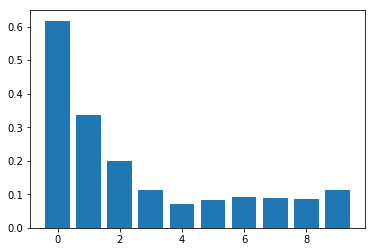

In [698]:
from matplotlib import pyplot as plt
x = range(10)
y = final_score
plt.bar(x, y, align='center')
plt.show()